### Figure 1

In [7]:
from IPython.display import HTML

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')

In [1]:
import matplotlib
matplotlib.use('TkAgg')
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import netCDF4 as nc
from scipy.interpolate import interp1d
import matplotlib.cm as cm
from salishsea_tools import (nc_tools, gsw_calls, geo_tools, viz_tools, bathy_tools)
import seabird
import cmocean as cmo
import gsw
from seabird.cnv import fCNV
import pandas as pd
import seaborn as sns
import matplotlib.gridspec as gridspec
from matplotlib.offsetbox import AnchoredText
from mpl_toolkits.axes_grid1 import make_axes_locatable, axes_size
import scipy.io

$\mathrm{(mLL^{-1})}$

In [2]:
iso_NEP = nc.Dataset('/data/ssahu/NEP36_Extracted_Months/2013_short_slice_NEP36_along_isopycnal_larger_offshore_rho_correct.nc')

iso_spic = iso_NEP.variables['spiciness']
isot = iso_NEP.variables['isot']

vel_iso_NEP = nc.Dataset('/data/ssahu/NEP36_Extracted_Months/short_NEP36_2013_along_isopycnal_larger_offshore_velocities.nc')
u_vel_iso = vel_iso_NEP.variables['u_velocity']
v_vel_iso = vel_iso_NEP.variables['v_velocity']
isot_vel = vel_iso_NEP.variables['isot']

In [3]:

bathy = nc.Dataset('/data/ssahu/WCVI_sliced_bathy_NEP36_original.nc')


Z = bathy.variables['Bathymetry'][:]

y_wcvi_slice = np.array(np.arange(180,350))
x_wcvi_slice = np.array(np.arange(480,650))

# z_wcvi = Z[y_wcvi_slice, x_wcvi_slice]
lon_wcvi = bathy['nav_lon'][:]#[180:350, 480:650]
lat_wcvi = bathy['nav_lat'][:]#[180:350, 480:650]

In [4]:
survey_mat_file_A = '/data/ssahu/Falkor_2013/mvp/surveyA.mat'
survey_mat_file_B = '/data/ssahu/Falkor_2013/mvp/surveyB.mat'
survey_mat_file_D = '/data/ssahu/Falkor_2013/mvp/surveyD.mat'
survey_mat_file_E = '/data/ssahu/Falkor_2013/mvp/surveyE.mat'
survey_mat_file_G = '/data/ssahu/Falkor_2013/mvp/surveyG.mat'


all_surveys = [survey_mat_file_A, survey_mat_file_B, survey_mat_file_D, \
              survey_mat_file_E, survey_mat_file_G]

lon_falkor = []
lat_falkor = []

for survey_file in all_surveys:
    
    mat = scipy.io.loadmat(survey_file)
    lat_survey = mat['latitude'][:,0]
    lon_survey = mat['longitude'][:,0] - 100
    
    lon_falkor = np.append(arr=lon_falkor, values=lon_survey)
    lat_falkor = np.append(arr=lat_falkor, values=lat_survey)
        

/home/ssahu/anaconda3/lib/python3.5/site-packages/numpy/core/fromnumeric.py:639: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


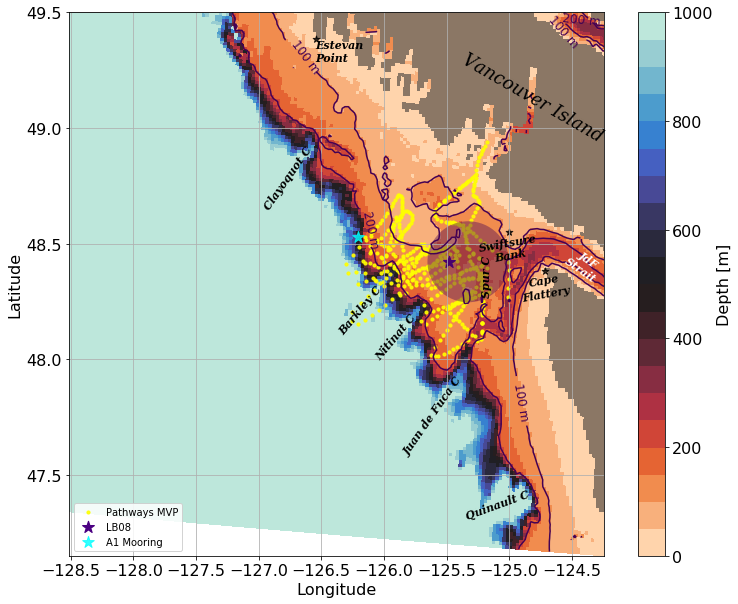

In [12]:
import matplotlib as mpl
# y = np.empty_like(lat_location)
# x = np.empty_like(lat_location)



cmap = plt.cm.get_cmap('icefire_r', 20)
# cmap = cmo.cm.turbid
# cmap = plt.cm.jet
# cmaplist = [cmap(i) for i in range(cmap.N)]
# # force the first color entry to be grey
# cmaplist[0] = (.8, .8, .8, 1.0)

# # create the new map
# cmap = mpl.colors.LinearSegmentedColormap.from_list(
#     'Custom cmap', cmaplist, cmap.N)
# cmap.set_bad('burlywood')
cmap.set_bad('#8b7765')

fig, ax = plt.subplots(1, 1, figsize=(12,10)); ax.grid()

ax.set_aspect(viz_tools.set_aspect(ax, coords='map', lats=lat_wcvi, adjustable='box-forced'))


# ax.relim()
# ax.autoscale_view(True,True,True)
# ax.autoscale_view(scalex=True)
# ax.autoscale(enable=True, axis='both', tight=None)
# bathy_tools.plot_colourmesh(bathy, title = 'WCVI Subset', fig_size=(9, 9), axis_limits=None, colour_map='winter_r', bins=15, land_colour='burlywood')
# p = ax.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], cmap=cmap, vmin=0, vmax=500)


p = ax.pcolormesh(lon_wcvi,lat_wcvi,Z, cmap=cmap, vmin=0, vmax=1000)
cbar = fig.colorbar(p, ax=ax)
ax.set_aspect('auto')



CS1 = ax.contour(lon_wcvi, lat_wcvi, Z, np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax.contour(lon_wcvi,lat_wcvi,Z, np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

# CS1 = ax.contour(lon_wcvi,lat_wcvi,Z, np.arange(1000,1010,10))
# CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

# CS1 = ax.contour(lon_wcvi,lat_wcvi,Z, np.arange(500,510,10))
# CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



# aspect = 20
# pad_fraction = 0.001
# divider = make_axes_locatable(ax)
# width = axes_size.AxesY(ax, aspect=1./aspect)
# pad = axes_size.Fraction(pad_fraction, width)
# cax = divider.append_axes("right", size=width, pad=pad)
# cbar = fig.colorbar(p, cax=cax)


# for i in np.arange(lat_location.shape[0]):
#     y[i], x[i] = geo_tools.find_closest_model_point(
#                lon_location[i],lat_location[i],lon_wcvi,lat_wcvi,tols={
#         'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})
    
# n = np.empty_like(lat_location)
# m = np.empty_like(lat_location)


# for i in np.arange(lat_location.shape[0]):
#     n[i], m[i] = geo_tools.find_closest_model_point(
#                lon_location[i],lat_location[i],lon_wcvi,lat_wcvi,tols={
#         'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})

# y = y.astype(int)
# x = x.astype(int)

# n = n.astype(int)
# m = m.astype(int)
# ax.scatter(x[:], y[:], c='orangered', s=100, alpha=0.5, label = 'Falkor CTD locations')

ax.set_xlabel('Longitude', fontsize=16)
ax.set_ylabel('Latitude', fontsize=16)
# ax.set_title('WCVI slice of NEP036 Model Domain', fontsize=20)

lon_W02 = -124.89500
lat_W02 = 48.04167

lon_W01 = -124.82500
lat_W01 = 48.31500



lon_swift = -125.00
lat_swift = 48.55

ax.scatter(lon_swift, lat_swift,  c='k', marker='*',  s=50, alpha=0.8)#, label = 'Swiftsure Bank')

# S = ("SwB")
S = ("Swiftsure\nBank")
ax.text(lon_swift, lat_swift, S, fontsize=11, color = 'k', fontweight = 'heavy',family='serif', style='italic', ha='center', rotation = 10,
         va='top', wrap=False)
# ax.text(lon_swift, lat_swift, S, fontsize=11, color = 'k', fontweight = 'heavy',family='serif', style='italic', ha='left', rotation = 10,
#          va='bottom', wrap=False)


lat_cape = 48.3831
lon_cape = -124.7144

ax.scatter(lon_cape, lat_cape,  c='k', marker='*',  s=50, alpha=0.8)#, label = 'Cape Flattery')

CP = ("Cape\nFlattery")
ax.text(lon_cape, lat_cape, CP, fontsize=11, color = 'k', fontweight = 'heavy',family='serif', style='italic', ha='center', rotation = 10,
         va='top', wrap=False)


lat_jdfs = 48.5
lon_jdfs = -124.4

JD = ("JdF\nStrait")
ax.text(lon_jdfs, lat_jdfs, JD, fontsize=11, color = 'white', fontweight = 'heavy',family='serif', style='italic', ha='center', rotation = -35,
         va='top', wrap=False)


lat_EP = 49.3835
lon_EP = -126.5447

ax.scatter(lon_EP, lat_EP,  c='k', marker='*',  s=50, alpha=0.8)

EP = ("Estevan\nPoint")
ax.text(lon_EP, lat_EP, EP, fontsize=11, color = 'k', fontweight = 'heavy',family='serif', style='italic', ha='left', rotation = 0,
         va='top', wrap=False)


lon_LB08 = -125.4775
lat_LB08 = 48.4217




ax.scatter(lon_falkor[::3], lat_falkor[::3],  c='yellow', marker='o',  s=10, alpha=0.9, label = 'Pathways MVP')


ax.scatter(lon_LB08, lat_LB08,  c='indigo', marker='*',  s=150, linewidths=1.2, alpha=1, label = 'LB08')

lon_A1 = -126.20433
lat_A1 = 48.52958

ax.scatter(lon_A1, lat_A1,  c='cyan',marker='*',  s=150, alpha=0.8, label = 'A1 Mooring')

# ax.scatter(lon_W01, lat_W01, c='cyan', s=150, alpha=0.8, label = 'W01')

# ax.scatter(lon_W02, lat_W02, c='red', s=150, alpha=0.8, label = 'W02')

# ax.scatter(lon_location[:], lat_location[:], c='purple', s=100, alpha=0.3, label = 'Falkor CTD locations')

legend = ax.legend(loc='lower left', fancybox=True, framealpha=0.85)

# ax.set_xlabel('x_index')
# ax.set_ylabel('y_index')
# ax.set_title('WCVI slice of NEP036 Model Domain', fontsize=20)

# viz_tools.plot_land_mask(ax, bathy)#, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='burlywood')
# cbar = fig.colorbar(p, cax=ax)
cbar.ax.set_ylabel('Depth [m]', fontsize=16)
ax.tick_params(axis='both',labelsize =16)
cbar.ax.tick_params(labelsize=16) 

# t = ("JdF Canyon")
# ax.text(lon_W01, lat_W01, t, fontsize=11, color = 'darkblue', family='serif', style='italic', ha='left', rotation = 55,
#          va='bottom', wrap=True)

t = ("Juan de Fuca C")
ax.text(-125.79, 47.58, t, fontsize=11, color = 'k', fontweight = 'heavy',family='serif', style='italic', ha='left', rotation = 55,
         va='bottom', wrap=True)



d = ("Clayoquot C")
ax.text( -126.9, 48.64, d, fontsize=11, color = 'k', fontweight = 'heavy',family='serif', style='italic', ha='left', rotation = 55,
         va='bottom', wrap=True)

C = ("Spur C")
ax.text(-125.14, 48.45, C, fontsize=11, color = 'k',fontweight = 'heavy', family='serif', style='italic', ha='right', rotation = 90,
         va='bottom', wrap=True)

X = ("Barkley C")
ax.text(-126.0, 48.3, X, fontsize=11, color = 'k', fontweight = 'heavy',family='serif', style='italic', ha='right', rotation = 50,
         va='bottom', wrap=True)

Y = ("Nitinat C")
ax.text(-125.73, 48.18, Y, fontsize=11, color = 'k', fontweight = 'heavy',family='serif', style='italic', ha='right', rotation = 50,
         va='bottom', wrap=True)


A = ("Quinault C")
ax.text(-124.83, 47.4, A, fontsize=11, color = 'k', fontweight = 'heavy',family='serif', style='italic', ha='right', rotation = 20,
         va='bottom', wrap=True)


V = ("Vancouver Island")
ax.text(-124.85, 49.1, V, fontsize=18, color = 'k', family='serif', style='italic', ha='center', rotation = -30,
         va='bottom', wrap=True)

from matplotlib.patches import Circle,Ellipse
from matplotlib.collections import PatchCollection


patches = []
# circle = Circle((lon_LB08, lat_LB08), 0.35)
# circle = plt.Circle((lon_LB08, lat_LB08), 0.2, color='blue')
circle = Ellipse((lon_LB08+0.15, lat_LB08), 0.65, 0.35,
                     angle=0, linewidth=2, fill=False, zorder=2, label = 'Eddy Region')
patches.append(circle)
colors = 100*np.random.rand(len(patches))
p = PatchCollection(patches, alpha=0.4)
p.set_array(np.array(colors))
ax.add_collection(p)

ax.grid()






ax.set_ylim(top=49.5, bottom=47.15136337)
ax.set_xlim(left=-128.51552, right=-124.24068451)

path_to_save = '/home/ssahu/saurav/NEP36_Model_Eval_plots/'
# plt.savefig(path_to_save + 'Domain_edited.png')

### Figure 2

In [1]:
%matplotlib notebook
import matplotlib.pyplot as plt
import numpy as np
import numpy.ma as ma
import pandas as pd
import netCDF4 as nc
import os
import scipy.io as sio
from scipy import interpolate, signal
from pyproj import Proj,transform
import sys
sys.path.append('/ocean/ssahu/CANYONS/wcvi/grid/')
from bathy_common import *
from matplotlib import path
from salishsea_tools import viz_tools
from netCDF4 import Dataset
import xarray as xr
from salishsea_tools import nc_tools
import scipy.io as sio
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.cm as cm
import cmocean as cmo
import matplotlib.gridspec as gridspec
%matplotlib inline
from scipy.io import loadmat
from scipy.interpolate import griddata
from dateutil.parser import parse
from salishsea_tools import geo_tools, viz_tools, tidetools, nc_tools
import gsw
from mpl_toolkits.axes_grid1 import make_axes_locatable
import sklearn.cluster as cluster
import seaborn as sns
# sns.set_context('poster')
# sns.set_color_codes()
# plot_kwds = {'alpha' : 0.25, 's' : 80, 'linewidths':0}


/home/ssahu/anaconda3/lib/python3.5/site-packages/xarray/conventions.py:9: FutureWarning: The pandas.tslib module is deprecated and will be removed in a future version.
  from pandas.tslib import OutOfBoundsDatetime


In [96]:
zlevels = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/CDF_COMB_COMPRESSED/NEP036-N30_IN_20140915_00001440_grid_T.nc').variables['deptht'][:32]
y_wcvi_slice = np.arange(180,350)
x_wcvi_slice = np.arange(480,650)


bathy = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/Bathymetry_EastCoast_NEMO_R036_GEBCO_corr_v14.nc')

Z = bathy.variables['Bathymetry'][:]

lon = bathy['nav_lon'][...]
lat = bathy['nav_lat'][...]

z0 = np.ma.masked_values(Z, 0)

In [55]:
NEP = nc.Dataset('/data/ssahu/NEP36_Extracted_Months/NEP36_2013_T_S_Spice_larger_offshore_rho_correct.nc')


sal = NEP.variables['vosaline']
temp = NEP.variables['votemper']
spic = NEP.variables['spiciness']
rho = NEP.variables['density']

# sal_mean_august  = np.mean(sal[88-30:119-30,...], axis=0)
# temp_mean_august = np.mean(temp[88-30:119-30,...], axis=0)
# spic_mean_august = np.mean(spic[88-30:119-30,...], axis=0)
# rho_mean_august  = np.mean(rho[88-30:119-30,...], axis=0)

sal_mean_august  = np.mean(sal[:], axis=0)
temp_mean_august = np.mean(temp[:], axis=0)
spic_mean_august = np.mean(spic[:], axis=0)
rho_mean_august  = np.mean(rho[:], axis=0)

In [56]:
### Let us calculate the values of near bottom spice and density

mask = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/mesh_mask.nc')

tmask = mask.variables['tmask'][0,:32,180:350,480:650]

z_subset = Z[180:350,480:650]

lon_wcvi = lon[180:350,480:650]
lat_wcvi = lat[180:350,480:650]

In [57]:
near_bottom_temp = np.empty((sal.shape[2], sal.shape[3]))
near_bottom_rho = np.empty_like(near_bottom_temp)
near_bottom_sal = np.empty_like(near_bottom_temp)

SA_loc           = np.empty_like(near_bottom_temp)
CT_loc           = np.empty_like(near_bottom_temp)
near_bottom_spic = np.empty_like(near_bottom_temp)



# for t in np.arange(sal.shape[0]):
for j in np.arange(sal.shape[2]):
    for i in np.arange(sal.shape[3]):
        
        
        if tmask[-1,j,i] == 0:
            depth_ind = np.min(np.where(tmask[:,j,i] == 0))
#         else :
#             depth_ind = 50

            bottom_depth = z_subset[j,i]   #5 m from the depth

            

#             spic_array = spic_mean_august[:depth_ind-1,j,i]
#             near_bottom_spic[j,i] = np.interp(x=bottom_depth, xp=zlevels[:depth_ind-1], fp=spic_array)

            sal_array  = sal_mean_august[:depth_ind-1,j,i]
            near_bottom_sal[j,i] = np.interp(x=bottom_depth, xp=zlevels[:depth_ind-1], fp=sal_array)
                    
            temp_array  = temp_mean_august[:depth_ind-1,j,i]
            near_bottom_temp[j,i] = np.interp(x=bottom_depth, xp=zlevels[:depth_ind-1], fp=temp_array)

            rho_array  = rho_mean_august[:depth_ind-1,j,i]
            near_bottom_rho[j,i] = np.interp(x=bottom_depth, xp=zlevels[:depth_ind-1], fp=rho_array)
            
            pressure_bottom = gsw.p_from_z(-bottom_depth,lat_wcvi[j,i])
            
            
            SA_loc[j,i] = gsw.SA_from_SP(near_bottom_sal[j,i], bottom_depth, lon_wcvi[j,i], lat_wcvi[j,i])
            CT_loc[j,i] = gsw.CT_from_pt(near_bottom_sal[j,i], near_bottom_temp[j,i])
            near_bottom_spic[j,i] = gsw.spiciness0(SA_loc[j,i],CT_loc[j,i])
            
            
            
            
        if tmask[-1,j,i] == 1:
            depth_ind = np.max(np.where(tmask[:,j,i] == 1))
#         else :
#             depth_ind = 50

            bottom_depth = z_subset[j,i]   #5 m from the depth

            

#             spic_array = spic_mean_august[:depth_ind-1,j,i]
#             near_bottom_spic[j,i] = np.interp(x=bottom_depth, xp=zlevels[:depth_ind-1], fp=spic_array)

            sal_array  = sal_mean_august[:depth_ind-1,j,i]
            near_bottom_sal[j,i] = np.interp(x=bottom_depth, xp=zlevels[:depth_ind-1], fp=sal_array)
        
            temp_array  = temp_mean_august[:depth_ind-1,j,i]
            near_bottom_temp[j,i] = np.interp(x=bottom_depth, xp=zlevels[:depth_ind-1], fp=temp_array)

            rho_array  = rho_mean_august[:depth_ind-1,j,i]
            near_bottom_rho[j,i] = np.interp(x=bottom_depth, xp=zlevels[:depth_ind-1], fp=rho_array)
            
            
            pressure_bottom = gsw.p_from_z(-bottom_depth,lat_wcvi[j,i])
            
            
            SA_loc[j,i] = gsw.SA_from_SP(near_bottom_sal[j,i], bottom_depth, lon_wcvi[j,i], lat_wcvi[j,i])
            CT_loc[j,i] = gsw.CT_from_pt(near_bottom_sal[j,i], near_bottom_temp[j,i])
            near_bottom_spic[j,i] = gsw.spiciness0(SA_loc[j,i],CT_loc[j,i])

        if tmask[0,j,i] == 0:
#             near_bottom_spic[j,i] = 'Nan'
            near_bottom_rho[j,i]  = 'Nan'
            near_bottom_temp[j,i] = 'Nan'
            near_bottom_sal[j,i]  = 'Nan'
            near_bottom_spic[j,i] = 'Nan'
            
            



            

/home/ssahu/anaconda3/lib/python3.5/site-packages/numpy/lib/function_base.py:2042: UserWarning: Warning: converting a masked element to nan.
  return interp_func([x], xp, fp, left, right).item()
/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:40: UserWarning: Warning: converting a masked element to nan.


In [7]:
LB_08_spice = np.empty_like(near_bottom_rho)
LB_08_dense = np.empty_like(near_bottom_rho)

for j in np.arange(near_bottom_rho.shape[1]):
    for i in np.arange(near_bottom_rho.shape[0]):
        if (((near_bottom_spic[j,i] > -0.04) & (near_bottom_spic[j,i] < -0.025))\
        &((near_bottom_rho[j,i]-1000 > 26.5)& (near_bottom_rho[j,i]-1000 < 26.65))):
            

            LB_08_spice[j,i] = near_bottom_spic[j,i]
            LB_08_dense[j,i] = near_bottom_rho[j,i]
            
        else:
            LB_08_spice[j,i] = 'Nan'
            LB_08_dense[j,i] = 'Nan'

In [8]:
LB_08_dense.shape

(170, 170)

In [55]:
near_bottom_rho[0,0]

1026.8284912109375

In [62]:
pressure_bottom

40.464273532611941

In [68]:
bottom_depth

40.115264187015775

In [53]:
spic_array.shape

(31,)

In [10]:
from matplotlib import colors as c

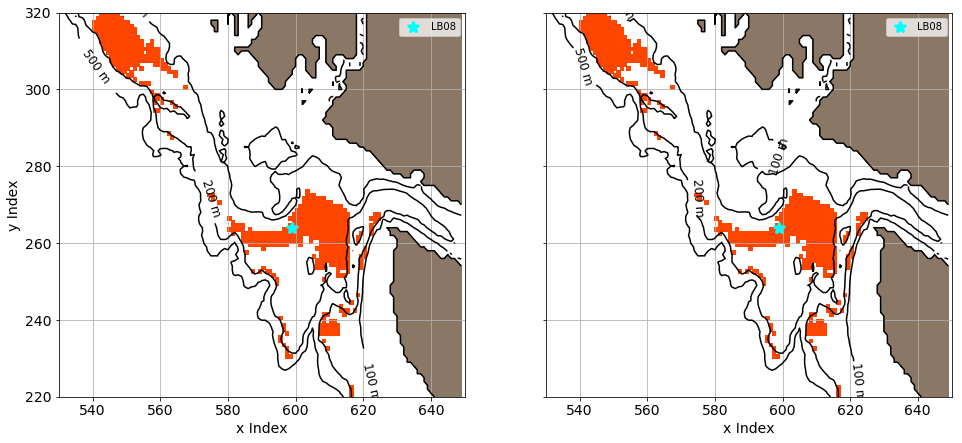

In [59]:
# Set up the figure and axes
fig, (axl,axr) = plt.subplots(1, 2, figsize=(16, 8), sharey = True)
# land_colour = 'burlywood'
# cmap.set_bad('#8b7765')

land_colour = '#8b7765'


# Plot thalweg points on bathymetry map
viz_tools.set_aspect(axl)
# cmap = plt.get_cmap(cmo.cm.deep_r)
cmap = plt.get_cmap('vlag',10)
# cmap.set_bad(land_colour)
# cmap = plt.get_cmap(cmo.cm.oxy)
# cmap = plt.get_cmap('icefire')
# cmap = plt.get_cmap(cmo.cm.balance)
cmap.set_bad(land_colour)

# bathy = bathymetry
# x_slice = np.arange(bathy.shape[1])
# y_slice = np.arange(bathy.shape[0])
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)


# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.array(spic_iso_mean_august_264), cmap=cmap, vmin = -0.15, vmax = 0)
cMap = c.ListedColormap(['orangered'])
q = axl.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.masked_invalid(LB_08_spice), cmap=cMap)#, vmin = -0.04, vmax = 0)


# CS1 = axl.contour(x_wcvi_slice,y_wcvi_slice,np.ma.array(near_bottom_spic), np.arange(-0.05,0,0.01),colors='cyan')
# CS1 = axr.contour(x_wcvi_slice[100:140],y_wcvi_slice[60:100],np.ma.array(near_bottom_spic[60:100,100:140]), np.arange(-0.1,0,0.01),colors='cyan')
# CLS1 = plt.clabel(CS1, inline=3,fmt='%0.2f', fontsize=12)

# axl.hlines(y=264, xmin=530, xmax=650, color= 'green', linewidths=(3,), linestyles='dashed')
axl.scatter(
    599, 264, marker='*',  s = 100, color='cyan', linewidths=(3,),
    label='LB08',
)
legend = axl.legend(loc='best', fancybox=True, framealpha=0.75)
# axr.set_title('Bathymetry Plot', fontsize = 14)
axl.set_xlabel('x Index', fontsize = 14)
axl.set_ylabel('y Index', fontsize = 14)
CS1 = axl.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(100,110,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axl.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(200,210,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axl.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(500,510,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)


viz_tools.plot_coastline(axl, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='k')
viz_tools.plot_land_mask(axl, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color=land_colour)

axl.tick_params(axis='both',labelsize =14)

# axr.clabel(CS)
axl.set_xlim(right=650, left=530)
axl.set_ylim(top=320, bottom=220)
# axr.yaxis.tick_right()
# axr.yaxis.set_label_position("right")
axl.grid()
# divider = make_axes_locatable(axl)
# cax = divider.append_axes("right", size="5%", pad=0.05)

# # plt.colorbar(im, cax=cax)
# cbar = fig.colorbar(q, cax=cax)
# cbar.set_label('Spice', fontsize = 14)
# cbar.ax.tick_params(labelsize=14)
# cbar = fig.colorbar(q, ax=axl)



# Plot thalweg points on bathymetry map
viz_tools.set_aspect(axr)
# cmap = plt.get_cmap(cmo.cm.deep_r)
cmap = plt.get_cmap('vlag',10)
# cmap.set_bad(land_colour)
# cmap = plt.get_cmap(cmo.cm.oxy)
# cmap = plt.get_cmap('icefire')
# cmap = plt.get_cmap(cmo.cm.balance)
cmap.set_bad(land_colour)

# bathy = bathymetry
# x_slice = np.arange(bathy.shape[1])
# y_slice = np.arange(bathy.shape[0])
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)


# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.array(spic_iso_mean_august_264), cmap=cmap, vmin = -0.15, vmax = 0)

q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.masked_invalid(LB_08_dense) -1000, cmap=cMap, vmin = 26.4, vmax = 26.8)

# CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,np.ma.array(near_bottom_rho)-1000, np.arange(26.5,26.6,0.04), colors = 'cyan')

# axr.hlines(y=264, xmin=530, xmax=650, color= 'green', linewidths=(3,), linestyles='dashed')
axr.scatter(
    599, 264, marker='*',  s = 100, color='cyan', linewidths=(3,),
    label='LB08',
)
# axr.scatter(
#     577, 266, marker='o',  s = 20, color='cyan', linewidths=(3,),
#     label='EQUAL',
# )
legend = axr.legend(loc='best', fancybox=True, framealpha=0.75)
# axr.set_title('Bathymetry Plot', fontsize = 14)
axr.set_xlabel('x Index', fontsize = 14)
# axr.set_ylabel('y Index', fontsize = 14)
CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(100,110,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(200,210,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(500,510,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)


viz_tools.plot_coastline(axr, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='k')
viz_tools.plot_land_mask(axr, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color=land_colour)

axr.tick_params(axis='both',labelsize =14)

# axr.clabel(CS)
axr.set_xlim(right=650, left=530)
axr.set_ylim(top=320, bottom=220)
# axr.yaxis.tick_right()
# axr.yaxis.set_label_position("right")
axr.grid()

# divider = make_axes_locatable(axr)
# cax = divider.append_axes("right", size="5%", pad=0.05)

# # plt.colorbar(im, cax=cax)
# cbar = fig.colorbar(q, cax=cax)

# cbar.set_label('Potential Density', fontsize = 14)
# cbar.ax.tick_params(labelsize=14)



In [106]:
LB_08_spice = np.empty_like(near_bottom_rho)
LB_08_dense = np.empty_like(near_bottom_rho)

for j in np.arange(near_bottom_rho.shape[1]):
    for i in np.arange(near_bottom_rho.shape[0]):
        if (((near_bottom_spic[j,i] > -0.035) & (near_bottom_spic[j,i] < -0.025))\
        &((near_bottom_rho[j,i]-1000 > 26.5)& (near_bottom_rho[j,i]-1000 < 26.65))):
            

            LB_08_spice[j,i] = near_bottom_spic[j,i]
            LB_08_dense[j,i] = near_bottom_rho[j,i]
            
        else:
            LB_08_spice[j,i] = 'Nan'
            LB_08_dense[j,i] = 'Nan'

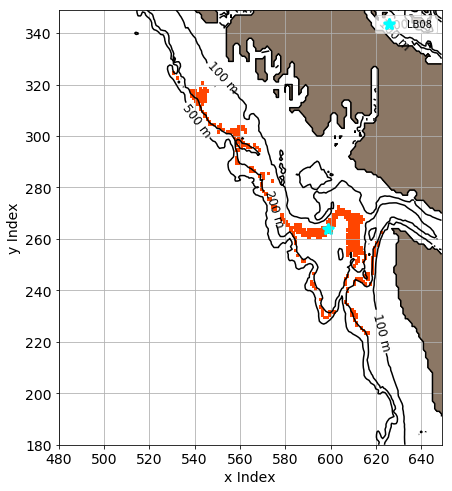

In [107]:
# Set up the figure and axes
fig, axl = plt.subplots(1, 1, figsize=(8, 8), sharey = True)
# land_colour = 'burlywood'
# cmap.set_bad('#8b7765')

land_colour = '#8b7765'


# Plot thalweg points on bathymetry map
viz_tools.set_aspect(axl)
# cmap = plt.get_cmap(cmo.cm.deep_r)
cmap = plt.get_cmap('vlag',10)
# cmap.set_bad(land_colour)
# cmap = plt.get_cmap(cmo.cm.oxy)
# cmap = plt.get_cmap('icefire')
# cmap = plt.get_cmap(cmo.cm.balance)
cmap.set_bad(land_colour)

# bathy = bathymetry
# x_slice = np.arange(bathy.shape[1])
# y_slice = np.arange(bathy.shape[0])
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)


# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.array(spic_iso_mean_august_264), cmap=cmap, vmin = -0.15, vmax = 0)
cMap = c.ListedColormap(['orangered'])
q = axl.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.masked_invalid(LB_08_spice), cmap=cMap)#, vmin = -0.04, vmax = 0)


# CS1 = axl.contour(x_wcvi_slice,y_wcvi_slice,np.ma.array(near_bottom_spic), np.arange(-0.05,0,0.01),colors='cyan')
# CS1 = axr.contour(x_wcvi_slice[100:140],y_wcvi_slice[60:100],np.ma.array(near_bottom_spic[60:100,100:140]), np.arange(-0.1,0,0.01),colors='cyan')
# CLS1 = plt.clabel(CS1, inline=3,fmt='%0.2f', fontsize=12)

# axl.hlines(y=264, xmin=530, xmax=650, color= 'green', linewidths=(3,), linestyles='dashed')
axl.scatter(
    599, 264, marker='*',  s = 100, color='cyan', linewidths=(3,),
    label='LB08',
)
legend = axl.legend(loc='best', fancybox=True, framealpha=0.75)
# axr.set_title('Bathymetry Plot', fontsize = 14)
axl.set_xlabel('x Index', fontsize = 14)
axl.set_ylabel('y Index', fontsize = 14)
CS1 = axl.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(100,110,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axl.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(200,210,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axl.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(500,510,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)


viz_tools.plot_coastline(axl, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='k')
viz_tools.plot_land_mask(axl, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color=land_colour)

axl.tick_params(axis='both',labelsize =14)

# axr.clabel(CS)
# axl.set_xlim(right=650, left=530)
# axl.set_ylim(top=320, bottom=220)
# axr.yaxis.tick_right()
# axr.yaxis.set_label_position("right")
axl.grid()


/home/ssahu/anaconda3/lib/python3.5/site-packages/numpy/core/fromnumeric.py:639: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)
/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/colors.py:491: RuntimeWarning: overflow encountered in multiply
  xa *= self.N


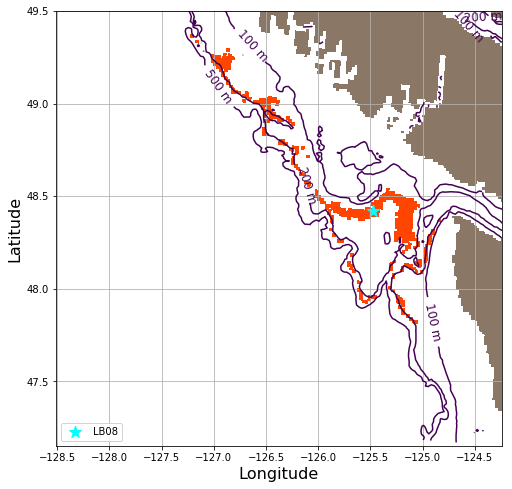

In [109]:
import matplotlib as mpl
# y = np.empty_like(lat_location)
# x = np.empty_like(lat_location)



# cmap = plt.cm.get_cmap('icefire_r', 20)

cmap.set_bad('#8b7765')

fig, ax = plt.subplots(1, 1, figsize=(8,8)); ax.grid()

ax.set_aspect(viz_tools.set_aspect(ax, coords='map', lats=lat_wcvi, adjustable='box-forced'))

# cmap = plt.cm.get_cmap('icefire_r', 20)

cmap = plt.cm.get_cmap('binary')
cmap.set_bad('#8b7765')
p = ax.pcolormesh(lon_wcvi,lat_wcvi,Z, cmap=cmap, vmin=5000, vmax=5000)

# p = ax.pcolormesh(lon_wcvi,lat_wcvi,Z, cmap=cmap, vmin=0, vmax=1000)
# cbar = fig.colorbar(p, ax=ax)
ax.set_aspect('auto')

cMap = c.ListedColormap(['orangered'])
q = ax.pcolormesh(lon_wcvi, lat_wcvi,np.ma.masked_invalid(LB_08_spice), cmap=cMap)#, vmin = -0.04, vmax = 0)


CS1 = ax.contour(lon_wcvi, lat_wcvi, Z, np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax.contour(lon_wcvi,lat_wcvi,Z, np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax.contour(lon_wcvi,lat_wcvi,Z, np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

ax.set_xlabel('Longitude', fontsize=16)
ax.set_ylabel('Latitude', fontsize=16)
# ax.set_title('WCVI slice of NEP036 Model Domain', fontsize=20)

lon_LB08 = -125.4775
lat_LB08 = 48.4217


ax.scatter(lon_LB08, lat_LB08,  c='cyan', marker='*',  s=150, linewidths=1.2, alpha=1, label = 'LB08')


legend = ax.legend(loc='lower left', fancybox=True, framealpha=0.85)

ax.grid()






ax.set_ylim(top=49.5, bottom=47.15136337)
ax.set_xlim(left=-128.51552, right=-124.24068451)

path_to_save = '/home/ssahu/saurav/NEP36_Model_Eval_plots/'
# plt.savefig(path_to_save + 'Domain_edited.png')

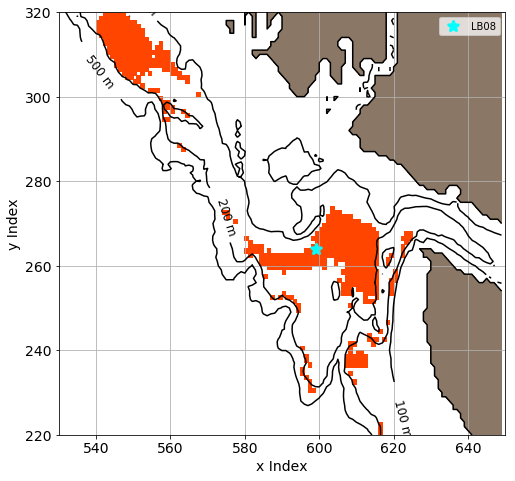

In [61]:
# Set up the figure and axes
fig, axl = plt.subplots(1, 1, figsize=(8, 8), sharey = True)
# land_colour = 'burlywood'
# cmap.set_bad('#8b7765')

land_colour = '#8b7765'


# Plot thalweg points on bathymetry map
viz_tools.set_aspect(axl)
# cmap = plt.get_cmap(cmo.cm.deep_r)
cmap = plt.get_cmap('vlag',10)
# cmap.set_bad(land_colour)
# cmap = plt.get_cmap(cmo.cm.oxy)
# cmap = plt.get_cmap('icefire')
# cmap = plt.get_cmap(cmo.cm.balance)
cmap.set_bad(land_colour)

# bathy = bathymetry
# x_slice = np.arange(bathy.shape[1])
# y_slice = np.arange(bathy.shape[0])
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)


# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.array(spic_iso_mean_august_264), cmap=cmap, vmin = -0.15, vmax = 0)
cMap = c.ListedColormap(['orangered'])
q = axl.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.masked_invalid(LB_08_spice), cmap=cMap)#, vmin = -0.04, vmax = 0)


# CS1 = axl.contour(x_wcvi_slice,y_wcvi_slice,np.ma.array(near_bottom_spic), np.arange(-0.05,0,0.01),colors='cyan')
# CS1 = axr.contour(x_wcvi_slice[100:140],y_wcvi_slice[60:100],np.ma.array(near_bottom_spic[60:100,100:140]), np.arange(-0.1,0,0.01),colors='cyan')
# CLS1 = plt.clabel(CS1, inline=3,fmt='%0.2f', fontsize=12)

# axl.hlines(y=264, xmin=530, xmax=650, color= 'green', linewidths=(3,), linestyles='dashed')
axl.scatter(
    599, 264, marker='*',  s = 100, color='cyan', linewidths=(3,),
    label='LB08',
)
legend = axl.legend(loc='best', fancybox=True, framealpha=0.75)
# axr.set_title('Bathymetry Plot', fontsize = 14)
axl.set_xlabel('x Index', fontsize = 14)
axl.set_ylabel('y Index', fontsize = 14)
CS1 = axl.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(100,110,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axl.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(200,210,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axl.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(500,510,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)


viz_tools.plot_coastline(axl, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='k')
viz_tools.plot_land_mask(axl, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color=land_colour)

axl.tick_params(axis='both',labelsize =14)

# axr.clabel(CS)
axl.set_xlim(right=650, left=530)
axl.set_ylim(top=320, bottom=220)
# axr.yaxis.tick_right()
# axr.yaxis.set_label_position("right")
axl.grid()


/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/colors.py:496: RuntimeWarning: invalid value encountered in less
  cbook._putmask(xa, xa < 0.0, -1)


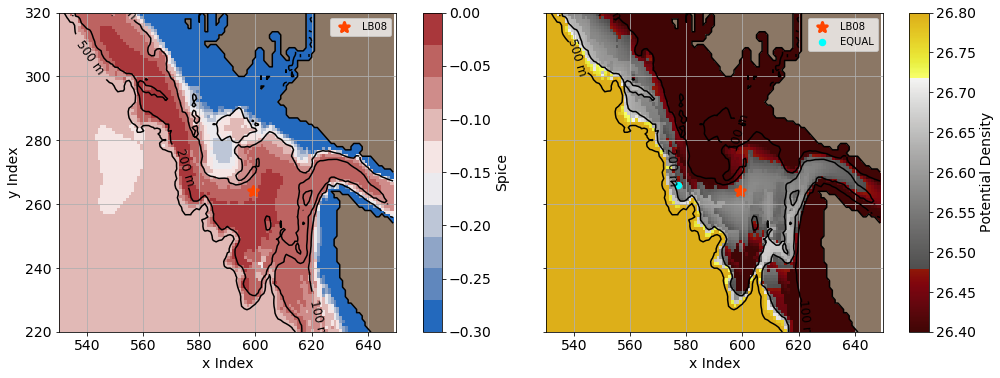

In [69]:
# Set up the figure and axes
fig, (axl,axr) = plt.subplots(1, 2, figsize=(16, 8), sharey = True)
# land_colour = 'burlywood'
# cmap.set_bad('#8b7765')

land_colour = '#8b7765'


# Plot thalweg points on bathymetry map
viz_tools.set_aspect(axl)
# cmap = plt.get_cmap(cmo.cm.deep_r)
cmap = plt.get_cmap('vlag',10)
# cmap.set_bad(land_colour)
# cmap = plt.get_cmap(cmo.cm.oxy)
# cmap = plt.get_cmap('icefire')
# cmap = plt.get_cmap(cmo.cm.balance)
cmap.set_bad(land_colour)

# bathy = bathymetry
# x_slice = np.arange(bathy.shape[1])
# y_slice = np.arange(bathy.shape[0])
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)


# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.array(spic_iso_mean_august_264), cmap=cmap, vmin = -0.15, vmax = 0)

q = axl.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.array(near_bottom_spic), cmap=cmap, vmin = -0.3, vmax = 0)


# CS1 = axl.contour(x_wcvi_slice,y_wcvi_slice,np.ma.array(near_bottom_spic), np.arange(-0.05,0,0.01),colors='cyan')
# CS1 = axr.contour(x_wcvi_slice[100:140],y_wcvi_slice[60:100],np.ma.array(near_bottom_spic[60:100,100:140]), np.arange(-0.1,0,0.01),colors='cyan')
# CLS1 = plt.clabel(CS1, inline=3,fmt='%0.2f', fontsize=12)

# axl.hlines(y=264, xmin=530, xmax=650, color= 'green', linewidths=(3,), linestyles='dashed')
axl.scatter(
    599, 264, marker='*',  s = 100, color='orangered', linewidths=(3,),
    label='LB08',
)
legend = axl.legend(loc='best', fancybox=True, framealpha=0.75)
# axr.set_title('Bathymetry Plot', fontsize = 14)
axl.set_xlabel('x Index', fontsize = 14)
axl.set_ylabel('y Index', fontsize = 14)
CS1 = axl.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(100,110,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axl.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(200,210,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axl.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(500,510,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)


viz_tools.plot_coastline(axl, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='k')
viz_tools.plot_land_mask(axl, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color=land_colour)

axl.tick_params(axis='both',labelsize =14)

# axr.clabel(CS)
axl.set_xlim(right=650, left=530)
axl.set_ylim(top=320, bottom=220)
# axr.yaxis.tick_right()
# axr.yaxis.set_label_position("right")
axl.grid()
divider = make_axes_locatable(axl)
cax = divider.append_axes("right", size="5%", pad=0.05)

# plt.colorbar(im, cax=cax)
cbar = fig.colorbar(q, cax=cax)
cbar.set_label('Spice', fontsize = 14)
cbar.ax.tick_params(labelsize=14)
# cbar = fig.colorbar(q, ax=axl)



# Plot thalweg points on bathymetry map
viz_tools.set_aspect(axr)
# cmap = plt.get_cmap(cmo.cm.deep_r)
# cmap = plt.get_cmap('vlag')
# cmap.set_bad(land_colour)
cmap = plt.get_cmap(cmo.cm.oxy)
# cmap = plt.get_cmap('icefire')
# cmap = plt.get_cmap(cmo.cm.balance)
cmap.set_bad(land_colour)

# bathy = bathymetry
# x_slice = np.arange(bathy.shape[1])
# y_slice = np.arange(bathy.shape[0])
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)


# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.array(spic_iso_mean_august_264), cmap=cmap, vmin = -0.15, vmax = 0)

q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.array(near_bottom_rho) -1000, cmap=cmap, vmin = 26.4, vmax = 26.8)

# CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,np.ma.array(near_bottom_rho)-1000, np.arange(26.5,26.6,0.04), colors = 'cyan')

# axr.hlines(y=264, xmin=530, xmax=650, color= 'green', linewidths=(3,), linestyles='dashed')
axr.scatter(
    599, 264, marker='*',  s = 100, color='orangered', linewidths=(3,),
    label='LB08',
)
axr.scatter(
    577, 266, marker='o',  s = 20, color='cyan', linewidths=(3,),
    label='EQUAL',
)
legend = axr.legend(loc='best', fancybox=True, framealpha=0.75)
# axr.set_title('Bathymetry Plot', fontsize = 14)
axr.set_xlabel('x Index', fontsize = 14)
# axr.set_ylabel('y Index', fontsize = 14)
CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(100,110,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(200,210,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(500,510,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)


viz_tools.plot_coastline(axr, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='k')
viz_tools.plot_land_mask(axr, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color=land_colour)

axr.tick_params(axis='both',labelsize =14)

# axr.clabel(CS)
axr.set_xlim(right=650, left=530)
axr.set_ylim(top=320, bottom=220)
# axr.yaxis.tick_right()
# axr.yaxis.set_label_position("right")
axr.grid()

divider = make_axes_locatable(axr)
cax = divider.append_axes("right", size="5%", pad=0.05)

# plt.colorbar(im, cax=cax)
cbar = fig.colorbar(q, cax=cax)

cbar.set_label('Potential Density', fontsize = 14)
cbar.ax.tick_params(labelsize=14)



In [39]:
near_bottom_spic[263-180,598-480]

-0.036268249521157259

In [70]:
near_bottom_spic[265-180,576-480]

-0.010310447405899481

In [43]:
z_subset[263-180,575-480]

246.21134309097135

In [46]:
near_bottom_rho[263-180,598-480]-1000

26.5404052734375

In [66]:
near_bottom_rho[265-180,576-480]-1000

26.5411376953125

In [65]:
z_subset[265-180,576-480]

204.90723789321268

/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/colors.py:496: RuntimeWarning: invalid value encountered in less
  cbook._putmask(xa, xa < 0.0, -1)


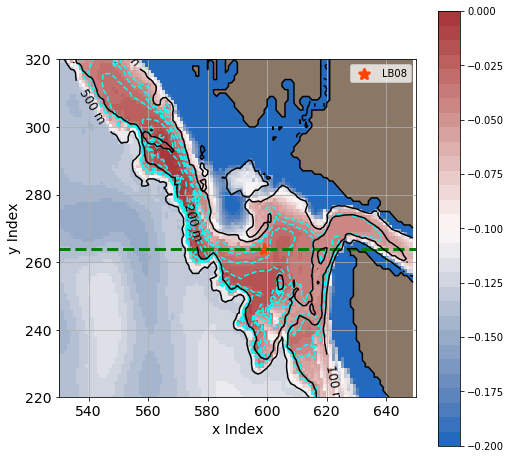

In [98]:
# Set up the figure and axes
fig, axr = plt.subplots(1, 1, figsize=(8, 8))
# land_colour = 'burlywood'
# cmap.set_bad('#8b7765')

land_colour = '#8b7765'


# Plot thalweg points on bathymetry map
viz_tools.set_aspect(axr)
# cmap = plt.get_cmap(cmo.cm.deep_r)
cmap = plt.get_cmap('vlag', 30)
# cmap.set_bad(land_colour)
# cmap = plt.get_cmap(cmo.cm.oxy)
# cmap = plt.get_cmap('icefire')
# cmap = plt.get_cmap(cmo.cm.balance)
cmap.set_bad(land_colour)

# bathy = bathymetry
# x_slice = np.arange(bathy.shape[1])
# y_slice = np.arange(bathy.shape[0])
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)


# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.array(spic_iso_mean_august_264), cmap=cmap, vmin = -0.15, vmax = 0)

q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.array(near_bottom_spic), cmap=cmap, vmin = -0.2, vmax = 0)
cbar = fig.colorbar(q, ax=axr)

CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,np.ma.array(near_bottom_spic), np.arange(-0.05,0,0.01),colors='cyan')
# CS1 = axr.contour(x_wcvi_slice[100:140],y_wcvi_slice[60:100],np.ma.array(near_bottom_spic[60:100,100:140]), np.arange(-0.1,0,0.01),colors='cyan')
# CLS1 = plt.clabel(CS1, inline=3,fmt='%0.2f', fontsize=12)

axr.hlines(y=264, xmin=530, xmax=650, color= 'green', linewidths=(3,), linestyles='dashed')
axr.scatter(
    599, 264, marker='*',  s = 100, color='orangered', linewidths=(3,),
    label='LB08',
)
legend = axr.legend(loc='best', fancybox=True, framealpha=0.75)
# axr.set_title('Bathymetry Plot', fontsize = 14)
axr.set_xlabel('x Index', fontsize = 14)
axr.set_ylabel('y Index', fontsize = 14)
CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(100,110,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(200,210,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(500,510,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)


viz_tools.plot_coastline(axr, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='k')
viz_tools.plot_land_mask(axr, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color=land_colour)

axr.tick_params(axis='both',labelsize =14)

# axr.clabel(CS)
axr.set_xlim(right=650, left=530)
axr.set_ylim(top=320, bottom=220)
# axr.yaxis.tick_right()
# axr.yaxis.set_label_position("right")
axr.grid()




/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/colors.py:496: RuntimeWarning: invalid value encountered in less
  cbook._putmask(xa, xa < 0.0, -1)


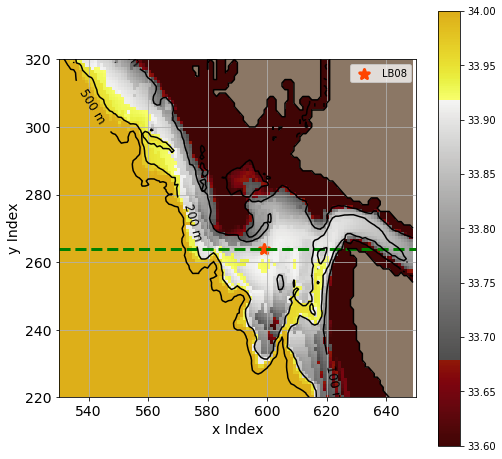

In [12]:
# Set up the figure and axes
fig, axr = plt.subplots(1, 1, figsize=(8, 8))
# land_colour = 'burlywood'
# cmap.set_bad('#8b7765')

land_colour = '#8b7765'


# Plot thalweg points on bathymetry map
viz_tools.set_aspect(axr)
# cmap = plt.get_cmap(cmo.cm.deep_r)
# cmap = plt.get_cmap('vlag', 30)
# cmap.set_bad(land_colour)
cmap = plt.get_cmap(cmo.cm.oxy)
# cmap = plt.get_cmap('icefire')
# cmap = plt.get_cmap(cmo.cm.balance)
cmap.set_bad(land_colour)

# bathy = bathymetry
# x_slice = np.arange(bathy.shape[1])
# y_slice = np.arange(bathy.shape[0])
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)


# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.array(spic_iso_mean_august_264), cmap=cmap, vmin = -0.15, vmax = 0)

q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.array(near_bottom_sal), cmap=cmap, vmin = 33.6, vmax = 34)
cbar = fig.colorbar(q, ax=axr)

axr.hlines(y=264, xmin=530, xmax=650, color= 'green', linewidths=(3,), linestyles='dashed')
axr.scatter(
    599, 264, marker='*',  s = 100, color='orangered', linewidths=(3,),
    label='LB08',
)
legend = axr.legend(loc='best', fancybox=True, framealpha=0.75)
# axr.set_title('Bathymetry Plot', fontsize = 14)
axr.set_xlabel('x Index', fontsize = 14)
axr.set_ylabel('y Index', fontsize = 14)
CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(100,110,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(200,210,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(500,510,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)


viz_tools.plot_coastline(axr, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='k')
viz_tools.plot_land_mask(axr, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color=land_colour)

axr.tick_params(axis='both',labelsize =14)

# axr.clabel(CS)
axr.set_xlim(right=650, left=530)
axr.set_ylim(top=320, bottom=220)
# axr.yaxis.tick_right()
# axr.yaxis.set_label_position("right")
axr.grid()




In [9]:
near_bottom_sal

array([[ 34.10464859,  34.10518646,  34.10610962, ...,  33.07115173,
         32.80580521,  31.52967644],
       [ 34.10443878,  34.10473633,  34.10536575, ...,  32.83437729,
         32.5723114 ,  31.13793564],
       [ 34.10434341,  34.10445404,  34.10481644, ...,  32.83148193,
         32.55620575,  31.07230949],
       ..., 
       [ 34.12428665,  34.1241684 ,  34.1241684 , ...,  30.9800148 ,
         30.51368523,  29.90253067],
       [ 34.12456512,  34.12452698,  34.1244545 , ...,  30.10394478,
         28.43987656,  29.90023422],
       [ 34.1248703 ,  34.12474823,  34.12465286, ...,  29.94165421,
         29.51881218,  29.98258781]])

/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/colors.py:496: RuntimeWarning: invalid value encountered in less
  cbook._putmask(xa, xa < 0.0, -1)


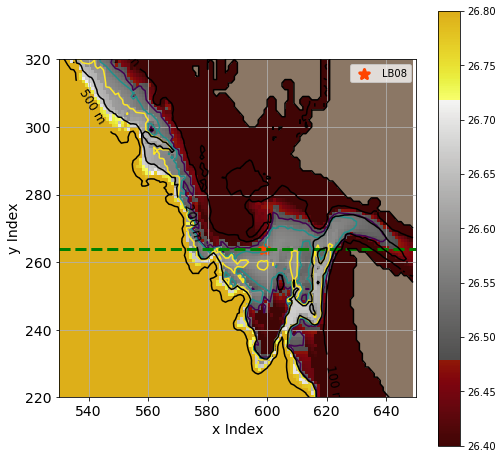

In [13]:
# Set up the figure and axes
fig, axr = plt.subplots(1, 1, figsize=(8, 8))
# land_colour = 'burlywood'
# cmap.set_bad('#8b7765')

land_colour = '#8b7765'


# Plot thalweg points on bathymetry map
viz_tools.set_aspect(axr)
# cmap = plt.get_cmap(cmo.cm.deep_r)
# cmap = plt.get_cmap('vlag')
# cmap.set_bad(land_colour)
cmap = plt.get_cmap(cmo.cm.oxy)
# cmap = plt.get_cmap('icefire')
# cmap = plt.get_cmap(cmo.cm.balance)
cmap.set_bad(land_colour)

# bathy = bathymetry
# x_slice = np.arange(bathy.shape[1])
# y_slice = np.arange(bathy.shape[0])
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)


# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.array(spic_iso_mean_august_264), cmap=cmap, vmin = -0.15, vmax = 0)

q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.array(near_bottom_rho) -1000, cmap=cmap, vmin = 26.4, vmax = 26.8)
cbar = fig.colorbar(q, ax=axr)

CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,np.ma.array(near_bottom_rho)-1000, np.arange(26.5,26.6,0.04))

axr.hlines(y=264, xmin=530, xmax=650, color= 'green', linewidths=(3,), linestyles='dashed')
axr.scatter(
    599, 264, marker='*',  s = 100, color='orangered', linewidths=(3,),
    label='LB08',
)
legend = axr.legend(loc='best', fancybox=True, framealpha=0.75)
# axr.set_title('Bathymetry Plot', fontsize = 14)
axr.set_xlabel('x Index', fontsize = 14)
axr.set_ylabel('y Index', fontsize = 14)
CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(100,110,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(200,210,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(500,510,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)


viz_tools.plot_coastline(axr, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='k')
viz_tools.plot_land_mask(axr, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color=land_colour)

axr.tick_params(axis='both',labelsize =14)

# axr.clabel(CS)
axr.set_xlim(right=650, left=530)
axr.set_ylim(top=320, bottom=220)
# axr.yaxis.tick_right()
# axr.yaxis.set_label_position("right")
axr.grid()




-0.082192294299602509

In [ ]:
near_bottom_spic[100,100]

In [61]:
j

11

In [62]:
i

169

In [63]:
tmask[:,j,i]

masked_array(data = [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0],
             mask = False,
       fill_value = 999999)

In [54]:
tmask[:,0,0]

masked_array(data = [1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1],
             mask = False,
       fill_value = 999999)

In [20]:
tmask[31,100,100]

0

In [23]:
np.min(np.where(tmask[:,100,100] == 0))

22

In [29]:
sal_mean_august[21,100,100]

33.756145

In [30]:
z_subset[100,100]

99.612053646786705

In [17]:
lon.shape

(1021, 715)

In [30]:
lon_wcvi.shape

(170, 170)

In [31]:
lon_LB08 = -125.4775
lat_LB08 = 48.4217


y, x = geo_tools.find_closest_model_point(
           lon_LB08,lat_LB08,lon,lat,tols={
    'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})
    
print(y,x)

264 599


In [32]:

y, x = geo_tools.find_closest_model_point(
           lon_LB08,lat_LB08,lon_wcvi,lat_wcvi,tols={
    'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})
    
print(y,x)

84 119


In [33]:
sns.set_context('talk')

In [14]:
sal_0 = sal_mean_august[:24,:,:]
sal_tzyx = np.ma.masked_values(sal_0, 0)

/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:8: MatplotlibDeprecationWarning: The set_axis_bgcolor function was deprecated in version 2.0. Use set_facecolor instead.


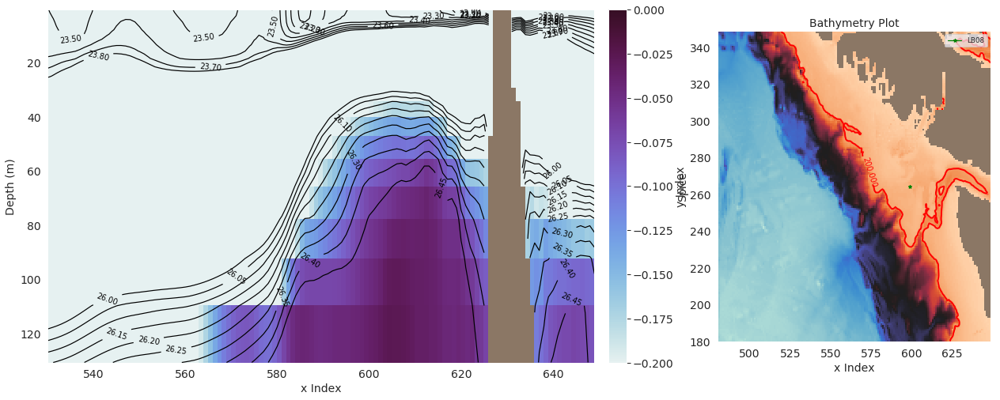

In [56]:
# Set up the figure and axes
fig, (axl, axcb, axr) = plt.subplots(1, 3, figsize=(16, 8))
# land_colour = 'burlywood'
# cmap.set_bad('#8b7765')

land_colour = '#8b7765'
for ax in (axl, axr):
    ax.set_axis_bgcolor(land_colour)
axl.set_position((0.125, 0.125, 0.6, 0.775))
axcb.set_position((0.74, 0.125, 0.02, 0.775))
axr.set_position((0.86, 0.125, 0.3, 0.775))

# Plot thalweg points on bathymetry map
viz_tools.set_aspect(axr)
# cmap = plt.get_cmap(cmo.cm.deep_r)
cmap = plt.get_cmap('icefire_r')
cmap.set_bad(land_colour)
# bathy = bathymetry
# x_slice = np.arange(bathy.shape[1])
# y_slice = np.arange(bathy.shape[0])
q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)
# plt.colorbar(q)
axr.plot(
    599, 264, marker='*',  color='green',
    label='LB08',
)
legend = axr.legend(loc='best', fancybox=True, framealpha=0.75)
axr.set_title('Bathymetry Plot', fontsize = 14)
axr.set_xlabel('x Index', fontsize = 14)
axr.set_ylabel('y Index', fontsize = 14)
CS = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], levels = [200],
                 colors=('red',),linestyles=('-',),linewidths=(2,))
axr.tick_params(axis='both',labelsize =14)

axr.clabel(CS)
axr.grid()

# Plot 24h average salinity at all depths along thalweg line
t = 12 
cmap = plt.get_cmap(cmo.cm.dense)
cmap.set_bad(land_colour)
# sal_0 = sal_july[t, :20, :,:]
spic_0 = spic_mean_august[:24,:,:]
spic_tzyx = np.ma.array(spic_0, mask = np.logical_not(sal_tzyx))


mesh = axl.pcolormesh(x_wcvi_slice[50:], zlevels[:24], spic_tzyx[:24,84,50:], cmap=cmap, vmin=-0.2, vmax =0)#, vmin=32, vmax=34)
cbar = plt.colorbar(mesh, cax=axcb)
cbar.set_label('Spice', fontsize = 14)
cbar.ax.tick_params(labelsize=14)

rho_0 = rho_mean_august[:24,:,:]-1000
rho_tzyx = np.ma.array(rho_0, mask = np.logical_not(sal_tzyx))
# rho_tzyx = np.ma.masked_values(rho_0, 0)
x, z = np.meshgrid(x_wcvi_slice, zlevels[:24])

clines = axl.contour(x_wcvi_slice[50:], zlevels[:24], rho_tzyx[:24,84,50:], np.arange(26, 26.5, 0.05), colors='black')
axl.clabel(clines, fmt='%1.2f', inline=True)

clines = axl.contour(x_wcvi_slice[50:], zlevels[:24], rho_tzyx[:24,84,50:], np.arange(23, 23.8, 0.1), colors='black')
axl.clabel(clines, fmt='%1.2f', inline=True)

axl.invert_yaxis()

axl.set_xlabel('x Index', fontsize = 14)
axl.set_ylabel('Depth (m)', fontsize = 14)
axl.tick_params(axis='both',labelsize =14)
# axl.set_ylabel('{0.long_name} [{0.units}]'.format(zlevels))
axl.grid()
# axl.set_title('Vertical section across Barkley Sound indicated on the adjacent bathy map at t={0} days'.format(t))

In [9]:
zlevels[22]

109.72928

In [12]:
sns.set_context('paper')

In [19]:
level = 20

/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:8: MatplotlibDeprecationWarning: The set_axis_bgcolor function was deprecated in version 2.0. Use set_facecolor instead.


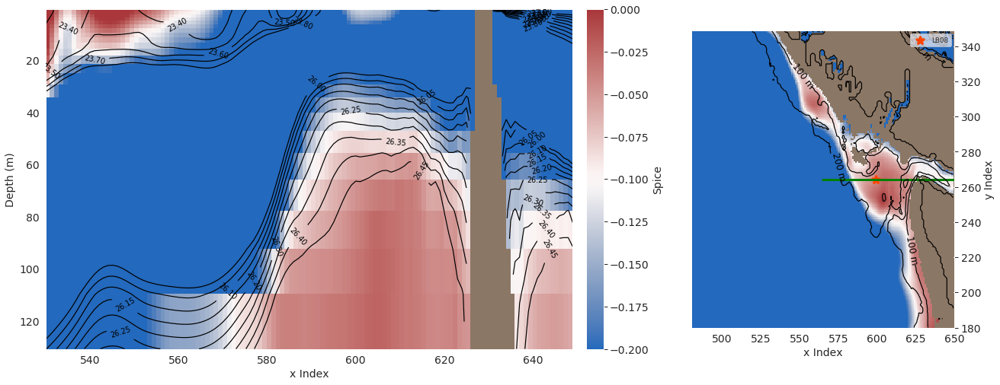

In [20]:
# Set up the figure and axes
fig, (axl, axcb, axr) = plt.subplots(1, 3, figsize=(16, 8))
# land_colour = 'burlywood'
# cmap.set_bad('#8b7765')

land_colour = '#8b7765'
for ax in (axl, axr):
    ax.set_axis_bgcolor(land_colour)
axl.set_position((0.125, 0.125, 0.6, 0.775))
axcb.set_position((0.74, 0.125, 0.02, 0.775))
axr.set_position((0.86, 0.125, 0.3, 0.775))

# Plot thalweg points on bathymetry map
viz_tools.set_aspect(axr)
# cmap = plt.get_cmap(cmo.cm.deep_r)
cmap = plt.get_cmap('vlag')
# cmap.set_bad(land_colour)
# cmap = plt.get_cmap(cmo.cm.dense)
# cmap = plt.get_cmap('icefire')
# cmap = plt.get_cmap(cmo.cm.balance)
cmap.set_bad(land_colour)

# bathy = bathymetry
# x_slice = np.arange(bathy.shape[1])
# y_slice = np.arange(bathy.shape[0])
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)
q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.array(spic_mean_august[level,...], mask = np.logical_not(sal_mean_august[level,...])), cmap=cmap, vmin = -0.2, vmax = 0)
# plt.colorbar(q)

axr.hlines(y=264, xmin=564, xmax=650, color= 'green', linewidths=(3,))
axr.scatter(
    599, 264, marker='*',  s = 100, color='orangered', linewidths=(3,),
    label='LB08',
)
legend = axr.legend(loc='best', fancybox=True, framealpha=0.75)
# axr.set_title('Bathymetry Plot', fontsize = 14)
axr.set_xlabel('x Index', fontsize = 14)
axr.set_ylabel('y Index', fontsize = 14)
CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(100,110,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(200,210,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

axr.tick_params(axis='both',labelsize =14)

# axr.clabel(CS)
axr.set_xlim(right=650)
axr.yaxis.tick_right()
axr.yaxis.set_label_position("right")
axr.grid()

# Plot 24h average salinity at all depths along thalweg line
t = 12 
# cmap = plt.get_cmap(cmo.cm.dense)
cmap.set_bad(land_colour)
# sal_0 = sal_july[t, :20, :,:]
spic_0 = spic_mean_august[:24,:,:]
spic_tzyx = np.ma.array(spic_0, mask = np.logical_not(sal_tzyx))


mesh = axl.pcolormesh(x_wcvi_slice[50:], zlevels[:24], spic_tzyx[:24,84,50:], cmap=cmap, vmin=-0.2, vmax =0)#, vmin=32, vmax=34)
cbar = plt.colorbar(mesh, cax=axcb)
cbar.set_label('Spice', fontsize = 14)
cbar.ax.tick_params(labelsize=14)

rho_0 = rho_mean_august[:24,:,:]-1000
rho_tzyx = np.ma.array(rho_0, mask = np.logical_not(sal_tzyx))
# rho_tzyx = np.ma.masked_values(rho_0, 0)
x, z = np.meshgrid(x_wcvi_slice, zlevels[:24])

clines = axl.contour(x_wcvi_slice[50:], zlevels[:24], rho_tzyx[:24,84,50:], np.arange(26, 26.5, 0.05), colors='black')
axl.clabel(clines, fmt='%1.2f', inline=True)

clines = axl.contour(x_wcvi_slice[50:], zlevels[:24], rho_tzyx[:24,84,50:], np.arange(23, 23.8, 0.1), colors='black')
axl.clabel(clines, fmt='%1.2f', inline=True)

bathy = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/Bathymetry_EastCoast_NEMO_R036_GEBCO_corr_v14.nc')
viz_tools.plot_coastline(ax, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='k')

axl.invert_yaxis()

axl.set_xlabel('x Index', fontsize = 14)
axl.set_ylabel('Depth (m)', fontsize = 14)
axl.tick_params(axis='both',labelsize =14)
# axl.set_ylabel('{0.long_name} [{0.units}]'.format(zlevels))
axl.grid()

# axl.set_title('Vertical section across Barkley Sound indicated on the adjacent bathy map at t={0} days'.format(t))

In [9]:
iso_NEP = nc.Dataset('/data/ssahu/NEP36_Extracted_Months/2013_short_slice_NEP36_along_isopycnal_larger_offshore_rho_correct.nc')


iso_spic = iso_NEP.variables['spiciness'][...];#[:,:,40:100,110:]
isot = iso_NEP.variables['isot']
nc_tools.show_variables(iso_NEP)

odict_keys(['x', 'y', 'isot', 'time_counter', 'spiciness', 'temperature', 'salinity'])


In [23]:
isot[4]

masked_array(data = 26.399999618530273,
             mask = False,
       fill_value = 1e+20)

In [24]:
iso_spic.shape

(180, 7, 170, 170)

In [10]:
spic_iso_mean_august_264  = np.mean(iso_spic[88-30:119-30,4,...], axis=0)

In [11]:
spic_iso_mean_august_264

masked_array(data =
 [[-0.05978694 -0.05856998 -0.05850153 ...,         nan         nan
          nan]
 [-0.06055979 -0.05865559 -0.05770686 ...,         nan         nan
          nan]
 [-0.06176302 -0.05927171 -0.05750468 ...,         nan         nan
          nan]
 ..., 
 [-0.08624605 -0.08682234 -0.08751338 ...,         nan         nan
          nan]
 [-0.0875845  -0.08830644 -0.08912808 ...,         nan         nan
          nan]
 [-0.08932962 -0.09015878 -0.09102747 ...,         nan         nan
          nan]],
             mask =
 False,
       fill_value = 1e+20)

In [47]:
sns.set_context('paper')

In [67]:
level = 22

In [69]:
x_wcvi_slice[50]


530

/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:8: MatplotlibDeprecationWarning: The set_axis_bgcolor function was deprecated in version 2.0. Use set_facecolor instead.


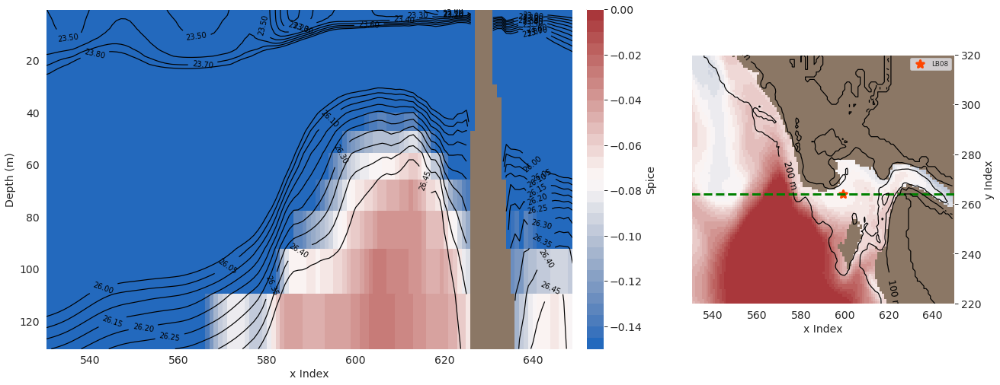

In [90]:
# Set up the figure and axes
fig, (axl, axcb, axr) = plt.subplots(1, 3, figsize=(16, 8))
# land_colour = 'burlywood'
# cmap.set_bad('#8b7765')

land_colour = '#8b7765'
for ax in (axl, axr):
    ax.set_axis_bgcolor(land_colour)
axl.set_position((0.125, 0.125, 0.6, 0.775))
axcb.set_position((0.74, 0.125, 0.02, 0.775))
axr.set_position((0.86, 0.125, 0.3, 0.775))

# Plot thalweg points on bathymetry map
viz_tools.set_aspect(axr)
# cmap = plt.get_cmap(cmo.cm.deep_r)
cmap = plt.get_cmap('vlag', 30)
# cmap.set_bad(land_colour)
# cmap = plt.get_cmap(cmo.cm.dense)
# cmap = plt.get_cmap('icefire')
# cmap = plt.get_cmap(cmo.cm.balance)
cmap.set_bad(land_colour)

# bathy = bathymetry
# x_slice = np.arange(bathy.shape[1])
# y_slice = np.arange(bathy.shape[0])
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)
# q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], cmap=cmap, vmin=0)

spic_iso_mean_august_264[np.isnan(spic_iso_mean_august_264)] = 0
spic_iso_mean_august_264 = np.ma.masked_equal(spic_iso_mean_august_264, value=0)

q = axr.pcolormesh(x_wcvi_slice,y_wcvi_slice,np.ma.array(spic_iso_mean_august_264), cmap=cmap, vmin = -0.15, vmax = 0)
# plt.colorbar(q)

axr.hlines(y=264, xmin=530, xmax=650, color= 'green', linewidths=(3,), linestyles='dashed')
axr.scatter(
    599, 264, marker='*',  s = 100, color='orangered', linewidths=(3,),
    label='LB08',
)
legend = axr.legend(loc='best', fancybox=True, framealpha=0.75)
# axr.set_title('Bathymetry Plot', fontsize = 14)
axr.set_xlabel('x Index', fontsize = 14)
axr.set_ylabel('y Index', fontsize = 14)
CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(100,110,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)
CS1 = axr.contour(x_wcvi_slice,y_wcvi_slice,Z[180:350,480:650], np.arange(200,210,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

axr.tick_params(axis='both',labelsize =14)

# axr.clabel(CS)
axr.set_xlim(right=650, left=530)
axr.set_ylim(top=320, bottom=220)
axr.yaxis.tick_right()
axr.yaxis.set_label_position("right")
axr.grid()

# Plot 24h average salinity at all depths along thalweg line
t = 12 
# cmap = plt.get_cmap(cmo.cm.dense)
cmap.set_bad(land_colour)
# sal_0 = sal_july[t, :20, :,:]
spic_0 = spic_mean_august[:24,:,:]
spic_tzyx = np.ma.array(spic_0, mask = np.logical_not(sal_tzyx))


mesh = axl.pcolormesh(x_wcvi_slice[50:], zlevels[:24], spic_tzyx[:24,84,50:], cmap=cmap, vmin=-0.15, vmax =0)#, vmin=32, vmax=34)
cbar = plt.colorbar(mesh, cax=axcb)
cbar.set_label('Spice', fontsize = 14)
cbar.ax.tick_params(labelsize=14)

rho_0 = rho_mean_august[:24,:,:]-1000
rho_tzyx = np.ma.array(rho_0, mask = np.logical_not(sal_tzyx))
# rho_tzyx = np.ma.masked_values(rho_0, 0)
x, z = np.meshgrid(x_wcvi_slice, zlevels[:24])

clines = axl.contour(x_wcvi_slice[50:], zlevels[:24], rho_tzyx[:24,84,50:], np.arange(26, 26.5, 0.05), colors='black')
axl.clabel(clines, fmt='%1.2f', inline=True)

clines = axl.contour(x_wcvi_slice[50:], zlevels[:24], rho_tzyx[:24,84,50:], np.arange(23, 23.8, 0.1), colors='black')
axl.clabel(clines, fmt='%1.2f', inline=True)

bathy = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/Bathymetry_EastCoast_NEMO_R036_GEBCO_corr_v14.nc')
viz_tools.plot_coastline(ax, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='k')

axl.invert_yaxis()

axl.set_xlabel('x Index', fontsize = 14)
axl.set_ylabel('Depth (m)', fontsize = 14)
axl.tick_params(axis='both',labelsize =14)
# axl.set_ylabel('{0.long_name} [{0.units}]'.format(zlevels))
axl.grid()

# axl.set_title('Vertical section across Barkley Sound indicated on the adjacent bathy map at t={0} days'.format(t))

### Figure 3

In [1]:
import matplotlib
matplotlib.use('TkAgg')
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import netCDF4 as nc
from scipy.interpolate import interp1d
import matplotlib.cm as cm
from salishsea_tools import (nc_tools, gsw_calls, geo_tools, viz_tools, bathy_tools)
import seabird
import cmocean as cmo
import gsw
from seabird.cnv import fCNV
import pandas as pd
import seaborn as sns
import matplotlib.gridspec as gridspec
import matplotlib.ticker as ticker
from matplotlib.offsetbox import AnchoredText
from mpl_toolkits.axes_grid1 import make_axes_locatable, axes_size
import scipy.io

In [2]:
import matplotlib
matplotlib.use('TkAgg')
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import seaborn as sns
import numpy as np

class SeabornFig2Grid():

    def __init__(self, seaborngrid, fig,  subplot_spec):
        self.fig = fig
        self.sg = seaborngrid
        self.subplot = subplot_spec
        if isinstance(self.sg, sns.axisgrid.FacetGrid) or \
            isinstance(self.sg, sns.axisgrid.PairGrid):
            self._movegrid()
        elif isinstance(self.sg, sns.axisgrid.JointGrid):
            self._movejointgrid()
        self._finalize()

    def _movegrid(self):
        """ Move PairGrid or Facetgrid """
        self._resize()
        n = self.sg.axes.shape[0]
        m = self.sg.axes.shape[1]
        self.subgrid = gridspec.GridSpecFromSubplotSpec(n,m, subplot_spec=self.subplot)
        for i in range(n):
            for j in range(m):
                self._moveaxes(self.sg.axes[i,j], self.subgrid[i,j])

    def _movejointgrid(self):
        """ Move Jointgrid """
        h= self.sg.ax_joint.get_position().height
        h2= self.sg.ax_marg_x.get_position().height
        r = int(np.round(h/h2))
        self._resize()
        self.subgrid = gridspec.GridSpecFromSubplotSpec(r+1,r+1, subplot_spec=self.subplot)

        self._moveaxes(self.sg.ax_joint, self.subgrid[1:, :-1])
        self._moveaxes(self.sg.ax_marg_x, self.subgrid[0, :-1])
        self._moveaxes(self.sg.ax_marg_y, self.subgrid[1:, -1])

    def _moveaxes(self, ax, gs):
        #https://stackoverflow.com/a/46906599/4124317
        ax.remove()
        ax.figure=self.fig
        self.fig.axes.append(ax)
        self.fig.add_axes(ax)
        ax._subplotspec = gs
        ax.set_position(gs.get_position(self.fig))
        ax.set_subplotspec(gs)

    def _finalize(self):
        plt.close(self.sg.fig)
        self.fig.canvas.mpl_connect("resize_event", self._resize)
        self.fig.canvas.draw()

    def _resize(self, evt=None):

        self.sg.fig.set_size_inches(self.fig.get_size_inches())



def get_stat_tem(obs_temp, model_temp, z_data):
    
#     func_temp = interp1d(zlevels[:model_temp.shape[0]], model_temp, fill_value='extrapolate')
#     model_temp_interp = func_temp(z_data)
    
    model_temp_interp = model_temp

    obar = np.nanmean(obs_temp)
    mprime = model_temp_interp - obar
    oprime = obs_temp - obar

    diff_sq = np.sum((model_temp_interp-obs_temp)**2)
    add_sq = np.sum((np.abs(mprime) + np.abs(oprime))**2)

    ws = 1-diff_sq/add_sq



    error = model_temp_interp - obs_temp
    gamma2 = np.var(error)/np.var(obs_temp)
    mean_error = np.mean(error)
    mean_abs_error = np.mean(np.abs(error))
    rms_error = np.sqrt(np.mean(error**2))
    
    return gamma2,rms_error,ws

def get_stat_sal(obs_sal, model_sal, z_data):
    
#     func_temp = interp1d(zlevels[:model_temp.shape[0]], model_temp, fill_value='extrapolate')
#     model_temp_interp = func_temp(z_data)
    
    model_temp_interp = model_sal
    obs_temp = obs_sal

    obar = np.nanmean(obs_temp)
    mprime = model_temp_interp - obar
    oprime = obs_temp - obar

    diff_sq = np.sum((model_temp_interp-obs_temp)**2)
    add_sq = np.sum((np.abs(mprime) + np.abs(oprime))**2)

    ws = 1-diff_sq/add_sq



    error = model_temp_interp - obs_temp
    gamma2 = np.var(error)/np.var(obs_temp)
    mean_error = np.mean(error)
    mean_abs_error = np.mean(np.abs(error))
    rms_error = np.sqrt(np.mean(error**2))
    
    return gamma2,rms_error,ws


/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/__init__.py:1405: UserWarning: 
This call to matplotlib.use() has no effect because the backend has already
been chosen; matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

  warnings.warn(_use_error_msg)


In [3]:
NEP = nc.Dataset('/data/ssahu/NEP36_Extracted_Months/NEP36_2013_T_S_Spice_larger_offshore_rho_correct.nc')


sal = NEP.variables['vosaline']
temp = NEP.variables['votemper']
spic = NEP.variables['spiciness']
rho = NEP.variables['density']


sal_mean_august  = np.mean(sal[88:119,...], axis=0)
temp_mean_august = np.mean(temp[88:119,...], axis=0)
spic_mean_august = np.mean(spic[88:119,...], axis=0)
rho_mean_august  = np.mean(rho[88:119,...], axis=0)






In [4]:
sns.set_context('paper')
sns.set_style('darkgrid')

In [5]:
zlevels = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/CDF_COMB_COMPRESSED/NEP036-N30_IN_20140915_00001440_grid_T.nc').variables['deptht'][:32]
y_wcvi_slice = np.arange(180,350)
x_wcvi_slice = np.arange(480,650)


bathy = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/Bathymetry_EastCoast_NEMO_R036_GEBCO_corr_v14.nc')

Z = bathy.variables['Bathymetry'][:]

lon = bathy['nav_lon'][180:350,480:650]
lat = bathy['nav_lat'][180:350,480:650]

In [6]:
survey_mat_file_A = '/data/ssahu/Falkor_2013/mvp/surveyA.mat'
survey_mat_file_B = '/data/ssahu/Falkor_2013/mvp/surveyB.mat'
survey_mat_file_D = '/data/ssahu/Falkor_2013/mvp/surveyD.mat'
survey_mat_file_E = '/data/ssahu/Falkor_2013/mvp/surveyE.mat'
survey_mat_file_G = '/data/ssahu/Falkor_2013/mvp/surveyG.mat'


all_surveys = [survey_mat_file_A, survey_mat_file_B, survey_mat_file_D, \
              survey_mat_file_E, survey_mat_file_G]

In [7]:
for file in all_surveys:


    mat = scipy.io.loadmat(file)

    depths_survey = mat['depths'][:,0]
    lat_survey = mat['latitude'][:,0]
    lon_survey = mat['longitude'][:,0] - 100
    # den_survey = mat['density'][:]
    pden_survey = mat['pden'][:]
    temp_survey = mat['temp'][:]
    sal_survey = mat['salinity'][:]
    mtime = mat['mtime'][:,0]

    pressure_survey = np.empty_like(temp_survey)
    SA_survey = np.empty_like(temp_survey)
    CT_survey = np.empty_like(temp_survey)
    spic_survey = np.empty_like(temp_survey)
    rho_survey = np.empty_like(temp_survey)



    for j in np.arange(depths_survey.shape[0]):

        for i in np.arange(lat_survey.shape[0]):

            pressure_survey[j,i] = gsw.p_from_z(-depths_survey[j],lat_survey[i])

            SA_survey[j,i] = gsw.SA_from_SP(sal_survey[j,i], pressure_survey[j,i], lon_survey[i], lat_survey[i])

            CT_survey[j,i] = gsw.CT_from_pt(sal_survey[j,i], temp_survey[j,i])

            spic_survey[j,i] = gsw.spiciness0(SA_survey[j,i], CT_survey[j,i])

            rho_survey[j,i] = gsw.density.rho(SA_survey[j,i], CT_survey[j,i], 0)

            #Values indicate that pden is the true representative of the potential density calculated by rho_survey here


    y = np.empty_like(lat_survey)
    x = np.empty_like(y)


    for i in np.arange(lat_survey.shape[0]):
        y[i], x[i] = geo_tools.find_closest_model_point(
                   lon_survey[i],lat_survey[i],lon,lat,tols={
            'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})


    model_tem_mvp_loc = np.empty((zlevels.shape[0],y.shape[0]))
    model_sal_mvp_loc = np.empty_like(model_tem_mvp_loc)

    for i in np.arange(y.shape[0]):

        model_tem_mvp_loc[:,i] = temp_mean_august[:,y[i].astype(int),x[i].astype(int)]
        model_sal_mvp_loc[:,i] = sal_mean_august[:,y[i].astype(int),x[i].astype(int)]

    ## Now let us bring the MVP data to the model grid points (vertical model depth points)

    mvp_tem_loc = np.empty_like(model_tem_mvp_loc)
    mvp_sal_loc = np.empty_like(model_tem_mvp_loc)

    for k in np.arange(temp_survey.shape[1]):

        f_tem_mvp = interp1d(depths_survey[:], temp_survey[:,k], fill_value="extrapolate")

        tem_loc = f_tem_mvp(np.array(zlevels))

        mvp_tem_loc[:,k] = tem_loc

        f_sal_mvp = interp1d(depths_survey[:], sal_survey[:,k], fill_value="extrapolate")

        sal_loc = f_sal_mvp(np.array(zlevels))

        mvp_sal_loc[:,k] = sal_loc

        depth_mvp = np.empty_like(mvp_sal_loc)

        for p in np.arange(depth_mvp.shape[0]):
            depth_mvp[p,:] = zlevels[p]
            
            
    mvp_tem_loc       = mvp_tem_loc[np.nonzero(model_tem_mvp_loc)]
    model_tem_mvp_loc = model_tem_mvp_loc[np.nonzero(model_tem_mvp_loc)]

    depth_mvp = depth_mvp[np.nonzero(model_sal_mvp_loc)]

    mvp_sal_loc       = mvp_sal_loc[np.nonzero(model_sal_mvp_loc)]
    model_sal_mvp_loc = model_sal_mvp_loc[np.nonzero(model_sal_mvp_loc)]


    if file == survey_mat_file_A:

        model_tem_A = model_tem_mvp_loc
        model_sal_A = model_sal_mvp_loc

        mvp_tem_A   = mvp_tem_loc
        mvp_sal_A   = mvp_sal_loc

        depth_A     = depth_mvp


    if file == survey_mat_file_B:

        model_tem_B = model_tem_mvp_loc
        model_sal_B = model_sal_mvp_loc

        mvp_tem_B   = mvp_tem_loc
        mvp_sal_B   = mvp_sal_loc

        depth_B     = depth_mvp
        
        
    if file == survey_mat_file_D:

        model_tem_D = model_tem_mvp_loc
        model_sal_D = model_sal_mvp_loc

        mvp_tem_D   = mvp_tem_loc
        mvp_sal_D   = mvp_sal_loc

        depth_D     = depth_mvp
        
        mvp_sal_D_actual   = mvp_sal_D[np.where(model_sal_D - mvp_sal_D < 3)]
        model_sal_D_actual = model_sal_D[np.where(model_sal_D - mvp_sal_D < 3)]

        mvp_tem_D_actual   = mvp_tem_D[np.where(model_sal_D - mvp_sal_D < 3)]
        model_tem_D_actual = model_tem_D[np.where(model_sal_D - mvp_sal_D < 3)]

        depth_D_actual = depth_D[np.where(model_sal_D - mvp_sal_D < 3)]
        
        model_tem_D = model_tem_D_actual
        model_sal_D = model_sal_D_actual

        mvp_tem_D   = mvp_tem_D_actual
        mvp_sal_D   = mvp_sal_D_actual

        depth_D     = depth_D_actual


        
    
    if file == survey_mat_file_E:

        model_tem_E = model_tem_mvp_loc
        model_sal_E = model_sal_mvp_loc

        mvp_tem_E   = mvp_tem_loc
        mvp_sal_E   = mvp_sal_loc

        depth_E     = depth_mvp
        
    if file == survey_mat_file_G:

        model_tem_G = model_tem_mvp_loc
        model_sal_G = model_sal_mvp_loc

        mvp_tem_G   = mvp_tem_loc
        mvp_sal_G   = mvp_sal_loc

        depth_G     = depth_mvp   
            
        

#         return np.ndarray.flatten(model_tem_mvp_loc), np.ndarray.flatten(model_sal_mvp_loc), \
#     np.ndarray.flatten(mvp_tem_loc), np.ndarray.flatten(mvp_sal_loc), np.ndarray.flatten(depth_mvp)
    



/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:124: RuntimeWarning: invalid value encountered in less
/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:125: RuntimeWarning: invalid value encountered in less
/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:127: RuntimeWarning: invalid value encountered in less
/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:128: RuntimeWarning: invalid value encountered in less
/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:130: RuntimeWarning: invalid value encountered in less


Model vs Observed


/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


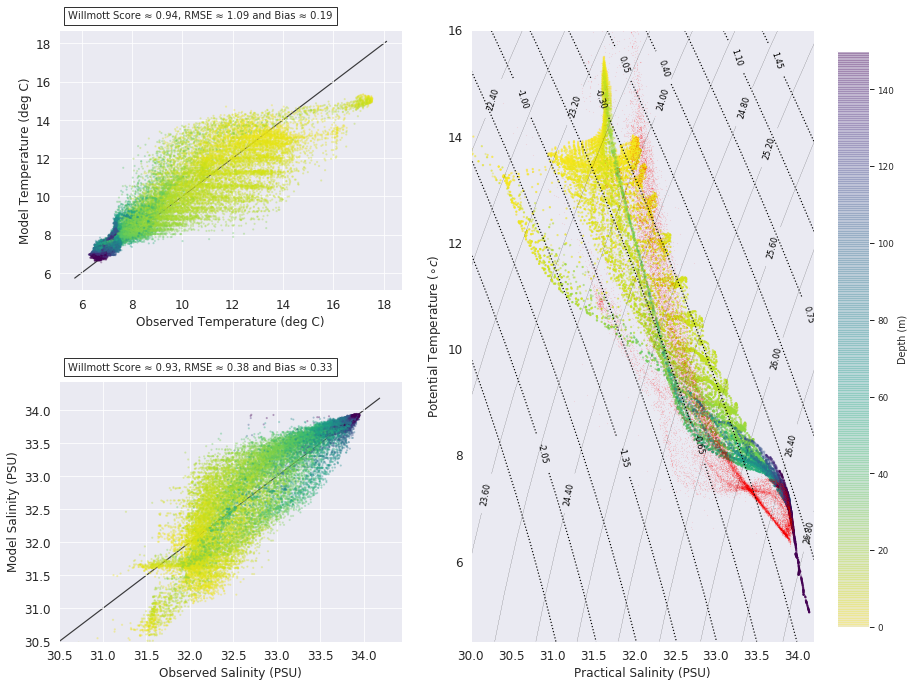

In [8]:
print("Model vs Observed")

cmin = 0
cmax = 150



import matplotlib as mpl
# norm = mpl.colors.Normalize(vmin=cmin,vmax=cmax)
# cmap = plt.get_cmap('summer')
cmap = plt.get_cmap('viridis_r')
# cmap = cmo.cm.deep

df =pd.DataFrame()
# df['Observed_temp'] = np.ndarray.flatten(mvp_tem_D_actual)
# df['Model_temp'] = np.ndarray.flatten(model_tem_D_actual)
# df['Observed_Salinity'] = np.ndarray.flatten(mvp_sal_D_actual)
# df['Model_Salinity'] = np.ndarray.flatten(model_sal_D_actual)
# df["Depth (m)"]  = np.ndarray.flatten(depth_D_actual)

df['Observed_temp'] = np.concatenate((mvp_tem_A, mvp_tem_B, mvp_tem_D, mvp_tem_E, mvp_tem_G))
df['Model_temp'] = np.concatenate((model_tem_A, model_tem_B, model_tem_D, model_tem_E, model_tem_G))
df['Observed_Salinity'] = np.concatenate((mvp_sal_A, mvp_sal_B, mvp_sal_D, mvp_sal_E, mvp_sal_G))
df['Model_Salinity'] = np.concatenate((model_sal_A, model_sal_B, model_sal_D, model_sal_E, model_sal_G))
df["Depth (m)"] = np.concatenate((depth_A, depth_B, depth_D, depth_E, depth_G))


# depth_mvp_all = np.empty_like(mvp_sal_loc)

# for p in np.arange(depth_mvp_all.shape[0]):
#     depth_mvp_all[p,:] = zlevels[p]



# fig, (ax1,ax2,ax3)  = plt.subplots(1,3,figsize=(15,5))

fig = plt.figure(1, figsize=(18,10))


gs = gridspec.GridSpec(2, 3)
# gs.update(left=0.55, right=0.98, hspace=0.05)
ax1 = plt.subplot(gs[:-1, :-2])
ax2 = plt.subplot(gs[-1, :-2])
ax3 = plt.subplot(gs[:, 1])
                 
# gs = gridspec.GridSpec(1,3, width_ratios=[1,1,1])

gs.update(left=0.05, right=0.95, bottom=0.08, top=0.93, wspace=0.2, hspace=0.35)

# ax1 = plt.subplot(gs[0,0])

# ax2 = plt.subplot(gs[0,1])

# ax3 = plt.subplot(gs[0,2])


# p = sns.relplot(x="Observed_temp", y="Model_temp", hue="Depth (m)",  sizes=(1,10),data=df, legend='brief',palette=cmo.cm.oxy)

p = df.plot.scatter(x="Observed_temp", y="Model_temp", c = "Depth (m)", s = 2, ax = ax1, cmap = cmap, vmin = cmin, vmax = cmax, alpha = 0.25, colorbar=False)

leg = ax1.get_legend()
ax1.legend(loc="best")

lims = [
    np.min([ax1.get_xlim(), ax1.get_ylim()]),  # min of both axes
    np.max([ax1.get_xlim(), ax1.get_ylim()]),  # max of both axes
]

ax1.plot(lims, lims, 'k-', alpha=0.75, zorder=0)
gamma2,rms_error,ws = get_stat_tem(df['Observed_temp'], df['Model_temp'], df["Depth (m)"])
anchored_text = AnchoredText("Willmott Score \u2248 {w:.2f}, RMSE \u2248 {r:.2f} and Bias \u2248 {b:.2f}". format(w = ws, r = rms_error, b = gamma2),prop=dict(size=10), loc=3, frameon=True,
                       bbox_to_anchor=(0., 1.),
                       bbox_transform=ax1.transAxes
                       )
ax1.add_artist(anchored_text)
ax1.tick_params(axis='both',labelsize =12)
ax1.set_xlabel('Observed Temperature (deg C)', fontsize = 12)
ax1.set_ylabel('Model Temperature (deg C)', fontsize = 12)


q = df.plot.scatter(x="Observed_Salinity", y="Model_Salinity", c = "Depth (m)", s =2, ax = ax2,  cmap = cmap, vmin = cmin, vmax = cmax, alpha = 0.25, colorbar=False)


lims = [
    np.min([ax2.get_xlim(), ax2.get_ylim()]),  # min of both axes
    np.max([ax2.get_xlim(), ax2.get_ylim()]),  # max of both axes
]

ax2.plot(lims, lims, 'k-', alpha=0.75, zorder=0)
gamma2,rms_error,ws = get_stat_sal(df['Observed_Salinity'], df['Model_Salinity'], df["Depth (m)"])
anchored_text = AnchoredText("Willmott Score \u2248 {w:.2f}, RMSE \u2248 {r:.2f} and Bias \u2248 {b:.2f}". format(w = ws, r = rms_error, b = gamma2),prop=dict(size=10), loc=3, frameon=True,
                       bbox_to_anchor=(0., 1.),
                       bbox_transform=ax2.transAxes
                       )
ax2.add_artist(anchored_text)
ax2.tick_params(axis='both',labelsize =12)
ax2.set_xlabel('Observed Salinity (PSU)', fontsize = 12)
ax2.set_ylabel('Model Salinity (PSU)', fontsize = 12)


ax2.set_ylim(bottom=30.5)
ax2.set_xlim(left=30.5)

# Figure out boudaries (mins and maxs)
smin = np.nanmin(model_sal_G)  - (0.01 * np.nanmin(model_sal_G))
smax = np.nanmax(model_sal_E)  + (0.01 * np.nanmax(model_sal_E))
tmin = np.nanmin(model_tem_E) - (0.1 * np.nanmax(model_tem_E))
tmax = np.nanmax(model_tem_E) + (0.1 * np.nanmax(model_tem_E))
 
# Calculate how many gridcells we need in the x and y dimensions
xdim = int(round((smax-smin)/0.1+1,0))
ydim = int(round((tmax-tmin)+1,0))
 
# Create empty grid of zeros
dens_1 = np.empty((ydim,xdim))
spic_1 = np.empty((ydim,xdim))
SA = np.empty((xdim))
CT = np.empty((ydim)) 
# Create temp and salt vectors of appropiate dimensions
ti = np.linspace(1,ydim-1,ydim)+tmin
si = np.linspace(1,xdim-1,xdim)*0.1+smin
 
# Loop to fill in grid with densities
for j in range(0,int(ydim)):
    for i in range(0, int(xdim)):
        
        SA[i] = gsw.SA_from_SP(si[i], 0, np.mean(lon), np.mean(lat))

        CT[j] = gsw.CT_from_pt(si[i], ti[j])
        
        dens_1[j,i]=gsw.rho(SA[i],CT[j],0)
        
        spic_1[j,i] = gsw.spiciness0(SA[i],CT[j])
 
# Substract 1000 to convert to sigma-t
dens_1 = dens_1 - 1000
 


ind = np.argsort(df['Depth (m)'])

dz = pd.DataFrame()

dz['Model_temp']    = df['Model_temp'][ind]
dz['Observed_temp'] = df['Observed_temp'][ind]

dz['Model_Salinity'] = df['Model_Salinity'][ind]
dz['Observed_Salinity'] = df['Observed_Salinity'][ind]

dz['Depth (m)'] = df['Depth (m)'][ind]

p = dz.plot.scatter(x="Model_Salinity", y="Model_temp", c = 'Depth (m)', s = 2, ax = ax3, cmap = cmap, vmin = cmin, vmax = cmax, alpha = 0.25, colorbar = False)

# p = dz.plot.scatter(x="Model_Salinity", y="Model_temp", c = 'green', s = 2, ax = ax3, cmap = cmap, vmin = cmin, vmax = cmax, alpha = 0.25, colorbar = False)

s = dz.plot.scatter(x="Observed_Salinity", y="Observed_temp", c = 'red', s = 0.1, ax = ax3, cmap = cmap, vmin = cmin, vmax = cmax, alpha = 0.1, colorbar = False)

diff_tem = dz['Model_temp'] - dz["Observed_temp"]
diff_sal = dz['Model_Salinity'] - dz['Observed_Salinity']

# n = 500
# ax3.fill_between(dz['Model_Salinity'][::n], dz['Model_temp'][::n], dz['Model_temp'][::n]+diff_tem[::n],\
#                 color='red', alpha=0.08)

# ax3.errorbar(x = df['Model_Salinity'], y = df['Model_temp'], xerr=diff_sal, yerr=diff_tem, \
#             errorevery=500, ecolor= 'red', fmt=None, alpha = 0.3,)

CS = ax3.contour(si,ti,dens_1, np.arange(22.4,27,0.4), linestyles='dashed', linewidths = 0.2,colors='k')
CS1 = ax3.contour(si,ti,spic_1,np.arange(-2.4,1.5,0.35), linestyles='dotted', colors='k')
plt.clabel(CS, fontsize=8, inline=1, fmt='%0.2f') # Label every second level
plt.clabel(CS1, fontsize=8, inline=1, fmt='%0.2f') # Label every second level


# CS = plt.contour(si,ti,dens_1, linestyles='dashed', colors='k')
# CS1 = plt.contour(si,ti,spic_1, linestyles='solid', colors='k')
# plt.clabel(CS, fontsize=8, inline=1, fmt='%0.1f') # Label every second level
# plt.clabel(CS1, fontsize=8, inline=1, fmt='%0.1f') # Label every second level


ax3.set_xlim(30,34.2)
ax3.set_ylim(top=16)



 
ax3.set_xlabel('Practical Salinity (PSU)', fontsize = 12)
ax3.set_ylabel('Potential Temperature ($\circ c$)', fontsize = 12)
ax3.tick_params(axis='both',labelsize =12)

ax3.grid()

legend = ax3.legend(loc='upper right', fancybox=True, framealpha=0.25)




# fig.tight_layout()

im = plt.gca().get_children()[0]
cax = fig.add_axes([0.65,0.1,0.025,0.8]) 
cbar = fig.colorbar(im, cax=cax)
cbar.set_label("Depth (m)")


Model vs Observed


/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


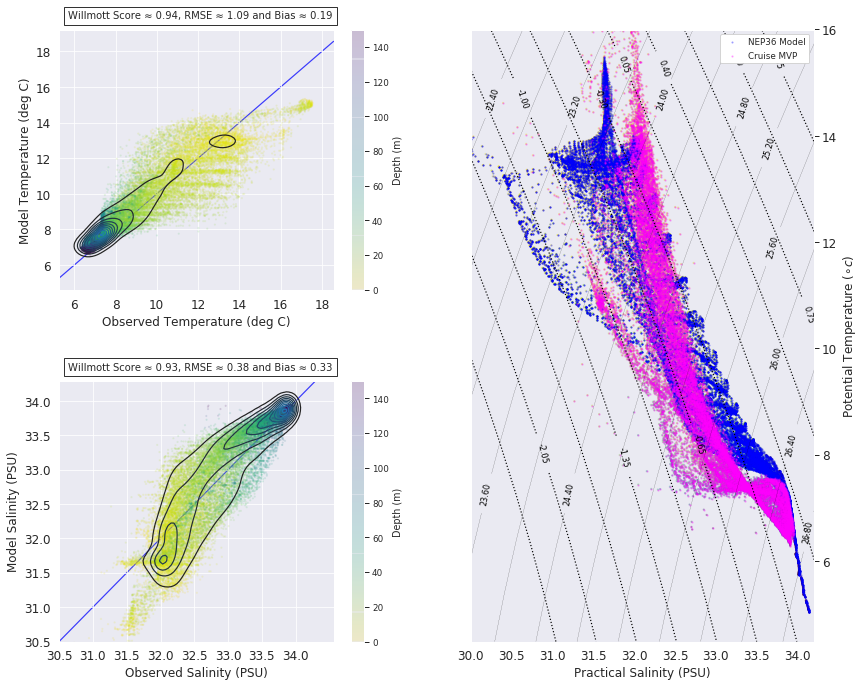

In [10]:
print("Model vs Observed")

cmin = 0
cmax = 150



import matplotlib as mpl
# norm = mpl.colors.Normalize(vmin=cmin,vmax=cmax)
# cmap = plt.get_cmap('summer')
cmap = plt.get_cmap('viridis_r')
# cmap = cmo.cm.deep

df =pd.DataFrame()
# df['Observed_temp'] = np.ndarray.flatten(mvp_tem_D_actual)
# df['Model_temp'] = np.ndarray.flatten(model_tem_D_actual)
# df['Observed_Salinity'] = np.ndarray.flatten(mvp_sal_D_actual)
# df['Model_Salinity'] = np.ndarray.flatten(model_sal_D_actual)
# df["Depth (m)"]  = np.ndarray.flatten(depth_D_actual)

df['Observed_temp'] = np.concatenate((mvp_tem_A, mvp_tem_B, mvp_tem_D, mvp_tem_E, mvp_tem_G))
df['Model_temp'] = np.concatenate((model_tem_A, model_tem_B, model_tem_D, model_tem_E, model_tem_G))
df['Observed_Salinity'] = np.concatenate((mvp_sal_A, mvp_sal_B, mvp_sal_D, mvp_sal_E, mvp_sal_G))
df['Model_Salinity'] = np.concatenate((model_sal_A, model_sal_B, model_sal_D, model_sal_E, model_sal_G))
df["Depth (m)"] = np.concatenate((depth_A, depth_B, depth_D, depth_E, depth_G))


# depth_mvp_all = np.empty_like(mvp_sal_loc)

# for p in np.arange(depth_mvp_all.shape[0]):
#     depth_mvp_all[p,:] = zlevels[p]



# fig, (ax1,ax2,ax3)  = plt.subplots(1,3,figsize=(15,5))

fig = plt.figure(1, figsize=(18,10))


gs = gridspec.GridSpec(2, 3)
# gs.update(left=0.55, right=0.98, hspace=0.05)
ax1 = plt.subplot(gs[:-1, :-2])
ax2 = plt.subplot(gs[-1, :-2])
ax3 = plt.subplot(gs[:, 1])
                 
# gs = gridspec.GridSpec(1,3, width_ratios=[1,1,1])

gs.update(left=0.05, right=0.95, bottom=0.08, top=0.93, wspace=0.2, hspace=0.35)

# ax1 = plt.subplot(gs[0,0])

# ax2 = plt.subplot(gs[0,1])

# ax3 = plt.subplot(gs[0,2])


# p = sns.relplot(x="Observed_temp", y="Model_temp", hue="Depth (m)",  sizes=(1,10),data=df, legend='brief',palette=cmo.cm.oxy)

p = df.plot.scatter(x="Observed_temp", y="Model_temp", c = "Depth (m)", s = 2, ax = ax1, cmap = cmap, vmin = cmin, vmax = cmax, alpha = 0.1)


temp_obs = np.array(df['Observed_temp'])
temp_model = np.array(df['Model_temp'])

p = sns.kdeplot(temp_obs[~np.isnan(temp_obs)], temp_model[~np.isnan(temp_obs)], ax = ax1)
leg = ax1.get_legend()
ax1.legend(loc="best")

lims = [
    np.min([ax1.get_xlim(), ax1.get_ylim()]),  # min of both axes
    np.max([ax1.get_xlim(), ax1.get_ylim()]),  # max of both axes
]

ax1.plot(lims, lims, 'b-', alpha=0.75, zorder=0)
gamma2,rms_error,ws = get_stat_tem(df['Observed_temp'], df['Model_temp'], df["Depth (m)"])
anchored_text = AnchoredText("Willmott Score \u2248 {w:.2f}, RMSE \u2248 {r:.2f} and Bias \u2248 {b:.2f}". format(w = ws, r = rms_error, b = gamma2),prop=dict(size=10), loc=3, frameon=True,
                       bbox_to_anchor=(0., 1.),
                       bbox_transform=ax1.transAxes
                       )
ax1.add_artist(anchored_text)
ax1.tick_params(axis='both',labelsize =12)
ax1.set_xlabel('Observed Temperature (deg C)', fontsize = 12)
ax1.set_ylabel('Model Temperature (deg C)', fontsize = 12)


q = df.plot.scatter(x="Observed_Salinity", y="Model_Salinity", c = "Depth (m)", s =2, ax = ax2,  cmap = cmap, vmin = cmin, vmax = cmax, alpha = 0.1)



sal_obs = np.array(df['Observed_Salinity'])
sal_model = np.array(df['Model_Salinity'])

q = sns.kdeplot(sal_obs[~np.isnan(sal_obs)], sal_model[~np.isnan(sal_obs)], ax = ax2)

lims = [
    np.min([ax2.get_xlim(), ax2.get_ylim()]),  # min of both axes
    np.max([ax2.get_xlim(), ax2.get_ylim()]),  # max of both axes
]

ax2.plot(lims, lims, 'b-', alpha=0.75, zorder=0)
gamma2,rms_error,ws = get_stat_sal(df['Observed_Salinity'], df['Model_Salinity'], df["Depth (m)"])
anchored_text = AnchoredText("Willmott Score \u2248 {w:.2f}, RMSE \u2248 {r:.2f} and Bias \u2248 {b:.2f}". format(w = ws, r = rms_error, b = gamma2),prop=dict(size=10), loc=3, frameon=True,
                       bbox_to_anchor=(0., 1.),
                       bbox_transform=ax2.transAxes
                       )
ax2.add_artist(anchored_text)

# start, end = ax2.get_xlim()
start, end = 30.5, 34.5
stepsize = 0.5
ax2.xaxis.set_ticks(np.arange(start, end, stepsize))
ax2.xaxis.set_major_formatter(ticker.FormatStrFormatter('%0.1f'))

ax2.tick_params(axis='both',labelsize =12)
ax2.set_xlabel('Observed Salinity (PSU)', fontsize = 12)
ax2.set_ylabel('Model Salinity (PSU)', fontsize = 12)


ax2.set_ylim(bottom=30.5)
ax2.set_xlim(left=30.5)

# Figure out boudaries (mins and maxs)
smin = np.nanmin(model_sal_G)  - (0.01 * np.nanmin(model_sal_G))
smax = np.nanmax(model_sal_E)  + (0.01 * np.nanmax(model_sal_E))
tmin = np.nanmin(model_tem_E) - (0.1 * np.nanmax(model_tem_E))
tmax = np.nanmax(model_tem_E) + (0.1 * np.nanmax(model_tem_E))
 
# Calculate how many gridcells we need in the x and y dimensions
xdim = int(round((smax-smin)/0.1+1,0))
ydim = int(round((tmax-tmin)+1,0))
 
# Create empty grid of zeros
dens_1 = np.empty((ydim,xdim))
spic_1 = np.empty((ydim,xdim))
SA = np.empty((xdim))
CT = np.empty((ydim)) 
# Create temp and salt vectors of appropiate dimensions
ti = np.linspace(1,ydim-1,ydim)+tmin
si = np.linspace(1,xdim-1,xdim)*0.1+smin
 
# Loop to fill in grid with densities
for j in range(0,int(ydim)):
    for i in range(0, int(xdim)):
        
        SA[i] = gsw.SA_from_SP(si[i], 0, np.mean(lon), np.mean(lat))

        CT[j] = gsw.CT_from_pt(si[i], ti[j])
        
        dens_1[j,i]=gsw.rho(SA[i],CT[j],0)
        
        spic_1[j,i] = gsw.spiciness0(SA[i],CT[j])
 
# Substract 1000 to convert to sigma-t
dens_1 = dens_1 - 1000
 


ind = np.argsort(df['Depth (m)'])

dz = pd.DataFrame()

dz['Model_temp']    = df['Model_temp'][ind]
dz['Observed_temp'] = df['Observed_temp'][ind]

dz['Model_Salinity'] = df['Model_Salinity'][ind]
dz['Observed_Salinity'] = df['Observed_Salinity'][ind]

dz['Depth (m)'] = df['Depth (m)'][ind]


p = dz.plot.scatter(x="Model_Salinity", y="Model_temp", c = 'Depth (m)', s = 2, marker = 'o' , ax = ax3, cmap = cmap, vmin = cmin, vmax = cmax, alpha = 0.25, colorbar = False)

s = dz.plot.scatter(x="Observed_Salinity", y="Observed_temp", c = 'Depth (m)', s = 2, marker = 'X',  ax = ax3, cmap = cmap, vmin = cmin, vmax = cmax, alpha = 0.25, colorbar = False)

p = dz.plot.scatter(x="Model_Salinity", y="Model_temp", c = 'blue', s = 2, marker = 'o' , ax = ax3,  alpha = 0.25, label = 'NEP36 Model')

s = dz.plot.scatter(x="Observed_Salinity", y="Observed_temp", c = 'magenta', s = 2, marker = 'X', ax = ax3,  alpha = 0.25, label = 'Cruise MVP')


# ax3.legend((p, s),
#            ('NEP36 Model', 'Cruise MVP'),
#            scatterpoints=1,
#            loc='lower left',
#            ncol=1,
#            fontsize=8)

diff_tem = dz['Model_temp'] - dz["Observed_temp"]
diff_sal = dz['Model_Salinity'] - dz['Observed_Salinity']

# n = 500
# ax3.fill_between(dz['Model_Salinity'][::n], dz['Model_temp'][::n], dz['Model_temp'][::n]+diff_tem[::n],\
#                 color='red', alpha=0.08)

# ax3.errorbar(x = df['Model_Salinity'], y = df['Model_temp'], xerr=diff_sal, yerr=diff_tem, \
#             errorevery=500, ecolor= 'red', fmt=None, alpha = 0.3,)

CS = ax3.contour(si,ti,dens_1, np.arange(22.4,27,0.4), linestyles='dashed', linewidths = 0.2,colors='k')
CS1 = ax3.contour(si,ti,spic_1,np.arange(-2.4,1.5,0.35), linestyles='dotted', colors='k')
plt.clabel(CS, fontsize=8, inline=1, fmt='%0.2f') # Label every second level
plt.clabel(CS1, fontsize=8, inline=1, fmt='%0.2f') # Label every second level


# CS = plt.contour(si,ti,dens_1, linestyles='dashed', colors='k')
# CS1 = plt.contour(si,ti,spic_1, linestyles='solid', colors='k')
# plt.clabel(CS, fontsize=8, inline=1, fmt='%0.1f') # Label every second level
# plt.clabel(CS1, fontsize=8, inline=1, fmt='%0.1f') # Label every second level


ax3.set_xlim(30,34.2)
ax3.set_ylim(top=16)



 
ax3.set_xlabel('Practical Salinity (PSU)', fontsize = 12)
ax3.set_ylabel('Potential Temperature ($\circ c$)', fontsize = 12)
ax3.tick_params(axis='both',labelsize =12)

ax3.grid()

legend = ax3.legend(loc='upper right',  framealpha = 1, facecolor = 'white')

ax3.yaxis.tick_right()
ax3.yaxis.set_label_position("right")

# fig.tight_layout()


# im = plt.gca().get_children()[0]
# cax = fig.add_axes([0.31,0.1,0.025,0.8]) 
# cbar = fig.colorbar(im, cax=cax)
# cbar.set_label("Depth (m)")


In [37]:
import matplotlib.cm as cm

In [151]:
def errorfill(x, y, yerr, color=None, alpha_fill=0.3, ax=None):
    ax = ax if ax is not None else plt.gca()
    if color is None:
        color = ax._get_lines.color_cycle.next()
    if np.isscalar(yerr) or len(yerr) == len(y):
        ymin = y - yerr
        ymax = y + yerr
    elif len(yerr) == 2:
        ymin, ymax = yerr
    ax.plot(x, y, color=color)
    ax.fill_between(x, ymax, ymin, color=color, alpha=alpha_fill)

/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


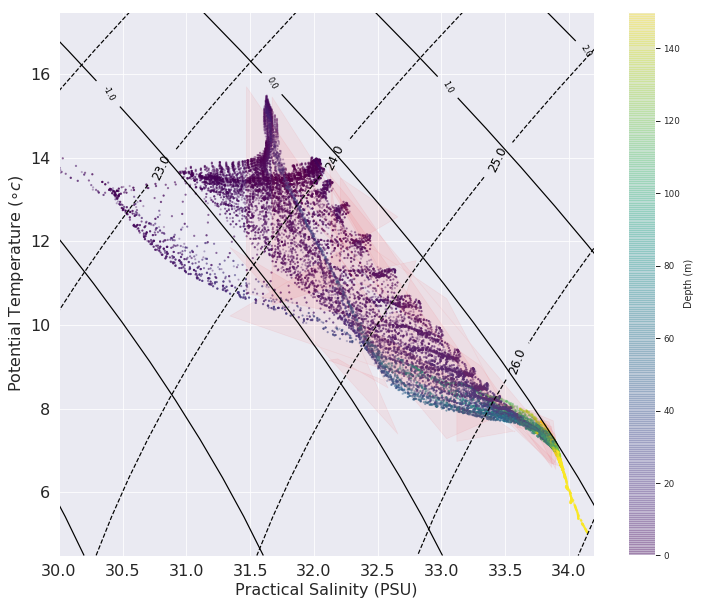

In [222]:

# cmap = cmo.cm.thermal
cmap = plt.get_cmap('viridis')



# colors = cmo.cm.phase(np.linspace(0, 1, 200))

# model_survey_sal_G1 = model_survey_sal_G[model_survey_sal_G>30]
# model_survey_temp_G1 = model_survey_temp_G[model_survey_sal_G>30]

# Figure out boudaries (mins and maxs)
smin = np.nanmin(model_sal_G)  - (0.01 * np.nanmin(model_sal_G))
smax = np.nanmax(model_sal_E)  + (0.01 * np.nanmax(model_sal_E))
tmin = np.nanmin(model_tem_E) - (0.1 * np.nanmax(model_tem_E))
tmax = np.nanmax(model_tem_E) + (0.1 * np.nanmax(model_tem_E))
 
# Calculate how many gridcells we need in the x and y dimensions
xdim = int(round((smax-smin)/0.1+1,0))
ydim = int(round((tmax-tmin)+1,0))
 
# Create empty grid of zeros
dens_1 = np.empty((ydim,xdim))
spic_1 = np.empty((ydim,xdim))
SA = np.empty((xdim))
CT = np.empty((ydim)) 
# Create temp and salt vectors of appropiate dimensions
ti = np.linspace(1,ydim-1,ydim)+tmin
si = np.linspace(1,xdim-1,xdim)*0.1+smin
 
# Loop to fill in grid with densities
for j in range(0,int(ydim)):
    for i in range(0, int(xdim)):
        
        SA[i] = gsw.SA_from_SP(si[i], 0, np.mean(lon), np.mean(lat))

        CT[j] = gsw.CT_from_pt(si[i], ti[j])
        
        dens_1[j,i]=gsw.rho(SA[i],CT[j],0)
        
        spic_1[j,i] = gsw.spiciness0(SA[i],CT[j])
 
# Substract 1000 to convert to sigma-t
dens_1 = dens_1 - 1000
 
# Plot data ***********************************************
# fig1, ax = plt.subplots(1, 1, figsize=(10,10))

fig = plt.figure(1, figsize=(12,10))
                 
gs = gridspec.GridSpec(1,1)

# gs.update(left=0.05, right=0.95, bottom=0.08, top=0.93, wspace=0.02, hspace=0.03)

ax = plt.subplot(gs[0,0])

# ax2 = plt.subplot(gs[0,1])

# m = cm.ScalarMappable(cmap=plt.get_cmap(cmo.cm.balance))
# m.set_array(df['Depth (m)'])
# m.set_clim(50, 200)
# plt.colorbar(m)

# df =pd.DataFrame()

# df['Observed_temp'] = np.concatenate((mvp_tem_A, mvp_tem_B, mvp_tem_D, mvp_tem_E, mvp_tem_G))
# df['Model_temp'] = np.concatenate((model_tem_A, model_tem_B, model_tem_D, model_tem_E, model_tem_G))
# df['Observed_Salinity'] = np.concatenate((mvp_sal_A, mvp_sal_B, mvp_sal_D, mvp_sal_E, mvp_sal_G))
# df['Model_Salinity'] = np.concatenate((model_sal_A, model_sal_B, model_sal_D, model_sal_E, model_sal_G))
# df["Depth (m)"] = np.concatenate((depth_A, depth_B, depth_D, depth_E, depth_G))


p = df.plot.scatter(x="Model_Salinity", y="Model_temp", c = 'Depth (m)', s = 2, ax = ax, cmap = cmap, vmin = cmin, vmax = cmax, alpha = 0.25)

diff_tem = df['Model_temp'] - df["Observed_temp"]
diff_sal = df['Model_Salinity'] - df['Observed_Salinity']

n = 800
ax.fill_between(df['Model_Salinity'][::n], df['Model_temp'][::n]+diff_tem[::n], df['Model_temp'][::n]-diff_tem[::n], \
                color='red', alpha=0.05)

# ax.fill_between(df['Model_Salinity'][::500]+diff_sal[::500],df['Model_Salinity'][::500]-diff_sal[::500], df['Model_temp'][::500], \
#                 color='red', alpha=0.05)
# ax.errorbar(x = df['Model_Salinity'], y = df['Model_temp'], xerr=diff_sal, \
#             errorevery=500, ecolor= 'red', fmt=None, alpha = 0.3,)


# errorfill(alpha_fill=0.1, ax=ax, color='red', x = df['Model_Salinity'], \
#           y = df['Model_temp'], yerr=diff_tem, fmt=None)
CS = plt.contour(si,ti,dens_1, linestyles='dashed', colors='k')
CS1 = plt.contour(si,ti,spic_1, linestyles='solid', colors='k')
plt.clabel(CS, fontsize=12, inline=1, fmt='%0.1f') # Label every second level
plt.clabel(CS1, fontsize=8, inline=1, fmt='%0.1f') # Label every second level


ax.set_xlim(30,34.2)



 
ax.set_xlabel('Practical Salinity (PSU)', fontsize = 16)
ax.set_ylabel('Potential Temperature ($\circ c$)', fontsize = 16)
ax.tick_params(axis='both',labelsize =16)
# ax.set_xlim(31.5,)


legend = ax.legend(loc='upper right', fancybox=True, framealpha=0.25)

In [64]:
type(np.array(df['Depth (m)']).astype(int))

numpy.ndarray

For Survey E


/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


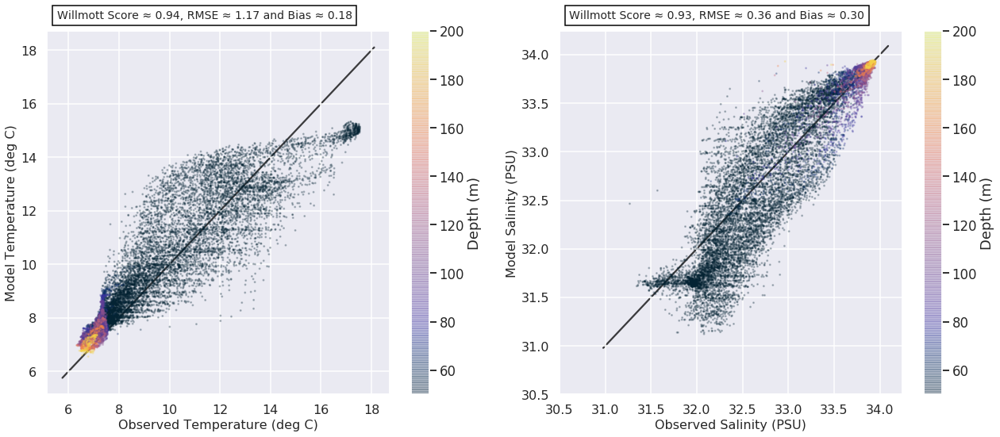

In [108]:
print("For Survey E")

cmin = 50
cmax = 200



import matplotlib as mpl
# norm = mpl.colors.Normalize(vmin=cmin,vmax=cmax)
# cmap = plt.get_cmap('summer')
# cmap = plt.get_cmap('icefire')
cmap = cmo.cm.thermal

df =pd.DataFrame()
df['Observed_temp'] = np.ndarray.flatten(mvp_tem_E)
df['Model_temp'] = np.ndarray.flatten(model_tem_E)
df['Observed_Salinity'] = np.ndarray.flatten(mvp_sal_E)
df['Model_Salinity'] = np.ndarray.flatten(model_sal_E)
df["Depth (m)"]  = np.ndarray.flatten(depth_E)

# df['Observed_temp'] = np.concatenate((mvp_tem_A, mvp_tem_B, mvp_tem_D, mvp_tem_E, mvp_tem_G))
# df['Model_temp'] = np.concatenate((model_tem_A, model_tem_B, model_tem_D, model_tem_E, model_tem_G))
# df['Observed_Salinity'] = np.concatenate((mvp_sal_A, mvp_sal_B, mvp_sal_D, mvp_sal_E, mvp_sal_G))
# df['Model_Salinity'] = np.concatenate((model_sal_A, model_sal_B, model_sal_D, model_sal_E, model_sal_G))
# df["Depth (m)"] = np.concatenate((depth_A, depth_B, depth_D, depth_E, depth_G))


# depth_mvp_all = np.empty_like(mvp_sal_loc)

# for p in np.arange(depth_mvp_all.shape[0]):
#     depth_mvp_all[p,:] = zlevels[p]



# fig, (ax1,ax2,ax3)  = plt.subplots(1,3,figsize=(15,5))

fig = plt.figure(1, figsize=(18,8))
                 
gs = gridspec.GridSpec(1,2, width_ratios=[1,1])

# gs.update(left=0.05, right=0.95, bottom=0.08, top=0.93, wspace=0.02, hspace=0.03)

ax1 = plt.subplot(gs[0,0])

ax2 = plt.subplot(gs[0,1])

# ax3 = plt.subplot(gs[0,2])


            

# p = sns.relplot(x="Observed_temp", y="Model_temp", hue="Depth (m)",  sizes=(1,10),data=df, legend='brief',palette=cmo.cm.oxy)

p = df.plot.scatter(x="Observed_temp", y="Model_temp", c = "Depth (m)", s = 2, ax = ax1, cmap = cmap, vmin = cmin, vmax = cmax, alpha = 0.25)

leg = ax1.get_legend()
ax1.legend(loc="best")

lims = [
    np.min([ax1.get_xlim(), ax1.get_ylim()]),  # min of both axes
    np.max([ax1.get_xlim(), ax1.get_ylim()]),  # max of both axes
]

ax1.plot(lims, lims, 'k-', alpha=0.75, zorder=0)
gamma2,rms_error,ws = get_stat_tem(df['Observed_temp'], df['Model_temp'], df["Depth (m)"])
anchored_text = AnchoredText("Willmott Score \u2248 {w:.2f}, RMSE \u2248 {r:.2f} and Bias \u2248 {b:.2f}". format(w = ws, r = rms_error, b = gamma2),prop=dict(size=14), loc=3, frameon=True,
                       bbox_to_anchor=(0., 1.),
                       bbox_transform=ax1.transAxes
                       )
ax1.add_artist(anchored_text)
ax1.tick_params(axis='both',labelsize =16)
ax1.set_xlabel('Observed Temperature (deg C)', fontsize = 16)
ax1.set_ylabel('Model Temperature (deg C)', fontsize = 16)


q = df.plot.scatter(x="Observed_Salinity", y="Model_Salinity", c = "Depth (m)", s =2, ax = ax2,  cmap = cmap, vmin = cmin, vmax = cmax, alpha = 0.25)


lims = [
    np.min([ax2.get_xlim(), ax2.get_ylim()]),  # min of both axes
    np.max([ax2.get_xlim(), ax2.get_ylim()]),  # max of both axes
]

ax2.plot(lims, lims, 'k-', alpha=0.75, zorder=0)
gamma2,rms_error,ws = get_stat_sal(df['Observed_Salinity'], df['Model_Salinity'], df["Depth (m)"])
anchored_text = AnchoredText("Willmott Score \u2248 {w:.2f}, RMSE \u2248 {r:.2f} and Bias \u2248 {b:.2f}". format(w = ws, r = rms_error, b = gamma2),prop=dict(size=14), loc=3, frameon=True,
                       bbox_to_anchor=(0., 1.),
                       bbox_transform=ax2.transAxes
                       )
ax2.add_artist(anchored_text)
ax2.tick_params(axis='both',labelsize =16)
ax2.set_xlabel('Observed Salinity (PSU)', fontsize = 16)
ax2.set_ylabel('Model Salinity (PSU)', fontsize = 16)

ax2.set_ylim(bottom=30.5)
ax2.set_xlim(left=30.5)

fig.tight_layout()


For Survey G


/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


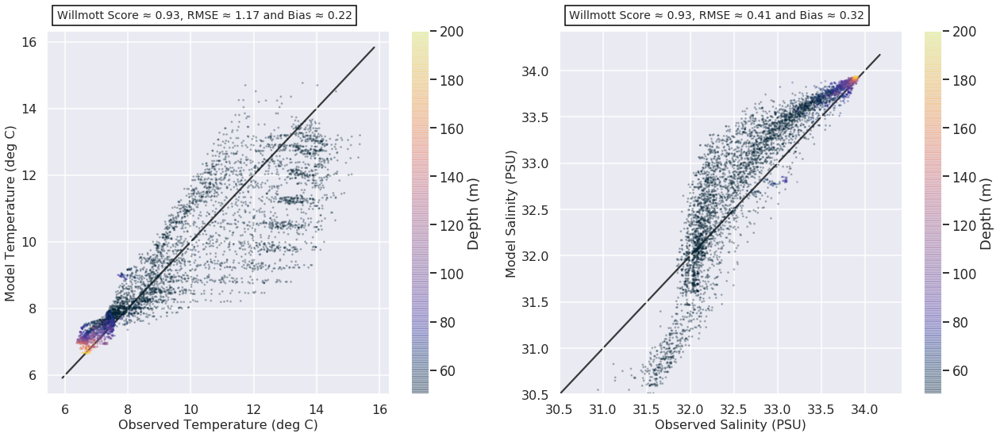

In [109]:
print("For Survey G")

cmin = 50
cmax = 200



import matplotlib as mpl
# norm = mpl.colors.Normalize(vmin=cmin,vmax=cmax)
# cmap = plt.get_cmap('summer')
# cmap = plt.get_cmap('icefire')
cmap = cmo.cm.thermal

df =pd.DataFrame()
df['Observed_temp'] = np.ndarray.flatten(mvp_tem_G)
df['Model_temp'] = np.ndarray.flatten(model_tem_G)
df['Observed_Salinity'] = np.ndarray.flatten(mvp_sal_G)
df['Model_Salinity'] = np.ndarray.flatten(model_sal_G)
df["Depth (m)"]  = np.ndarray.flatten(depth_G)

# df['Observed_temp'] = np.concatenate((mvp_tem_A, mvp_tem_B, mvp_tem_D, mvp_tem_E, mvp_tem_G))
# df['Model_temp'] = np.concatenate((model_tem_A, model_tem_B, model_tem_D, model_tem_E, model_tem_G))
# df['Observed_Salinity'] = np.concatenate((mvp_sal_A, mvp_sal_B, mvp_sal_D, mvp_sal_E, mvp_sal_G))
# df['Model_Salinity'] = np.concatenate((model_sal_A, model_sal_B, model_sal_D, model_sal_E, model_sal_G))
# df["Depth (m)"] = np.concatenate((depth_A, depth_B, depth_D, depth_E, depth_G))


# depth_mvp_all = np.empty_like(mvp_sal_loc)

# for p in np.arange(depth_mvp_all.shape[0]):
#     depth_mvp_all[p,:] = zlevels[p]



# fig, (ax1,ax2,ax3)  = plt.subplots(1,3,figsize=(15,5))

fig = plt.figure(1, figsize=(18,8))
                 
gs = gridspec.GridSpec(1,2, width_ratios=[1,1])

# gs.update(left=0.05, right=0.95, bottom=0.08, top=0.93, wspace=0.02, hspace=0.03)

ax1 = plt.subplot(gs[0,0])

ax2 = plt.subplot(gs[0,1])

# ax3 = plt.subplot(gs[0,2])


            

# p = sns.relplot(x="Observed_temp", y="Model_temp", hue="Depth (m)",  sizes=(1,10),data=df, legend='brief',palette=cmo.cm.oxy)

p = df.plot.scatter(x="Observed_temp", y="Model_temp", c = "Depth (m)", s = 2, ax = ax1, cmap = cmap, vmin = cmin, vmax = cmax, alpha = 0.25)

leg = ax1.get_legend()
ax1.legend(loc="best")

lims = [
    np.min([ax1.get_xlim(), ax1.get_ylim()]),  # min of both axes
    np.max([ax1.get_xlim(), ax1.get_ylim()]),  # max of both axes
]

ax1.plot(lims, lims, 'k-', alpha=0.75, zorder=0)
gamma2,rms_error,ws = get_stat_tem(df['Observed_temp'], df['Model_temp'], df["Depth (m)"])
anchored_text = AnchoredText("Willmott Score \u2248 {w:.2f}, RMSE \u2248 {r:.2f} and Bias \u2248 {b:.2f}". format(w = ws, r = rms_error, b = gamma2),prop=dict(size=14), loc=3, frameon=True,
                       bbox_to_anchor=(0., 1.),
                       bbox_transform=ax1.transAxes
                       )
ax1.add_artist(anchored_text)
ax1.tick_params(axis='both',labelsize =16)
ax1.set_xlabel('Observed Temperature (deg C)', fontsize = 16)
ax1.set_ylabel('Model Temperature (deg C)', fontsize = 16)


q = df.plot.scatter(x="Observed_Salinity", y="Model_Salinity", c = "Depth (m)", s =2, ax = ax2,  cmap = cmap, vmin = cmin, vmax = cmax, alpha = 0.25)


lims = [
    np.min([ax2.get_xlim(), ax2.get_ylim()]),  # min of both axes
    np.max([ax2.get_xlim(), ax2.get_ylim()]),  # max of both axes
]

ax2.plot(lims, lims, 'k-', alpha=0.75, zorder=0)
gamma2,rms_error,ws = get_stat_sal(df['Observed_Salinity'], df['Model_Salinity'], df["Depth (m)"])
anchored_text = AnchoredText("Willmott Score \u2248 {w:.2f}, RMSE \u2248 {r:.2f} and Bias \u2248 {b:.2f}". format(w = ws, r = rms_error, b = gamma2),prop=dict(size=14), loc=3, frameon=True,
                       bbox_to_anchor=(0., 1.),
                       bbox_transform=ax2.transAxes
                       )
ax2.add_artist(anchored_text)
ax2.tick_params(axis='both',labelsize =16)
ax2.set_xlabel('Observed Salinity (PSU)', fontsize = 16)
ax2.set_ylabel('Model Salinity (PSU)', fontsize = 16)

ax2.set_ylim(bottom=30.5)
ax2.set_xlim(left=30.5)

fig.tight_layout()


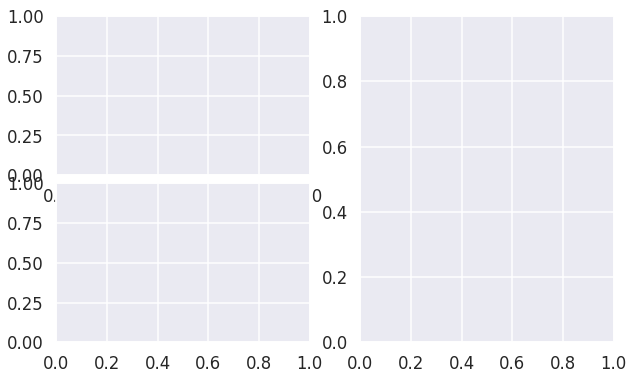

In [91]:
fig = plt.figure(figsize=(18,6))



gs2 = gridspec.GridSpec(2, 2)
gs2.update(left=0.55, right=0.98, hspace=0.05)
ax5 = plt.subplot(gs2[:-1, :-1])
ax6 = plt.subplot(gs2[-1, :-1])
ax4 = plt.subplot(gs2[:, -1])


### Figure 4

In [1]:
%matplotlib notebook
import matplotlib.pyplot as plt
import numpy as np
import numpy.ma as ma
import pandas as pd
import netCDF4 as nc
import os
import scipy.io as sio
from scipy import interpolate, signal
from pyproj import Proj,transform
import sys
sys.path.append('/ocean/ssahu/CANYONS/wcvi/grid/')
from bathy_common import *
from matplotlib import path
from salishsea_tools import viz_tools
from netCDF4 import Dataset
import xarray as xr
from salishsea_tools import nc_tools
import scipy.io as sio
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.cm as cm
import cmocean as cmo
import matplotlib.gridspec as gridspec
%matplotlib inline
from scipy.io import loadmat
from scipy.interpolate import griddata
from dateutil.parser import parse
from salishsea_tools import geo_tools, viz_tools, tidetools, nc_tools
import gsw
import sklearn.cluster as cluster
from sklearn.mixture import GMM
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
sns.set_context('poster')
sns.set_color_codes()
plot_kwds = {'alpha' : 0.25, 's' : 80, 'linewidths':0}


/home/ssahu/anaconda3/lib/python3.5/site-packages/xarray/conventions.py:9: FutureWarning: The pandas.tslib module is deprecated and will be removed in a future version.
  from pandas.tslib import OutOfBoundsDatetime


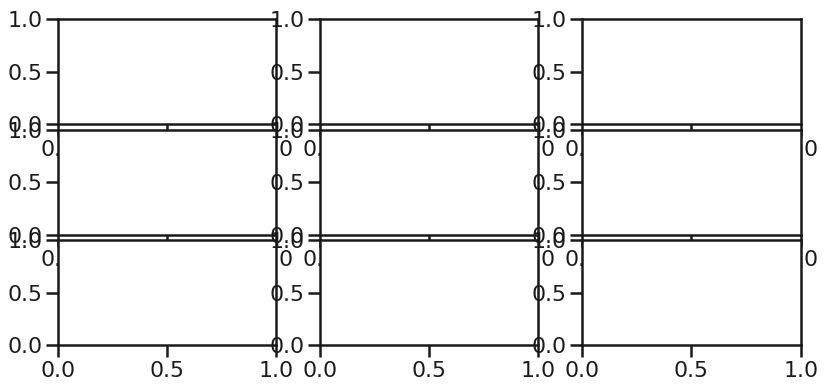

In [2]:
fig = plt.figure(figsize=(24,6))



gs2 = gridspec.GridSpec(3, 3)
gs2.update(left=0.55, right=0.98, hspace=0.05)

ax1 = plt.subplot(gs2[0, 0])
ax2 = plt.subplot(gs2[1, 0])
ax3 = plt.subplot(gs2[2, 0])

ax4 = plt.subplot(gs2[0, 1])
ax5 = plt.subplot(gs2[1, 1])
ax6 = plt.subplot(gs2[2, 1])


ax4 = plt.subplot(gs2[0, 2])
ax5 = plt.subplot(gs2[1, 2])
ax6 = plt.subplot(gs2[2, 2])

In [63]:
def add_model_MVP_data(survey_file, iso_level, survey_iso_spic, model_spic):
    
    mat = loadmat(survey_file)

    depths_survey = mat['depths'][:,0]
    lat_survey = mat['latitude'][:,0]
    lon_survey = mat['longitude'][:,0] - 100
    # den_survey = mat['density'][:]
    pden_survey = mat['pden'][:]
    temp_survey = mat['temp'][:]
    sal_survey = mat['salinity'][:]
    mtime = mat['mtime'][:,0]

    pressure_survey = np.empty_like(temp_survey)
    SA_survey = np.empty_like(temp_survey)
    CT_survey = np.empty_like(temp_survey)
    spic_survey = np.empty_like(temp_survey)
    rho_survey = np.empty_like(temp_survey)

    bathy = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/Bathymetry_EastCoast_NEMO_R036_GEBCO_corr_v14.nc')

    mbathy = mask.variables['mbathy']#[0,220:280, 575:630]
    Z = bathy.variables['Bathymetry']


    lon = bathy['nav_lon'][180:350,480:650]
    lat = bathy['nav_lat'][180:350,480:650]


    for j in np.arange(depths_survey.shape[0]):

        for i in np.arange(lat_survey.shape[0]):

            pressure_survey[j,i] = gsw.p_from_z(-depths_survey[j],lat_survey[i])

            SA_survey[j,i] = gsw.SA_from_SP(sal_survey[j,i], pressure_survey[j,i], lon_survey[i], lat_survey[i])

            CT_survey[j,i] = gsw.CT_from_pt(sal_survey[j,i], temp_survey[j,i])

            spic_survey[j,i] = gsw.spiciness0(SA_survey[j,i], CT_survey[j,i])

            rho_survey[j,i] = gsw.density.rho(SA_survey[j,i], CT_survey[j,i], 0)

            #Values indicate that pden is the true representative of the potential density calculated by rho_survey here


    y = np.empty_like(lat_survey)
    x = np.empty_like(y)


    for i in np.arange(lat_survey.shape[0]):
        y[i], x[i] = geo_tools.find_closest_model_point(
                   lon_survey[i],lat_survey[i],lon,lat,tols={
            'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})


    rho_0 = isot[iso_level]

    spic_rho = np.empty((spic_survey.shape[1]))


    for i in np.arange(spic_survey.shape[1]):

        spic_loc = spic_survey[:,i]
        rho_loc  = rho_survey[:,i]

        spic_rho[i] = np.interp(rho_0, rho_loc[:]-1000, spic_loc[:])

    spic_rho_finite = spic_rho[~np.isnan(spic_rho)]



    y = y[~np.isnan(spic_rho)]
    x = x[~np.isnan(spic_rho)]
    
    if survey_file == survey_mat_file_A:
        t =116
    if survey_file == survey_mat_file_B:
        t =116
    if survey_file == survey_mat_file_D:
        t =118
    if survey_file == survey_mat_file_E:
        t =119
    if survey_file == survey_mat_file_G:
        t =120

    model_add = np.empty_like(y)

    for i in np.arange(y.shape[0]):
        model_add[i] = iso_spic[t,iso_level,np.int(y[i]),np.int(x[i])]

    spic_rho_finite = spic_rho_finite[~np.isnan(model_add)]
    model_add = model_add[~np.isnan(model_add)]
    
    
#     model_add[np.isnan(model_add)] = 0
#     model_add = np.ma.masked_equal(model_add, value=0)



    survey_iso_spic = np.append(arr= survey_iso_spic,  values= spic_rho_finite)
    
    

    model_spic = np.append(arr= model_spic, values=model_add)
    
    return survey_iso_spic, model_spic

def calcuate_location_of_kde_custers_kmeans_5(survey_file, iso_level, survey_iso_spic, model_spic, y_added_1,x_added_1):#,\
#                                     y_added_2,x_added_2,y_added_3,x_added_3, y_added_4,x_added_4,\
#                                              y_added_5,x_added_5):
    
    mat = loadmat(survey_file)

    depths_survey = mat['depths'][:,0]
    lat_survey = mat['latitude'][:,0]
    lon_survey = mat['longitude'][:,0] - 100
    # den_survey = mat['density'][:]
    pden_survey = mat['pden'][:]
    temp_survey = mat['temp'][:]
    sal_survey = mat['salinity'][:]
    mtime = mat['mtime'][:,0]

    pressure_survey = np.empty_like(temp_survey)
    SA_survey = np.empty_like(temp_survey)
    CT_survey = np.empty_like(temp_survey)
    spic_survey = np.empty_like(temp_survey)
    rho_survey = np.empty_like(temp_survey)

    bathy = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/Bathymetry_EastCoast_NEMO_R036_GEBCO_corr_v14.nc')

    mbathy = mask.variables['mbathy']#[0,220:280, 575:630]
    Z = bathy.variables['Bathymetry']


    lon = bathy['nav_lon'][180:350,480:650]
    lat = bathy['nav_lat'][180:350,480:650]


    for j in np.arange(depths_survey.shape[0]):

        for i in np.arange(lat_survey.shape[0]):

            pressure_survey[j,i] = gsw.p_from_z(-depths_survey[j],lat_survey[i])

            SA_survey[j,i] = gsw.SA_from_SP(sal_survey[j,i], pressure_survey[j,i], lon_survey[i], lat_survey[i])

            CT_survey[j,i] = gsw.CT_from_pt(sal_survey[j,i], temp_survey[j,i])

            spic_survey[j,i] = gsw.spiciness0(SA_survey[j,i], CT_survey[j,i])

            rho_survey[j,i] = gsw.density.rho(SA_survey[j,i], CT_survey[j,i], 0)

            #Values indicate that pden is the true representative of the potential density calculated by rho_survey here


    y = np.empty_like(lat_survey)
    x = np.empty_like(y)


    for i in np.arange(lat_survey.shape[0]):
        y[i], x[i] = geo_tools.find_closest_model_point(
                   lon_survey[i],lat_survey[i],lon,lat,tols={
            'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})


    rho_0 = isot[iso_level]

    spic_rho = np.empty((spic_survey.shape[1]))


    for i in np.arange(spic_survey.shape[1]):

        spic_loc = spic_survey[:,i]
        rho_loc  = rho_survey[:,i]

        spic_rho[i] = np.interp(rho_0, rho_loc[:]-1000, spic_loc[:])

    spic_rho_finite1 = spic_rho[~np.isnan(spic_rho)]



    y = y[~np.isnan(spic_rho)]
    x = x[~np.isnan(spic_rho)]
    
    if survey_file == survey_mat_file_A:
        t =116
    if survey_file == survey_mat_file_B:
        t =116
    if survey_file == survey_mat_file_D:
        t =118
    if survey_file == survey_mat_file_E:
        t =119
    if survey_file == survey_mat_file_G:
        t =120

    model_add = np.empty_like(y)

    for i in np.arange(y.shape[0]):
        model_add[i] = iso_spic[t,iso_level,np.int(y[i]),np.int(x[i])]
        



    
    df =pd.DataFrame()
    df['Observed Spice'] = spic_rho_finite1[~np.isnan(model_add)]
    df['Model Spice'] = model_add[~np.isnan(model_add)]
    
    y = y[~np.isnan(model_add)]
    x = x[~np.isnan(model_add)]
    
    spic_rho_finite = spic_rho_finite1[~np.isnan(model_add)]
    model_add = model_add[~np.isnan(model_add)]
    
#     model_add[np.isnan(model_add)] = 0
#     model_add = np.ma.masked_equal(model_add, value=0)



    survey_iso_spic = np.append(arr= survey_iso_spic,  values= spic_rho_finite)    

    model_spic = np.append(arr= model_spic, values=model_add)
    

    
#     def plot_clusters(data, algorithm, args, kwds):
# #         start_time = time.time()
#         labels = algorithm(*args, **kwds).fit_predict(data)
# #         end_time = time.time()
# #         palette = sns.color_palette('deep', np.unique(labels).max() + 1)
# #         colors = [palette[x] if x >= 0 else (0.0, 0.0, 0.0) for x in labels]
# #         plt.scatter(survey_iso_spic, model_spic, c=colors, **plot_kwds)
#         return labels
    
#     labels = plot_clusters(df, cluster.KMeans, (), {'n_clusters':5})
    
    y_1 = y[:]
    x_1 = x[:]
    
#     y_264_cluster_2 = y[labels == 1]
#     x_264_cluster_2 = x[labels == 1]
    
#     y_264_cluster_3 = y[labels == 2]
#     x_264_cluster_3 = x[labels == 2]
    
#     y_264_cluster_4 = y[labels == 3]
#     x_264_cluster_4 = x[labels == 3]
    
#     y_264_cluster_5 = y[labels == 4]
#     x_264_cluster_5 = x[labels == 4]
    
    
#     y_264_cluster_1 = y[spic_rho_finite1<=-0.21]
#     x_264_cluster_1 = x[spic_rho_finite1<=-0.21]
    
#     y_264_cluster_2 = y[(spic_rho_finite1<-0.10) & (spic_rho_finite1> -0.16)]
#     x_264_cluster_2 = x[(spic_rho_finite1<-0.10) & (spic_rho_finite1> -0.16)]
    
#     y_264_cluster_3 = y[spic_rho_finite1>=-0.10]
#     x_264_cluster_3 = x[spic_rho_finite1>=-0.10]
    
    y_added_1 = np.append(arr= y_added_1,  values= y_1)
    x_added_1 = np.append(arr= x_added_1,  values= x_1)
    
#     y_added_2 = np.append(arr= y_added_2,  values= y_264_cluster_2)
#     x_added_2 = np.append(arr= x_added_2,  values= x_264_cluster_2)
    
#     y_added_3 = np.append(arr= y_added_3,  values= y_264_cluster_3)
#     x_added_3 = np.append(arr= x_added_3,  values= x_264_cluster_3)
    
#     y_added_4 = np.append(arr= y_added_4,  values= y_264_cluster_4)
#     x_added_4 = np.append(arr= x_added_4,  values= x_264_cluster_4)
    
#     y_added_5 = np.append(arr= y_added_5,  values= y_264_cluster_5)
#     x_added_5 = np.append(arr= x_added_5,  values= x_264_cluster_5)

    
    return survey_iso_spic, model_spic, y_added_1, x_added_1#, y_added_2, x_added_2, y_added_3, x_added_3, y_added_4, x_added_4, \
# y_added_5, x_added_5

def plot_clusters(ax, data, algorithm, args, kwds):
    start_time = time.time()
    labels = algorithm(*args, **kwds).fit_predict(data)
    end_time = time.time()
    palette = sns.color_palette('bright', np.unique(labels).max() + 1)
    colors = [palette[x] if x >= 0 else (0.0, 0.0, 0.0) for x in labels]
    ax.scatter(data.iloc[:,0], data.iloc[:,1], c=colors, **plot_kwds)
    return labels, colors
#     frame = plt.gca()
#     frame.axes.get_xaxis().set_visible(False)
#     frame.axes.get_yaxis().set_visible(False)
#     plt.title('Clusters found by {}'.format(str(algorithm.__name__)), fontsize=24)
#     plt.text(-0.5, 0.7, 'Clustering took {:.2f} s'.format(end_time - start_time), fontsize=14)

def think_clusters(data, algorithm, args, kwds):
#     start_time = time.time()
    labels = algorithm(*args, **kwds).fit_predict(data)
    end_time = time.time()
    palette = sns.color_palette('bright', np.unique(labels).max() + 1)
#     colors = [palette[x] if x >= 0 else (0.0, 0.0, 0.0) for x in labels]
#     ax.scatter(survey_iso_spic, model_spic, c=colors, **plot_kwds)
    return labels


In [64]:
import matplotlib
matplotlib.use('TkAgg')
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import seaborn as sns
import numpy as np

class SeabornFig2Grid():

    def __init__(self, seaborngrid, fig,  subplot_spec):
        self.fig = fig
        self.sg = seaborngrid
        self.subplot = subplot_spec
        if isinstance(self.sg, sns.axisgrid.FacetGrid) or \
            isinstance(self.sg, sns.axisgrid.PairGrid):
            self._movegrid()
        elif isinstance(self.sg, sns.axisgrid.JointGrid):
            self._movejointgrid()
        self._finalize()

    def _movegrid(self):
        """ Move PairGrid or Facetgrid """
        self._resize()
        n = self.sg.axes.shape[0]
        m = self.sg.axes.shape[1]
        self.subgrid = gridspec.GridSpecFromSubplotSpec(n,m, subplot_spec=self.subplot)
        for i in range(n):
            for j in range(m):
                self._moveaxes(self.sg.axes[i,j], self.subgrid[i,j])

    def _movejointgrid(self):
        """ Move Jointgrid """
        h= self.sg.ax_joint.get_position().height
        h2= self.sg.ax_marg_x.get_position().height
        r = int(np.round(h/h2))
        self._resize()
        self.subgrid = gridspec.GridSpecFromSubplotSpec(r+1,r+1, subplot_spec=self.subplot)

        self._moveaxes(self.sg.ax_joint, self.subgrid[1:, :-1])
        self._moveaxes(self.sg.ax_marg_x, self.subgrid[0, :-1])
        self._moveaxes(self.sg.ax_marg_y, self.subgrid[1:, -1])

    def _moveaxes(self, ax, gs):
        #https://stackoverflow.com/a/46906599/4124317
        ax.remove()
        ax.figure=self.fig
        self.fig.axes.append(ax)
        self.fig.add_axes(ax)
        ax._subplotspec = gs
        ax.set_position(gs.get_position(self.fig))
        ax.set_subplotspec(gs)

    def _finalize(self):
        plt.close(self.sg.fig)
        self.fig.canvas.mpl_connect("resize_event", self._resize)
        self.fig.canvas.draw()

    def _resize(self, evt=None):

        self.sg.fig.set_size_inches(self.fig.get_size_inches())

/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/__init__.py:1405: UserWarning: 
This call to matplotlib.use() has no effect because the backend has already
been chosen; matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

  warnings.warn(_use_error_msg)


In [3]:
bathy = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/Bathymetry_EastCoast_NEMO_R036_GEBCO_corr_v14.nc')

mask = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/mesh_mask.nc')
mbathy = mask.variables['mbathy']#[0,220:280, 575:630]
Z = bathy.variables['Bathymetry']


lon = bathy['nav_lon'][180:350,480:650]
lat = bathy['nav_lat'][180:350,480:650]



In [4]:
survey_mat_file_A = '/data/ssahu/Falkor_2013/mvp/surveyA.mat'
survey_mat_file_B = '/data/ssahu/Falkor_2013/mvp/surveyB.mat'
survey_mat_file_D = '/data/ssahu/Falkor_2013/mvp/surveyD.mat'
survey_mat_file_E = '/data/ssahu/Falkor_2013/mvp/surveyE.mat'
survey_mat_file_G = '/data/ssahu/Falkor_2013/mvp/surveyG.mat'


all_surveys = [survey_mat_file_A, survey_mat_file_B, survey_mat_file_D, \
              survey_mat_file_E, survey_mat_file_G]

In [5]:
iso_NEP = nc.Dataset('/data/ssahu/NEP36_Extracted_Months/2013_short_slice_NEP36_along_isopycnal_larger_offshore_rho_correct.nc')


iso_spic = iso_NEP.variables['spiciness'][...];#[:,:,40:100,110:]
isot = iso_NEP.variables['isot']
nc_tools.show_variables(iso_NEP)

odict_keys(['x', 'y', 'isot', 'time_counter', 'spiciness', 'temperature', 'salinity'])


In [6]:
model_spic = []
survey_iso_spic = []

survey_iso_spic_A, model_spic_A = add_model_MVP_data(survey_file=survey_mat_file_A, \
                                                 iso_level=3,model_spic=model_spic, \
                                                 survey_iso_spic=survey_iso_spic)

survey_iso_spic_B, model_spic_B = add_model_MVP_data(survey_file=survey_mat_file_B, \
                                                 iso_level=3,model_spic=model_spic, \
                                                 survey_iso_spic=survey_iso_spic)

survey_iso_spic_D, model_spic_D = add_model_MVP_data(survey_file=survey_mat_file_D, \
                                                 iso_level=3,model_spic=model_spic, \
                                                 survey_iso_spic=survey_iso_spic)

survey_iso_spic_E, model_spic_E = add_model_MVP_data(survey_file=survey_mat_file_E, \
                                                 iso_level=3,model_spic=model_spic, \
                                                 survey_iso_spic=survey_iso_spic)

survey_iso_spic_G, model_spic_G = add_model_MVP_data(survey_file=survey_mat_file_G, \
                                                 iso_level=3,model_spic=model_spic, \
                                                 survey_iso_spic=survey_iso_spic)

model_spic_263 = []
survey_iso_spic_263 = []

for survey_file in all_surveys:
    survey_iso_spic_263, model_spic_263 = add_model_MVP_data(survey_file=survey_file, \
                                                 iso_level=3,model_spic=model_spic_263, \
                                                 survey_iso_spic=survey_iso_spic_263)


    
    
model_spic_263 = []
survey_iso_spic_263 = []

y_added_1_263 = []
x_added_1_263 = []

for survey_file in all_surveys:
    survey_iso_spic_263, model_spic_263, y_added_1_263, x_added_1_263 \
    = calcuate_location_of_kde_custers_kmeans_5(survey_file=survey_file, \
                                                iso_level=3,model_spic=model_spic_263, \
                                                survey_iso_spic=survey_iso_spic_263,y_added_1=y_added_1_263\
                                                ,x_added_1=x_added_1_263)#,\


In [7]:
model_spic = []
survey_iso_spic = []

survey_iso_spic_A, model_spic_A = add_model_MVP_data(survey_file=survey_mat_file_A, \
                                                 iso_level=4,model_spic=model_spic, \
                                                 survey_iso_spic=survey_iso_spic)

survey_iso_spic_B, model_spic_B = add_model_MVP_data(survey_file=survey_mat_file_B, \
                                                 iso_level=4,model_spic=model_spic, \
                                                 survey_iso_spic=survey_iso_spic)

survey_iso_spic_D, model_spic_D = add_model_MVP_data(survey_file=survey_mat_file_D, \
                                                 iso_level=4,model_spic=model_spic, \
                                                 survey_iso_spic=survey_iso_spic)

survey_iso_spic_E, model_spic_E = add_model_MVP_data(survey_file=survey_mat_file_E, \
                                                 iso_level=4,model_spic=model_spic, \
                                                 survey_iso_spic=survey_iso_spic)

survey_iso_spic_G, model_spic_G = add_model_MVP_data(survey_file=survey_mat_file_G, \
                                                 iso_level=4,model_spic=model_spic, \
                                                 survey_iso_spic=survey_iso_spic)

model_spic_264 = []
survey_iso_spic_264 = []

for survey_file in all_surveys:
    survey_iso_spic_264, model_spic_264 = add_model_MVP_data(survey_file=survey_file, \
                                                 iso_level=4,model_spic=model_spic_264, \
                                                 survey_iso_spic=survey_iso_spic_264)


    
    
model_spic_264 = []
survey_iso_spic_264 = []

y_added_1_264 = []
x_added_1_264 = []

for survey_file in all_surveys:
    survey_iso_spic_264, model_spic_264, y_added_1_264, x_added_1_264 \
    = calcuate_location_of_kde_custers_kmeans_5(survey_file=survey_file, \
                                                iso_level=4,model_spic=model_spic_264, \
                                                survey_iso_spic=survey_iso_spic_264,y_added_1=y_added_1_264\
                                                ,x_added_1=x_added_1_264)#,\


In [8]:
model_spic = []
survey_iso_spic = []

survey_iso_spic_A, model_spic_A = add_model_MVP_data(survey_file=survey_mat_file_A, \
                                                 iso_level=5,model_spic=model_spic, \
                                                 survey_iso_spic=survey_iso_spic)

survey_iso_spic_B, model_spic_B = add_model_MVP_data(survey_file=survey_mat_file_B, \
                                                 iso_level=5,model_spic=model_spic, \
                                                 survey_iso_spic=survey_iso_spic)

survey_iso_spic_D, model_spic_D = add_model_MVP_data(survey_file=survey_mat_file_D, \
                                                 iso_level=5,model_spic=model_spic, \
                                                 survey_iso_spic=survey_iso_spic)

survey_iso_spic_E, model_spic_E = add_model_MVP_data(survey_file=survey_mat_file_E, \
                                                 iso_level=5,model_spic=model_spic, \
                                                 survey_iso_spic=survey_iso_spic)

survey_iso_spic_G, model_spic_G = add_model_MVP_data(survey_file=survey_mat_file_G, \
                                                 iso_level=5,model_spic=model_spic, \
                                                 survey_iso_spic=survey_iso_spic)

model_spic_265 = []
survey_iso_spic_265 = []

for survey_file in all_surveys:
    survey_iso_spic_265, model_spic_265 = add_model_MVP_data(survey_file=survey_file, \
                                                 iso_level=5,model_spic=model_spic_265, \
                                                 survey_iso_spic=survey_iso_spic_265)


    
    
model_spic_265 = []
survey_iso_spic_265 = []

y_added_1_265 = []
x_added_1_265 = []

for survey_file in all_surveys:
    survey_iso_spic_265, model_spic_265, y_added_1_265, x_added_1_265 \
    = calcuate_location_of_kde_custers_kmeans_5(survey_file=survey_file, \
                                                iso_level=5,model_spic=model_spic_265, \
                                                survey_iso_spic=survey_iso_spic_265,y_added_1=y_added_1_265\
                                                ,x_added_1=x_added_1_265)#,\


In [21]:
def think_clusters(data, algorithm, args, kwds):
#     start_time = time.time()
    labels = algorithm(*args, **kwds).fit_predict(data)
#     end_time = time.time()
    palette = sns.color_palette('bright', np.unique(labels).max() + 1)
    colors = [palette[x] if x >= 0 else (0.0, 0.0, 0.0) for x in labels]
#     ax.scatter(survey_iso_spic, model_spic, c=colors, **plot_kwds)
    return labels, np.array(colors)

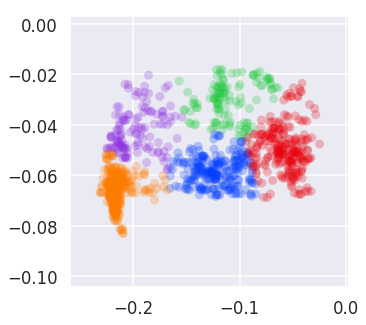

In [35]:
df =pd.DataFrame()


df['Observed Spice'] = survey_iso_spic_264
df['Model Spice'] = model_spic_264

# calculate polynomial
z = np.polyfit(df['Model Spice'],df['Observed Spice'], 1)
f = np.poly1d(z)

# calculate new x's and y's
x_new = np.arange(np.min(df['Model Spice']), np.max(df['Model Spice']), 0.01)
y_new = f(x_new)

x_fit = df['Model Spice']
y_fit = f(x_fit)


df['Fitted Spice'] = y_fit

fig, ax = plt.subplots(1,1, figsize=(5,5))
labels_264, colors_264 = plot_clusters(data=df, ax=ax, algorithm=cluster.KMeans, args=(), kwds={'n_clusters':5, 'max_iter':1000000})




# palette_264 = sns.color_palette('bright', np.unique(labels_264).max() + 1)
# colors_264 = np.array([palette_264[x] if x >= 0 else (0.0, 0.0, 0.0) for x in labels_264])

# colors[0]



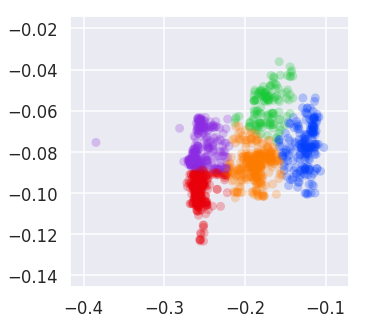

In [47]:
df =pd.DataFrame()


df['Observed Spice'] = survey_iso_spic_263
df['Model Spice'] = model_spic_263

# calculate polynomial
z = np.polyfit(df['Model Spice'],df['Observed Spice'], 1)
f = np.poly1d(z)

# calculate new x's and y's
x_new = np.arange(np.min(df['Model Spice']), np.max(df['Model Spice']), 0.01)
y_new = f(x_new)

x_fit = df['Model Spice']
y_fit = f(x_fit)


df['Fitted Spice'] = y_fit

fig, ax = plt.subplots(1,1, figsize=(5,5))
labels_263, colors_263 = plot_clusters(data=df, ax=ax, algorithm=cluster.KMeans, args=(), kwds={'n_clusters':5, 'max_iter':1000000})



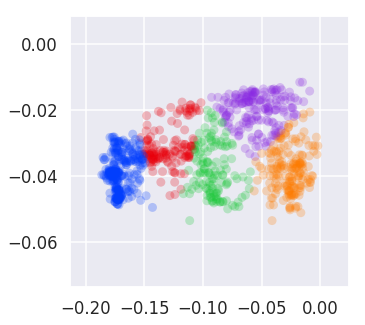

In [48]:
df =pd.DataFrame()


df['Observed Spice'] = survey_iso_spic_265
df['Model Spice'] = model_spic_265

# calculate polynomial
z = np.polyfit(df['Model Spice'],df['Observed Spice'], 1)
f = np.poly1d(z)

# calculate new x's and y's
x_new = np.arange(np.min(df['Model Spice']), np.max(df['Model Spice']), 0.01)
y_new = f(x_new)

x_fit = df['Model Spice']
y_fit = f(x_fit)


df['Fitted Spice'] = y_fit

fig, ax = plt.subplots(1,1, figsize=(5,5))
labels_265, colors_265 = plot_clusters(data=df, ax=ax, algorithm=cluster.KMeans, args=(), kwds={'n_clusters':5, 'max_iter':1000000})



In [73]:
labels_264.shape

(1085,)

In [74]:
colors_264.shape

(1085, 3)

In [77]:
survey_iso_spic_264.shape

(1085,)

In [13]:
sns.set_context('poster')
sns.set_color_codes()
plot_kwds = {'alpha' : 0.25, 's' : 80, 'linewidths':0}

In [79]:
sns.set_style('darkgrid')
sns.set_context('poster')

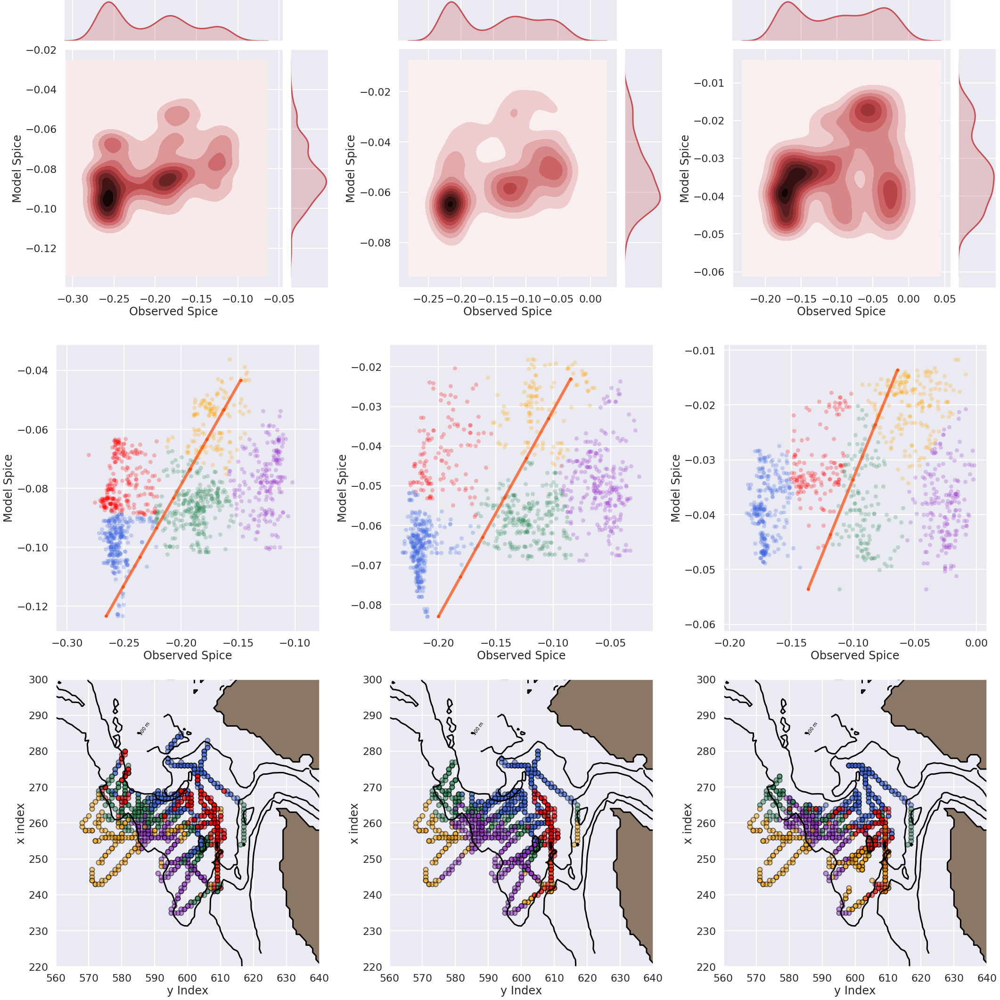

In [102]:
fig = plt.figure(figsize=(30,30))

# fig = plt.figure(figsize=(13,8))

gs2 = gridspec.GridSpec(3, 3)
# gs2.update(left=0.55, right=0.98, hspace=0.05)

# ax1 = plt.subplot(gs2[0, 0])
ax2 = plt.subplot(gs2[1, 0])
ax3 = plt.subplot(gs2[2, 0])

# ax4 = plt.subplot(gs2[0, 1])
ax5 = plt.subplot(gs2[1, 1])
ax6 = plt.subplot(gs2[2, 1])


# ax7 = plt.subplot(gs2[0, 2])
ax8 = plt.subplot(gs2[1, 2])
ax9 = plt.subplot(gs2[2, 2])



#For 26.3 isopycnal

df =pd.DataFrame()


df['Observed Spice'] = survey_iso_spic_263
df['Model Spice'] = model_spic_263


# calculate polynomial
z = np.polyfit(df['Model Spice'],df['Observed Spice'], 1)
f = np.poly1d(z)

# calculate new x's and y's
x_new = np.arange(np.min(df['Model Spice']), np.max(df['Model Spice']), 0.01)
y_new = f(x_new)

x_fit = df['Model Spice']
y_fit = f(x_fit)


df['Fitted Spice'] = y_fit



g1 = sns.jointplot(x="Observed Spice", y="Model Spice", data=df, legend='brief', kind="kde", space=0, color="r", sizes=(1,10), stat_func=None)
g1.ax_marg_x.set_xlim(-0.31,)



mg1 = SeabornFig2Grid(g1, fig, gs2[0,0])


mod_spic_263_cluster_1 = model_spic_263[labels_263 == 0]
obs_spic_263_cluster_1 = survey_iso_spic_263[labels_263 == 0]

mod_spic_263_cluster_2 = model_spic_263[labels_263 == 1]
obs_spic_263_cluster_2 = survey_iso_spic_263[labels_263 == 1]

mod_spic_263_cluster_3 = model_spic_263[labels_263 == 2]
obs_spic_263_cluster_3 = survey_iso_spic_263[labels_263 == 2]

mod_spic_263_cluster_4 = model_spic_263[labels_263 == 3]
obs_spic_263_cluster_4 = survey_iso_spic_263[labels_263 == 3]

mod_spic_263_cluster_5 = model_spic_263[labels_263 == 4]
obs_spic_263_cluster_5 = survey_iso_spic_263[labels_263 == 4]


ax2.scatter(obs_spic_263_cluster_1, mod_spic_263_cluster_1, c='darkorchid', **plot_kwds)
ax2.scatter(obs_spic_263_cluster_2, mod_spic_263_cluster_2, c='seagreen', **plot_kwds)
ax2.scatter(obs_spic_263_cluster_3, mod_spic_263_cluster_3, c='orange', **plot_kwds)
ax2.scatter(obs_spic_263_cluster_4, mod_spic_263_cluster_4, c='royalblue', **plot_kwds)
ax2.scatter(obs_spic_263_cluster_5, mod_spic_263_cluster_5, c='red', **plot_kwds)


ax2.set_xlabel("Observed Spice")
ax2.set_ylabel("Model Spice")

ax2.plot(y_new, x_new, lw=6, c='orangered', marker='.', alpha=0.7)

ax2.set_xlim(-0.31,)


bathy = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/Bathymetry_EastCoast_NEMO_R036_GEBCO_corr_v14.nc')

mbathy = mask.variables['mbathy'][0,180:350, 480:650]
Z = bathy.variables['Bathymetry']


lon = bathy['nav_lon']
lat = bathy['nav_lat']
y_wcvi_slice = np.array(np.arange(180,350))
x_wcvi_slice = np.array(np.arange(480,650))


CS = ax3.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10),colors='black')
CS1 = ax3.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=10)
CLS = plt.clabel(CS, inline=3,fmt='%0.0f m', fontsize=10)

viz_tools.plot_land_mask(ax3, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax3, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='black')



y_263_cluster_1 = y_added_1_263[labels_263 == 0]
x_263_cluster_1 = x_added_1_263[labels_263 == 0]

y_263_cluster_2 = y_added_1_263[labels_263 == 1]
x_263_cluster_2 = x_added_1_263[labels_263 == 1]

y_263_cluster_3 = y_added_1_263[labels_263 == 2]
x_263_cluster_3 = x_added_1_263[labels_263 == 2]

y_263_cluster_4 = y_added_1_263[labels_263 == 3]
x_263_cluster_4 = x_added_1_263[labels_263 == 3]

y_263_cluster_5 = y_added_1_263[labels_263 == 4]
x_263_cluster_5 = x_added_1_263[labels_263 == 4]


# ax5.scatter(x_wcvi_slice[x_added_1_264[:].astype(int)], y_wcvi_slice[y_added_1_264[:].astype(int)], c = colors, alpha= 0.5, s=200, edgecolor= 'black')

for i in np.arange(x_263_cluster_1.shape[0]):

    ax3.scatter(x_wcvi_slice[np.int(x_263_cluster_1[i])], y_wcvi_slice[np.int(y_263_cluster_1[i])], c = 'darkorchid', alpha= 0.5, s=100, edgecolor= 'black', label = 'cluster 1')

for i in np.arange(x_263_cluster_2.shape[0]):

    ax3.scatter(x_wcvi_slice[np.int(x_263_cluster_2[i])], y_wcvi_slice[np.int(y_263_cluster_2[i])], c='seagreen', alpha =0.5, s=100, edgecolor= 'black', label = 'cluster 2')

for i in np.arange(x_263_cluster_3.shape[0]):

    ax3.scatter(x_wcvi_slice[np.int(x_263_cluster_3[i])], y_wcvi_slice[np.int(y_263_cluster_3[i])],c='orange', alpha =0.5, s=100, edgecolor= 'black', label = 'cluster 3')

for i in np.arange(x_263_cluster_4.shape[0]):

    ax3.scatter(x_wcvi_slice[np.int(x_263_cluster_4[i])], y_wcvi_slice[np.int(y_263_cluster_4[i])], c='royalblue', alpha =0.5, s=100, edgecolor= 'black', label = 'cluster 4')

for i in np.arange(x_263_cluster_5.shape[0]):

    ax3.scatter(x_wcvi_slice[np.int(x_263_cluster_5[i])], y_wcvi_slice[np.int(y_263_cluster_5[i])], c='red', alpha =0.5, s=100, edgecolor= 'black', label = 'cluster 5')

ax3.set_ylim(220,300)
ax3.set_xlim(560,640)

ax3.set_xlabel("y Index")
ax3.set_ylabel("x index")





#For 26.4 isopycnal

df =pd.DataFrame()


df['Observed Spice'] = survey_iso_spic_264
df['Model Spice'] = model_spic_264


# calculate polynomial
z = np.polyfit(df['Model Spice'],df['Observed Spice'], 1)
f = np.poly1d(z)

# calculate new x's and y's
x_new = np.arange(np.min(df['Model Spice']), np.max(df['Model Spice']), 0.01)
y_new = f(x_new)

x_fit = df['Model Spice']
y_fit = f(x_fit)


df['Fitted Spice'] = y_fit



g1 = sns.jointplot(x="Observed Spice", y="Model Spice", data=df, legend='brief', kind="kde", space=0, color="r", sizes=(1,10), stat_func=None)

mg1 = SeabornFig2Grid(g1, fig, gs2[0,1])


mod_spic_264_cluster_1 = model_spic_264[labels_264 == 0]
obs_spic_264_cluster_1 = survey_iso_spic_264[labels_264 == 0]

mod_spic_264_cluster_2 = model_spic_264[labels_264 == 1]
obs_spic_264_cluster_2 = survey_iso_spic_264[labels_264 == 1]

mod_spic_264_cluster_3 = model_spic_264[labels_264 == 2]
obs_spic_264_cluster_3 = survey_iso_spic_264[labels_264 == 2]

mod_spic_264_cluster_4 = model_spic_264[labels_264 == 3]
obs_spic_264_cluster_4 = survey_iso_spic_264[labels_264 == 3]

mod_spic_264_cluster_5 = model_spic_264[labels_264 == 4]
obs_spic_264_cluster_5 = survey_iso_spic_264[labels_264 == 4]


ax5.scatter(obs_spic_264_cluster_1, mod_spic_264_cluster_1, c='seagreen', **plot_kwds)
ax5.scatter(obs_spic_264_cluster_2, mod_spic_264_cluster_2, c='royalblue', **plot_kwds)
ax5.scatter(obs_spic_264_cluster_3, mod_spic_264_cluster_3, c='orange', **plot_kwds)
ax5.scatter(obs_spic_264_cluster_4, mod_spic_264_cluster_4, c='darkorchid', **plot_kwds)
ax5.scatter(obs_spic_264_cluster_5, mod_spic_264_cluster_5, c='red', **plot_kwds)


ax5.set_xlabel("Observed Spice")
ax5.set_ylabel("Model Spice")

ax5.plot(y_new, x_new, lw=6, c='orangered', marker='.', alpha=0.7)


bathy = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/Bathymetry_EastCoast_NEMO_R036_GEBCO_corr_v14.nc')

mbathy = mask.variables['mbathy'][0,180:350, 480:650]
Z = bathy.variables['Bathymetry']


lon = bathy['nav_lon']
lat = bathy['nav_lat']
y_wcvi_slice = np.array(np.arange(180,350))
x_wcvi_slice = np.array(np.arange(480,650))


# cmap = plt.get_cmap('deep')
# cmap = sns.color_palette('bright', np.unique(labels).max() + 1)
#     cmap.set_bad('burlywood')
# cmap.set_bad('#8b7765')
# fig, ax = plt.subplots(1, 1, figsize=(20,16)); ax.grid()
#     ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=np.mean(lon)))
CS = ax6.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10),colors='black')
CS1 = ax6.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=10)
CLS = plt.clabel(CS, inline=3,fmt='%0.0f m', fontsize=10)

viz_tools.plot_land_mask(ax6, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax6, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='black')



y_264_cluster_1 = y_added_1_264[labels_264 == 0]
x_264_cluster_1 = x_added_1_264[labels_264 == 0]

y_264_cluster_2 = y_added_1_264[labels_264 == 1]
x_264_cluster_2 = x_added_1_264[labels_264 == 1]

y_264_cluster_3 = y_added_1_264[labels_264 == 2]
x_264_cluster_3 = x_added_1_264[labels_264 == 2]

y_264_cluster_4 = y_added_1_264[labels_264 == 3]
x_264_cluster_4 = x_added_1_264[labels_264 == 3]

y_264_cluster_5 = y_added_1_264[labels_264 == 4]
x_264_cluster_5 = x_added_1_264[labels_264 == 4]


# ax5.scatter(x_wcvi_slice[x_added_1_264[:].astype(int)], y_wcvi_slice[y_added_1_264[:].astype(int)], c = colors, alpha= 0.5, s=200, edgecolor= 'black')

for i in np.arange(x_264_cluster_1.shape[0]):

    ax6.scatter(x_wcvi_slice[np.int(x_264_cluster_1[i])], y_wcvi_slice[np.int(y_264_cluster_1[i])], c = 'seagreen', alpha= 0.5, s=100, edgecolor= 'black', label = 'cluster 1')

for i in np.arange(x_264_cluster_2.shape[0]):

    ax6.scatter(x_wcvi_slice[np.int(x_264_cluster_2[i])], y_wcvi_slice[np.int(y_264_cluster_2[i])], c='royalblue', alpha =0.5, s=100, edgecolor= 'black', label = 'cluster 2')

for i in np.arange(x_264_cluster_3.shape[0]):

    ax6.scatter(x_wcvi_slice[np.int(x_264_cluster_3[i])], y_wcvi_slice[np.int(y_264_cluster_3[i])],c='orange', alpha =0.5, s=100, edgecolor= 'black', label = 'cluster 3')

for i in np.arange(x_264_cluster_4.shape[0]):

    ax6.scatter(x_wcvi_slice[np.int(x_264_cluster_4[i])], y_wcvi_slice[np.int(y_264_cluster_4[i])], c='darkorchid', alpha =0.5, s=100, edgecolor= 'black', label = 'cluster 4')

for i in np.arange(x_264_cluster_5.shape[0]):

    ax6.scatter(x_wcvi_slice[np.int(x_264_cluster_5[i])], y_wcvi_slice[np.int(y_264_cluster_5[i])], c='red', alpha =0.5, s=100, edgecolor= 'black', label = 'cluster 5')

ax6.set_ylim(220,300)
ax6.set_xlim(560,640)

ax6.set_xlabel("y Index")
ax6.set_ylabel("x index")


#For 26.5 isopycnal

df =pd.DataFrame()


df['Observed Spice'] = survey_iso_spic_265
df['Model Spice'] = model_spic_265


# calculate polynomial
z = np.polyfit(df['Model Spice'],df['Observed Spice'], 1)
f = np.poly1d(z)

# calculate new x's and y's
x_new = np.arange(np.min(df['Model Spice']), np.max(df['Model Spice']), 0.01)
y_new = f(x_new)

x_fit = df['Model Spice']
y_fit = f(x_fit)


df['Fitted Spice'] = y_fit



g2 = sns.jointplot(x="Observed Spice", y="Model Spice", data=df, legend='brief', kind="kde", space=0, color="r", sizes=(1,10), stat_func=None)

mg2 = SeabornFig2Grid(g2, fig, gs2[0,2])


mod_spic_265_cluster_1 = model_spic_265[labels_265 == 0]
obs_spic_265_cluster_1 = survey_iso_spic_265[labels_265 == 0]

mod_spic_265_cluster_2 = model_spic_265[labels_265 == 1]
obs_spic_265_cluster_2 = survey_iso_spic_265[labels_265 == 1]

mod_spic_265_cluster_3 = model_spic_265[labels_265 == 2]
obs_spic_265_cluster_3 = survey_iso_spic_265[labels_265 == 2]

mod_spic_265_cluster_4 = model_spic_265[labels_265 == 3]
obs_spic_265_cluster_4 = survey_iso_spic_265[labels_265 == 3]

mod_spic_265_cluster_5 = model_spic_265[labels_265 == 4]
obs_spic_265_cluster_5 = survey_iso_spic_265[labels_265 == 4]


ax8.scatter(obs_spic_265_cluster_1, mod_spic_265_cluster_1, c='royalblue', **plot_kwds)
ax8.scatter(obs_spic_265_cluster_2, mod_spic_265_cluster_2, c='darkorchid', **plot_kwds)
ax8.scatter(obs_spic_265_cluster_3, mod_spic_265_cluster_3, c='seagreen', **plot_kwds)
ax8.scatter(obs_spic_265_cluster_4, mod_spic_265_cluster_4, c='red', **plot_kwds)
ax8.scatter(obs_spic_265_cluster_5, mod_spic_265_cluster_5, c='orange', **plot_kwds)


ax8.set_xlabel("Observed Spice")
ax8.set_ylabel("Model Spice")

ax8.plot(y_new, x_new, lw=6, c='orangered', marker='.', alpha=0.7)


bathy = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/Bathymetry_EastCoast_NEMO_R036_GEBCO_corr_v14.nc')

mbathy = mask.variables['mbathy'][0,180:350, 480:650]
Z = bathy.variables['Bathymetry']


lon = bathy['nav_lon']
lat = bathy['nav_lat']
y_wcvi_slice = np.array(np.arange(180,350))
x_wcvi_slice = np.array(np.arange(480,650))

CS = ax9.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10),colors='black')
CS1 = ax9.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10),colors='black')
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=10)
CLS = plt.clabel(CS, inline=3,fmt='%0.0f m', fontsize=10)

viz_tools.plot_land_mask(ax9, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax9, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='black')


# q = ax.pcolormesh(x_wcvi_slice, y_wcvi_slice, val_iso[:], cmap=cmap, vmin= cmin, vmax= cmax)
# cbar = fig.colorbar(q, ax=ax)

# for i in np.arange(x_added_3.shape[0]):

#     ax.scatter(x_wcvi_slice[np.int(x_added_3[i])], y_wcvi_slice[np.int(y_added_3[i])], c = 'cyan', alpha =0.5, s=200, edgecolor= 'cyan')



y_265_cluster_1 = y_added_1_265[labels_265 == 0]
x_265_cluster_1 = x_added_1_265[labels_265 == 0]

y_265_cluster_2 = y_added_1_265[labels_265 == 1]
x_265_cluster_2 = x_added_1_265[labels_265 == 1]

y_265_cluster_3 = y_added_1_265[labels_265 == 2]
x_265_cluster_3 = x_added_1_265[labels_265 == 2]

y_265_cluster_4 = y_added_1_265[labels_265 == 3]
x_265_cluster_4 = x_added_1_265[labels_265 == 3]

y_265_cluster_5 = y_added_1_265[labels_265 == 4]
x_265_cluster_5 = x_added_1_265[labels_265 == 4]


# ax5.scatter(x_wcvi_slice[x_added_1_264[:].astype(int)], y_wcvi_slice[y_added_1_264[:].astype(int)], c = colors, alpha= 0.5, s=200, edgecolor= 'black')

for i in np.arange(x_265_cluster_1.shape[0]):

    ax9.scatter(x_wcvi_slice[np.int(x_265_cluster_1[i])], y_wcvi_slice[np.int(y_265_cluster_1[i])], c = 'royalblue', alpha= 0.5, s=100, edgecolor= 'black', label = 'cluster 1')

for i in np.arange(x_265_cluster_2.shape[0]):

    ax9.scatter(x_wcvi_slice[np.int(x_265_cluster_2[i])], y_wcvi_slice[np.int(y_265_cluster_2[i])], c='darkorchid', alpha =0.5, s=100, edgecolor= 'black', label = 'cluster 2')

for i in np.arange(x_265_cluster_3.shape[0]):

    ax9.scatter(x_wcvi_slice[np.int(x_265_cluster_3[i])], y_wcvi_slice[np.int(y_265_cluster_3[i])],c='seagreen', alpha =0.5, s=100, edgecolor= 'black', label = 'cluster 3')

for i in np.arange(x_265_cluster_4.shape[0]):

    ax9.scatter(x_wcvi_slice[np.int(x_265_cluster_4[i])], y_wcvi_slice[np.int(y_265_cluster_4[i])], c='red', alpha =0.5, s=100, edgecolor= 'black', label = 'cluster 4')

for i in np.arange(x_265_cluster_5.shape[0]):

    ax9.scatter(x_wcvi_slice[np.int(x_265_cluster_5[i])], y_wcvi_slice[np.int(y_265_cluster_5[i])], c='orange', alpha =0.5, s=100, edgecolor= 'black', label = 'cluster 5')

ax9.set_ylim(220,300)
ax9.set_xlim(560,640)

ax9.set_xlabel("y Index")
ax9.set_ylabel("x index")


gs2.tight_layout(fig)


In [ ]:
fig = plt.figure(figsize=(30,30))



gs2 = gridspec.GridSpec(3, 3)
# gs2.update(left=0.55, right=0.98, hspace=0.05)

ax1 = plt.subplot(gs2[0, 0])
ax2 = plt.subplot(gs2[1, 0])
ax3 = plt.subplot(gs2[2, 0])

ax4 = plt.subplot(gs2[0, 1])
ax5 = plt.subplot(gs2[1, 1])
ax6 = plt.subplot(gs2[2, 1])


ax7 = plt.subplot(gs2[0, 2])
ax8 = plt.subplot(gs2[1, 2])
ax9 = plt.subplot(gs2[2, 2])




(560, 640)

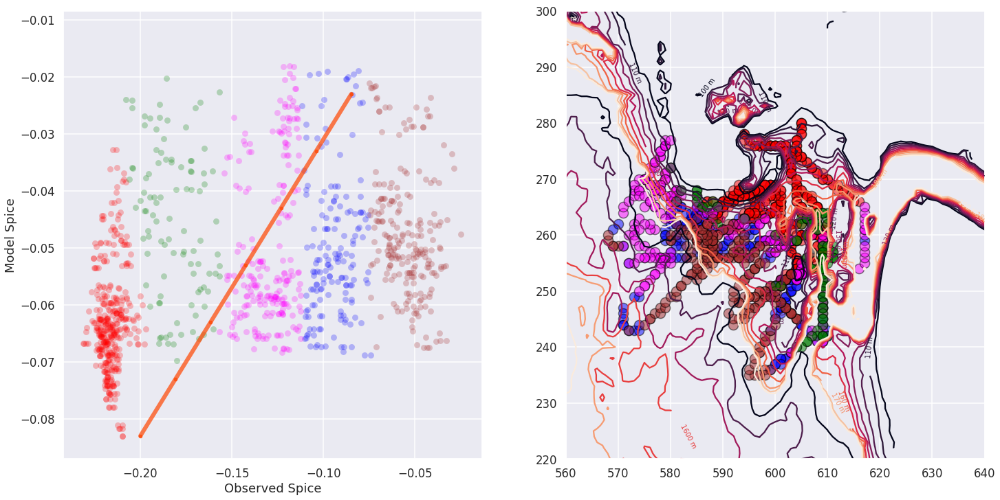

In [62]:
df =pd.DataFrame()


df['Observed Spice'] = survey_iso_spic_264
df['Model Spice'] = model_spic_264




# >>> def func(x, a, b, c):
# #     return a * np.exp(-b * x) + c

# calculate polynomial
z = np.polyfit(df['Model Spice'],df['Observed Spice'], 1)
f = np.poly1d(z)

# calculate new x's and y's
x_new = np.arange(np.min(df['Model Spice']), np.max(df['Model Spice']), 0.01)
y_new = f(x_new)

x_fit = df['Model Spice']
y_fit = f(x_fit)


df['Fitted Spice'] = y_fit




fig, (ax1,ax) = plt.subplots(1,2, figsize=(24,12))



mod_spic_264_cluster_1 = model_spic_264[labels_264 == 0]
obs_spic_264_cluster_1 = survey_iso_spic_264[labels_264 == 0]

mod_spic_264_cluster_2 = model_spic_264[labels_264 == 1]
obs_spic_264_cluster_2 = survey_iso_spic_264[labels_264 == 1]

mod_spic_264_cluster_3 = model_spic_264[labels_264 == 2]
obs_spic_264_cluster_3 = survey_iso_spic_264[labels_264 == 2]

mod_spic_264_cluster_4 = model_spic_264[labels_264 == 3]
obs_spic_264_cluster_4 = survey_iso_spic_264[labels_264 == 3]

mod_spic_264_cluster_5 = model_spic_264[labels_264 == 4]
obs_spic_264_cluster_5 = survey_iso_spic_264[labels_264 == 4]


ax1.scatter(obs_spic_264_cluster_1, mod_spic_264_cluster_1, c='blue', **plot_kwds)
ax1.scatter(obs_spic_264_cluster_2, mod_spic_264_cluster_2, c='red', **plot_kwds)
ax1.scatter(obs_spic_264_cluster_3, mod_spic_264_cluster_3, c='magenta', **plot_kwds)
ax1.scatter(obs_spic_264_cluster_4, mod_spic_264_cluster_4, c='brown', **plot_kwds)
ax1.scatter(obs_spic_264_cluster_5, mod_spic_264_cluster_5, c='green', **plot_kwds)


# colors = np.array(colors)
ax1.set_xlabel("Observed Spice")
ax1.set_ylabel("Model Spice")

ax1.plot(y_new, x_new, lw=6, c='orangered', marker='.', alpha=0.7)

# gamma2,rms_error,ws = get_stat(df['Observed Spice'], df['Fitted Spice'])
# anchored_text = AnchoredText("Statistics with Fitted Line: Willmott Score \u2248 {w:.2f}, RMSE \u2248 {r:.2f} and Bias \u2248 {b:.2f}". format(w = ws, r = rms_error, b = gamma2),prop=dict(size=14), loc=3, frameon=True,
#                        bbox_to_anchor=(0., 1.),
#                        bbox_transform=ax1.transAxes
#                        )
# ax1.add_artist(anchored_text)


# gamma2,rms_error,ws = get_stat(df['Observed Spice'], df['Model Spice'])
# anchored_text = AnchoredText("Willmott Score \u2248 {w:.2f}, RMSE \u2248 {r:.2f} and Bias \u2248 {b:.2f}". format(w = ws, r = rms_error, b = gamma2),prop=dict(size=14), loc=3, frameon=True,
#                        bbox_to_anchor=(0.32, 0.),
#                        bbox_transform=ax1.transAxes
#                        )
# ax1.add_artist(anchored_text)

# ax.axhline(y=-0.055, c = 'teal')
# ax.axvline(x= -0.17, c = 'teal')

# ax.axhline(y=-0.037, c = 'red')


bathy = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/Bathymetry_EastCoast_NEMO_R036_GEBCO_corr_v14.nc')

mbathy = mask.variables['mbathy'][0,180:350, 480:650]
Z = bathy.variables['Bathymetry']


lon = bathy['nav_lon']
lat = bathy['nav_lat']
y_wcvi_slice = np.array(np.arange(180,350))
x_wcvi_slice = np.array(np.arange(480,650))


# cmap = plt.get_cmap('deep')
# cmap = sns.color_palette('bright', np.unique(labels).max() + 1)
#     cmap.set_bad('burlywood')
# cmap.set_bad('#8b7765')
# fig, ax = plt.subplots(1, 1, figsize=(20,16)); ax.grid()
#     ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=np.mean(lon)))
CS = ax.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,200,10))
CS1 = ax.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], level = [0,100,200,500,1000])
CLS = plt.clabel(CS, inline=3,fmt='%0.0f m', fontsize=10)
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=10)

# q = ax.pcolormesh(x_wcvi_slice, y_wcvi_slice, val_iso[:], cmap=cmap, vmin= cmin, vmax= cmax)
# cbar = fig.colorbar(q, ax=ax)

# for i in np.arange(x_added_3.shape[0]):

#     ax.scatter(x_wcvi_slice[np.int(x_added_3[i])], y_wcvi_slice[np.int(y_added_3[i])], c = 'cyan', alpha =0.5, s=200, edgecolor= 'cyan')



y_264_cluster_1 = y_added_1_264[labels_264 == 0]
x_264_cluster_1 = x_added_1_264[labels_264 == 0]

y_264_cluster_2 = y_added_1_264[labels_264 == 1]
x_264_cluster_2 = x_added_1_264[labels_264 == 1]

y_264_cluster_3 = y_added_1_264[labels_264 == 2]
x_264_cluster_3 = x_added_1_264[labels_264 == 2]

y_264_cluster_4 = y_added_1_264[labels_264 == 3]
x_264_cluster_4 = x_added_1_264[labels_264 == 3]

y_264_cluster_5 = y_added_1_264[labels_264 == 4]
x_264_cluster_5 = x_added_1_264[labels_264 == 4]


for i in np.arange(x_264_cluster_1.shape[0]):

    ax.scatter(x_wcvi_slice[np.int(x_264_cluster_1[i])], y_wcvi_slice[np.int(y_264_cluster_1[i])], c = 'blue', alpha= 0.5, s=200, edgecolor= 'black', label = 'cluster 1')

for i in np.arange(x_264_cluster_2.shape[0]):

    ax.scatter(x_wcvi_slice[np.int(x_264_cluster_2[i])], y_wcvi_slice[np.int(y_264_cluster_2[i])], c = 'red', alpha =0.5, s=200, edgecolor= 'black', label = 'cluster 2')

for i in np.arange(x_264_cluster_3.shape[0]):

    ax.scatter(x_wcvi_slice[np.int(x_264_cluster_3[i])], y_wcvi_slice[np.int(y_264_cluster_3[i])], c = 'magenta', alpha =0.5, s=200, edgecolor= 'black', label = 'cluster 3')

for i in np.arange(x_264_cluster_4.shape[0]):

    ax.scatter(x_wcvi_slice[np.int(x_264_cluster_4[i])], y_wcvi_slice[np.int(y_264_cluster_4[i])], c = 'brown', alpha =0.5, s=200, edgecolor= 'black', label = 'cluster 4')

for i in np.arange(x_264_cluster_5.shape[0]):

    ax.scatter(x_wcvi_slice[np.int(x_264_cluster_5[i])], y_wcvi_slice[np.int(y_264_cluster_5[i])], c = 'green', alpha =0.5, s=200, edgecolor= 'black', label = 'cluster 5')

ax.set_ylim(220,300)
ax.set_xlim(560,640)


(560, 640)

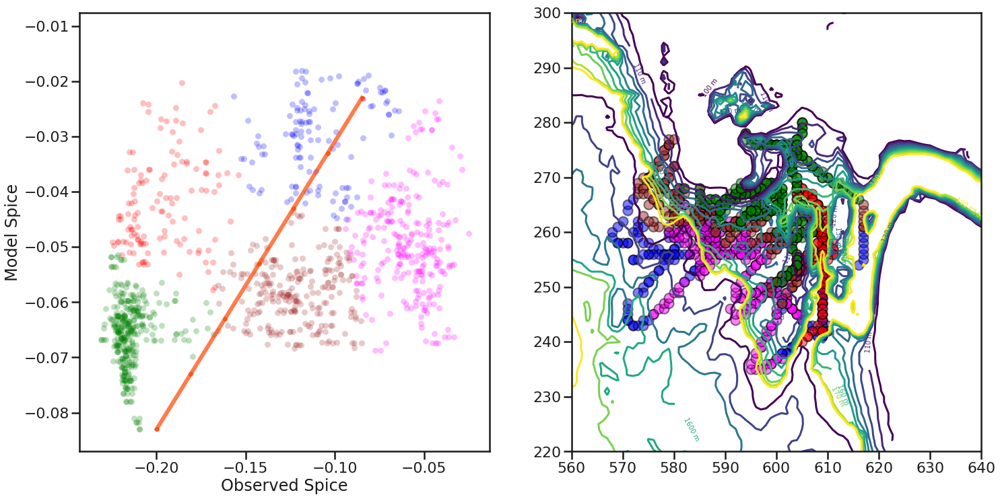

In [32]:
df =pd.DataFrame()


df['Observed Spice'] = survey_iso_spic_264
df['Model Spice'] = model_spic_264




# >>> def func(x, a, b, c):
# #     return a * np.exp(-b * x) + c

# calculate polynomial
z = np.polyfit(df['Model Spice'],df['Observed Spice'], 1)
f = np.poly1d(z)

# calculate new x's and y's
x_new = np.arange(np.min(df['Model Spice']), np.max(df['Model Spice']), 0.01)
y_new = f(x_new)

x_fit = df['Model Spice']
y_fit = f(x_fit)


df['Fitted Spice'] = y_fit




fig, (ax1,ax) = plt.subplots(1,2, figsize=(24,12))



mod_spic_264_cluster_1 = model_spic_264[labels_264 == 0]
obs_spic_264_cluster_1 = survey_iso_spic_264[labels_264 == 0]

mod_spic_264_cluster_2 = model_spic_264[labels_264 == 1]
obs_spic_264_cluster_2 = survey_iso_spic_264[labels_264 == 1]

mod_spic_264_cluster_3 = model_spic_264[labels_264 == 2]
obs_spic_264_cluster_3 = survey_iso_spic_264[labels_264 == 2]

mod_spic_264_cluster_4 = model_spic_264[labels_264 == 3]
obs_spic_264_cluster_4 = survey_iso_spic_264[labels_264 == 3]

mod_spic_264_cluster_5 = model_spic_264[labels_264 == 4]
obs_spic_264_cluster_5 = survey_iso_spic_264[labels_264 == 4]


ax1.scatter(obs_spic_264_cluster_1, mod_spic_264_cluster_1, c='blue', **plot_kwds)
ax1.scatter(obs_spic_264_cluster_2, mod_spic_264_cluster_2, c='red', **plot_kwds)
ax1.scatter(obs_spic_264_cluster_3, mod_spic_264_cluster_3, c='magenta', **plot_kwds)
ax1.scatter(obs_spic_264_cluster_4, mod_spic_264_cluster_4, c='brown', **plot_kwds)
ax1.scatter(obs_spic_264_cluster_5, mod_spic_264_cluster_5, c='green', **plot_kwds)


# colors = np.array(colors)
ax1.set_xlabel("Observed Spice")
ax1.set_ylabel("Model Spice")

ax1.plot(y_new, x_new, lw=6, c='orangered', marker='.', alpha=0.7)

# gamma2,rms_error,ws = get_stat(df['Observed Spice'], df['Fitted Spice'])
# anchored_text = AnchoredText("Statistics with Fitted Line: Willmott Score \u2248 {w:.2f}, RMSE \u2248 {r:.2f} and Bias \u2248 {b:.2f}". format(w = ws, r = rms_error, b = gamma2),prop=dict(size=14), loc=3, frameon=True,
#                        bbox_to_anchor=(0., 1.),
#                        bbox_transform=ax1.transAxes
#                        )
# ax1.add_artist(anchored_text)


# gamma2,rms_error,ws = get_stat(df['Observed Spice'], df['Model Spice'])
# anchored_text = AnchoredText("Willmott Score \u2248 {w:.2f}, RMSE \u2248 {r:.2f} and Bias \u2248 {b:.2f}". format(w = ws, r = rms_error, b = gamma2),prop=dict(size=14), loc=3, frameon=True,
#                        bbox_to_anchor=(0.32, 0.),
#                        bbox_transform=ax1.transAxes
#                        )
# ax1.add_artist(anchored_text)

# ax.axhline(y=-0.055, c = 'teal')
# ax.axvline(x= -0.17, c = 'teal')

# ax.axhline(y=-0.037, c = 'red')


bathy = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/Bathymetry_EastCoast_NEMO_R036_GEBCO_corr_v14.nc')

mbathy = mask.variables['mbathy'][0,180:350, 480:650]
Z = bathy.variables['Bathymetry']


lon = bathy['nav_lon']
lat = bathy['nav_lat']
y_wcvi_slice = np.array(np.arange(180,350))
x_wcvi_slice = np.array(np.arange(480,650))


# cmap = plt.get_cmap('deep')
# cmap = sns.color_palette('bright', np.unique(labels).max() + 1)
#     cmap.set_bad('burlywood')
# cmap.set_bad('#8b7765')
# fig, ax = plt.subplots(1, 1, figsize=(20,16)); ax.grid()
#     ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=np.mean(lon)))
CS = ax.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,200,10))
CS1 = ax.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], level = [0,100,200,500,1000])
CLS = plt.clabel(CS, inline=3,fmt='%0.0f m', fontsize=10)
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=10)

# q = ax.pcolormesh(x_wcvi_slice, y_wcvi_slice, val_iso[:], cmap=cmap, vmin= cmin, vmax= cmax)
# cbar = fig.colorbar(q, ax=ax)

# for i in np.arange(x_added_3.shape[0]):

#     ax.scatter(x_wcvi_slice[np.int(x_added_3[i])], y_wcvi_slice[np.int(y_added_3[i])], c = 'cyan', alpha =0.5, s=200, edgecolor= 'cyan')



y_264_cluster_1 = y_added_1_264[labels_264 == 0]
x_264_cluster_1 = x_added_1_264[labels_264 == 0]

y_264_cluster_2 = y_added_1_264[labels_264 == 1]
x_264_cluster_2 = x_added_1_264[labels_264 == 1]

y_264_cluster_3 = y_added_1_264[labels_264 == 2]
x_264_cluster_3 = x_added_1_264[labels_264 == 2]

y_264_cluster_4 = y_added_1_264[labels_264 == 3]
x_264_cluster_4 = x_added_1_264[labels_264 == 3]

y_264_cluster_5 = y_added_1_264[labels_264 == 4]
x_264_cluster_5 = x_added_1_264[labels_264 == 4]


for i in np.arange(x_264_cluster_1.shape[0]):

    ax.scatter(x_wcvi_slice[np.int(x_264_cluster_1[i])], y_wcvi_slice[np.int(y_264_cluster_1[i])], c = 'blue', alpha= 0.5, s=200, edgecolor= 'black', label = 'cluster 1')

for i in np.arange(x_264_cluster_2.shape[0]):

    ax.scatter(x_wcvi_slice[np.int(x_264_cluster_2[i])], y_wcvi_slice[np.int(y_264_cluster_2[i])], c = 'red', alpha =0.5, s=200, edgecolor= 'black', label = 'cluster 2')

for i in np.arange(x_264_cluster_3.shape[0]):

    ax.scatter(x_wcvi_slice[np.int(x_264_cluster_3[i])], y_wcvi_slice[np.int(y_264_cluster_3[i])], c = 'magenta', alpha =0.5, s=200, edgecolor= 'black', label = 'cluster 3')

for i in np.arange(x_264_cluster_4.shape[0]):

    ax.scatter(x_wcvi_slice[np.int(x_264_cluster_4[i])], y_wcvi_slice[np.int(y_264_cluster_4[i])], c = 'brown', alpha =0.5, s=200, edgecolor= 'black', label = 'cluster 4')

for i in np.arange(x_264_cluster_5.shape[0]):

    ax.scatter(x_wcvi_slice[np.int(x_264_cluster_5[i])], y_wcvi_slice[np.int(y_264_cluster_5[i])], c = 'green', alpha =0.5, s=200, edgecolor= 'black', label = 'cluster 5')

ax.set_ylim(220,300)
ax.set_xlim(560,640)


In [114]:
colors[labels == 0]

array([[ 0.00784314,  0.24313725,  1.        ],
       [ 0.00784314,  0.24313725,  1.        ],
       [ 0.00784314,  0.24313725,  1.        ],
       ..., 
       [ 0.00784314,  0.24313725,  1.        ],
       [ 0.00784314,  0.24313725,  1.        ],
       [ 0.00784314,  0.24313725,  1.        ]])

In [29]:
def think_clusters(data, algorithm, args, kwds):
    start_time = time.time()
    labels = algorithm(*args, **kwds).fit_predict(data)
    end_time = time.time()
    palette = sns.color_palette('bright', np.unique(labels).max() + 1)
#     colors = [palette[x] if x >= 0 else (0.0, 0.0, 0.0) for x in labels]
#     ax.scatter(survey_iso_spic, model_spic, c=colors, **plot_kwds)
    return labels

In [ ]:
df =pd.DataFrame()

df['Observed Spice'] = survey_iso_spic_264
df['Model Spice'] = model_spic_264


labels_264 = think_clusters(data=df, algorithm=cluster.KMeans, args=(), kwds={'n_clusters':5})




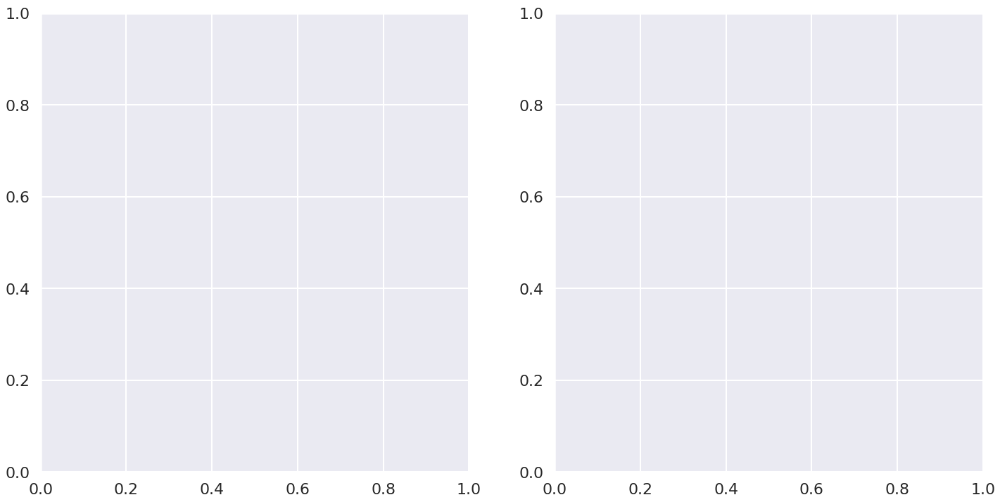

In [121]:


import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

# >>> def func(x, a, b, c):
# #     return a * np.exp(-b * x) + c

# calculate polynomial
z = np.polyfit(df['Model Spice'],df['Observed Spice'], 1)
f = np.poly1d(z)

# calculate new x's and y's
x_new = np.arange(np.min(df['Model Spice']), np.max(df['Model Spice']), 0.01)
y_new = f(x_new)

x_fit = df['Model Spice']
y_fit = f(x_fit)


df['Fitted Spice'] = y_fit




fig, (ax1,ax) = plt.subplots(1,2, figsize=(24,12))

# q = plot_clusters(df, cluster.KMeans, (), {'n_clusters':3})

labels = think_clusters(data=df, algorithm=cluster.KMeans, args=(), kwds={'n_clusters':5})


# colors = np.array(colors)

In [123]:
np.max(labels)

4

NameError: name 'y_added_1' is not defined

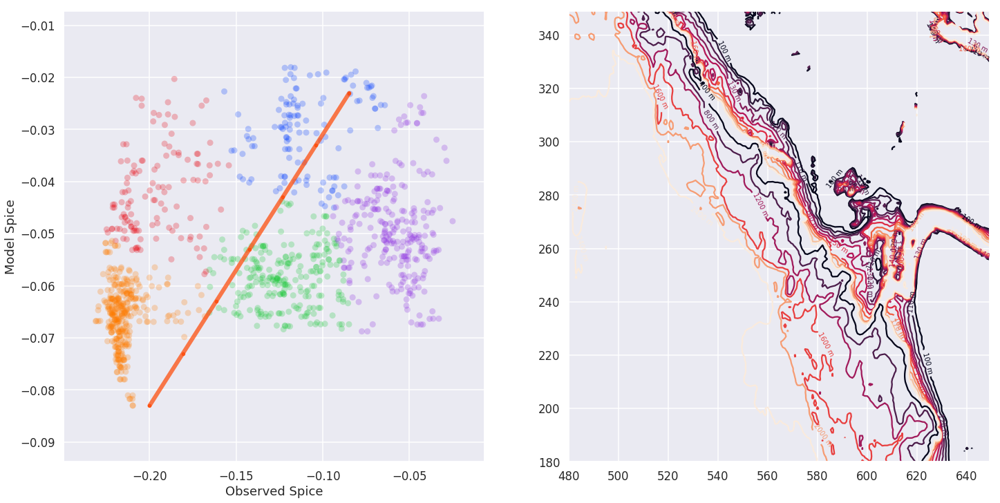

In [30]:
df =pd.DataFrame()

# df['Observed_Spice'] = survey_iso_spic_A
# df['Model_Spice'] = model_spic_A




df['Observed Spice'] = survey_iso_spic_264
df['Model Spice'] = model_spic_264


import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

# >>> def func(x, a, b, c):
# #     return a * np.exp(-b * x) + c

# calculate polynomial
z = np.polyfit(df['Model Spice'],df['Observed Spice'], 1)
f = np.poly1d(z)

# calculate new x's and y's
x_new = np.arange(np.min(df['Model Spice']), np.max(df['Model Spice']), 0.01)
y_new = f(x_new)

x_fit = df['Model Spice']
y_fit = f(x_fit)


df['Fitted Spice'] = y_fit




fig, (ax1,ax) = plt.subplots(1,2, figsize=(24,12))

# q = plot_clusters(df, cluster.KMeans, (), {'n_clusters':3})

labels, colors = plot_clusters(ax=ax1, data=df, algorithm=cluster.KMeans, args=(), kwds={'n_clusters':5})
colors = np.array(colors)
ax1.set_xlabel("Observed Spice")
ax1.set_ylabel("Model Spice")

ax1.plot(y_new, x_new, lw=6, c='orangered', marker='.', alpha=0.7)

# gamma2,rms_error,ws = get_stat(df['Observed Spice'], df['Fitted Spice'])
# anchored_text = AnchoredText("Statistics with Fitted Line: Willmott Score \u2248 {w:.2f}, RMSE \u2248 {r:.2f} and Bias \u2248 {b:.2f}". format(w = ws, r = rms_error, b = gamma2),prop=dict(size=14), loc=3, frameon=True,
#                        bbox_to_anchor=(0., 1.),
#                        bbox_transform=ax1.transAxes
#                        )
# ax1.add_artist(anchored_text)


# gamma2,rms_error,ws = get_stat(df['Observed Spice'], df['Model Spice'])
# anchored_text = AnchoredText("Willmott Score \u2248 {w:.2f}, RMSE \u2248 {r:.2f} and Bias \u2248 {b:.2f}". format(w = ws, r = rms_error, b = gamma2),prop=dict(size=14), loc=3, frameon=True,
#                        bbox_to_anchor=(0.32, 0.),
#                        bbox_transform=ax1.transAxes
#                        )
# ax1.add_artist(anchored_text)

# ax.axhline(y=-0.055, c = 'teal')
# ax.axvline(x= -0.17, c = 'teal')

# ax.axhline(y=-0.037, c = 'red')


bathy = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/Bathymetry_EastCoast_NEMO_R036_GEBCO_corr_v14.nc')

mbathy = mask.variables['mbathy'][0,180:350, 480:650]
Z = bathy.variables['Bathymetry']


lon = bathy['nav_lon']
lat = bathy['nav_lat']
y_wcvi_slice = np.array(np.arange(180,350))
x_wcvi_slice = np.array(np.arange(480,650))


# cmap = plt.get_cmap('deep')
# cmap = sns.color_palette('bright', np.unique(labels).max() + 1)
#     cmap.set_bad('burlywood')
# cmap.set_bad('#8b7765')
# fig, ax = plt.subplots(1, 1, figsize=(20,16)); ax.grid()
#     ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=np.mean(lon)))
CS = ax.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,200,10))
CS1 = ax.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], level = [0,100,200,500,1000])
CLS = plt.clabel(CS, inline=3,fmt='%0.0f m', fontsize=10)
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=10)

# q = ax.pcolormesh(x_wcvi_slice, y_wcvi_slice, val_iso[:], cmap=cmap, vmin= cmin, vmax= cmax)
# cbar = fig.colorbar(q, ax=ax)

# for i in np.arange(x_added_3.shape[0]):

#     ax.scatter(x_wcvi_slice[np.int(x_added_3[i])], y_wcvi_slice[np.int(y_added_3[i])], c = 'cyan', alpha =0.5, s=200, edgecolor= 'cyan')



y_264_cluster_1 = y_added_1[labels == 0]
x_264_cluster_1 = x_added_1[labels == 0]

y_264_cluster_2 = y_added_1[labels == 1]
x_264_cluster_2 = x_added_1[labels == 1]

y_264_cluster_3 = y_added_1[labels == 2]
x_264_cluster_3 = x_added_1[labels == 2]

y_264_cluster_4 = y_added_1[labels == 3]
x_264_cluster_4 = x_added_1[labels == 3]

y_264_cluster_5 = y_added_1[labels == 4]
x_264_cluster_5 = x_added_1[labels == 4]


for i in np.arange(x_264_cluster_1.shape[0]):

    ax.scatter(x_wcvi_slice[np.int(x_264_cluster_1[i])], y_wcvi_slice[np.int(y_264_cluster_1[i])], c = colors[labels == 0], alpha= 0.5, s=200, edgecolor= 'black', label = 'cluster 1')

for i in np.arange(x_264_cluster_2.shape[0]):

    ax.scatter(x_wcvi_slice[np.int(x_264_cluster_2[i])], y_wcvi_slice[np.int(y_264_cluster_2[i])], c = colors[labels == 1], alpha =0.5, s=200, edgecolor= 'black', label = 'cluster 2')

for i in np.arange(x_264_cluster_3.shape[0]):

    ax.scatter(x_wcvi_slice[np.int(x_264_cluster_3[i])], y_wcvi_slice[np.int(y_264_cluster_3[i])], c = colors[labels == 2], alpha =0.5, s=200, edgecolor= 'black', label = 'cluster 3')

for i in np.arange(x_264_cluster_4.shape[0]):

    ax.scatter(x_wcvi_slice[np.int(x_264_cluster_4[i])], y_wcvi_slice[np.int(y_264_cluster_4[i])], c = colors[labels == 3], alpha =0.5, s=200, edgecolor= 'black', label = 'cluster 4')

for i in np.arange(x_264_cluster_5.shape[0]):

    ax.scatter(x_wcvi_slice[np.int(x_264_cluster_5[i])], y_wcvi_slice[np.int(y_264_cluster_5[i])], c = colors[labels == 4], alpha =0.5, s=200, edgecolor= 'black', label = 'cluster 5')

ax.set_ylim(220,300)
ax.set_xlim(560,640)


### Figure 7

In [1]:
%matplotlib notebook
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import numpy.ma as ma
import glob
from collections import namedtuple, OrderedDict
import netCDF4 as nc
import os
import scipy
import scipy.io as sio
from scipy import interpolate, signal
from pyproj import Proj,transform
import sys
sys.path.append('/ocean/ssahu/CANYONS/wcvi/grid/')
from bathy_common import *
from matplotlib import path
from salishsea_tools import viz_tools
import xarray as xr
from salishsea_tools import nc_tools
import scipy.io as sio
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.cm as cm
import cmocean as cmo
import matplotlib.gridspec as gridspec
%matplotlib inline
from scipy.io import loadmat
from scipy.interpolate import griddata
from dateutil.parser import parse
from salishsea_tools import geo_tools, viz_tools, tidetools, nc_tools
import gsw
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib.patches import Ellipse
import matplotlib as mpl

import seaborn as sns
from windrose import plot_windrose
from windrose import WindroseAxes


from dateutil        import parser
from datetime import datetime

import numpy.ma as ma

sns.set_context('talk')
sns.set_style('darkgrid')

/home/ssahu/anaconda3/lib/python3.5/site-packages/xarray/conventions.py:9: FutureWarning: The pandas.tslib module is deprecated and will be removed in a future version.
  from pandas.tslib import OutOfBoundsDatetime


In [2]:
zlevels = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/CDF_COMB_COMPRESSED/NEP036-N30_IN_20140915_00001440_grid_T.nc').variables['deptht'][:32]
y_wcvi_slice = np.array(np.arange(180,350))
x_wcvi_slice = np.array(np.arange(480,650))


bathy = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/Bathymetry_EastCoast_NEMO_R036_GEBCO_corr_v14.nc')

Z = bathy.variables['Bathymetry']


lon = bathy['nav_lon'][...]
lat = bathy['nav_lat'][...]



nc_file = nc.Dataset('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/accurate_isopyncal_particle_positions/\
eddy_water.nc')
nc_tools.show_variables(nc_file)

odict_keys(['init_x', 'init_y', 'init_z', 'init_t', 'init_age', 'init_transp', 'final_x', 'final_y', 'final_z', 'final_t', 'final_age', 'final_transp', 'traj_lon', 'traj_lat', 'traj_depth', 'traj_time', 'traj_temp', 'traj_salt', 'traj_dens'])


In [3]:


init_x = nc_file.variables['init_x']
init_z = nc_file.variables['init_z']
init_age = nc_file.variables['init_age']

traj_depth = nc_file.variables['traj_depth'][:]
traj_lon   = nc_file.variables['traj_lon'][:]
traj_lat   = nc_file.variables['traj_lat'][:]
traj_rho   = nc_file.variables['traj_dens'][:]
traj_tem   = nc_file.variables['traj_temp'][:]
traj_sal   = nc_file.variables['traj_salt'][:]
traj_time  = nc_file.variables['traj_time']


final_age = nc_file.variables['final_age']


# lon1=nc_file.variables['traj_lon'][:]
# lat1=nc_file.variables['traj_lat'][:]
# dep1=nc_file.variables['traj_depth'][:]
x1=nc_file.variables['init_x'][:]
y1=nc_file.variables['init_y'][:]
t1=nc_file.variables['traj_time'][:]

x_low = x1
y_low = y1

x2=nc_file.variables['final_x'][:]
y2=nc_file.variables['final_y'][:]


final_z = nc_file.variables['final_z'][:]

final_age_days = final_age[:]/(3600)

/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:10: UserWarning: WARNING: missing_value not used since it
cannot be safely cast to variable data type
/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:11: UserWarning: WARNING: missing_value not used since it
cannot be safely cast to variable data type
/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:12: UserWarning: WARNING: missing_value not used since it
cannot be safely cast to variable data type


In [4]:
x_final = []
y_final = []


for i in np.arange(x2.shape[0]):
    x_final = np.append(arr=x_final,values=x_wcvi_slice[np.int(np.rint(x2[i]))-1])
    y_final = np.append(arr=y_final,values=y_wcvi_slice[np.int(np.rint(y2[i]))-1])

In [5]:
x = [510,575]
y = [320,200]


coefficients = np.polyfit(x, y, 1)

x_final_off = np.arange(x[0],x[1])
polynomial = np.poly1d(coefficients)
y_final_off = np.rint(polynomial(x_final_off))

p1= (x[0],y[0])
p1 = np.asarray(p1)
p2 = (x[1], y[1])
p2 = np.asarray(p2)



d = np.empty_like(x_final)

off_ind = []


for r in np.arange(x_final.shape[0]):

    p3 = (x_final[r], y_final[r])
    p3 = np.asarray(p3)
    d[r] =np.cross(p2-p1,p3-p1)/np.linalg.norm(p2-p1)
    
    if ((d[r] < 0) & (x_final[r] < 575)):
        off_ind = np.append(arr=off_ind, values=np.int(r))

In [6]:
num_north = np.round(a=final_age[(x_final < 580) & (y_final > 300)].shape[0]/final_z.shape[0], decimals=3)

north_percent = 100*num_north

print(north_percent)

num_cuc = np.round(a=np.where(final_z[((x_final < 630) & (y_final < 200)) & \
                                      ((x_final > 580) & (y_final < 200))]>26.3)[0].shape[0]/final_z.shape[0], decimals = 3)

cuc_percent = 100*num_cuc

print(cuc_percent)

num_south = np.round(a=np.where(final_z[((x_final < 630) & (y_final < 200)) & \
                                      ((x_final > 580) & (y_final < 200))]<=26.3)[0].shape[0]/final_z.shape[0], decimals = 3)

south_percent = 100*num_south

print(south_percent)

### Bigger box
x = [510,575]
y = [320,200]


coefficients = np.polyfit(x, y, 1)

x_final_off = np.arange(x[0],x[1])
polynomial = np.poly1d(coefficients)
y_final_off = np.rint(polynomial(x_final_off))

num_off = off_ind.shape[0]/final_z.shape[0]
off_percent = np.round(a=100*num_off, decimals=1)

print(off_percent)

num_juan = np.round(a=np.where((x_final > 648))[0].shape[0]/final_z.shape[0], decimals=3)

juan_percent = num_juan*100

print(juan_percent)

7.7
26.2
17.4
11.5
4.2


In [7]:
cuc_percent_low = cuc_percent
juan_percent_low = juan_percent
north_percent_low = north_percent
south_percent_low = south_percent
off_percent_low = off_percent



In [8]:
traj_tem_last   = np.empty_like(final_age_days)
traj_sal_last   = np.empty_like(final_age_days)
traj_rho_last   = np.empty_like(final_age_days)
traj_depth_last = np.empty_like(final_age_days)


traj_tem_init   = np.empty_like(final_age_days)
traj_sal_init   = np.empty_like(final_age_days)
traj_rho_init   = np.empty_like(final_age_days)
traj_depth_init = np.empty_like(final_age_days)

for r in np.arange(traj_tem_last.shape[0]):
    traj_tem_last[r]  =  traj_tem[np.int(final_age_days[r]),r]
    traj_sal_last[r]  =  traj_sal[np.int(final_age_days[r]),r]
    traj_rho_last[r]  =  traj_rho[np.int(final_age_days[r]),r]
    traj_depth_last[r] = traj_depth[np.int(final_age_days[r]),r]
    
    traj_tem_init[r]  =  traj_tem[0,r]
    traj_sal_init[r]  =  traj_sal[0,r]
    traj_rho_init[r]  =  traj_rho[0,r]    
    traj_depth_init[r]=  traj_depth[0,r] 
    

In [9]:
max_life_ind = np.array(np.where(final_age_days == np.max(final_age_days))[0])

off_ind   = off_ind
north_ind = np.where([(x_final < 580) & (y_final > 300)])[1]
north_ind = north_ind[np.where(x_final[north_ind].astype(int) > 500)]
south_ind = []
cuc_ind   = []


ind_all_south  = np.where(((x_final < 630) & (y_final < 200)) & \
                                      ((x_final > 580) & (y_final < 200)))[0]

for k in ind_all_south:
    if final_z[k] <= 26.3:
        south_ind = np.append(arr=south_ind, values= k)
        
    if final_z[k] > 26.3:
        cuc_ind = np.append(arr=cuc_ind, values=k)
        

juan_ind =  np.where((x_final > 648))[0]

non_local_ind = np.concatenate((off_ind, north_ind, south_ind, cuc_ind, juan_ind))

ind_local = np.setdiff1d(max_life_ind, np.unique(non_local_ind, return_index= False).astype(int), assume_unique=True)

# off_ind/

# ind_local = np.setdiff1d(max_life_ind, off_ind, assume_unique= True)

x_local_low_actual = x2[ind_local]
y_local_low_actual = y2[ind_local]

depth_local_low_actual = -traj_depth_last[ind_local]


In [10]:
count_ind = np.concatenate((ind_local, np.unique(non_local_ind, return_index= False).astype(int)))

count_ind.shape[0]/final_z.shape[0]

0.973753280839895

In [11]:
ind_local.shape[0]/final_z.shape[0]

0.32983377077865267

In [12]:

traj_tem_final_cuc = traj_tem_last[cuc_ind.astype(int)]
traj_sal_final_cuc = traj_sal_last[cuc_ind.astype(int)]
traj_rho_final_cuc = traj_rho_last[cuc_ind.astype(int)]
traj_depth_final_cuc = traj_depth_last[cuc_ind.astype(int)]
traj_days_final_cuc = final_age_days[cuc_ind.astype(int)]/24



traj_tem_final_north = traj_tem_last[north_ind.astype(int)]
traj_sal_final_north = traj_sal_last[north_ind.astype(int)]
traj_rho_final_north = traj_rho_last[north_ind.astype(int)]
traj_depth_final_north = traj_depth_last[north_ind.astype(int)]
traj_days_final_north = final_age_days[north_ind.astype(int)]/24



traj_tem_final_south   = traj_tem_last[south_ind.astype(int)]
traj_sal_final_south   = traj_sal_last[south_ind.astype(int)]
traj_rho_final_south   = traj_rho_last[south_ind.astype(int)]
traj_depth_final_south = traj_depth_last[south_ind.astype(int)]
traj_days_final_south  = final_age_days[south_ind.astype(int)]/24


traj_tem_final_juan = traj_tem_last[juan_ind.astype(int)]
traj_sal_final_juan = traj_sal_last[juan_ind.astype(int)]
traj_rho_final_juan = traj_rho_last[juan_ind.astype(int)]
traj_depth_final_juan = traj_depth_last[juan_ind.astype(int)]
traj_days_final_juan = final_age_days[juan_ind.astype(int)]/24


traj_tem_final_local = traj_tem_last[ind_local.astype(int)]
traj_sal_final_local = traj_sal_last[ind_local.astype(int)]
traj_rho_final_local = traj_rho_last[ind_local.astype(int)]
traj_depth_final_local = traj_depth_last[ind_local.astype(int)]
traj_days_final_local = final_age_days[ind_local.astype(int)]/24




x = [510,575]
y = [320,200]

coefficients = np.polyfit(x, y, 1)
x_final_off = np.arange(x[0],x[1])
polynomial = np.poly1d(coefficients)
y_final_off = np.rint(polynomial(x_final_off))

traj_tem_final_off = []
traj_sal_final_off = []
traj_rho_final_off = []
traj_depth_final_off = []
traj_days_final_off = []

for l in np.arange(off_ind.shape[0]):

    traj_depth_final_off = np.append(arr=traj_depth_final_off, values=traj_depth_last[np.int(off_ind[l])])
    traj_days_final_off = np.append(arr=traj_days_final_off, values=final_age_days[np.int(off_ind[l])]/24)
    traj_rho_final_off   = np.append(arr=traj_rho_final_off, values=traj_rho_last[np.int(off_ind[l])])
    traj_tem_final_off   = np.append(arr=traj_tem_final_off, values=traj_tem_last[np.int(off_ind[l])])
    traj_sal_final_off   = np.append(arr=traj_sal_final_off, values=traj_sal_last[np.int(off_ind[l])])


In [134]:
pressure_loc_cuc = np.empty_like(traj_depth_final_cuc)
SA_loc_cuc       = np.empty_like(traj_depth_final_cuc)
CT_loc_cuc       = np.empty_like(traj_depth_final_cuc)
spic_loc_cuc     = np.empty_like(traj_depth_final_cuc)



for i in np.arange(traj_depth_final_cuc.shape[0]):
    
    pressure_loc_cuc[i] = gsw.p_from_z(traj_depth_final_cuc[i],np.mean(traj_lat))
    
    SA_loc_cuc[i] = gsw.SA_from_SP(traj_sal_final_cuc[i], pressure_loc_cuc[i], np.mean(traj_lon), np.mean(traj_lat))
    
    CT_loc_cuc[i] = gsw.CT_from_pt(traj_sal_final_cuc[i], traj_tem_final_cuc[i])
    
    spic_loc_cuc[i] = gsw.spiciness0(SA_loc_cuc[i], CT_loc_cuc[i])
    
pressure_loc_off = np.empty_like(traj_depth_final_off)
SA_loc_off       = np.empty_like(traj_depth_final_off)
CT_loc_off       = np.empty_like(traj_depth_final_off)
spic_loc_off     = np.empty_like(traj_depth_final_off)



for i in np.arange(traj_depth_final_off.shape[0]):
    
    pressure_loc_off[i] = gsw.p_from_z(traj_depth_final_off[i],np.mean(traj_lat))
    
    SA_loc_off[i] = gsw.SA_from_SP(traj_sal_final_off[i], pressure_loc_off[i], np.mean(traj_lon), np.mean(traj_lat))
    
    CT_loc_off[i] = gsw.CT_from_pt(traj_sal_final_off[i], traj_tem_final_off[i])
    
    spic_loc_off[i] = gsw.spiciness0(SA_loc_off[i], CT_loc_off[i])
    
pressure_loc_south = np.empty_like(traj_depth_final_south)
SA_loc_south       = np.empty_like(traj_depth_final_south)
CT_loc_south       = np.empty_like(traj_depth_final_south)
spic_loc_south     = np.empty_like(traj_depth_final_south)



for i in np.arange(traj_depth_final_south.shape[0]):
    
    pressure_loc_south[i] = gsw.p_from_z(traj_depth_final_south[i],np.mean(traj_lat))
    
    SA_loc_south[i] = gsw.SA_from_SP(traj_sal_final_south[i], pressure_loc_south[i], np.mean(traj_lon), np.mean(traj_lat))
    
    CT_loc_south[i] = gsw.CT_from_pt(traj_sal_final_south[i], traj_tem_final_south[i])
    
    spic_loc_south[i] = gsw.spiciness0(SA_loc_south[i], CT_loc_south[i])
    
pressure_loc_north= np.empty_like(traj_depth_final_north)
SA_loc_north       = np.empty_like(traj_depth_final_north)
CT_loc_north       = np.empty_like(traj_depth_final_north)
spic_loc_north     = np.empty_like(traj_depth_final_north)



for i in np.arange(traj_depth_final_north.shape[0]):
    
    pressure_loc_north[i] = gsw.p_from_z(traj_depth_final_north[i],np.mean(traj_lat))
    
    SA_loc_north[i] = gsw.SA_from_SP(traj_sal_final_north[i], pressure_loc_north[i], np.mean(traj_lon), np.mean(traj_lat))
    
    CT_loc_north[i] = gsw.CT_from_pt(traj_sal_final_north[i], traj_tem_final_north[i])
    
    spic_loc_north[i] = gsw.spiciness0(SA_loc_north[i], CT_loc_north[i])
    

pressure_loc_juan= np.empty_like(traj_depth_final_juan)
SA_loc_juan       = np.empty_like(traj_depth_final_juan)
CT_loc_juan       = np.empty_like(traj_depth_final_juan)
spic_loc_juan     = np.empty_like(traj_depth_final_juan)



for i in np.arange(traj_depth_final_juan.shape[0]):
    
    pressure_loc_juan[i] = gsw.p_from_z(traj_depth_final_juan[i],np.mean(traj_lat))
    
    SA_loc_juan[i] = gsw.SA_from_SP(traj_sal_final_juan[i], pressure_loc_juan[i], np.mean(traj_lon), np.mean(traj_lat))
    
    CT_loc_juan[i] = gsw.CT_from_pt(traj_sal_final_juan[i], traj_tem_final_juan[i])
    
    spic_loc_juan[i] = gsw.spiciness0(SA_loc_juan[i], CT_loc_juan[i])
    

In [135]:

pressure_loc_init = np.empty_like(traj_tem_init)
SA_loc_init       = np.empty_like(traj_depth_init)
CT_loc_init       = np.empty_like(traj_depth_init)
spic_loc_init     = np.empty_like(traj_depth_init)



for i in np.arange(traj_depth_init.shape[0]):
    
    pressure_loc_init[i] = gsw.p_from_z(traj_depth_init[i],np.mean(traj_lat))
    
    SA_loc_init[i] = gsw.SA_from_SP(traj_sal_init[i], pressure_loc_init[i], np.mean(traj_lon), np.mean(traj_lat))
    
    CT_loc_init[i] = gsw.CT_from_pt(traj_sal_init[i], traj_tem_init[i])
    
    spic_loc_init[i] = gsw.spiciness0(SA_loc_init[i], CT_loc_init[i])
    
    
pressure_loc_local = np.empty_like(traj_depth_final_local)
SA_loc_local       = np.empty_like(traj_depth_final_local)
CT_loc_local       = np.empty_like(traj_depth_final_local)
spic_loc_local     = np.empty_like(traj_depth_final_local)



for i in np.arange(traj_depth_final_local.shape[0]):
    
    pressure_loc_local[i] = gsw.p_from_z(traj_depth_final_local[i],np.mean(traj_lat))
    
    SA_loc_local[i] = gsw.SA_from_SP(traj_sal_final_local[i], pressure_loc_local[i], np.mean(traj_lon), np.mean(traj_lat))
    
    CT_loc_local[i] = gsw.CT_from_pt(traj_sal_final_local[i], traj_tem_final_local[i])
    
    spic_loc_local[i] = gsw.spiciness0(SA_loc_local[i], CT_loc_local[i])    
    

In [136]:
spic_loc_local = spic_loc_local[spic_loc_local>-2]
spic_loc_init = spic_loc_init[spic_loc_init>-2]


In [139]:
##For Spice


spic_cuc   = np.mean(spic_loc_cuc)
spic_south = np.mean(spic_loc_south)
spic_off   = np.mean(spic_loc_off)
spic_north = np.mean(spic_loc_north)
spic_juan  = np.mean(spic_loc_juan)
spic_local = np.mean(spic_loc_local)

spic_cuc_std   = np.std(spic_loc_cuc)
spic_south_std = np.std(spic_loc_south)
spic_off_std   = np.std(spic_loc_off)
spic_north_std = np.std(spic_loc_north)
spic_juan_std  = np.std(spic_loc_juan)
spic_local_std = np.std(spic_loc_local)

frac_cuc   = cuc_percent_low/100
frac_south = south_percent_low/100
frac_off   = off_percent_low/100
frac_north = north_percent_low/100
frac_juan = juan_percent_low/100
frac_local = (ind_local.shape[0]/final_z.shape[0])

# spic_mixed = spic_cuc*frac_cuc + spic_south*frac_south + spic_off*frac_off + spic_juan*frac_juan + spic_north*frac_north + \
#      spic_local*frac_local

spic_mixed = spic_cuc*frac_cuc + spic_south*frac_south + spic_local*frac_local
    
print(spic_mixed)

# err_mixing_spic = np.sqrt((spic_cuc_std*frac_cuc)**2 + (spic_south_std*frac_south)**2 + (spic_off_std*frac_off)**2 + (spic_juan_std*frac_juan)**2 + \
#               (spic_north_std*frac_north)**2 + (spic_local_std*frac_local)**2)

err_mixing_spic = np.sqrt((spic_cuc_std*frac_cuc)**2 + (spic_south_std*frac_south)**2 + (spic_local_std*frac_local)**2)

print(err_mixing_spic)

print(np.mean(spic_loc_init))

-0.0639782647834
0.0804868819745
-0.0750174962786


In [141]:
##For Spice


T_cuc   = np.mean(traj_tem_final_cuc)
T_south = np.mean(traj_tem_final_south)
T_off   = np.mean(traj_tem_final_off)
T_north = np.mean(traj_tem_final_north)
T_juan  = np.mean(traj_tem_final_juan)
T_local = np.mean(traj_tem_final_local)

T_cuc_std   = np.std(traj_tem_final_cuc)
T_south_std = np.std(traj_tem_final_south)
T_off_std   = np.std(traj_tem_final_off)
T_north_std = np.std(traj_tem_final_north)
T_juan_std  = np.std(traj_tem_final_juan)
T_local_std = np.std(traj_tem_final_local)

frac_cuc   = cuc_percent_low/100
frac_south = south_percent_low/100
frac_off   = off_percent_low/100
frac_north = north_percent_low/100
frac_juan = juan_percent_low/100


frac_local = (ind_local.shape[0]/final_z.shape[0])

# T_mixed = T_cuc*frac_cuc + T_south*frac_south + T_local*frac_local
T_mixed = T_cuc*frac_cuc + T_south*frac_south + T_off*frac_off + T_juan*frac_juan + T_north*frac_north + \
     T_local*frac_local
    
print(T_mixed)

err_mixing_T = np.sqrt((T_cuc_std*frac_cuc)**2 + (T_south_std*frac_south)**2 + (T_off_std*frac_off)**2 + (T_juan_std*frac_juan)**2 + \
              (T_north_std*frac_north)**2 + (T_local_std*frac_local)**2)

# err_mixing_T = np.sqrt((T_cuc_std*frac_cuc)**2 + (T_south_std*frac_south)**2 + (T_local_std*frac_local)**2)

print(err_mixing_T)

print(np.mean(traj_tem_init))

7.29880780379
0.279169735158
7.44047526362


In [155]:
##For Spice


Sal_cuc   = np.mean(traj_sal_final_cuc)
Sal_south = np.mean(traj_sal_final_south)
Sal_off   = np.mean(traj_sal_final_off)
Sal_north = np.mean(traj_sal_final_north)
Sal_juan  = np.mean(traj_sal_final_juan)
Sal_local = np.mean(traj_sal_final_local)

Sal_cuc_std   = np.std(traj_sal_final_cuc)
Sal_south_std = np.std(traj_sal_final_south)
Sal_off_std   = np.std(traj_sal_final_off)
Sal_north_std = np.std(traj_sal_final_north)
Sal_juan_std  = np.std(traj_sal_final_juan)
Sal_local_std = np.std(traj_sal_final_local)

frac_cuc   = cuc_percent_low/100
frac_south = (south_percent_low/100)*1.009
frac_off   = off_percent_low/100
frac_north = north_percent_low/100
frac_juan = juan_percent_low/100


frac_local = (ind_local.shape[0]/final_z.shape[0])

# Sal_mixed = Sal_cuc*frac_cuc + Sal_south*frac_south + Sal_local*frac_local
Sal_mixed = Sal_cuc*frac_cuc + Sal_south*frac_south + Sal_off*frac_off + Sal_juan*frac_juan + Sal_north*frac_north + \
     Sal_local*frac_local
    
print(Sal_mixed)

err_mixing_Sal = np.sqrt((Sal_cuc_std*frac_cuc)**2 + (Sal_south_std*frac_south)**2 + (Sal_off_std*frac_off)**2 + (Sal_juan_std*frac_juan)**2 + \
              (Sal_north_std*frac_north)**2 + (Sal_local_std*frac_local)**2)

# err_mixing_Sal = np.sqrt((Sal_cuc_std*frac_cuc)**2 + (Sal_south_std*frac_south)**2 + (Sal_local_std*frac_local)**2)

print(err_mixing_Sal)

print(np.mean(traj_sal_init))

33.6091493146
0.35452178636
33.6885231582


In [158]:
##For Density


Rho_cuc   = np.mean(traj_rho_final_cuc)
Rho_south = np.mean(traj_rho_final_south)
Rho_off   = np.mean(traj_rho_final_off)
Rho_north = np.mean(traj_rho_final_north)
Rho_juan  = np.mean(traj_rho_final_juan)
Rho_local = np.mean(traj_rho_final_local)

Rho_cuc_std   = np.std(traj_rho_final_cuc)
Rho_south_std = np.std(traj_rho_final_south)
Rho_off_std   = np.std(traj_rho_final_off)
Rho_north_std = np.std(traj_rho_final_north)
Rho_juan_std  = np.std(traj_rho_final_juan)
Rho_local_std = np.std(traj_rho_final_local)

frac_cuc   = cuc_percent_low/100
frac_south = (south_percent_low/100)*1.009
frac_off   = off_percent_low/100
frac_north = north_percent_low/100
frac_juan = juan_percent_low/100
frac_local = (ind_local.shape[0]/final_z.shape[0])

# Rho_mixed = Rho_cuc*frac_cuc + Rho_south*frac_south + Rho_local*frac_local
Rho_mixed = Rho_cuc*frac_cuc + Rho_south*frac_south + Rho_off*frac_off + Rho_juan*frac_juan + Rho_north*frac_north + \
     Rho_local*frac_local
    
print(Rho_mixed)

err_mixing_Rho = np.sqrt((Rho_cuc_std*frac_cuc)**2 + (Rho_south_std*frac_south)**2 + (Rho_off_std*frac_off)**2 + (Rho_juan_std*frac_juan)**2 + \
              (Rho_north_std*frac_north)**2 + (Rho_local_std*frac_local)**2)

# err_mixing_Rho = np.sqrt((Rho_cuc_std*frac_cuc)**2 + (Rho_south_std*frac_south)**2 + (Rho_local_std*frac_local)**2)

print(err_mixing_Rho)

print(np.mean(traj_rho_init))

26.2787234566
0.286639447484
26.324446452


In [147]:
def calculate_kde(variable):
    
    
    if variable == 'Temperature':
        

        
        kde_cuc = scipy.stats.gaussian_kde(traj_tem_final_cuc)
        kde_south = scipy.stats.gaussian_kde(traj_tem_final_south)
        kde_local = scipy.stats.gaussian_kde(traj_tem_final_local)
        kde_juan  = scipy.stats.gaussian_kde(traj_tem_final_juan)
        kde_north = scipy.stats.gaussian_kde(traj_tem_final_north)
        kde_off = scipy.stats.gaussian_kde(traj_tem_final_off)

        kde_init  = scipy.stats.gaussian_kde(traj_tem_init)
        
        
        mu = T_mixed
        sigma = err_mixing_T
        #grid = np.linspace(-0.3,0.2,500)
#         grid = np.linspace(mu - 6*sigma, mu + 6*sigma, 100)        
        grid = np.linspace(5,10, 10000) 

        #weighted kde curves
        w_cuc   = kde_cuc(grid)*(cuc_percent/100)
        w_south = kde_south(grid)*(south_percent/100)
        w_local = kde_local(grid)*(ind_local.shape[0]/final_z.shape[0])
        w_north = kde_north(grid)*(north_percent/100)
        w_juan = kde_juan(grid)*(juan_percent/100)
        w_off = kde_off(grid)*(off_percent/100)
        w_init = kde_init(grid)
        
        return w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma
    
        
    if variable == 'Salinity':
        

        
        kde_cuc = scipy.stats.gaussian_kde(traj_sal_final_cuc, bw_method=-1)
        kde_south = scipy.stats.gaussian_kde(traj_sal_final_south)
        kde_local = scipy.stats.gaussian_kde(traj_sal_final_local)
        kde_juan  = scipy.stats.gaussian_kde(traj_sal_final_juan)
        kde_north = scipy.stats.gaussian_kde(traj_sal_final_north)
        kde_off = scipy.stats.gaussian_kde(traj_sal_final_off)

        kde_init  = scipy.stats.gaussian_kde(traj_sal_init)
        
        
        mu = Sal_mixed
        sigma = err_mixing_Sal
        #grid = np.linspace(-0.3,0.2,500)
#         grid = np.linspace(33, mu + 3*sigma, 100)  
        grid = np.linspace(31, 34.5, 10000) 
        

        #weighted kde curves
        w_cuc   = kde_cuc(grid)*(cuc_percent/100)
        w_south = kde_south(grid)*(south_percent/100)
        w_local = kde_local(grid)*(ind_local.shape[0]/final_z.shape[0])
        w_north = kde_north(grid)*(north_percent/100)
        w_juan = kde_juan(grid)*(juan_percent/100)
        w_off = kde_off(grid)*(off_percent/100)
        w_init = kde_init(grid)
        
        return w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma
    
    if variable == 'Density':
        

        
        kde_cuc = scipy.stats.gaussian_kde(traj_rho_final_cuc, bw_method=-1)
        kde_south = scipy.stats.gaussian_kde(traj_rho_final_south)
        kde_local = scipy.stats.gaussian_kde(traj_rho_final_local)
        kde_juan  = scipy.stats.gaussian_kde(traj_rho_final_juan)
        kde_north = scipy.stats.gaussian_kde(traj_rho_final_north)
        kde_off = scipy.stats.gaussian_kde(traj_rho_final_off)

        kde_init  = scipy.stats.gaussian_kde(traj_rho_init)
        
        
        mu = Rho_mixed
        sigma = err_mixing_Rho
        #grid = np.linspace(-0.3,0.2,500)
#         grid = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)    
        grid = np.linspace(23,28, 10000) 
        

        #weighted kde curves
        w_cuc   = kde_cuc(grid)*(cuc_percent/100)
        w_south = kde_south(grid)*(south_percent/100)
        w_local = kde_local(grid)*(ind_local.shape[0]/final_z.shape[0])
        w_north = kde_north(grid)*(north_percent/100)
        w_juan = kde_juan(grid)*(juan_percent/100)
        w_off = kde_off(grid)*(off_percent/100)
        w_init = kde_init(grid)
        
        return w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma
     
    
    
    if variable == 'Spice':
        

        
        kde_cuc = scipy.stats.gaussian_kde(spic_loc_cuc, bw_method=-1)
        kde_south = scipy.stats.gaussian_kde(spic_loc_south)
        kde_local = scipy.stats.gaussian_kde(spic_loc_local)
        kde_juan  = scipy.stats.gaussian_kde(spic_loc_juan)
        kde_north = scipy.stats.gaussian_kde(spic_loc_north)
        kde_off = scipy.stats.gaussian_kde(spic_loc_off)

        kde_init  = scipy.stats.gaussian_kde(spic_loc_init)
        
        
        mu = spic_mixed
        sigma = err_mixing_spic
        #grid = np.linspace(-0.3,0.2,500)
#         grid = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)  
        grid = np.linspace(-2,2, 10000)   

#         grid = np.linspace(5,10, 10000)    
        

        #weighted kde curves
        w_cuc   = kde_cuc(grid)*(cuc_percent/100)
        w_south = kde_south(grid)*(south_percent/100)
        w_local = kde_local(grid)*(ind_local.shape[0]/final_z.shape[0])
        w_north = kde_north(grid)*(north_percent/100)
        w_juan = kde_juan(grid)*(juan_percent/100)
        w_off = kde_off(grid)*(off_percent/100)
        w_init = kde_init(grid)
        
        return w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma
    
    
    if variable == 'Depth':
        

        
        kde_cuc = scipy.stats.gaussian_kde(-traj_depth_final_cuc)
        kde_south = scipy.stats.gaussian_kde(-traj_depth_final_south)
        kde_local = scipy.stats.gaussian_kde(-traj_depth_final_local)
        kde_juan  = scipy.stats.gaussian_kde(-traj_depth_final_juan)
        kde_north = scipy.stats.gaussian_kde(-traj_depth_final_north)
        kde_off = scipy.stats.gaussian_kde(-traj_depth_final_off)

        kde_init  = scipy.stats.gaussian_kde(-traj_depth_init)
        
        
 
        #grid = np.linspace(-0.3,0.2,500)
#         grid = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)  
        grid = np.linspace(0,500, 10000)   

#         grid = np.linspace(5,10, 10000)    
        

        #weighted kde curves
        w_cuc   = kde_cuc(grid)*(cuc_percent/100)
        w_south = kde_south(grid)*(south_percent/100)
        w_local = kde_local(grid)*(ind_local.shape[0]/final_z.shape[0])
        w_north = kde_north(grid)*(north_percent/100)
        w_juan = kde_juan(grid)*(juan_percent/100)
        w_off = kde_off(grid)*(off_percent/100)
        w_init = kde_init(grid)
        
        return w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid
    
    
    if variable == 'Days':
        

        
        kde_cuc = scipy.stats.gaussian_kde(traj_days_final_cuc)
        kde_south = scipy.stats.gaussian_kde(traj_days_final_south)
#         kde_local = scipy.stats.gaussian_kde(traj_days_final_local)
        kde_juan  = scipy.stats.gaussian_kde(traj_days_final_juan)
        kde_north = scipy.stats.gaussian_kde(traj_days_final_north)
        kde_off = scipy.stats.gaussian_kde(traj_days_final_off)


        
        
 
        #grid = np.linspace(-0.3,0.2,500)
#         grid = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)  
        grid = np.linspace(0,130, 10000)   

#         grid = np.linspace(5,10, 10000)    
        

        #weighted kde curves
        w_cuc   = kde_cuc(grid)*(cuc_percent/100)
        w_south = kde_south(grid)*(south_percent/100)
#         w_local = kde_local(grid)*(ind_local.shape[0]/final_z.shape[0])
        w_north = kde_north(grid)*(north_percent/100)
        w_juan = kde_juan(grid)*(juan_percent/100)
        w_off = kde_off(grid)*(off_percent/100)
#         w_init = kde_init(grid)
        
        return w_cuc, w_south, w_north, w_juan, w_off,  grid
        
        
        
        
        

        
        

In [285]:
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Spice')

In [57]:
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Temperature')

In [265]:
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Salinity')

In [287]:
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Density')

In [57]:
w_cuc, w_south, w_north, w_juan, w_off,  grid = calculate_kde(variable='Days')

In [49]:
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid = calculate_kde(variable='Depth')

In [250]:
w_combined = w_cuc +  w_south +  w_local +  w_north +  w_juan +  w_off

In [148]:
sns.set_context('paper')
sns.set_style('dark')

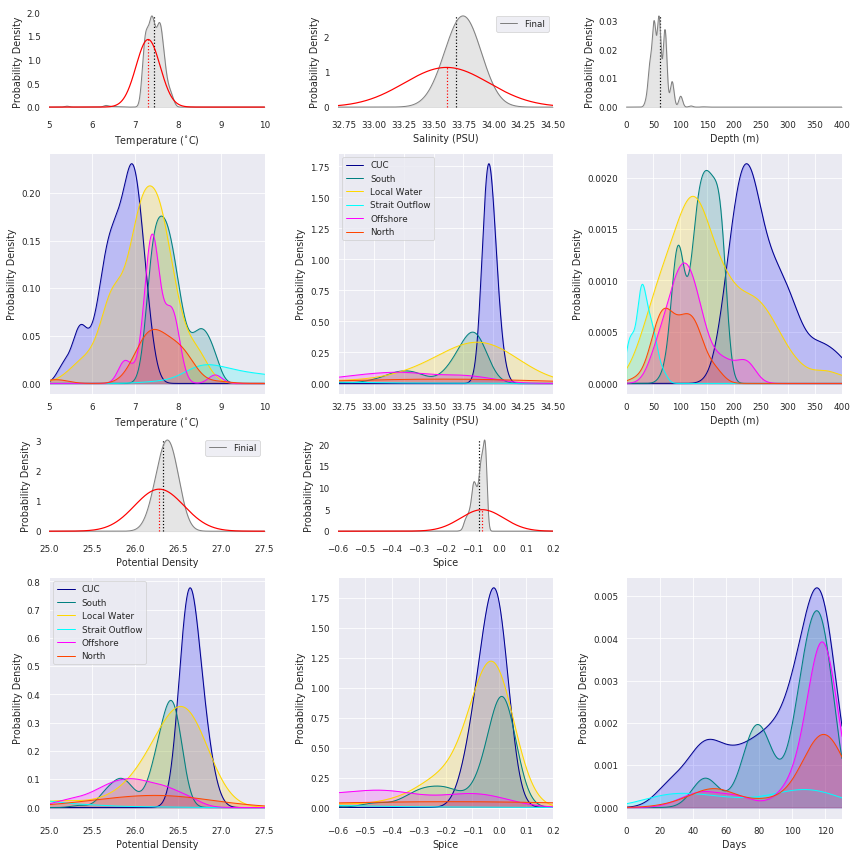

In [159]:
fig = plt.figure(figsize=(12,12))

# fig = plt.figure(figsize=(13,8))

gs2 = gridspec.GridSpec(6, 3)
# gs2.update(left=0.55, right=0.98, hspace=0.05)

# gs2.update(wspace=0.025, hspace=0.05)


ax1 = plt.subplot(gs2[1:3, 0])
ax1_marg = plt.subplot(gs2[0, 0], sharex=ax1, frameon = False)

ax2 = plt.subplot(gs2[4:, 0])
ax2_marg = plt.subplot(gs2[3, 0], sharex=ax2, frameon = False)



ax3 = plt.subplot(gs2[1:3, 1])
ax3_marg = plt.subplot(gs2[0, 1], sharex=ax3, frameon = False)

ax4 = plt.subplot(gs2[4:, 1])
ax4_marg = plt.subplot(gs2[3, 1], sharex=ax4, frameon = False)


ax5 = plt.subplot(gs2[1:3, 2])
ax5_marg = plt.subplot(gs2[0, 2], sharex=ax5, frameon = False)

ax6 = plt.subplot(gs2[4:, 2])
# ax6_marg = plt.subplot(gs2[3, 2], sharex=ax6, frameon = False)


#Temperature
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Temperature')


ax1.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax1.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax1.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax1.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax1.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax1.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax1.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax1.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax1.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax1.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax1.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax1.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax1_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Final")
ax1_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax1_marg.vlines(x=np.mean(traj_tem_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

ax1_marg.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax1_marg.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')
# fig.subplots_adjust(hspace=0)

ax1.set_xlim(5,10)
ax1.set_xlabel('Temperature ($^{\circ}$C)')
ax1.set_ylabel('Probability Density')
# ax1.legend(loc= 'best')

ax1_marg.set_xlim(5,10)
ax1_marg.set_xlabel('Temperature ($^{\circ}$C)')
ax1_marg.set_ylabel('Probability Density')
# ax1_marg.legend(loc= 'best')
# ax1.get_legend().remove()
ax1.grid()


#Salinity
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Salinity')


ax3.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax3.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax3.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax3.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax3.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax3.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax3.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax3.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax3.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax3.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax3.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax3.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax3_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Final")
ax3_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax3_marg.vlines(x=np.mean(traj_sal_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

ax3_marg.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax3_marg.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')
# fig.subplots_adjust(hspace=0)

ax3.set_xlim(32.7,34.5)
ax3.set_xlabel('Salinity (PSU)')
ax3.set_ylabel('Probability Density')
# ax3.get_legend().remove()

ax3_marg.set_xlim(32.7,34.5)
ax3_marg.set_xlabel('Salinity (PSU)')
ax3_marg.set_ylabel('Probability Density')
# ax3_marg.get_legend().remove()
ax3.grid()


#Density
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Density')


ax2.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax2.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax2.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax2.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax2.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax2.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax2.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax2.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax2.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax2.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax2.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax2.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax2_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Finial")
ax2_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax2_marg.vlines(x=np.mean(traj_rho_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

ax2_marg.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax2_marg.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')
# fig.subplots_adjust(hspace=0)

ax2.set_xlim(25,27.5)
ax2.set_xlabel('Potential Density')
ax2.set_ylabel('Probability Density')
# ax3.get_legend().remove()

ax2_marg.set_xlim(25,27.5)
ax2_marg.set_xlabel('Potential Density')
ax2_marg.set_ylabel('Probability Density')
# ax3_marg.get_legend().remove()
ax2.grid()

#Spice
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Spice')


ax4.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax4.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax4.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax4.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax4.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax4.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax4.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax4.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax4.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax4.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax4.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax4.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax4_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Final")
ax4_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax4_marg.vlines(x=np.mean(spic_loc_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

ax4_marg.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax4_marg.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')
# fig.subplots_adjust(hspace=0)

ax4.set_xlim(-0.6,0.2)
ax4.set_xlabel('Spice')
ax4.set_ylabel('Probability Density')
# ax3.get_legend().remove()

ax4_marg.set_xlim(-0.6,0.2)
ax4_marg.set_xlabel('Spice')
ax4_marg.set_ylabel('Probability Density')
# ax3_marg.get_legend().remove()
ax4.grid()



#Depth
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid = calculate_kde(variable='Depth')


ax5.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax5.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax5.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax5.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax5.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax5.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax5.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax5.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax5.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax5.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax5.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax5.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax5_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Final")
ax5_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax5_marg.vlines(x=np.mean(-traj_depth_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')


ax5.set_xlim(0,400)
ax5.set_xlabel('Depth (m)')
ax5.set_ylabel('Probability Density')
# ax3.get_legend().remove()

ax5_marg.set_xlim(0,400)
ax5_marg.set_xlabel('Depth (m)')
ax5_marg.set_ylabel('Probability Density')
# ax3_marg.get_legend().remove()
ax5.grid()

#Days
w_cuc, w_south,  w_north, w_juan, w_off,  grid = calculate_kde(variable='Days')


ax6.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax6.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax6.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax6.fill_between(grid, w_south, color = 'teal',alpha = 0.2)


ax6.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax6.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax6.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax6.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax6.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax6.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)




ax6.set_xlim(0,130)
ax6.set_xlabel('Days')
ax6.set_ylabel('Probability Density')
# ax6.legend(loc = 'best')
# ax3.get_legend().remove()

# ax3_marg.get_legend().remove()
ax6.grid()



ax2.legend(loc = 'best')
ax2_marg.legend(loc = 'best')

ax3.legend(loc = 'best')
ax3_marg.legend(loc = 'best')



gs2.tight_layout(fig=fig,rect=[0, 0, 1, 1], h_pad=0.1)



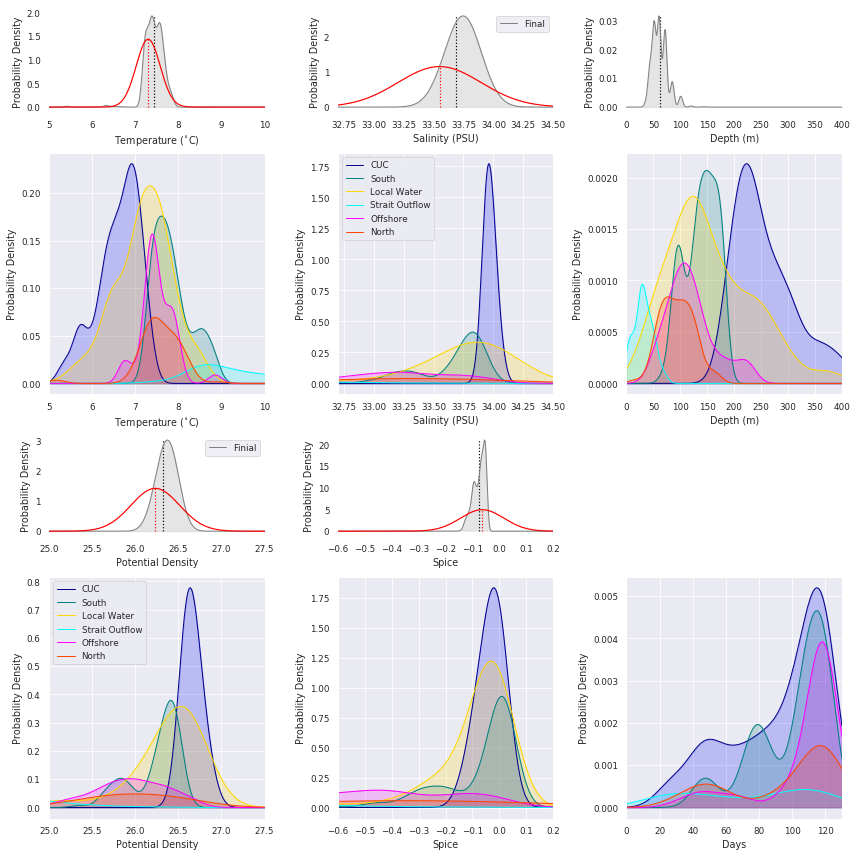

In [22]:
fig = plt.figure(figsize=(12,12))

# fig = plt.figure(figsize=(13,8))

gs2 = gridspec.GridSpec(6, 3)
# gs2.update(left=0.55, right=0.98, hspace=0.05)

# gs2.update(wspace=0.025, hspace=0.05)


ax1 = plt.subplot(gs2[1:3, 0])
ax1_marg = plt.subplot(gs2[0, 0], sharex=ax1, frameon = False)

ax2 = plt.subplot(gs2[4:, 0])
ax2_marg = plt.subplot(gs2[3, 0], sharex=ax2, frameon = False)



ax3 = plt.subplot(gs2[1:3, 1])
ax3_marg = plt.subplot(gs2[0, 1], sharex=ax3, frameon = False)

ax4 = plt.subplot(gs2[4:, 1])
ax4_marg = plt.subplot(gs2[3, 1], sharex=ax4, frameon = False)


ax5 = plt.subplot(gs2[1:3, 2])
ax5_marg = plt.subplot(gs2[0, 2], sharex=ax5, frameon = False)

ax6 = plt.subplot(gs2[4:, 2])
# ax6_marg = plt.subplot(gs2[3, 2], sharex=ax6, frameon = False)


#Temperature
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Temperature')


ax1.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax1.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax1.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax1.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax1.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax1.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax1.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax1.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax1.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax1.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax1.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax1.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax1_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Final")
ax1_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax1_marg.vlines(x=np.mean(traj_tem_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

ax1_marg.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax1_marg.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')
# fig.subplots_adjust(hspace=0)

ax1.set_xlim(5,10)
ax1.set_xlabel('Temperature ($^{\circ}$C)')
ax1.set_ylabel('Probability Density')
# ax1.legend(loc= 'best')

ax1_marg.set_xlim(5,10)
ax1_marg.set_xlabel('Temperature ($^{\circ}$C)')
ax1_marg.set_ylabel('Probability Density')
# ax1_marg.legend(loc= 'best')
# ax1.get_legend().remove()
ax1.grid()


#Salinity
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Salinity')


ax3.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax3.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax3.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax3.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax3.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax3.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax3.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax3.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax3.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax3.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax3.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax3.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax3_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Final")
ax3_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax3_marg.vlines(x=np.mean(traj_sal_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

ax3_marg.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax3_marg.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')
# fig.subplots_adjust(hspace=0)

ax3.set_xlim(32.7,34.5)
ax3.set_xlabel('Salinity (PSU)')
ax3.set_ylabel('Probability Density')
# ax3.get_legend().remove()

ax3_marg.set_xlim(32.7,34.5)
ax3_marg.set_xlabel('Salinity (PSU)')
ax3_marg.set_ylabel('Probability Density')
# ax3_marg.get_legend().remove()
ax3.grid()


#Density
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Density')


ax2.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax2.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax2.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax2.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax2.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax2.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax2.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax2.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax2.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax2.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax2.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax2.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax2_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Finial")
ax2_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax2_marg.vlines(x=np.mean(traj_rho_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

ax2_marg.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax2_marg.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')
# fig.subplots_adjust(hspace=0)

ax2.set_xlim(25,27.5)
ax2.set_xlabel('Potential Density')
ax2.set_ylabel('Probability Density')
# ax3.get_legend().remove()

ax2_marg.set_xlim(25,27.5)
ax2_marg.set_xlabel('Potential Density')
ax2_marg.set_ylabel('Probability Density')
# ax3_marg.get_legend().remove()
ax2.grid()

#Spice
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Spice')


ax4.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax4.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax4.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax4.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax4.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax4.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax4.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax4.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax4.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax4.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax4.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax4.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax4_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Final")
ax4_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax4_marg.vlines(x=np.mean(spic_loc_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

ax4_marg.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax4_marg.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')
# fig.subplots_adjust(hspace=0)

ax4.set_xlim(-0.6,0.2)
ax4.set_xlabel('Spice')
ax4.set_ylabel('Probability Density')
# ax3.get_legend().remove()

ax4_marg.set_xlim(-0.6,0.2)
ax4_marg.set_xlabel('Spice')
ax4_marg.set_ylabel('Probability Density')
# ax3_marg.get_legend().remove()
ax4.grid()



#Depth
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid = calculate_kde(variable='Depth')


ax5.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax5.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax5.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax5.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax5.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax5.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax5.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax5.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax5.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax5.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax5.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax5.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax5_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Final")
ax5_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax5_marg.vlines(x=np.mean(-traj_depth_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')


ax5.set_xlim(0,400)
ax5.set_xlabel('Depth (m)')
ax5.set_ylabel('Probability Density')
# ax3.get_legend().remove()

ax5_marg.set_xlim(0,400)
ax5_marg.set_xlabel('Depth (m)')
ax5_marg.set_ylabel('Probability Density')
# ax3_marg.get_legend().remove()
ax5.grid()

#Days
w_cuc, w_south,  w_north, w_juan, w_off,  grid = calculate_kde(variable='Days')


ax6.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax6.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax6.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax6.fill_between(grid, w_south, color = 'teal',alpha = 0.2)


ax6.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax6.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax6.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax6.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax6.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax6.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)




ax6.set_xlim(0,130)
ax6.set_xlabel('Days')
ax6.set_ylabel('Probability Density')
# ax6.legend(loc = 'best')
# ax3.get_legend().remove()

# ax3_marg.get_legend().remove()
ax6.grid()



ax2.legend(loc = 'best')
ax2_marg.legend(loc = 'best')

ax3.legend(loc = 'best')
ax3_marg.legend(loc = 'best')



gs2.tight_layout(fig=fig,rect=[0, 0, 1, 1], h_pad=0.1)



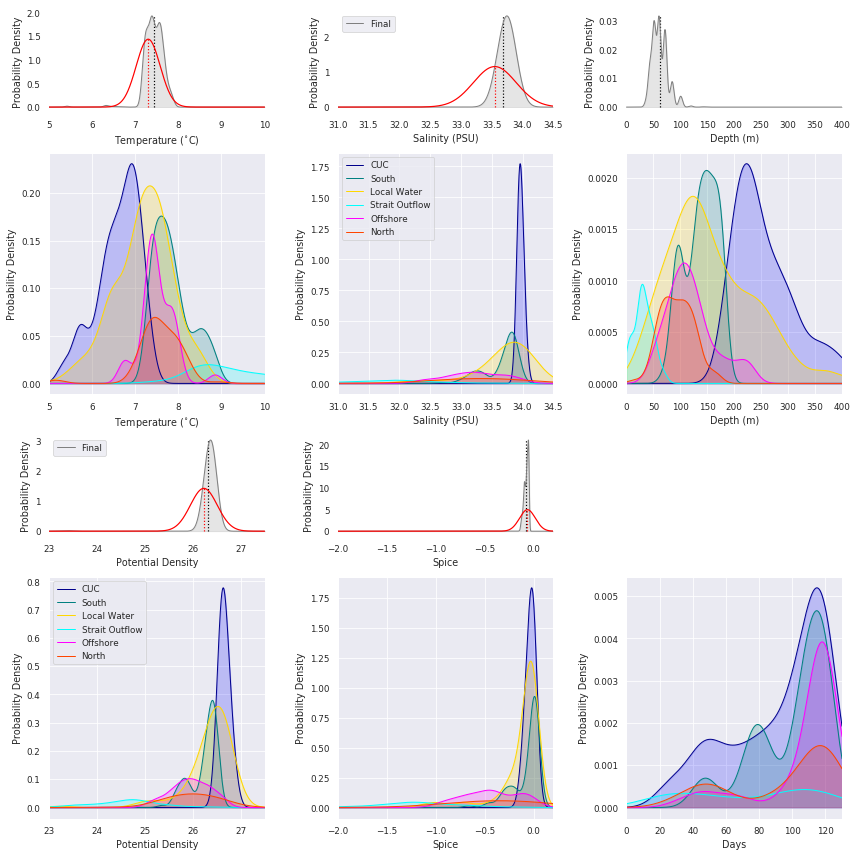

In [23]:
fig = plt.figure(figsize=(12,12))

# fig = plt.figure(figsize=(13,8))

gs2 = gridspec.GridSpec(6, 3)
# gs2.update(left=0.55, right=0.98, hspace=0.05)

# gs2.update(wspace=0.025, hspace=0.05)


ax1 = plt.subplot(gs2[1:3, 0])
ax1_marg = plt.subplot(gs2[0, 0], sharex=ax1, frameon = False)

ax2 = plt.subplot(gs2[4:, 0])
ax2_marg = plt.subplot(gs2[3, 0], sharex=ax2, frameon = False)



ax3 = plt.subplot(gs2[1:3, 1])
ax3_marg = plt.subplot(gs2[0, 1], sharex=ax3, frameon = False)

ax4 = plt.subplot(gs2[4:, 1])
ax4_marg = plt.subplot(gs2[3, 1], sharex=ax4, frameon = False)


ax5 = plt.subplot(gs2[1:3, 2])
ax5_marg = plt.subplot(gs2[0, 2], sharex=ax5, frameon = False)

ax6 = plt.subplot(gs2[4:, 2])
# ax6_marg = plt.subplot(gs2[3, 2], sharex=ax6, frameon = False)


#Temperature
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Temperature')


ax1.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax1.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax1.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax1.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax1.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax1.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax1.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax1.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax1.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax1.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax1.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax1.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax1_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Final")
ax1_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax1_marg.vlines(x=np.mean(traj_tem_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

ax1_marg.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax1_marg.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')
# fig.subplots_adjust(hspace=0)

ax1.set_xlim(5,10)
ax1.set_xlabel('Temperature ($^{\circ}$C)')
ax1.set_ylabel('Probability Density')
# ax1.legend(loc= 'best')

ax1_marg.set_xlim(5,10)
ax1_marg.set_xlabel('Temperature ($^{\circ}$C)')
ax1_marg.set_ylabel('Probability Density')
# ax1_marg.legend(loc= 'best')
# ax1.get_legend().remove()
ax1.grid()


#Salinity
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Salinity')


ax3.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax3.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax3.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax3.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax3.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax3.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax3.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax3.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax3.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax3.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax3.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax3.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax3_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Final")
ax3_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax3_marg.vlines(x=np.mean(traj_sal_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

ax3_marg.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax3_marg.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')
# fig.subplots_adjust(hspace=0)

ax3.set_xlim(31,34.5)
ax3.set_xlabel('Salinity (PSU)')
ax3.set_ylabel('Probability Density')
# ax3.get_legend().remove()

ax3_marg.set_xlim(31,34.5)
ax3_marg.set_xlabel('Salinity (PSU)')
ax3_marg.set_ylabel('Probability Density')
# ax3_marg.get_legend().remove()
ax3.grid()


#Density
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Density')


ax2.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax2.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax2.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax2.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax2.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax2.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax2.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax2.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax2.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax2.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax2.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax2.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax2_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Final")
ax2_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax2_marg.vlines(x=np.mean(traj_rho_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

ax2_marg.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax2_marg.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')
# fig.subplots_adjust(hspace=0)

ax2.set_xlim(23,27.5)
ax2.set_xlabel('Potential Density')
ax2.set_ylabel('Probability Density')
# ax3.get_legend().remove()

ax2_marg.set_xlim(23,27.5)
ax2_marg.set_xlabel('Potential Density')
ax2_marg.set_ylabel('Probability Density')
# ax3_marg.get_legend().remove()
ax2.grid()

#Spice
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Spice')


ax4.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax4.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax4.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax4.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax4.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax4.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax4.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax4.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax4.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax4.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax4.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax4.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax4_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Final")
ax4_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax4_marg.vlines(x=np.mean(spic_loc_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

ax4_marg.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax4_marg.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')
# fig.subplots_adjust(hspace=0)

ax4.set_xlim(-2,0.2)
ax4.set_xlabel('Spice')
ax4.set_ylabel('Probability Density')
# ax3.get_legend().remove()

ax4_marg.set_xlim(-2,0.2)
ax4_marg.set_xlabel('Spice')
ax4_marg.set_ylabel('Probability Density')
# ax3_marg.get_legend().remove()
ax4.grid()



#Depth
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid = calculate_kde(variable='Depth')


ax5.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax5.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax5.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax5.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax5.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax5.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax5.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax5.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax5.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax5.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax5.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax5.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax5_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Final")
ax5_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax5_marg.vlines(x=np.mean(-traj_depth_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')


ax5.set_xlim(0,400)
ax5.set_xlabel('Depth (m)')
ax5.set_ylabel('Probability Density')
# ax3.get_legend().remove()

ax5_marg.set_xlim(0,400)
ax5_marg.set_xlabel('Depth (m)')
ax5_marg.set_ylabel('Probability Density')
# ax3_marg.get_legend().remove()
ax5.grid()

#Days
w_cuc, w_south,  w_north, w_juan, w_off,  grid = calculate_kde(variable='Days')


ax6.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax6.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax6.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax6.fill_between(grid, w_south, color = 'teal',alpha = 0.2)


ax6.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax6.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax6.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax6.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax6.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax6.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)




ax6.set_xlim(0,130)
ax6.set_xlabel('Days')
ax6.set_ylabel('Probability Density')
# ax6.legend(loc = 'best')
# ax3.get_legend().remove()

# ax3_marg.get_legend().remove()
ax6.grid()



ax2.legend(loc = 'best')
ax2_marg.legend(loc = 'best')

ax3.legend(loc = 'best')
ax3_marg.legend(loc = 'best')



gs2.tight_layout(fig=fig,rect=[0, 0, 1, 1], h_pad=0.1)



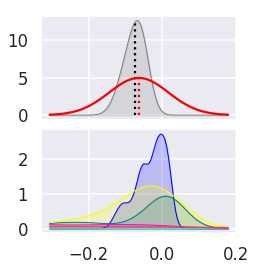

In [286]:

# fig, ax = plt.subplots()
fig = plt.figure()

gs = GridSpec(4,5)

ax = fig.add_subplot(gs[2:4,0:3])
ax_marg_x = fig.add_subplot(gs[0:2,0:3])
# ax_marg_y = fig.add_subplot(gs[1:4,3])



# Turn off tick labels on marginals
plt.setp(ax_marg_x.get_xticklabels(), visible=False)
# plt.setp(ax_marg_y.get_yticklabels(), visible=False)

ax.plot(grid, w_cuc, lw=1, color = 'blue', label = "weighted cuc")
ax.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax.plot(grid, w_south, lw=1, color = 'teal', label = "weighted south")
ax.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax.plot(grid, w_local, lw=1, color = 'yellow', label = "weighted local")
ax.fill_between(grid, w_local, color = 'yellow', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax.plot(grid, w_juan, lw=1, color = 'cyan', label = "weighted juan")
ax.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax.plot(grid, w_off, lw=1, color = 'magenta', label = "weighted off")
ax.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax.plot(grid, w_north, lw=1, color = 'orangered', label = "weighted north")
ax.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax_marg_x.plot(grid, w_init, lw=1, color = 'gray', label = "weighted init")
ax_marg_x.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax_marg_x.vlines(x=np.mean(spic_loc_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

# ax_marg_x.plot(grid, w_combined, lw=1, color = 'red', label = "weighted combo")
# ax_marg_x.fill_between(grid, w_combined, color = 'red', alpha= 0.2)


# x = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)


ax_marg_x.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax_marg_x.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')

# ax_marg_x.plot(grid, scipy.stats.norm.pdf(grid, np.mean(traj_sal_init), np.std(traj_sal_init)/2), 'k')
# ax_marg_x.vlines(x=np.mean(traj_sal_init), color = 'k', ymax=np.max(scipy.stats.norm.pdf(grid, np.mean(traj_sal_init), np.std(traj_sal_init)/2)), \
#                  ymin= 0, linestyles='dotted')

# ax_marg_x.vlines(x=np.mean(traj_sal_init), color = 'gray',  ymax=np.max(w_init), ymin = 0, linestyles='dotted')




# ax.plot(grid, kde_combo(grid), color="crimson", lw=2, label = "pdf")

# plt.legend()
plt.show()

fig.tight_layout()



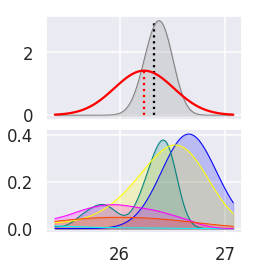

In [289]:

# fig, ax = plt.subplots()
fig = plt.figure()

gs = GridSpec(4,5)

ax = fig.add_subplot(gs[2:4,0:3])
ax_marg_x = fig.add_subplot(gs[0:2,0:3])
# ax_marg_y = fig.add_subplot(gs[1:4,3])



# Turn off tick labels on marginals
plt.setp(ax_marg_x.get_xticklabels(), visible=False)
# plt.setp(ax_marg_y.get_yticklabels(), visible=False)

ax.plot(grid, w_cuc, lw=1, color = 'blue', label = "weighted cuc")
ax.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax.plot(grid, w_south, lw=1, color = 'teal', label = "weighted south")
ax.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax.plot(grid, w_local, lw=1, color = 'yellow', label = "weighted local")
ax.fill_between(grid, w_local, color = 'yellow', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax.plot(grid, w_juan, lw=1, color = 'cyan', label = "weighted juan")
ax.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax.plot(grid, w_off, lw=1, color = 'magenta', label = "weighted off")
ax.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax.plot(grid, w_north, lw=1, color = 'orangered', label = "weighted north")
ax.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax_marg_x.plot(grid, w_init, lw=1, color = 'gray', label = "weighted init")
ax_marg_x.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax_marg_x.vlines(x=np.mean(traj_rho_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

# ax_marg_x.plot(grid, w_combined, lw=1, color = 'red', label = "weighted combo")
# ax_marg_x.fill_between(grid, w_combined, color = 'red', alpha= 0.2)


# x = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)


ax_marg_x.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax_marg_x.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')

# ax_marg_x.plot(grid, scipy.stats.norm.pdf(grid, np.mean(traj_sal_init), np.std(traj_sal_init)/2), 'k')
# ax_marg_x.vlines(x=np.mean(traj_sal_init), color = 'k', ymax=np.max(scipy.stats.norm.pdf(grid, np.mean(traj_sal_init), np.std(traj_sal_init)/2)), \
#                  ymin= 0, linestyles='dotted')

# ax_marg_x.vlines(x=np.mean(traj_sal_init), color = 'gray',  ymax=np.max(w_init), ymin = 0, linestyles='dotted')




# ax.plot(grid, kde_combo(grid), color="crimson", lw=2, label = "pdf")

# plt.legend()
plt.show()

fig.tight_layout()



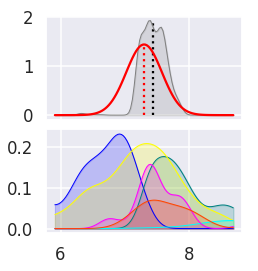

In [296]:

# fig, ax = plt.subplots()
fig = plt.figure()

gs = GridSpec(4,5)

ax = fig.add_subplot(gs[2:4,0:3])
ax_marg_x = fig.add_subplot(gs[0:2,0:3])
# ax_marg_y = fig.add_subplot(gs[1:4,3])



# Turn off tick labels on marginals
plt.setp(ax_marg_x.get_xticklabels(), visible=False)
# plt.setp(ax_marg_y.get_yticklabels(), visible=False)

ax.plot(grid, w_cuc, lw=1, color = 'blue', label = "weighted cuc")
ax.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax.plot(grid, w_south, lw=1, color = 'teal', label = "weighted south")
ax.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax.plot(grid, w_local, lw=1, color = 'yellow', label = "weighted local")
ax.fill_between(grid, w_local, color = 'yellow', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax.plot(grid, w_juan, lw=1, color = 'cyan', label = "weighted juan")
ax.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax.plot(grid, w_off, lw=1, color = 'magenta', label = "weighted off")
ax.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax.plot(grid, w_north, lw=1, color = 'orangered', label = "weighted north")
ax.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax_marg_x.plot(grid, w_init, lw=1, color = 'gray', label = "weighted init")
ax_marg_x.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax_marg_x.vlines(x=np.mean(traj_tem_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

# ax_marg_x.plot(grid, w_combined, lw=1, color = 'red', label = "weighted combo")
# ax_marg_x.fill_between(grid, w_combined, color = 'red', alpha= 0.2)


# x = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)


ax_marg_x.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax_marg_x.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')

# ax_marg_x.plot(grid, scipy.stats.norm.pdf(grid, np.mean(traj_sal_init), np.std(traj_sal_init)/2), 'k')
# ax_marg_x.vlines(x=np.mean(traj_sal_init), color = 'k', ymax=np.max(scipy.stats.norm.pdf(grid, np.mean(traj_sal_init), np.std(traj_sal_init)/2)), \
#                  ymin= 0, linestyles='dotted')

# ax_marg_x.vlines(x=np.mean(traj_sal_init), color = 'gray',  ymax=np.max(w_init), ymin = 0, linestyles='dotted')




# ax.plot(grid, kde_combo(grid), color="crimson", lw=2, label = "pdf")

# plt.legend()
plt.show()

fig.tight_layout()



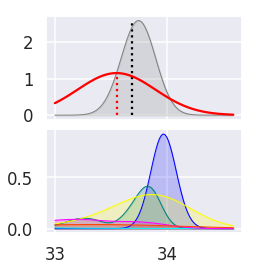

In [266]:

# fig, ax = plt.subplots()
fig = plt.figure()

gs = GridSpec(4,5)

ax = fig.add_subplot(gs[2:4,0:3])
ax_marg_x = fig.add_subplot(gs[0:2,0:3])
# ax_marg_y = fig.add_subplot(gs[1:4,3])



# Turn off tick labels on marginals
plt.setp(ax_marg_x.get_xticklabels(), visible=False)
# plt.setp(ax_marg_y.get_yticklabels(), visible=False)

ax.plot(grid, w_cuc, lw=1, color = 'blue', label = "weighted cuc")
ax.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax.plot(grid, w_south, lw=1, color = 'teal', label = "weighted south")
ax.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax.plot(grid, w_local, lw=1, color = 'yellow', label = "weighted local")
ax.fill_between(grid, w_local, color = 'yellow', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax.plot(grid, w_juan, lw=1, color = 'cyan', label = "weighted juan")
ax.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax.plot(grid, w_off, lw=1, color = 'magenta', label = "weighted off")
ax.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax.plot(grid, w_north, lw=1, color = 'orangered', label = "weighted north")
ax.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax_marg_x.plot(grid, w_init, lw=1, color = 'gray', label = "weighted init")
ax_marg_x.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax_marg_x.vlines(x=np.mean(traj_sal_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

# ax_marg_x.plot(grid, w_combined, lw=1, color = 'red', label = "weighted combo")
# ax_marg_x.fill_between(grid, w_combined, color = 'red', alpha= 0.2)


# x = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)


ax_marg_x.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax_marg_x.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')

# ax_marg_x.plot(grid, scipy.stats.norm.pdf(grid, np.mean(traj_sal_init), np.std(traj_sal_init)/2), 'k')
# ax_marg_x.vlines(x=np.mean(traj_sal_init), color = 'k', ymax=np.max(scipy.stats.norm.pdf(grid, np.mean(traj_sal_init), np.std(traj_sal_init)/2)), \
#                  ymin= 0, linestyles='dotted')

# ax_marg_x.vlines(x=np.mean(traj_sal_init), color = 'gray',  ymax=np.max(w_init), ymin = 0, linestyles='dotted')




# ax.plot(grid, kde_combo(grid), color="crimson", lw=2, label = "pdf")

# plt.legend()
plt.show()

fig.tight_layout()



In [14]:
sns.set_context('poster')
sns.set_style('dark')

In [18]:
from matplotlib.gridspec import GridSpec

-0.0639782647834
0.0804868819745
-0.0750174962786


In [62]:
(ind_local.shape[0]/final_z.shape[0])

0.32983377077865267

In [32]:
spic_juan

-1.1468590753263104

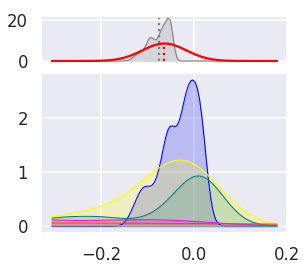

In [115]:
import matplotlib.pyplot as plt
import scipy.stats


mu = spic_mixed
sigma = err_mixing_spic


# a = np.random.gumbel(80, 25, 1000).astype(int)
# b = np.random.gumbel(200, 46, 4000).astype(int)

kde_cuc = scipy.stats.gaussian_kde(spic_loc_cuc)
kde_south = scipy.stats.gaussian_kde(spic_loc_south)
kde_local = scipy.stats.gaussian_kde(spic_loc_local)
kde_juan  = scipy.stats.gaussian_kde(spic_loc_juan)
kde_north = scipy.stats.gaussian_kde(spic_loc_north)
kde_off = scipy.stats.gaussian_kde(spic_loc_off)
 
kde_init  = scipy.stats.gaussian_kde(spic_loc_init)



# combo = np.hstack((spic_loc_cuc,spic_loc_south,spic_loc_local))
# kde_combo = scipy.stats.gaussian_kde(combo)
grid = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)#np.linspace(-0.2,0.1,5000)

#weighted kde curves
w_cuc   = kde_cuc(grid)*(cuc_percent/100)
w_south = kde_south(grid)*(south_percent/100)
w_local = kde_local(grid)*(0.33)#*(ind_local.shape[0]/final_z.shape[0])
w_north = kde_north(grid)*(north_percent/100)
w_juan = kde_juan(grid)*(juan_percent/100)
w_off = kde_off(grid)*(off_percent/100)

w_init = kde_init(grid)

# w_combined = (w_cuc + w_south + w_north + w_juan + w_off + w_local)
w_combined = (w_cuc + w_south  + w_local)



# fig, ax = plt.subplots()
fig = plt.figure()

gs = GridSpec(4,4)

ax = fig.add_subplot(gs[1:4,0:3])
ax_marg_x = fig.add_subplot(gs[0,0:3])
# ax_marg_y = fig.add_subplot(gs[1:4,3])



# Turn off tick labels on marginals
plt.setp(ax_marg_x.get_xticklabels(), visible=False)
# plt.setp(ax_marg_y.get_yticklabels(), visible=False)

ax.plot(grid, w_cuc, lw=1, color = 'blue', label = "weighted cuc")
ax.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax.plot(grid, w_south, lw=1, color = 'teal', label = "weighted south")
ax.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax.plot(grid, w_local, lw=1, color = 'yellow', label = "weighted local")
ax.fill_between(grid, w_local, color = 'yellow', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax.plot(grid, w_juan, lw=1, color = 'cyan', label = "weighted juan")
ax.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax.plot(grid, w_off, lw=1, color = 'magenta', label = "weighted off")
ax.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax.plot(grid, w_north, lw=1, color = 'orangered', label = "weighted north")
ax.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax_marg_x.plot(grid, w_init, lw=1, color = 'gray', label = "weighted init")
ax_marg_x.fill_between(grid, w_init, color = 'gray', alpha= 0.2)


# x = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)
ax_marg_x.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma/1.7), 'red')

ax_marg_x.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma/1.7)), ymin= 0, linestyles='dotted')
ax_marg_x.vlines(x=np.mean(spic_loc_init), color = 'gray',  ymax=np.max(w_init), ymin = 0, linestyles='dotted')

# ax_marg_x.plot(x, scipy.stats.norm.pdf(x, np.mean(spic_loc_init), np.std(spic_loc_init)), 'k')

# ax_marg_x.plot(grid, w_combined, lw=1, color = 'red', label = "weighted combo")
# ax_marg_x.fill_between(grid, w_combined, color = 'red', alpha= 0.2)

# ax.plot(grid, kde_combo(grid), color="crimson", lw=2, label = "pdf")

# plt.legend()
plt.show()

fig.tight_layout()



In [91]:
w_cuc.shape

(5000,)

In [106]:

from sklearn.neighbors import KernelDensity
from sklearn.grid_search import GridSearchCV
grid = GridSearchCV(KernelDensity(),
                    {'bandwidth': np.linspace(0.1, 1.0, 30)},
                    cv=20) # 20-fold cross-validation
grid.fit(spic_loc_init[:, None])
print(grid.best_params_)



{'bandwidth': 0.10000000000000001}


In [107]:

from sklearn.neighbors import KernelDensity
from sklearn.grid_search import GridSearchCV
grid = GridSearchCV(KernelDensity(),
                    {'bandwidth': np.linspace(0.1, 1.0, 30)},
                    cv=20) # 20-fold cross-validation
grid.fit(spic_loc_cuc[:, None])
print(grid.best_params_)



{'bandwidth': 0.10000000000000001}


In [111]:

from sklearn.neighbors import KernelDensity
from sklearn.grid_search import GridSearchCV
grid = GridSearchCV(KernelDensity(),
                    {'bandwidth': np.linspace(0.1, 1.0, 30)},
                    cv=20) # 20-fold cross-validation
grid.fit(spic_loc_local[:, None])
print(grid.best_params_)



{'bandwidth': 0.10000000000000001}


In [85]:
np.max(spic_loc_cuc)

0.02402740204688314

In [67]:
### Temperature uncertainty propagation

T_cuc   = np.mean(traj_tem_final_cuc)
T_south = np.mean(traj_tem_final_south)
T_off   = np.mean(traj_tem_final_off)
T_north = np.mean(traj_tem_final_north)
T_juan  = np.mean(traj_tem_final_juan)
T_local = np.mean(traj_tem_final_local)

T_cuc_std   = np.std(traj_tem_final_cuc)
T_south_std = np.std(traj_tem_final_south)
T_off_std   = np.std(traj_tem_final_off)
T_north_std = np.std(traj_tem_final_north)
T_juan_std  = np.std(traj_tem_final_juan)
T_local_std = np.std(traj_tem_final_local)

frac_cuc   = cuc_percent_low/100
frac_south = south_percent_low/100
frac_off   = off_percent_low/100
frac_north = north_percent_low/100
frac_juan = juan_percent_low/100
frac_local = local_percent/100

T_mixed = T_cuc*frac_cuc + T_south*frac_south + T_off*frac_off + T_juan*frac_juan + T_north*frac_north + \
     T_local*frac_local
print(T_mixed)

err_mixing_T = np.sqrt((T_cuc_std*frac_cuc)**2 + (T_south_std*frac_south)**2 + (T_off_std*frac_off)**2 + (T_juan_std*frac_juan)**2 + \
              (T_north_std*frac_north)**2 + (T_local_std*frac_local)**2)

print(err_mixing_T)

print(np.mean(traj_tem_init))

print(np.std(traj_tem_init))


print(err_mixing_T/np.mean(traj_tem_init)*100)

print(err_mixing_T/np.std(traj_tem_init)*100)

print("The error in mixing is 3.7 percent of the mean")


print("The error in mixing is 125 percent of the std")


NameError: name 'local_percent' is not defined

In [51]:
from sklearn.grid_search import GridSearchCV
from sklearn.cross_validation import LeaveOneOut
from sklearn.neighbors import KernelDensity

bandwidths = np.linspace(-1, 1, 100)
grid_1 = GridSearchCV(KernelDensity(kernel='gaussian'),
                    {'bandwidth': bandwidths},
                    cv=LeaveOneOut(len(spic_loc_init)))
grid_1.fit(spic_loc_init[:, None]);

In [52]:
grid_1.best_params_

{'bandwidth': -1.0}

In [98]:
spic_loc_local = spic_loc_local[spic_loc_local>-2]

spic_loc_init = spic_loc_init[spic_loc_init>-2]

In [54]:
np.mean(spic_loc_init)

-0.099918800371237348

In [55]:
spic_loc_init

masked_array(data = [-0.10872896198911519 -0.10872896198911519 -0.10480325383969102 ...,
 -0.07571061038785842 -0.0630006809691821 -0.05337508881359554],
             mask = [False False False ..., False False False],
       fill_value = 1e+20)

In [17]:
combo

array([<scipy.stats.kde.gaussian_kde object at 0x7fa1981b66a0>,
       <scipy.stats.kde.gaussian_kde object at 0x7fa22e7e9860>], dtype=object)

In [42]:
import numpy as np
from scipy.spatial.distance import cdist

class gaussian_kde(object):
    """Representation of a kernel-density estimate using Gaussian kernels.

    Kernel density estimation is a way to estimate the probability density
    function (PDF) of a random variable in a non-parametric way.
    `gaussian_kde` works for both uni-variate and multi-variate data.   It
    includes automatic bandwidth determination.  The estimation works best for
    a unimodal distribution; bimodal or multi-modal distributions tend to be
    oversmoothed.

    Parameters
    ----------
    dataset : array_like
        Datapoints to estimate from. In case of univariate data this is a 1-D
        array, otherwise a 2-D array with shape (# of dims, # of data).
    bw_method : str, scalar or callable, optional
        The method used to calculate the estimator bandwidth.  This can be
        'scott', 'silverman', a scalar constant or a callable.  If a scalar,
        this will be used directly as `kde.factor`.  If a callable, it should
        take a `gaussian_kde` instance as only parameter and return a scalar.
        If None (default), 'scott' is used.  See Notes for more details.
    weights : array_like, shape (n, ), optional, default: None
        An array of weights, of the same shape as `x`.  Each value in `x`
        only contributes its associated weight towards the bin count
        (instead of 1).

    Attributes
    ----------
    dataset : ndarray
        The dataset with which `gaussian_kde` was initialized.
    d : int
        Number of dimensions.
    n : int
        Number of datapoints.
    neff : float
        Effective sample size using Kish's approximation.
    factor : float
        The bandwidth factor, obtained from `kde.covariance_factor`, with which
        the covariance matrix is multiplied.
    covariance : ndarray
        The covariance matrix of `dataset`, scaled by the calculated bandwidth
        (`kde.factor`).
    inv_cov : ndarray
        The inverse of `covariance`.

    Methods
    -------
    kde.evaluate(points) : ndarray
        Evaluate the estimated pdf on a provided set of points.
    kde(points) : ndarray
        Same as kde.evaluate(points)
    kde.pdf(points) : ndarray
        Alias for ``kde.evaluate(points)``.
    kde.set_bandwidth(bw_method='scott') : None
        Computes the bandwidth, i.e. the coefficient that multiplies the data
        covariance matrix to obtain the kernel covariance matrix.
        .. versionadded:: 0.11.0
    kde.covariance_factor : float
        Computes the coefficient (`kde.factor`) that multiplies the data
        covariance matrix to obtain the kernel covariance matrix.
        The default is `scotts_factor`.  A subclass can overwrite this method
        to provide a different method, or set it through a call to
        `kde.set_bandwidth`.

    Notes
    -----
    Bandwidth selection strongly influences the estimate obtained from the KDE
    (much more so than the actual shape of the kernel).  Bandwidth selection
    can be done by a "rule of thumb", by cross-validation, by "plug-in
    methods" or by other means; see [3]_, [4]_ for reviews.  `gaussian_kde`
    uses a rule of thumb, the default is Scott's Rule.

    Scott's Rule [1]_, implemented as `scotts_factor`, is::

        n**(-1./(d+4)),

    with ``n`` the number of data points and ``d`` the number of dimensions.
    Silverman's Rule [2]_, implemented as `silverman_factor`, is::

        (n * (d + 2) / 4.)**(-1. / (d + 4)).

    Good general descriptions of kernel density estimation can be found in [1]_
    and [2]_, the mathematics for this multi-dimensional implementation can be
    found in [1]_.

    References
    ----------
    .. [1] D.W. Scott, "Multivariate Density Estimation: Theory, Practice, and
           Visualization", John Wiley & Sons, New York, Chicester, 1992.
    .. [2] B.W. Silverman, "Density Estimation for Statistics and Data
           Analysis", Vol. 26, Monographs on Statistics and Applied Probability,
           Chapman and Hall, London, 1986.
    .. [3] B.A. Turlach, "Bandwidth Selection in Kernel Density Estimation: A
           Review", CORE and Institut de Statistique, Vol. 19, pp. 1-33, 1993.
    .. [4] D.M. Bashtannyk and R.J. Hyndman, "Bandwidth selection for kernel
           conditional density estimation", Computational Statistics & Data
           Analysis, Vol. 36, pp. 279-298, 2001.

    Examples
    --------
    Generate some random two-dimensional data:

    >>> from scipy import stats
    >>> def measure(n):
    >>>     "Measurement model, return two coupled measurements."
    >>>     m1 = np.random.normal(size=n)
    >>>     m2 = np.random.normal(scale=0.5, size=n)
    >>>     return m1+m2, m1-m2

    >>> m1, m2 = measure(2000)
    >>> xmin = m1.min()
    >>> xmax = m1.max()
    >>> ymin = m2.min()
    >>> ymax = m2.max()

    Perform a kernel density estimate on the data:

    >>> X, Y = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
    >>> positions = np.vstack([X.ravel(), Y.ravel()])
    >>> values = np.vstack([m1, m2])
    >>> kernel = stats.gaussian_kde(values)
    >>> Z = np.reshape(kernel(positions).T, X.shape)

    Plot the results:

    >>> import matplotlib.pyplot as plt
    >>> fig = plt.figure()
    >>> ax = fig.add_subplot(111)
    >>> ax.imshow(np.rot90(Z), cmap=plt.cm.gist_earth_r,
    ...           extent=[xmin, xmax, ymin, ymax])
    >>> ax.plot(m1, m2, 'k.', markersize=2)
    >>> ax.set_xlim([xmin, xmax])
    >>> ax.set_ylim([ymin, ymax])
    >>> plt.show()

    """
    def __init__(self, dataset, bw_method=None, weights=None):
        self.dataset = np.atleast_2d(dataset)
        if not self.dataset.size > 1:
            raise ValueError("`dataset` input should have multiple elements.")
        self.d, self.n = self.dataset.shape
            
        if weights is not None:
            self.weights = weights / np.sum(weights)
        else:
            self.weights = np.ones(self.n) / self.n
            
        # Compute the effective sample size 
        # http://surveyanalysis.org/wiki/Design_Effects_and_Effective_Sample_Size#Kish.27s_approximate_formula_for_computing_effective_sample_size
        self.neff = 1.0 / np.sum(self.weights ** 2)

        self.set_bandwidth(bw_method=bw_method)

    def evaluate(self, points):
        """Evaluate the estimated pdf on a set of points.

        Parameters
        ----------
        points : (# of dimensions, # of points)-array
            Alternatively, a (# of dimensions,) vector can be passed in and
            treated as a single point.

        Returns
        -------
        values : (# of points,)-array
            The values at each point.

        Raises
        ------
        ValueError : if the dimensionality of the input points is different than
                     the dimensionality of the KDE.

        """
        points = np.atleast_2d(points)

        d, m = points.shape
        if d != self.d:
            if d == 1 and m == self.d:
                # points was passed in as a row vector
                points = np.reshape(points, (self.d, 1))
                m = 1
            else:
                msg = "points have dimension %s, dataset has dimension %s" % (d,
                    self.d)
                raise ValueError(msg)

        # compute the normalised residuals
        chi2 = cdist(points.T, self.dataset.T, 'mahalanobis', VI=self.inv_cov) ** 2
        # compute the pdf
        result = np.sum(np.exp(-.5 * chi2) * self.weights, axis=1) / self._norm_factor

        return result

    __call__ = evaluate

    def scotts_factor(self):
        return np.power(self.neff, -1./(self.d+4))

    def silverman_factor(self):
        return np.power(self.neff*(self.d+2.0)/4.0, -1./(self.d+4))

    #  Default method to calculate bandwidth, can be overwritten by subclass
    covariance_factor = scotts_factor

    def set_bandwidth(self, bw_method=None):
        """Compute the estimator bandwidth with given method.

        The new bandwidth calculated after a call to `set_bandwidth` is used
        for subsequent evaluations of the estimated density.

        Parameters
        ----------
        bw_method : str, scalar or callable, optional
            The method used to calculate the estimator bandwidth.  This can be
            'scott', 'silverman', a scalar constant or a callable.  If a
            scalar, this will be used directly as `kde.factor`.  If a callable,
            it should take a `gaussian_kde` instance as only parameter and
            return a scalar.  If None (default), nothing happens; the current
            `kde.covariance_factor` method is kept.

        Notes
        -----
        .. versionadded:: 0.11

        Examples
        --------
        >>> x1 = np.array([-7, -5, 1, 4, 5.])
        >>> kde = stats.gaussian_kde(x1)
        >>> xs = np.linspace(-10, 10, num=50)
        >>> y1 = kde(xs)
        >>> kde.set_bandwidth(bw_method='silverman')
        >>> y2 = kde(xs)
        >>> kde.set_bandwidth(bw_method=kde.factor / 3.)
        >>> y3 = kde(xs)

        >>> fig = plt.figure()
        >>> ax = fig.add_subplot(111)
        >>> ax.plot(x1, np.ones(x1.shape) / (4. * x1.size), 'bo',
        ...         label='Data points (rescaled)')
        >>> ax.plot(xs, y1, label='Scott (default)')
        >>> ax.plot(xs, y2, label='Silverman')
        >>> ax.plot(xs, y3, label='Const (1/3 * Silverman)')
        >>> ax.legend()
        >>> plt.show()

        """
        if bw_method is None:
            pass
        elif bw_method == 'scott':
            self.covariance_factor = self.scotts_factor
        elif bw_method == 'silverman':
            self.covariance_factor = self.silverman_factor
        elif np.isscalar(bw_method) and not isinstance(bw_method, string_types):
            self._bw_method = 'use constant'
            self.covariance_factor = lambda: bw_method
        elif callable(bw_method):
            self._bw_method = bw_method
            self.covariance_factor = lambda: self._bw_method(self)
        else:
            msg = "`bw_method` should be 'scott', 'silverman', a scalar " \
                  "or a callable."
            raise ValueError(msg)

        self._compute_covariance()

    def _compute_covariance(self):
        """Computes the covariance matrix for each Gaussian kernel using
        covariance_factor().
        """
        self.factor = self.covariance_factor()
        # Cache covariance and inverse covariance of the data
        if not hasattr(self, '_data_inv_cov'):
            # Compute the mean and residuals
            _mean = np.sum(self.weights * self.dataset, axis=1)
            _residual = (self.dataset - _mean[:, None])
            # Compute the biased covariance
            self._data_covariance = np.atleast_2d(np.dot(_residual * self.weights, _residual.T))
            # Correct for bias (http://en.wikipedia.org/wiki/Weighted_arithmetic_mean#Weighted_sample_covariance)
            self._data_covariance /= (1 - np.sum(self.weights ** 2))
            self._data_inv_cov = np.linalg.inv(self._data_covariance)

        self.covariance = self._data_covariance * self.factor**2
        self.inv_cov = self._data_inv_cov / self.factor**2
        self._norm_factor = np.sqrt(np.linalg.det(2*np.pi*self.covariance)) #* self.n

### Tracks for individual particles 

In [13]:
from scipy.interpolate import interpn
from mpl_toolkits.axes_grid1 import make_axes_locatable

In [14]:
def density_scatter( x , y, ax = None, sort = True, bins = 20, **kwargs )   :
    """
    Scatter plot colored by 2d histogram
    """
    if ax is None :
        fig , ax = plt.subplots()
    data , x_e, y_e = np.histogram2d( x, y, bins = bins)
    z = interpn( ( 0.5*(x_e[1:] + x_e[:-1]) , 0.5*(y_e[1:]+y_e[:-1]) ) , data , np.vstack([x,y]).T , method = "splinef2d", bounds_error = False )

    # Sort the points by density, so that the densest points are plotted last
    if sort :
        idx = z.argsort()
        x, y, z = x[idx], y[idx], z[idx]

    ax.scatter(x, y, c=z, **kwargs)
    return ax

In [17]:
y_plot = []
x_plot = []

for part in cuc_ind[:].astype(int):

    for k in np.arange(np.int(final_age_days[part])):
        
        y, x = geo_tools.find_closest_model_point(traj_lon[k,part],traj_lat[k,part],\
                                      lon,lat,grid='NEMO',tols=\
                                      {'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},\
                                       'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})
        y_plot = np.append(arr=y_plot, values=y)
        x_plot = np.append(arr=x_plot, values=x)


bathy = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/Bathymetry_EastCoast_NEMO_R036_GEBCO_corr_v14.nc')

Z = bathy.variables['Bathymetry']


lon = bathy['nav_lon'][...]
lat = bathy['nav_lat'][...]



file_model = nc.Dataset('/data/ssahu/NEP36_2013_summer_hindcast/cut_NEP36-S29_1d_20130429_20131025_grid_T_20130429-20130508.nc')

lon_small = file_model.variables['nav_lon'][1:,1:]
lat_small = file_model.variables['nav_lat'][1:,1:]

KeyboardInterrupt: 

In [15]:
x_plot_cuc = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/x_cuc_eddy_water_points.npy')
y_plot_cuc = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/y_cuc_eddy_water_points.npy')

x_plot_south = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/x_south_eddy_water_points.npy')
y_plot_south = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/y_south_eddy_water_points.npy')

x_plot_local = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/x_local_eddy_water_points.npy')
y_plot_local = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/y_local_eddy_water_points.npy')

x_plot_off = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/x_off_eddy_water_points.npy')
y_plot_off = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/y_off_eddy_water_points.npy')

x_plot_north = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/x_north_eddy_water_points.npy')
y_plot_north = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/y_north_eddy_water_points.npy')

x_plot_juan = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/x_juan_eddy_water_points.npy')
y_plot_juan = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/y_juan_eddy_water_points.npy')

In [16]:
sns.set_context('paper')
sns.set_style('darkgrid')

/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


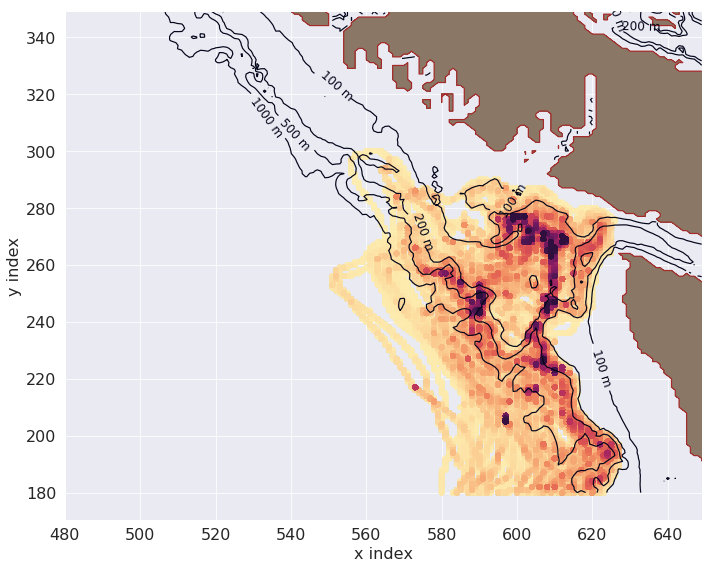

In [19]:
#     cmap=plt.cm.get_cmap('nipy_spectral')
# cmap = plt.cm.get_cmap('Blues_r')
cmap = cmo.cm.matter
cmap.set_bad('#8b7765')


vmin = 0
vmax = 700

import matplotlib as mpl
    


fig, ax = plt.subplots(1, 1, figsize=(10,8)); ax.grid()


CS1 = ax.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)


# part = ind[0]
# for part in ind[139]:

    
# track1 = ax.scatter(x_wcvi_slice[np.int(np.rint(x1[part]))-1], y_wcvi_slice[np.int(np.rint(y1[part]))-1], s=500, marker = '*', c = 'magenta', alpha=0.9, edgecolor= 'orangered')

    
q = density_scatter(x_plot_cuc, y_plot_cuc, ax= ax, bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)
    #     q = ax.scatter(x, y, c = np.multiply(-1,np.ma.array(traj_depth[k,part]).filled()), cmap = cmap, vmin = cmin, vmax= cmax, s=100, alpha=0.9)#, edgecolor= 'cyan')

#     t = np.int(np.rint(120 - traj_time[k,part]*120))
#     level = np.int(np.rint((np.abs(zlevels - (-traj_depth[k,part]))).argmin()))



#     j, i = geo_tools.find_closest_model_point(traj_lon[k,part],traj_lat[k,part],\
#                                               lon_small,lat_small,grid='NEMO',tols=\
#                                               {'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},\
#                                                'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}}) 


#     quiver = ax.quiver(x_wcvi_slice[::arrow_step], y_wcvi_slice[::arrow_step], u_rho_0[::arrow_step,::arrow_step], v_rho_0[::arrow_step,::arrow_step] , speeds[::arrow_step,::arrow_step], pivot='mid', cmap = cmap, width=0.005, minshaft= 0.5)
#     quiver = ax.quiver(x, y, u_tzyx_loc, v_tzyx_loc , color = 'blue', cmap = cmap, pivot='tail', width=0.003, minshaft= 0.5)
# #     legend = ax.legend(loc='best', fancybox=True, framealpha=0.25, fontsize =16)
# ax.quiverkey(quiver, 610, 320,  0.1, r'0.1 m/sec', coordinates = 'data')

ax.set_xlabel('x index', fontsize =16)
ax.set_ylabel('y index', fontsize = 16)
ax.tick_params(axis='both',labelsize =16)


# ax.set_title('Particle track at depth \u2248 {d:.1f} m'.format(d = np.abs(traj_depth[0,part])), fontsize =16)
ax.legend(loc = 'best')

viz_tools.plot_land_mask(ax, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

ax.grid()

# cbar = fig.colorbar(q, ax=ax)
# cbar.set_label(label='Depth ($m$)', fontsize = 16)
# cbar.ax.tick_params(labelsize=16)
fig.tight_layout()

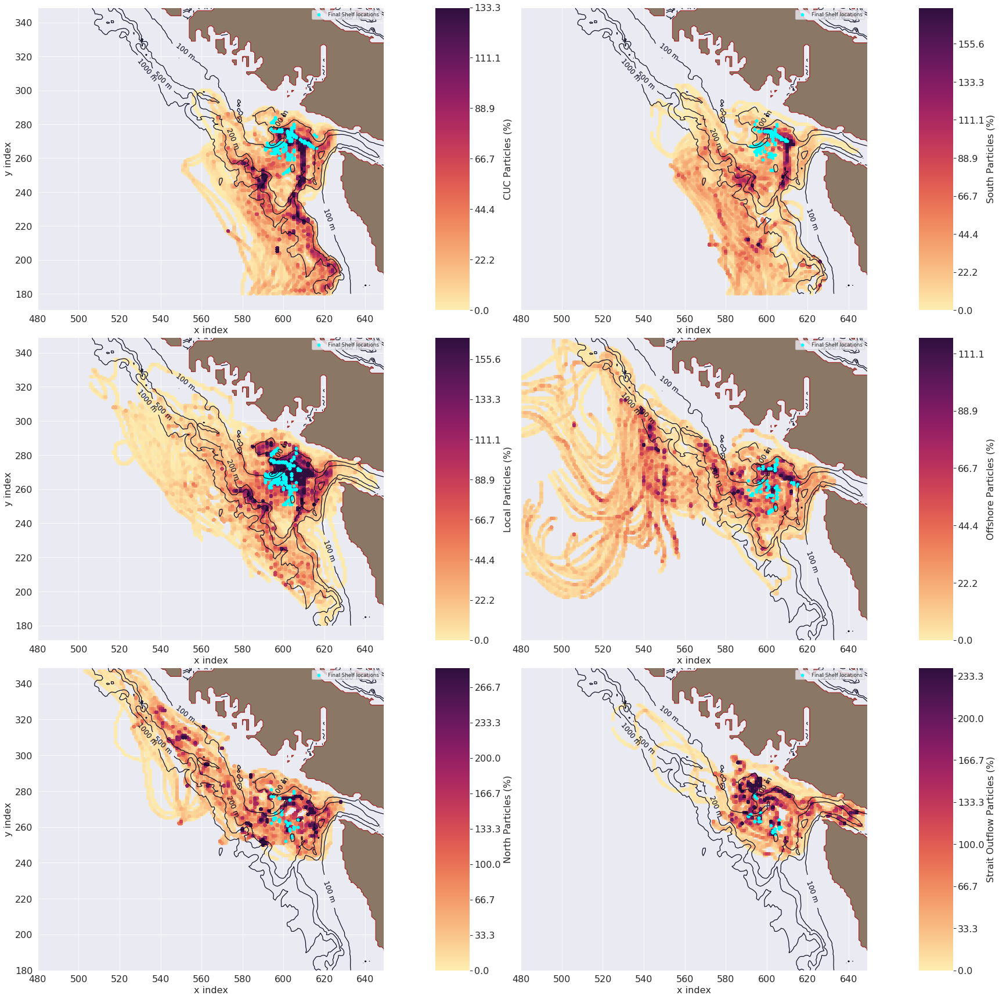

In [65]:
#     cmap=plt.cm.get_cmap('nipy_spectral')
# cmap = plt.cm.get_cmap('Blues_r')
cmap = cmo.cm.matter
cmap.set_bad('#8b7765')




import matplotlib as mpl
    


gridspec = {'width_ratios': [1, 0.1, 1, 0.1]}

fig, (ax, ax1, ax2) = plt.subplots(3, 4, figsize=(24, 24), gridspec_kw=gridspec)


#For CUC 

vmin = 0
vmax = cuc_ind.shape[0]*2

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_cuc, y_plot_cuc, ax= ax[0], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax[0].set_xlabel('x index', fontsize =16)
ax[0].set_ylabel('y index', fontsize = 16)
ax[0].tick_params(axis='both',labelsize =16)

ax[0].scatter(x_wcvi_slice[x1[cuc_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[cuc_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax[0].legend(loc = 'best')

viz_tools.plot_land_mask(ax[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

m = cm.ScalarMappable(cmap=cmap)
m.set_array(q)
m.set_clim(vmin,vmax)

cbar = fig.colorbar(m, cax=ax[1])


cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/cuc_ind.shape[0])*100, \
                                    stop=(cbar.vmax/cuc_ind.shape[0])*100, num=10), decimals = 1))

cbar.set_label(label='CUC Particles (%)', fontsize = 16)
cbar.ax.tick_params(labelsize=16)

#For South Particles

vmin = 0
vmax = south_ind.shape[0]*2

CS1 = ax[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_south, y_plot_south, ax= ax[2], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax[2].set_xlabel('x index', fontsize =16)
# ax[2].set_ylabel('y index', fontsize = 16)
ax[2].tick_params(axis='both',labelsize =16)
ax[2].get_yaxis().set_ticks([])

ax[2].scatter(x_wcvi_slice[x1[south_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[south_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax[2].legend(loc = 'best')

viz_tools.plot_land_mask(ax[2], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax[2], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

m = cm.ScalarMappable(cmap=cmap)
m.set_array(q)
m.set_clim(vmin,vmax)

cbar = fig.colorbar(m, cax=ax[3])


cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/south_ind.shape[0])*100, \
                                    stop=(cbar.vmax/south_ind.shape[0])*100, num=10), decimals = 1))

cbar.set_label(label='South Particles (%)', fontsize = 16)
cbar.ax.tick_params(labelsize=16)


#For local

vmin = 0
vmax = ind_local.shape[0]*2

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_local, y_plot_local, ax= ax1[0], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax1[0].set_xlabel('x index', fontsize =16)
ax1[0].set_ylabel('y index', fontsize = 16)
ax1[0].tick_params(axis='both',labelsize =16)

ax1[0].scatter(x_wcvi_slice[x1[ind_local[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[ind_local[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax1[0].legend(loc = 'best')

viz_tools.plot_land_mask(ax1[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax1[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

m = cm.ScalarMappable(cmap=cmap)
m.set_array(q)
m.set_clim(vmin,vmax)

cbar = fig.colorbar(m, cax=ax1[1])


cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/ind_local.shape[0])*100, \
                                    stop=(cbar.vmax/ind_local.shape[0])*100, num=10), decimals = 1))

cbar.set_label(label='Local Particles (%)', fontsize = 16)
cbar.ax.tick_params(labelsize=16)

#For Offshore Particles

vmin = 0
vmax = off_ind.shape[0]*2

CS1 = ax1[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_off, y_plot_off, ax= ax1[2], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax1[2].set_xlabel('x index', fontsize =16)
# ax1[2].set_ylabel('y index', fontsize = 16)
ax1[2].tick_params(axis='both',labelsize =16)
ax1[2].get_yaxis().set_ticks([])

ax1[2].scatter(x_wcvi_slice[x1[off_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[off_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax1[2].legend(loc = 'best')

viz_tools.plot_land_mask(ax1[2], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax1[2], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

m = cm.ScalarMappable(cmap=cmap)
m.set_array(q)
m.set_clim(vmin,vmax)

cbar = fig.colorbar(m, cax=ax1[3])


cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/off_ind.shape[0])*100, \
                                    stop=(cbar.vmax/off_ind.shape[0])*100, num=10), decimals = 1))

cbar.set_label(label='Offshore Particles (%)', fontsize = 16)
cbar.ax.tick_params(labelsize=16)

#For north particles

vmin = 0
vmax = north_ind.shape[0]*3

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_north, y_plot_north, ax= ax2[0], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax2[0].set_xlabel('x index', fontsize =16)
ax2[0].set_ylabel('y index', fontsize = 16)
ax2[0].tick_params(axis='both',labelsize =16)

ax2[0].scatter(x_wcvi_slice[x1[north_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[north_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax2[0].legend(loc = 'best')

viz_tools.plot_land_mask(ax2[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax2[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

m = cm.ScalarMappable(cmap=cmap)
m.set_array(q)
m.set_clim(vmin,vmax)

cbar = fig.colorbar(m, cax=ax2[1])


cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/north_ind.shape[0])*100, \
                                    stop=(cbar.vmax/north_ind.shape[0])*100, num=10), decimals = 1))

cbar.set_label(label='North Particles (%)', fontsize = 16)
cbar.ax.tick_params(labelsize=16)

#For Juan Particles

vmin = 0
vmax = juan_ind.shape[0]*3

CS1 = ax2[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_juan, y_plot_juan, ax= ax2[2], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax2[2].set_xlabel('x index', fontsize =16)
# ax2[2].set_ylabel('y index', fontsize = 16)
ax2[2].tick_params(axis='both',labelsize =16)
ax2[2].get_yaxis().set_ticks([])

ax2[2].scatter(x_wcvi_slice[x1[juan_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[juan_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax2[2].legend(loc = 'best')

viz_tools.plot_land_mask(ax2[2], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax2[2], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

m = cm.ScalarMappable(cmap=cmap)
m.set_array(q)
m.set_clim(vmin,vmax)

cbar = fig.colorbar(m, cax=ax2[3])


cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/juan_ind.shape[0])*100, \
                                    stop=(cbar.vmax/juan_ind.shape[0])*100, num=10), decimals = 1))

cbar.set_label(label='Strait Outflow Particles (%)', fontsize = 16)
cbar.ax.tick_params(labelsize=16)


# fig.tight_layout(w_pad=0.05)

fig.tight_layout(h_pad=0.01,w_pad=0.01)

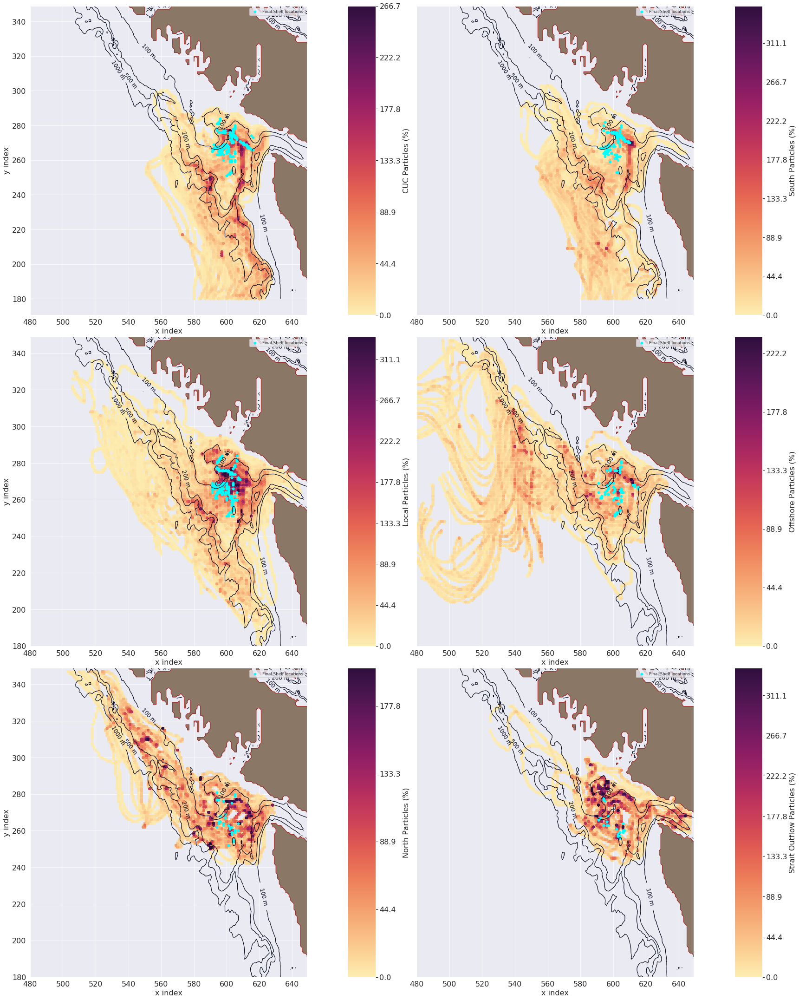

In [18]:
#     cmap=plt.cm.get_cmap('nipy_spectral')
# cmap = plt.cm.get_cmap('Blues_r')
cmap = cmo.cm.matter
cmap.set_bad('#8b7765')




import matplotlib as mpl
    


gridspec = {'width_ratios': [1, 0.1, 1, 0.1]}

fig, (ax, ax1, ax2) = plt.subplots(3, 4, figsize=(24, 30), gridspec_kw=gridspec)


#For CUC 

vmin = 0
vmax = cuc_ind.shape[0]*4

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_cuc, y_plot_cuc, ax= ax[0], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax[0].set_xlabel('x index', fontsize =16)
ax[0].set_ylabel('y index', fontsize = 16)
ax[0].tick_params(axis='both',labelsize =16)

ax[0].scatter(x_wcvi_slice[x1[cuc_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[cuc_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax[0].legend(loc = 'best')

viz_tools.plot_land_mask(ax[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

m = cm.ScalarMappable(cmap=cmap)
m.set_array(q)
m.set_clim(vmin,vmax)

cbar = fig.colorbar(m, cax=ax[1])


cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/cuc_ind.shape[0])*100, \
                                    stop=(cbar.vmax/cuc_ind.shape[0])*100, num=10), decimals = 1))

cbar.set_label(label='CUC Particles (%)', fontsize = 16)
cbar.ax.tick_params(labelsize=16)

#For South Particles

vmin = 0
vmax = south_ind.shape[0]*4

CS1 = ax[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_south, y_plot_south, ax= ax[2], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax[2].set_xlabel('x index', fontsize =16)
# ax[2].set_ylabel('y index', fontsize = 16)
ax[2].tick_params(axis='both',labelsize =16)
ax[2].get_yaxis().set_ticks([])

ax[2].scatter(x_wcvi_slice[x1[south_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[south_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax[2].legend(loc = 'best')

viz_tools.plot_land_mask(ax[2], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax[2], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

m = cm.ScalarMappable(cmap=cmap)
m.set_array(q)
m.set_clim(vmin,vmax)

cbar = fig.colorbar(m, cax=ax[3])


cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/south_ind.shape[0])*100, \
                                    stop=(cbar.vmax/south_ind.shape[0])*100, num=10), decimals = 1))

cbar.set_label(label='South Particles (%)', fontsize = 16)
cbar.ax.tick_params(labelsize=16)


#For local

vmin = 0
vmax = ind_local.shape[0]*4

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_local, y_plot_local, ax= ax1[0], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax1[0].set_xlabel('x index', fontsize =16)
ax1[0].set_ylabel('y index', fontsize = 16)
ax1[0].tick_params(axis='both',labelsize =16)

ax1[0].scatter(x_wcvi_slice[x1[ind_local[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[ind_local[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax1[0].legend(loc = 'best')

viz_tools.plot_land_mask(ax1[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax1[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

m = cm.ScalarMappable(cmap=cmap)
m.set_array(q)
m.set_clim(vmin,vmax)

cbar = fig.colorbar(m, cax=ax1[1])


cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/ind_local.shape[0])*100, \
                                    stop=(cbar.vmax/ind_local.shape[0])*100, num=10), decimals = 1))

cbar.set_label(label='Local Particles (%)', fontsize = 16)
cbar.ax.tick_params(labelsize=16)

#For Offshore Particles

vmin = 0
vmax = off_ind.shape[0]*4

CS1 = ax1[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_off, y_plot_off, ax= ax1[2], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax1[2].set_xlabel('x index', fontsize =16)
# ax1[2].set_ylabel('y index', fontsize = 16)
ax1[2].tick_params(axis='both',labelsize =16)
ax1[2].get_yaxis().set_ticks([])

ax1[2].scatter(x_wcvi_slice[x1[off_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[off_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax1[2].legend(loc = 'best')
ax1[2].set_xlim(left = 480)

viz_tools.plot_land_mask(ax1[2], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax1[2], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

m = cm.ScalarMappable(cmap=cmap)
m.set_array(q)
m.set_clim(vmin,vmax)

cbar = fig.colorbar(m, cax=ax1[3])


cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/off_ind.shape[0])*100, \
                                    stop=(cbar.vmax/off_ind.shape[0])*100, num=10), decimals = 1))

cbar.set_label(label='Offshore Particles (%)', fontsize = 16)
cbar.ax.tick_params(labelsize=16)

#For north particles

vmin = 0
vmax = north_ind.shape[0]*4

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_north, y_plot_north, ax= ax2[0], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax2[0].set_xlabel('x index', fontsize =16)
ax2[0].set_ylabel('y index', fontsize = 16)
ax2[0].tick_params(axis='both',labelsize =16)

ax2[0].scatter(x_wcvi_slice[x1[north_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[north_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax2[0].legend(loc = 'best')

viz_tools.plot_land_mask(ax2[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax2[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

m = cm.ScalarMappable(cmap=cmap)
m.set_array(q)
m.set_clim(vmin,vmax)

cbar = fig.colorbar(m, cax=ax2[1])


cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/north_ind.shape[0])*100, \
                                    stop=(cbar.vmax/north_ind.shape[0])*100, num=10), decimals = 1))

cbar.set_label(label='North Particles (%)', fontsize = 16)
cbar.ax.tick_params(labelsize=16)

#For Juan Particles

vmin = 0
vmax = juan_ind.shape[0]*4

CS1 = ax2[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_juan, y_plot_juan, ax= ax2[2], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax2[2].set_xlabel('x index', fontsize =16)
# ax2[2].set_ylabel('y index', fontsize = 16)
ax2[2].tick_params(axis='both',labelsize =16)
ax2[2].get_yaxis().set_ticks([])

ax2[2].scatter(x_wcvi_slice[x1[juan_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[juan_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax2[2].legend(loc = 'best')

viz_tools.plot_land_mask(ax2[2], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax2[2], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

m = cm.ScalarMappable(cmap=cmap)
m.set_array(q)
m.set_clim(vmin,vmax)

cbar = fig.colorbar(m, cax=ax2[3])


cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/juan_ind.shape[0])*100, \
                                    stop=(cbar.vmax/juan_ind.shape[0])*100, num=10), decimals = 1))

cbar.set_label(label='Strait Outflow Particles (%)', fontsize = 16)
cbar.ax.tick_params(labelsize=16)


# fig.tight_layout(w_pad=0.05)

fig.tight_layout(h_pad=0.01,w_pad=0.01)

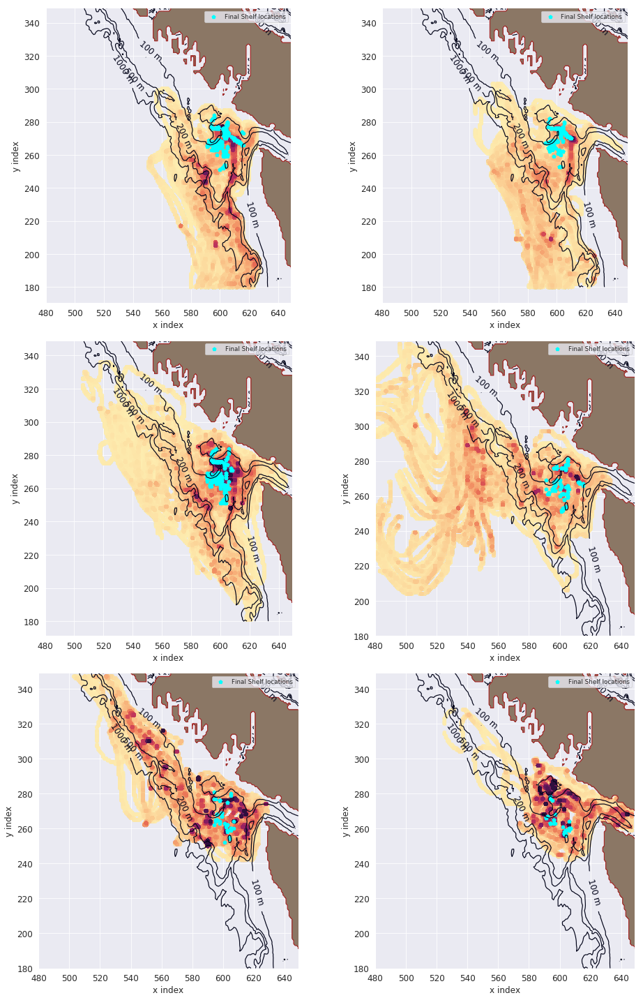

In [17]:
#     cmap=plt.cm.get_cmap('nipy_spectral')
# cmap = plt.cm.get_cmap('Blues_r')
cmap = cmo.cm.matter
cmap.set_bad('#8b7765')




import matplotlib as mpl
    


gridspec = {'width_ratios': [1, 1]}

fig, (ax, ax1, ax2) = plt.subplots(3, 2, figsize=(14, 20), gridspec_kw=gridspec)


#For CUC 

vmin = 0
vmax = cuc_ind.shape[0]*4

viz_tools.set_aspect(ax[0])

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_cuc, y_plot_cuc, ax= ax[0], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax[0].set_xlabel('x index', fontsize =12)
ax[0].set_ylabel('y index', fontsize = 12)
ax[0].tick_params(axis='both',labelsize =12)

ax[0].scatter(x_wcvi_slice[x1[cuc_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[cuc_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax[0].legend(loc = 'best')

viz_tools.plot_land_mask(ax[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

# m = cm.ScalarMappable(cmap=cmap)
# m.set_array(q)
# m.set_clim(vmin,vmax)

# cbar = fig.colorbar(m, cax=ax[1])


# cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/cuc_ind.shape[0])*100, \
#                                     stop=(cbar.vmax/cuc_ind.shape[0])*100, num=10), decimals = 1))

# cbar.set_label(label='CUC Particles (%)', fontsize = 16)
# cbar.ax.tick_params(labelsize=16)

#For South Particles

vmin = 0
vmax = south_ind.shape[0]*4

viz_tools.set_aspect(ax[1])

CS1 = ax[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_south, y_plot_south, ax= ax[1], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax[1].set_xlabel('x index', fontsize =12)
ax[1].set_ylabel('y index', fontsize = 12)
ax[1].tick_params(axis='both',labelsize =12)
# ax[1].get_yaxis().set_ticks([])

ax[1].scatter(x_wcvi_slice[x1[south_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[south_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax[1].legend(loc = 'best')

viz_tools.plot_land_mask(ax[1], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax[1], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

# m = cm.ScalarMappable(cmap=cmap)
# m.set_array(q)
# m.set_clim(vmin,vmax)

# cbar = fig.colorbar(m, cax=ax[3])


# cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/south_ind.shape[0])*100, \
#                                     stop=(cbar.vmax/south_ind.shape[0])*100, num=10), decimals = 1))

# cbar.set_label(label='South Particles (%)', fontsize = 16)
# cbar.ax.tick_params(labelsize=16)


#For local

vmin = 0
vmax = ind_local.shape[0]*4

viz_tools.set_aspect(ax1[0])

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_local, y_plot_local, ax= ax1[0], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax1[0].set_xlabel('x index', fontsize =12)
ax1[0].set_ylabel('y index', fontsize = 12)
ax1[0].tick_params(axis='both',labelsize =12)

ax1[0].scatter(x_wcvi_slice[x1[ind_local[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[ind_local[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax1[0].legend(loc = 'best')

viz_tools.plot_land_mask(ax1[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax1[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

# m = cm.ScalarMappable(cmap=cmap)
# m.set_array(q)
# m.set_clim(vmin,vmax)

# cbar = fig.colorbar(m, cax=ax1[1])


# cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/ind_local.shape[0])*100, \
#                                     stop=(cbar.vmax/ind_local.shape[0])*100, num=10), decimals = 1))

# cbar.set_label(label='Local Particles (%)', fontsize = 16)
# cbar.ax.tick_params(labelsize=16)

#For Offshore Particles

vmin = 0
vmax = off_ind.shape[0]*4

viz_tools.set_aspect(ax1[1])

CS1 = ax1[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_off, y_plot_off, ax= ax1[1], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax1[1].set_xlabel('x index', fontsize =12)
ax1[1].set_ylabel('y index', fontsize = 12)
ax1[1].tick_params(axis='both',labelsize =12)
# ax1[1].get_yaxis().set_ticks([])

ax1[1].scatter(x_wcvi_slice[x1[off_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[off_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax1[1].legend(loc = 'best')
ax1[1].set_xlim(left = 480)

viz_tools.plot_land_mask(ax1[1], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax1[1], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

# m = cm.ScalarMappable(cmap=cmap)
# m.set_array(q)
# m.set_clim(vmin,vmax)

# cbar = fig.colorbar(m, cax=ax1[3])


# cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/off_ind.shape[0])*100, \
#                                     stop=(cbar.vmax/off_ind.shape[0])*100, num=10), decimals = 1))

# cbar.set_label(label='Offshore Particles (%)', fontsize = 16)
# cbar.ax.tick_params(labelsize=16)

#For north particles

vmin = 0
vmax = north_ind.shape[0]*4

viz_tools.set_aspect(ax2[0])

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_north, y_plot_north, ax= ax2[0], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax2[0].set_xlabel('x index', fontsize =12)
ax2[0].set_ylabel('y index', fontsize = 12)
ax2[0].tick_params(axis='both',labelsize =12)

ax2[0].scatter(x_wcvi_slice[x1[north_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[north_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax2[0].legend(loc = 'best')

viz_tools.plot_land_mask(ax2[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax2[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

# m = cm.ScalarMappable(cmap=cmap)
# m.set_array(q)
# m.set_clim(vmin,vmax)

# cbar = fig.colorbar(m, cax=ax2[1])


# cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/north_ind.shape[0])*100, \
#                                     stop=(cbar.vmax/north_ind.shape[0])*100, num=10), decimals = 1))

# cbar.set_label(label='North Particles (%)', fontsize = 16)
# cbar.ax.tick_params(labelsize=16)

#For Juan Particles

vmin = 0
vmax = juan_ind.shape[0]*4

viz_tools.set_aspect(ax2[1])

CS1 = ax2[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_juan, y_plot_juan, ax= ax2[1], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax2[1].set_xlabel('x index', fontsize =12)
ax2[1].set_ylabel('y index', fontsize = 12)
ax2[1].tick_params(axis='both',labelsize =12)
# ax2[1].get_yaxis().set_ticks([])

ax2[1].scatter(x_wcvi_slice[x1[juan_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[juan_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax2[1].legend(loc = 'best')

viz_tools.plot_land_mask(ax2[1], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax2[1], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

# m = cm.ScalarMappable(cmap=cmap)
# m.set_array(q)
# m.set_clim(vmin,vmax)

# cbar = fig.colorbar(m, cax=ax2[3])


# cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/juan_ind.shape[0])*100, \
#                                     stop=(cbar.vmax/juan_ind.shape[0])*100, num=10), decimals = 1))

# cbar.set_label(label='Strait Outflow Particles (%)', fontsize = 16)
# cbar.ax.tick_params(labelsize=16)


fig.tight_layout()

# fig.tight_layout(h_pad=0.01,w_pad=0.01)

In [23]:
sns.set_context('paper')

/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


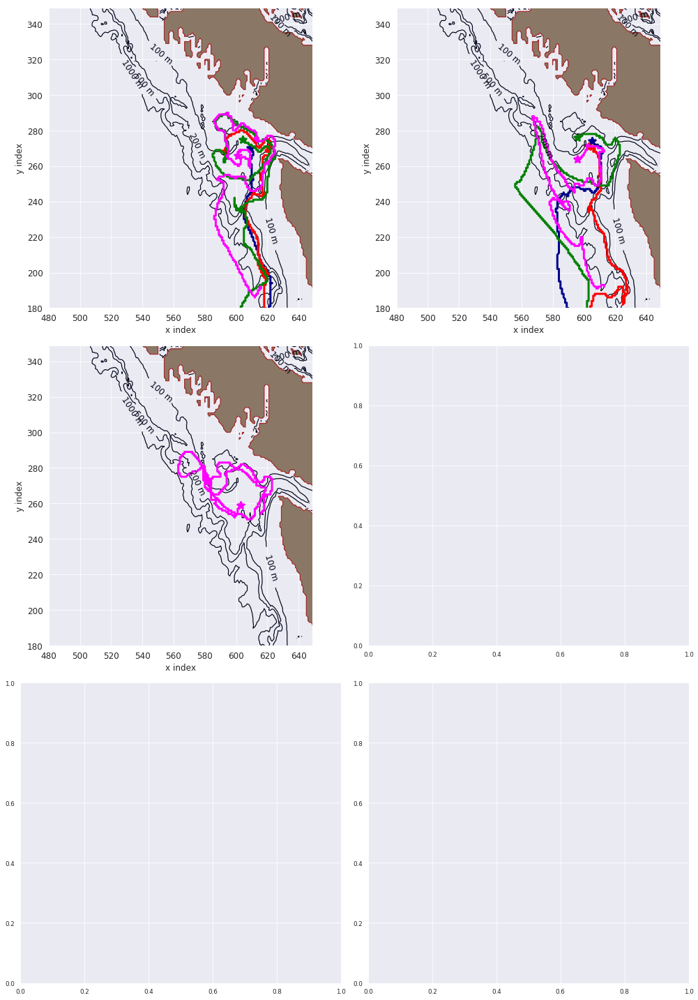

In [74]:

    
#     cmap=plt.cm.get_cmap('nipy_spectral')
# cmap = plt.cm.get_cmap('Blues_r')
cmap = cmo.cm.matter
cmap.set_bad('#8b7765')




import matplotlib as mpl
    


gridspec = {'width_ratios': [1, 1]}

fig, (ax, ax1, ax2) = plt.subplots(3, 2, figsize=(14, 20), gridspec_kw=gridspec)


#For CUC 

vmin = 0
vmax = cuc_ind.shape[0]*4

viz_tools.set_aspect(ax[0])

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

part = cuc_ind[199].astype(int)

y = np.empty(np.int(final_age_days[part]))
x = np.empty_like(y)

for k in np.arange(np.int(final_age_days[part])):
    y[k], x[k] = geo_tools.find_closest_model_point(traj_lon[k,part],traj_lat[k,part],\
                                  lon,lat,grid='NEMO',tols=\
                                  {'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},\
                                   'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})
ax[0].scatter(x_wcvi_slice[np.int(np.rint(x1[part]))-1], y_wcvi_slice[np.int(np.rint(y1[part]))-1], \
              marker = '*', c = 'darkblue',s = 100, linewidths=3, )

ax[0].plot(x, y, c = 'darkblue', linewidth = 3)

part = cuc_ind[99].astype(int)

y = np.empty(np.int(final_age_days[part]))
x = np.empty_like(y)

for k in np.arange(np.int(final_age_days[part])):
    y[k], x[k] = geo_tools.find_closest_model_point(traj_lon[k,part],traj_lat[k,part],\
                                  lon,lat,grid='NEMO',tols=\
                                  {'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},\
                                   'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})
ax[0].scatter(x_wcvi_slice[np.int(np.rint(x1[part]))-1], y_wcvi_slice[np.int(np.rint(y1[part]))-1], \
              marker = '*', c = 'red',s = 100, linewidths=3, )

ax[0].plot(x, y, c = 'red', linewidth = 3)

part = cuc_ind[226].astype(int)

# y = np.empty(np.int(final_age_days[part]))
# x = np.empty_like(y)

# for k in np.arange(np.int(final_age_days[part])):
#     y[k], x[k] = geo_tools.find_closest_model_point(traj_lon[k,part],traj_lat[k,part],\
#                                   lon,lat,grid='NEMO',tols=\
#                                   {'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},\
#                                    'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})
# ax[0].scatter(x_wcvi_slice[np.int(np.rint(x1[part]))-1], y_wcvi_slice[np.int(np.rint(y1[part]))-1], \
#               marker = '*', c = 'cyan',s = 10, linewidths=3, )

# ax[0].plot(x, y, c = 'red', linewidth = 3)

part = cuc_ind[175].astype(int)

y = np.empty(np.int(final_age_days[part]))
x = np.empty_like(y)

for k in np.arange(np.int(final_age_days[part])):
    y[k], x[k] = geo_tools.find_closest_model_point(traj_lon[k,part],traj_lat[k,part],\
                                  lon,lat,grid='NEMO',tols=\
                                  {'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},\
                                   'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})
ax[0].scatter(x_wcvi_slice[np.int(np.rint(x1[part]))-1], y_wcvi_slice[np.int(np.rint(y1[part]))-1], \
              marker = '*', c = 'green',s = 100, linewidths=3)

ax[0].plot(x, y, c = 'green', linewidth = 3)

part = cuc_ind[286].astype(int)

y = np.empty(np.int(final_age_days[part]))
x = np.empty_like(y)

for k in np.arange(np.int(final_age_days[part])):
    y[k], x[k] = geo_tools.find_closest_model_point(traj_lon[k,part],traj_lat[k,part],\
                                  lon,lat,grid='NEMO',tols=\
                                  {'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},\
                                   'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})
ax[0].scatter(x_wcvi_slice[np.int(np.rint(x1[part]))-1], y_wcvi_slice[np.int(np.rint(y1[part]))-1], \
              marker = '*', c = 'magenta',s = 100, linewidths=3)

ax[0].plot(x, y, c = 'magenta', linewidth = 3)


    
# q = density_scatter(x_plot_cuc, y_plot_cuc, ax= ax[0], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax[0].set_xlabel('x index', fontsize =12)
ax[0].set_ylabel('y index', fontsize = 12)
ax[0].tick_params(axis='both',labelsize =12)

# ax[0].scatter(x_wcvi_slice[x1[cuc_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[cuc_ind[:].astype(int)-1].astype(int)-1], \
#            marker = '*', c = 'cyan', \
#            s = 10, linewidths=3, label = 'Final Shelf locations')

ax[0].legend(loc = 'best')

viz_tools.plot_land_mask(ax[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')


#For South Particles


viz_tools.set_aspect(ax[1])

CS1 = ax[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

part = south_ind[133].astype(int)

y = np.empty(np.int(final_age_days[part]))
x = np.empty_like(y)

for k in np.arange(np.int(final_age_days[part])):
    y[k], x[k] = geo_tools.find_closest_model_point(traj_lon[k,part],traj_lat[k,part],\
                                  lon,lat,grid='NEMO',tols=\
                                  {'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},\
                                   'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})
ax[1].scatter(x_wcvi_slice[np.int(np.rint(x1[part]))-1], y_wcvi_slice[np.int(np.rint(y1[part]))-1], \
              marker = '*', c = 'darkblue',s = 100, linewidths=3, )

ax[1].plot(x, y, c = 'darkblue', linewidth = 3)


part = south_ind[83].astype(int)

y = np.empty(np.int(final_age_days[part]))
x = np.empty_like(y)

for k in np.arange(np.int(final_age_days[part])):
    y[k], x[k] = geo_tools.find_closest_model_point(traj_lon[k,part],traj_lat[k,part],\
                                  lon,lat,grid='NEMO',tols=\
                                  {'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},\
                                   'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})
ax[1].scatter(x_wcvi_slice[np.int(np.rint(x1[part]))-1], y_wcvi_slice[np.int(np.rint(y1[part]))-1], \
              marker = '*', c = 'red',s = 100, linewidths=3, )

ax[1].plot(x, y, c = 'red', linewidth = 3)


part = south_ind[102].astype(int)

y = np.empty(np.int(final_age_days[part]))
x = np.empty_like(y)

for k in np.arange(np.int(final_age_days[part])):
    y[k], x[k] = geo_tools.find_closest_model_point(traj_lon[k,part],traj_lat[k,part],\
                                  lon,lat,grid='NEMO',tols=\
                                  {'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},\
                                   'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})
ax[1].scatter(x_wcvi_slice[np.int(np.rint(x1[part]))-1], y_wcvi_slice[np.int(np.rint(y1[part]))-1], \
              marker = '*', c = 'green',s = 100, linewidths=3, )

ax[1].plot(x, y, c = 'green', linewidth = 3)

part = south_ind[196].astype(int)

y = np.empty(np.int(final_age_days[part]))
x = np.empty_like(y)

for k in np.arange(np.int(final_age_days[part])):
    y[k], x[k] = geo_tools.find_closest_model_point(traj_lon[k,part],traj_lat[k,part],\
                                  lon,lat,grid='NEMO',tols=\
                                  {'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},\
                                   'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})
ax[1].scatter(x_wcvi_slice[np.int(np.rint(x1[part]))-1], y_wcvi_slice[np.int(np.rint(y1[part]))-1], \
              marker = '*', c = 'magenta',s = 100, linewidths=3, )

ax[1].plot(x, y, c = 'magenta', linewidth = 3)






    
# q = density_scatter(x_plot_south, y_plot_south, ax= ax[1], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax[1].set_xlabel('x index', fontsize =12)
ax[1].set_ylabel('y index', fontsize = 12)
ax[1].tick_params(axis='both',labelsize =12)
# ax[1].get_yaxis().set_ticks([])

# ax[1].scatter(x_wcvi_slice[x1[south_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[south_ind[:].astype(int)-1].astype(int)-1], \
#            marker = '*', c = 'cyan', \
#            s = 10, linewidths=3, label = 'Final Shelf locations')

ax[1].legend(loc = 'best')

viz_tools.plot_land_mask(ax[1], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax[1], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

#For local

viz_tools.set_aspect(ax1[0])

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

# part = ind_local[100].astype(int)

# y = np.empty(np.int(final_age_days[part]))
# x = np.empty_like(y)

# for k in np.arange(np.int(final_age_days[part])):
#     y[k], x[k] = geo_tools.find_closest_model_point(traj_lon[k,part],traj_lat[k,part],\
#                                   lon,lat,grid='NEMO',tols=\
#                                   {'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},\
#                                    'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})
# ax1[0].scatter(x_wcvi_slice[np.int(np.rint(x1[part]))-1], y_wcvi_slice[np.int(np.rint(y1[part]))-1], \
#               marker = '*', c = 'magenta',s = 100, linewidths=3)

# ax1[0].plot(x, y, c = 'magenta', linewidth = 3)

part = ind_local[357].astype(int)

y = np.empty(np.int(final_age_days[part]))
x = np.empty_like(y)

for k in np.arange(np.int(final_age_days[part])):
    y[k], x[k] = geo_tools.find_closest_model_point(traj_lon[k,part],traj_lat[k,part],\
                                  lon,lat,grid='NEMO',tols=\
                                  {'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},\
                                   'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})
ax1[0].scatter(x_wcvi_slice[np.int(np.rint(x1[part]))-1], y_wcvi_slice[np.int(np.rint(y1[part]))-1], \
              marker = '*', c = 'magenta',s = 100, linewidths=3)

ax1[0].plot(x, y, c = 'magenta', linewidth = 3)


    
# q = density_scatter(x_plot_local, y_plot_local, ax= ax1[0], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax1[0].set_xlabel('x index', fontsize =12)
ax1[0].set_ylabel('y index', fontsize = 12)
ax1[0].tick_params(axis='both',labelsize =12)

# ax1[0].scatter(x_wcvi_slice[x1[ind_local[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[ind_local[:].astype(int)-1].astype(int)-1], \
#            marker = '*', c = 'cyan', \
#            s = 10, linewidths=3, label = 'Final Shelf locations')

ax1[0].legend(loc = 'best')

viz_tools.plot_land_mask(ax1[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax1[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# # ax[0].grid()

# # m = cm.ScalarMappable(cmap=cmap)
# # m.set_array(q)
# # m.set_clim(vmin,vmax)

# # cbar = fig.colorbar(m, cax=ax1[1])


# # cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/ind_local.shape[0])*100, \
# #                                     stop=(cbar.vmax/ind_local.shape[0])*100, num=10), decimals = 1))

# # cbar.set_label(label='Local Particles (%)', fontsize = 16)
# # cbar.ax.tick_params(labelsize=16)

# #For Offshore Particles

# vmin = 0
# vmax = off_ind.shape[0]*4

# viz_tools.set_aspect(ax1[1])

# CS1 = ax1[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
# CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

# CS1 = ax1[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
# CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

# CS1 = ax1[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
# CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

# CS1 = ax1[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
# CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
# q = density_scatter(x_plot_off, y_plot_off, ax= ax1[1], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

# ax1[1].set_xlabel('x index', fontsize =12)
# ax1[1].set_ylabel('y index', fontsize = 12)
# ax1[1].tick_params(axis='both',labelsize =12)
# # ax1[1].get_yaxis().set_ticks([])

# ax1[1].scatter(x_wcvi_slice[x1[off_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[off_ind[:].astype(int)-1].astype(int)-1], \
#            marker = '*', c = 'cyan', \
#            s = 10, linewidths=3, label = 'Final Shelf locations')

# ax1[1].legend(loc = 'best')
# ax1[1].set_xlim(left = 480)

# viz_tools.plot_land_mask(ax1[1], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
# viz_tools.plot_coastline(ax1[1], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# # ax[0].grid()

# # m = cm.ScalarMappable(cmap=cmap)
# # m.set_array(q)
# # m.set_clim(vmin,vmax)

# # cbar = fig.colorbar(m, cax=ax1[3])


# # cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/off_ind.shape[0])*100, \
# #                                     stop=(cbar.vmax/off_ind.shape[0])*100, num=10), decimals = 1))

# # cbar.set_label(label='Offshore Particles (%)', fontsize = 16)
# # cbar.ax.tick_params(labelsize=16)

# #For north particles

# vmin = 0
# vmax = north_ind.shape[0]*4

# viz_tools.set_aspect(ax2[0])

# CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
# CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

# CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
# CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

# CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
# CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

# CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
# CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
# q = density_scatter(x_plot_north, y_plot_north, ax= ax2[0], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

# ax2[0].set_xlabel('x index', fontsize =12)
# ax2[0].set_ylabel('y index', fontsize = 12)
# ax2[0].tick_params(axis='both',labelsize =12)

# ax2[0].scatter(x_wcvi_slice[x1[north_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[north_ind[:].astype(int)-1].astype(int)-1], \
#            marker = '*', c = 'cyan', \
#            s = 10, linewidths=3, label = 'Final Shelf locations')

# ax2[0].legend(loc = 'best')

# viz_tools.plot_land_mask(ax2[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
# viz_tools.plot_coastline(ax2[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# # ax[0].grid()

# # m = cm.ScalarMappable(cmap=cmap)
# # m.set_array(q)
# # m.set_clim(vmin,vmax)

# # cbar = fig.colorbar(m, cax=ax2[1])


# # cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/north_ind.shape[0])*100, \
# #                                     stop=(cbar.vmax/north_ind.shape[0])*100, num=10), decimals = 1))

# # cbar.set_label(label='North Particles (%)', fontsize = 16)
# # cbar.ax.tick_params(labelsize=16)

# #For Juan Particles

# vmin = 0
# vmax = juan_ind.shape[0]*4

# viz_tools.set_aspect(ax2[1])

# CS1 = ax2[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
# CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

# CS1 = ax2[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
# CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

# CS1 = ax2[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
# CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

# CS1 = ax2[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
# CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
# q = density_scatter(x_plot_juan, y_plot_juan, ax= ax2[1], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

# ax2[1].set_xlabel('x index', fontsize =12)
# ax2[1].set_ylabel('y index', fontsize = 12)
# ax2[1].tick_params(axis='both',labelsize =12)
# # ax2[1].get_yaxis().set_ticks([])

# ax2[1].scatter(x_wcvi_slice[x1[juan_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[juan_ind[:].astype(int)-1].astype(int)-1], \
#            marker = '*', c = 'cyan', \
#            s = 10, linewidths=3, label = 'Final Shelf locations')

# ax2[1].legend(loc = 'best')

# viz_tools.plot_land_mask(ax2[1], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
# viz_tools.plot_coastline(ax2[1], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# # ax[0].grid()

# # m = cm.ScalarMappable(cmap=cmap)
# # m.set_array(q)
# # m.set_clim(vmin,vmax)

# # cbar = fig.colorbar(m, cax=ax2[3])


# # cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/juan_ind.shape[0])*100, \
# #                                     stop=(cbar.vmax/juan_ind.shape[0])*100, num=10), decimals = 1))

# # cbar.set_label(label='Strait Outflow Particles (%)', fontsize = 16)
# # cbar.ax.tick_params(labelsize=16)


fig.tight_layout()

# fig.tight_layout(h_pad=0.01,w_pad=0.01)

In [42]:
particle_ind = cuc_ind[199].astype(int)

traj_depth_cuc = traj_depth[:,particle_ind]

In [39]:
final_age_days[cuc_ind[175].astype(int)]/24

110.07818609955207

In [44]:
np.empty(np.int(final_age_days[cuc_ind[199].astype(int)])).shape

(609,)

In [51]:
traj_depth_cuc[:np.int(final_age_days[cuc_ind[199].astype(int)])].shape

(609,)

In [26]:
def plot_particle_track(particle_ind):
    
    part = particle_ind
    
    bathy = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/Bathymetry_EastCoast_NEMO_R036_GEBCO_corr_v14.nc')

    Z = bathy.variables['Bathymetry']


    lon = bathy['nav_lon'][...]
    lat = bathy['nav_lat'][...]



    file_model = nc.Dataset('/data/ssahu/NEP36_2013_summer_hindcast/cut_NEP36-S29_1d_20130429_20131025_grid_T_20130429-20130508.nc')

    lon_small = file_model.variables['nav_lon'][1:,1:]
    lat_small = file_model.variables['nav_lat'][1:,1:]




#     cmap=plt.cm.get_cmap('nipy_spectral')
#     cmap = plt.cm.get_cmap('gist_rainbow_r')
    cmap  = cmo.cm.dense
    cmap.set_bad('#8b7765')
    cmin = 0
    cmax = 300

    import matplotlib as mpl
    #     norm = mpl.colors.Normalize(vmin=cmin,vmax=cmax)

    fig, ax = plt.subplots(1, 1, figsize=(16,12)); ax.grid()
    CS = ax.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,200,10))
    CS1 = ax.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], level = [0,100,200,500,1000])
    CLS = plt.clabel(CS, inline=3,fmt='%0.0f m', fontsize=12)
    CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)


    # part = ind[0]
    # for part in ind[139]:

    for k in np.arange(0,np.int(final_age_days[part]),10):
        y, x = geo_tools.find_closest_model_point(traj_lon[k,part],traj_lat[k,part],\
                                      lon,lat,grid='NEMO',tols=\
                                      {'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},\
                                       'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})
        track1 = ax.scatter(x_wcvi_slice[np.int(np.rint(x1[part]))-1], y_wcvi_slice[np.int(np.rint(y1[part]))-1], s=500, marker = '*', c = 'magenta', alpha=0.9, edgecolor= 'orangered')
        q = ax.scatter(x, y, c = np.multiply(-1,np.ma.array(traj_depth[k,part]).filled()), cmap = cmap, vmin = cmin, vmax= cmax, s=100, alpha=0.9)#, edgecolor= 'cyan')

        t = np.int(np.rint(120 - traj_time[k,part]*120))
        level = np.int(np.rint((np.abs(zlevels - (-traj_depth[k,part]))).argmin()))



        j, i = geo_tools.find_closest_model_point(traj_lon[k,part],traj_lat[k,part],\
                                                  lon_small,lat_small,grid='NEMO',tols=\
                                                  {'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},\
                                                   'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}}) 


    #     quiver = ax.quiver(x_wcvi_slice[::arrow_step], y_wcvi_slice[::arrow_step], u_rho_0[::arrow_step,::arrow_step], v_rho_0[::arrow_step,::arrow_step] , speeds[::arrow_step,::arrow_step], pivot='mid', cmap = cmap, width=0.005, minshaft= 0.5)
    #     quiver = ax.quiver(x, y, u_tzyx_loc, v_tzyx_loc , color = 'blue', cmap = cmap, pivot='tail', width=0.003, minshaft= 0.5)
    # #     legend = ax.legend(loc='best', fancybox=True, framealpha=0.25, fontsize =16)
    # ax.quiverkey(quiver, 610, 320,  0.1, r'0.1 m/sec', coordinates = 'data')

    ax.set_xlabel('x index', fontsize =16)
    ax.set_ylabel('y index', fontsize = 16)
    ax.tick_params(axis='both',labelsize =16)


    # ax.set_title('Particle track at depth \u2248 {d:.1f} m'.format(d = np.abs(traj_depth[0,part])), fontsize =16)
    ax.legend(loc = 'best')

    viz_tools.plot_land_mask(ax, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='burlywood')
    viz_tools.plot_coastline(ax, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='k')

    ax.grid()

    cbar = fig.colorbar(q, ax=ax)
    cbar.set_label(label='Depth ($m$)', fontsize = 16)
    cbar.ax.tick_params(labelsize=16)
    fig.tight_layout()
    
def plot_particle_track_line(particle_ind):
    
    part = particle_ind
    
    bathy = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/Bathymetry_EastCoast_NEMO_R036_GEBCO_corr_v14.nc')

    Z = bathy.variables['Bathymetry']


    lon = bathy['nav_lon'][...]
    lat = bathy['nav_lat'][...]



    file_model = nc.Dataset('/data/ssahu/NEP36_2013_summer_hindcast/cut_NEP36-S29_1d_20130429_20131025_grid_T_20130429-20130508.nc')

    lon_small = file_model.variables['nav_lon'][1:,1:]
    lat_small = file_model.variables['nav_lat'][1:,1:]




#     cmap=plt.cm.get_cmap('nipy_spectral')
#     cmap = plt.cm.get_cmap('gist_rainbow_r')
    cmap  = cmo.cm.deep
    cmap.set_bad('#8b7765')
    cmin = 0
    cmax = 300

    import matplotlib as mpl
    #     norm = mpl.colors.Normalize(vmin=cmin,vmax=cmax)

    fig, ax = plt.subplots(1, 1, figsize=(16,12)); ax.grid()
    CS = ax.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,200,10))
    CS1 = ax.contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], level = [0,100,200,500,1000])
    CLS = plt.clabel(CS, inline=3,fmt='%0.0f m', fontsize=12)
    CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)


    # part = ind[0]
    # for part in ind[139]:
    
    y = np.empty(np.int(final_age_days[part]))
    x = np.empty_like(y)

    for k in np.arange(np.int(final_age_days[part])):
        y[k], x[k] = geo_tools.find_closest_model_point(traj_lon[k,part],traj_lat[k,part],\
                                      lon,lat,grid='NEMO',tols=\
                                      {'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},\
                                       'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}})
        track1 = ax.scatter(x_wcvi_slice[np.int(np.rint(x1[part]))-1], y_wcvi_slice[np.int(np.rint(y1[part]))-1], s=500, marker = '*', c = 'magenta', alpha=0.9, edgecolor= 'orangered')
        t = np.int(np.rint(120 - traj_time[k,part]*120))
        level = np.int(np.rint((np.abs(zlevels - (-traj_depth[k,part]))).argmin()))

#     traj_depth_cuc = traj_depth[:,particle_ind]
    
#     norm = mpl.colors.Normalize(vmin = cmin, vmax = cmax)
#     norm.autoscale(occurrence)
#     cm = matplotlib.cm.copper

#     sm = mpl.cm.ScalarMappable(cmap=cmap, norm=norm)
#     sm.set_array(np.multiply(-1,np.ma.array(traj_depth_cuc[:np.int(final_age_days[cuc_ind[199].astype(int)])])))
#     sm.set_array([])
    q = ax.plot(x, y, c = 'darkblue', \
                                      linewidth = 3)
#     ax.quiver(x[:-1][::10], y[:-1][::10], x[1:][::10]-x[:-1][::10], y[1:][::10]-y[:-1][::10], \
#               np.multiply(-1,np.ma.array(traj_depth_cuc[:np.int(final_age_days[cuc_ind[199].astype(int)])][::10])\
#                               .filled()), cmap = cmap, norm = norm, \
#               scale_units='xy', angles='xy', scale=5)
    
#     m = cm.ScalarMappable(cmap=plt.get_cmap(cmo.cm.balance))
#     m.set_array(spic_iso)
    #     m.set_clim(-0.4, -0.05)
#     m.set_clim(-0.2, -0.05)
#     plt.colorbar(sm)


    #     quiver = ax.quiver(x_wcvi_slice[::arrow_step], y_wcvi_slice[::arrow_step], u_rho_0[::arrow_step,::arrow_step], v_rho_0[::arrow_step,::arrow_step] , speeds[::arrow_step,::arrow_step], pivot='mid', cmap = cmap, width=0.005, minshaft= 0.5)
    #     quiver = ax.quiver(x, y, u_tzyx_loc, v_tzyx_loc , color = 'blue', cmap = cmap, pivot='tail', width=0.003, minshaft= 0.5)
    # #     legend = ax.legend(loc='best', fancybox=True, framealpha=0.25, fontsize =16)
    # ax.quiverkey(quiver, 610, 320,  0.1, r'0.1 m/sec', coordinates = 'data')

    ax.set_xlabel('x index', fontsize =16)
    ax.set_ylabel('y index', fontsize = 16)
    ax.tick_params(axis='both',labelsize =16)


    # ax.set_title('Particle track at depth \u2248 {d:.1f} m'.format(d = np.abs(traj_depth[0,part])), fontsize =16)
    ax.legend(loc = 'best')

    viz_tools.plot_land_mask(ax, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='burlywood')
    viz_tools.plot_coastline(ax, bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='k')

    ax.grid()

    fig.tight_layout()
    
 
 

/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


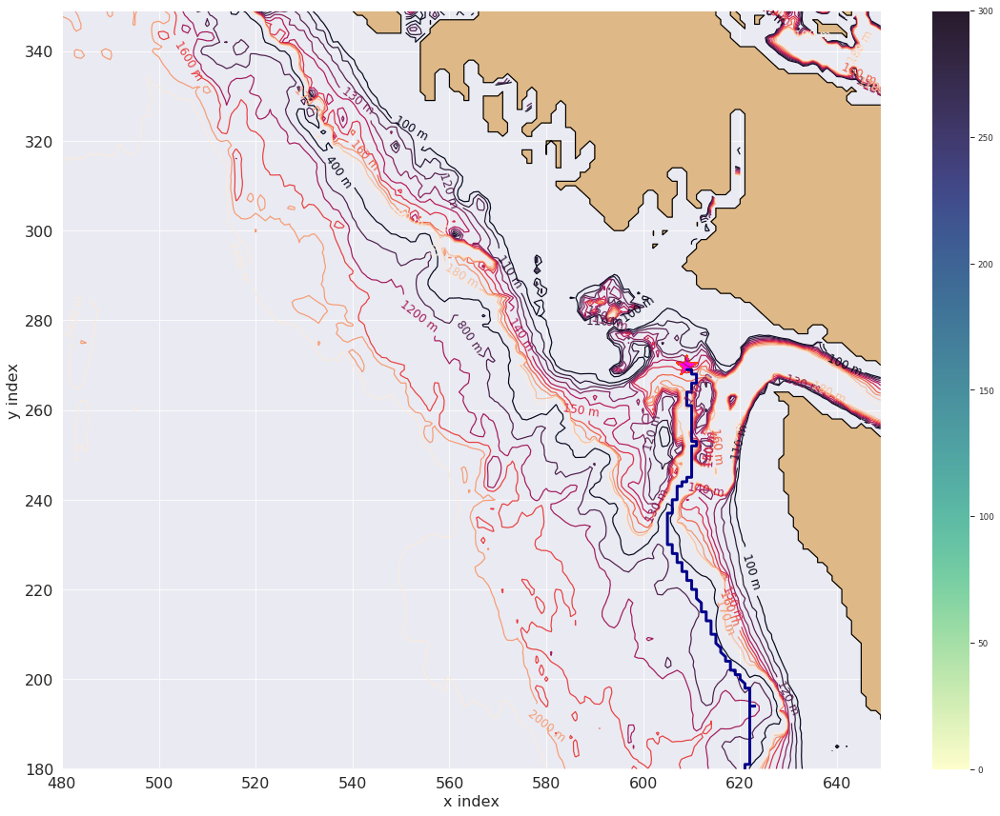

In [77]:
plot_particle_track_line(particle_ind=cuc_ind[199].astype(int))

/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


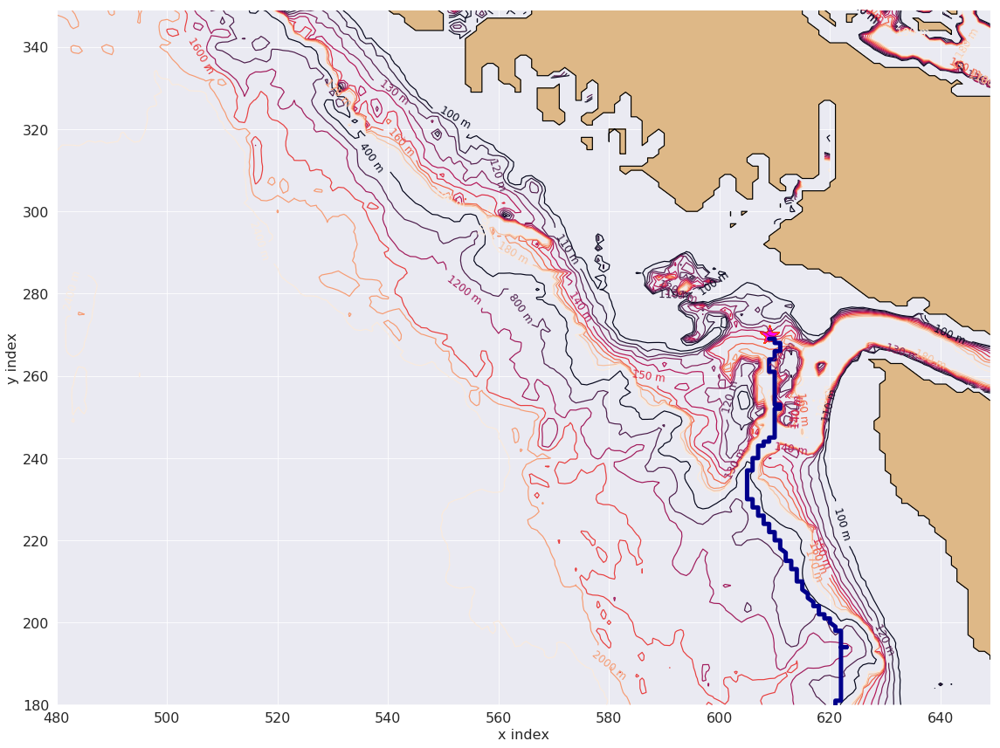

In [16]:
plot_particle_track_line(particle_ind=cuc_ind[199].astype(int))

In [70]:
np.where((x_wcvi_slice[x1[ind_local.astype(int)].astype(int)] > 600) &\
         (y_wcvi_slice[y1[ind_local.astype(int)].astype(int)] > 220) )

(array([ 16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,  28,
         29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,  40,  41,
         42,  43,  44,  45,  71,  72,  73,  74,  75,  76,  77,  78,  87,
         96,  97, 127, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183,
        184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196,
        197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209,
        210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 241,
        242, 243, 244, 245, 246, 247, 248, 249, 250, 251, 252, 253, 254,
        255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 272, 273, 274,
        275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287,
        288, 289, 290, 291, 292, 293, 307, 308, 309, 347, 348, 349, 350,
        351, 352, 353, 354, 355, 356, 357, 358, 365, 366, 367, 368, 369]),)

In [71]:
x_wcvi_slice[x1[ind_local[357].astype(int)].astype(int)]

604

In [72]:
y_wcvi_slice[y1[ind_local[357].astype(int)].astype(int)]

260

In [44]:
np.where((traj_days_final_south > 90)& (traj_days_final_south < 100))

(array([102, 103]),)

In [34]:
idx = (np.abs(traj_days_final_cuc - np.mean(traj_days_final_cuc))).argmin()

In [35]:
idx

178

In [48]:
np.mean(traj_days_final_local)

119.0

In [50]:
ind_local.shape

(377,)

In [43]:
np.where(traj_days_final_south == np.max(traj_days_final_south))

(array([  0,   1,   2,  11,  12,  13,  14,  15,  16,  17,  36,  37,  40,
         41,  42,  47,  48,  49,  51,  52,  53,  54,  55,  56,  61,  66,
         76,  77,  78,  79,  80,  96,  97,  99, 101, 116, 138, 140, 142,
        143, 145, 147, 149, 150, 151, 154, 165, 166, 167, 168, 176, 177,
        178, 181, 182, 185, 186, 187, 192, 193, 194, 195, 196]),)

/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


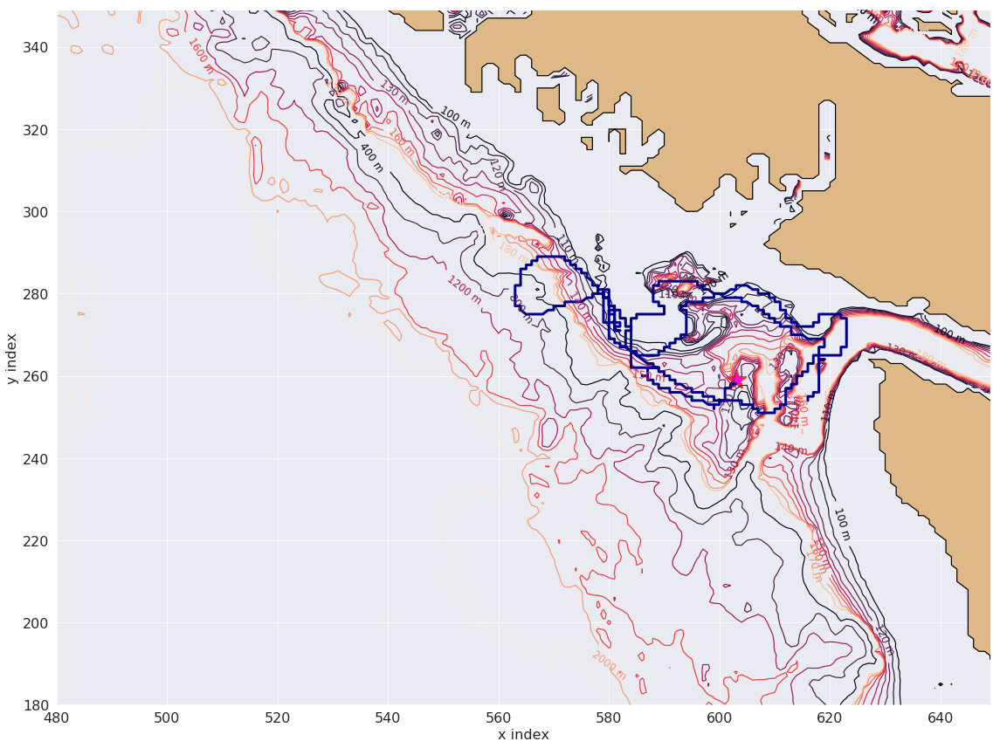

In [73]:
plot_particle_track_line(particle_ind=ind_local[357].astype(int))

/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


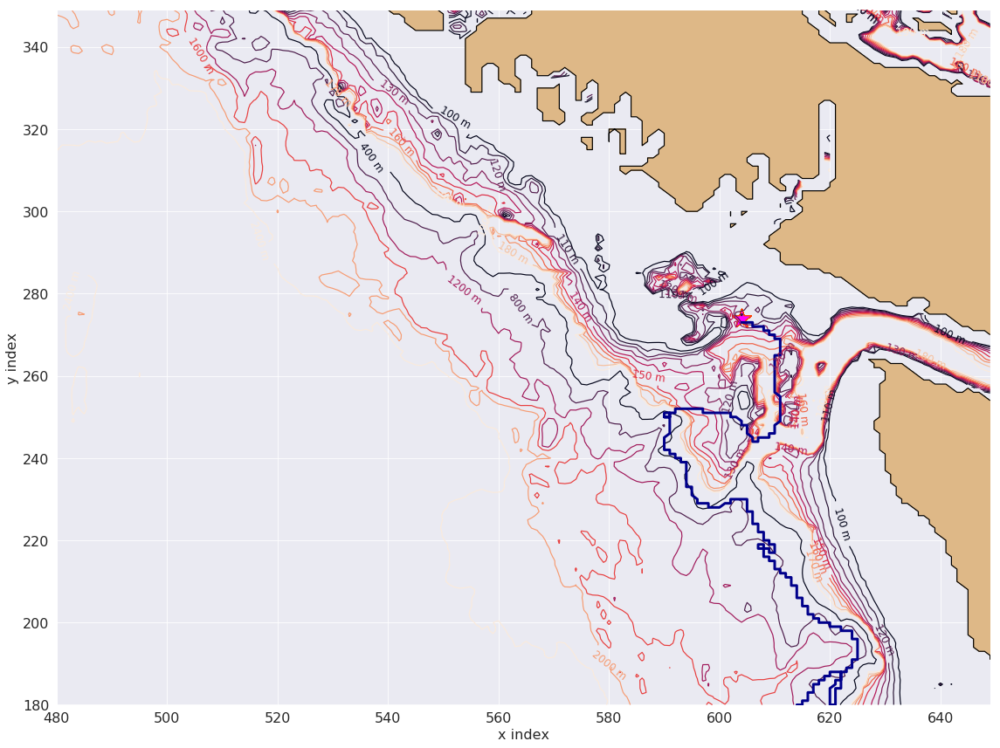

In [36]:
plot_particle_track_line(particle_ind=cuc_ind[178].astype(int))

/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


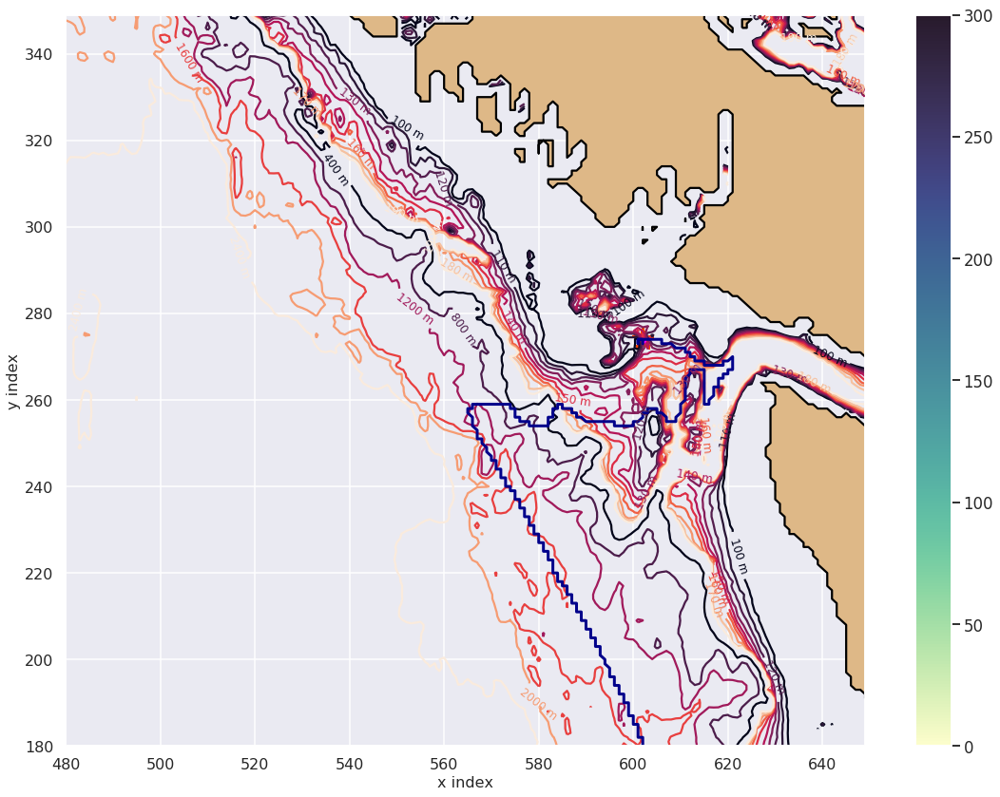

In [88]:
plot_particle_track_line(particle_ind=cuc_ind[226].astype(int))

/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


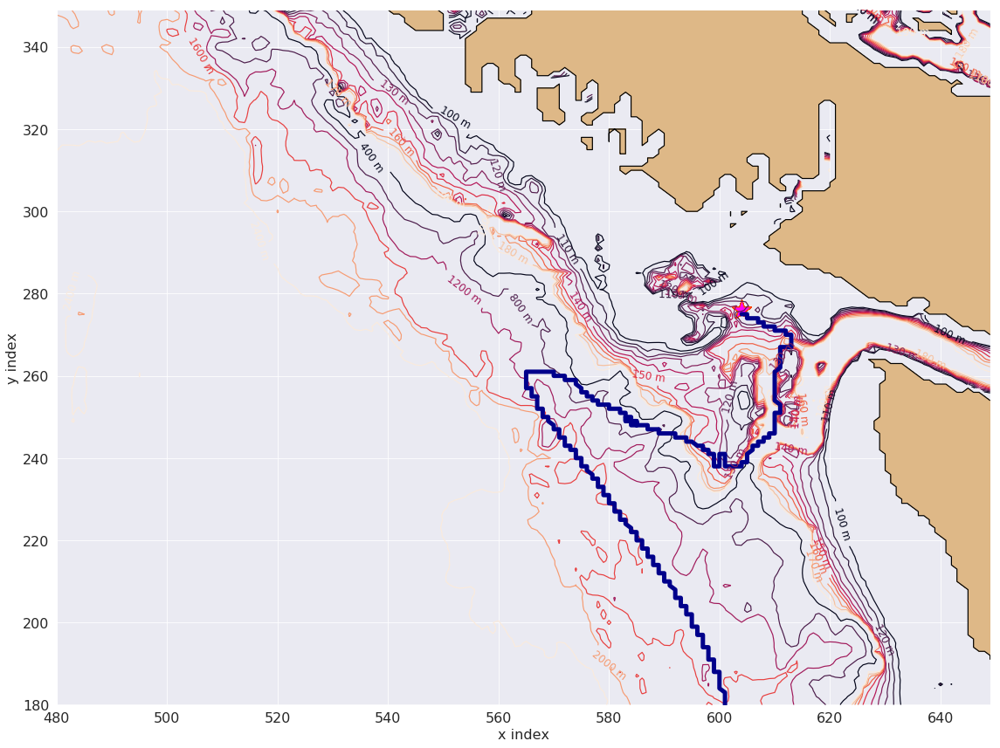

In [263]:
plot_particle_track_line(particle_ind=cuc_ind[174].astype(int))

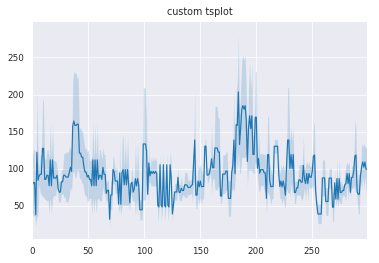

In [35]:
fig, ax2 = plt.subplots()
# ax = sns.tsplot(data=data,ax=ax, ci="sd")


tsplot(ax2, np.multiply(-1,traj_depth[:mydates.shape[0],cuc_ind.astype(int)]))

# ax.set_title("sns.tsplot")
ax2.set_title("custom tsplot")

plt.show()

In [81]:
traj_depth_init_cuc   = traj_depth_init[cuc_ind.astype(int)]
traj_depth_init_south = traj_depth_init[south_ind.astype(int)]
traj_depth_init_local = traj_depth_init[ind_local.astype(int)]


In [80]:
np.max(-traj_depth_init_cuc)

100.62609100341797

In [79]:
np.max(-traj_depth_init_south)

119.71409606933594

In [87]:
np.mean(traj_depth_final_local)

-157.13183199068786

In [42]:
south_ind.shape

(199,)

In [35]:
cuc_percent

26.200000000000003

In [39]:
zlevels[26]

222.47517

In [34]:
south_percent

17.399999999999999

### Doing the same for the south outer shelf water

In [85]:
%matplotlib notebook
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import numpy.ma as ma
import glob
from collections import namedtuple, OrderedDict
import netCDF4 as nc
import os
import scipy
import scipy.io as sio
from scipy import interpolate, signal
from pyproj import Proj,transform
import sys
sys.path.append('/ocean/ssahu/CANYONS/wcvi/grid/')
from bathy_common import *
from matplotlib import path
from salishsea_tools import viz_tools
import xarray as xr
from salishsea_tools import nc_tools
import scipy.io as sio
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.cm as cm
import cmocean as cmo
import matplotlib.gridspec as gridspec
%matplotlib inline
from scipy.io import loadmat
from scipy.interpolate import griddata
from dateutil.parser import parse
from salishsea_tools import geo_tools, viz_tools, tidetools, nc_tools
import gsw
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib.patches import Ellipse
import matplotlib as mpl

import seaborn as sns
from windrose import plot_windrose
from windrose import WindroseAxes


from dateutil        import parser
from datetime import datetime

import numpy.ma as ma

sns.set_context('talk')
sns.set_style('darkgrid')


from scipy.interpolate import interpn
from mpl_toolkits.axes_grid1 import make_axes_locatable

In [2]:
zlevels = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/CDF_COMB_COMPRESSED/NEP036-N30_IN_20140915_00001440_grid_T.nc').variables['deptht'][:32]
y_wcvi_slice = np.array(np.arange(180,350))
x_wcvi_slice = np.array(np.arange(480,650))


bathy = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/INV/Bathymetry_EastCoast_NEMO_R036_GEBCO_corr_v14.nc')

Z = bathy.variables['Bathymetry']


lon = bathy['nav_lon'][...]
lat = bathy['nav_lat'][...]



nc_file = nc.Dataset('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/accurate_isopyncal_particle_positions/\
south_outer_shelf_water.nc')
nc_tools.show_variables(nc_file)

odict_keys(['init_x', 'init_y', 'init_z', 'init_t', 'init_age', 'init_transp', 'final_x', 'final_y', 'final_z', 'final_t', 'final_age', 'final_transp', 'traj_lon', 'traj_lat', 'traj_depth', 'traj_time', 'traj_temp', 'traj_salt', 'traj_dens'])


In [3]:


init_x = nc_file.variables['init_x']
init_z = nc_file.variables['init_z']
init_age = nc_file.variables['init_age']

traj_depth = nc_file.variables['traj_depth'][:]
traj_lon   = nc_file.variables['traj_lon'][:]
traj_lat   = nc_file.variables['traj_lat'][:]
traj_rho   = nc_file.variables['traj_dens'][:]
traj_tem   = nc_file.variables['traj_temp'][:]
traj_sal   = nc_file.variables['traj_salt'][:]
traj_time  = nc_file.variables['traj_time']


final_age = nc_file.variables['final_age']


# lon1=nc_file.variables['traj_lon'][:]
# lat1=nc_file.variables['traj_lat'][:]
# dep1=nc_file.variables['traj_depth'][:]
x1=nc_file.variables['init_x'][:]
y1=nc_file.variables['init_y'][:]
t1=nc_file.variables['traj_time'][:]

x_low = x1
y_low = y1

x2=nc_file.variables['final_x'][:]
y2=nc_file.variables['final_y'][:]


final_z = nc_file.variables['final_z'][:]

final_age_days = final_age[:]/(3600)

/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:10: UserWarning: WARNING: missing_value not used since it
cannot be safely cast to variable data type
/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:11: UserWarning: WARNING: missing_value not used since it
cannot be safely cast to variable data type
/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:12: UserWarning: WARNING: missing_value not used since it
cannot be safely cast to variable data type


In [4]:
x_final = []
y_final = []


for i in np.arange(x2.shape[0]):
    x_final = np.append(arr=x_final,values=x_wcvi_slice[np.int(np.rint(x2[i]))-1])
    y_final = np.append(arr=y_final,values=y_wcvi_slice[np.int(np.rint(y2[i]))-1])

In [5]:
x = [510,575]
y = [320,200]


coefficients = np.polyfit(x, y, 1)

x_final_off = np.arange(x[0],x[1])
polynomial = np.poly1d(coefficients)
y_final_off = np.rint(polynomial(x_final_off))

p1= (x[0],y[0])
p1 = np.asarray(p1)
p2 = (x[1], y[1])
p2 = np.asarray(p2)



d = np.empty_like(x_final)

off_ind = []


for r in np.arange(x_final.shape[0]):

    p3 = (x_final[r], y_final[r])
    p3 = np.asarray(p3)
    d[r] =np.cross(p2-p1,p3-p1)/np.linalg.norm(p2-p1)
    
    if ((d[r] < 0) & (x_final[r] < 575)):
        off_ind = np.append(arr=off_ind, values=np.int(r))

In [6]:
num_north = np.round(a=final_age[(x_final < 580) & (y_final > 300)].shape[0]/final_z.shape[0], decimals=3)

north_percent = 100*num_north

print(north_percent)

num_cuc = np.round(a=np.where(final_z[((x_final < 630) & (y_final < 200)) & \
                                      ((x_final > 580) & (y_final < 200))]>26.3)[0].shape[0]/final_z.shape[0], decimals = 3)

cuc_percent = 100*num_cuc

print(cuc_percent)

num_south = np.round(a=np.where(final_z[((x_final < 630) & (y_final < 200)) & \
                                      ((x_final > 580) & (y_final < 200))]<=26.3)[0].shape[0]/final_z.shape[0], decimals = 3)

south_percent = 100*num_south

print(south_percent)

### Bigger box
x = [510,575]
y = [320,200]


coefficients = np.polyfit(x, y, 1)

x_final_off = np.arange(x[0],x[1])
polynomial = np.poly1d(coefficients)
y_final_off = np.rint(polynomial(x_final_off))

num_off = off_ind.shape[0]/final_z.shape[0]
off_percent = np.round(a=100*num_off, decimals=1)

print(off_percent)

num_juan = np.round(a=np.where((x_final > 648))[0].shape[0]/final_z.shape[0], decimals=3)

juan_percent = num_juan*100

print(juan_percent)

10.5
20.1
24.5
18.7
3.0


In [7]:
cuc_percent_high = cuc_percent
juan_percent_high = juan_percent
north_percent_high = north_percent
south_percent_high = south_percent
off_percent_high = off_percent



In [8]:
traj_tem_last   = np.empty_like(final_age_days)
traj_sal_last   = np.empty_like(final_age_days)
traj_rho_last   = np.empty_like(final_age_days)
traj_depth_last = np.empty_like(final_age_days)


traj_tem_init   = np.empty_like(final_age_days)
traj_sal_init   = np.empty_like(final_age_days)
traj_rho_init   = np.empty_like(final_age_days)
traj_depth_init = np.empty_like(final_age_days)

for r in np.arange(traj_tem_last.shape[0]):
    traj_tem_last[r]  =  traj_tem[np.int(final_age_days[r]),r]
    traj_sal_last[r]  =  traj_sal[np.int(final_age_days[r]),r]
    traj_rho_last[r]  =  traj_rho[np.int(final_age_days[r]),r]
    traj_depth_last[r] = traj_depth[np.int(final_age_days[r]),r]
    
    traj_tem_init[r]  =  traj_tem[0,r]
    traj_sal_init[r]  =  traj_sal[0,r]
    traj_rho_init[r]  =  traj_rho[0,r]    
    traj_depth_init[r]=  traj_depth[0,r] 
    

In [9]:
max_life_ind = np.array(np.where(final_age_days == np.max(final_age_days))[0])

off_ind   = off_ind
north_ind = np.where([(x_final < 580) & (y_final > 300)])[1]
north_ind = north_ind[np.where(x_final[north_ind].astype(int) > 500)]
south_ind = []
cuc_ind   = []


ind_all_south  = np.where(((x_final < 630) & (y_final < 200)) & \
                                      ((x_final > 580) & (y_final < 200)))[0]

for k in ind_all_south:
    if final_z[k] <= 26.3:
        south_ind = np.append(arr=south_ind, values= k)
        
    if final_z[k] > 26.3:
        cuc_ind = np.append(arr=cuc_ind, values=k)
        

juan_ind =  np.where((x_final > 648))[0]

non_local_ind = np.concatenate((off_ind, north_ind, south_ind, cuc_ind, juan_ind))

ind_local = np.setdiff1d(max_life_ind, np.unique(non_local_ind, return_index= False).astype(int), assume_unique=True)

# off_ind/

# ind_local = np.setdiff1d(max_life_ind, off_ind, assume_unique= True)

x_local_low_actual = x2[ind_local]
y_local_low_actual = y2[ind_local]

depth_local_low_actual = -traj_depth_last[ind_local]


In [10]:
count_ind = np.concatenate((ind_local, np.unique(non_local_ind, return_index= False).astype(int)))

count_ind.shape[0]/final_z.shape[0]

0.9889807162534435

In [11]:

ind_local.shape[0]/final_z.shape[0]

0.26170798898071623

In [12]:

traj_tem_final_cuc = traj_tem_last[cuc_ind.astype(int)]
traj_sal_final_cuc = traj_sal_last[cuc_ind.astype(int)]
traj_rho_final_cuc = traj_rho_last[cuc_ind.astype(int)]
traj_depth_final_cuc = traj_depth_last[cuc_ind.astype(int)]
traj_days_final_cuc = final_age_days[cuc_ind.astype(int)]/24



traj_tem_final_north = traj_tem_last[north_ind.astype(int)]
traj_sal_final_north = traj_sal_last[north_ind.astype(int)]
traj_rho_final_north = traj_rho_last[north_ind.astype(int)]
traj_depth_final_north = traj_depth_last[north_ind.astype(int)]
traj_days_final_north = final_age_days[north_ind.astype(int)]/24



traj_tem_final_south   = traj_tem_last[south_ind.astype(int)]
traj_sal_final_south   = traj_sal_last[south_ind.astype(int)]
traj_rho_final_south   = traj_rho_last[south_ind.astype(int)]
traj_depth_final_south = traj_depth_last[south_ind.astype(int)]
traj_days_final_south  = final_age_days[south_ind.astype(int)]/24


traj_tem_final_juan = traj_tem_last[juan_ind.astype(int)]
traj_sal_final_juan = traj_sal_last[juan_ind.astype(int)]
traj_rho_final_juan = traj_rho_last[juan_ind.astype(int)]
traj_depth_final_juan = traj_depth_last[juan_ind.astype(int)]
traj_days_final_juan = final_age_days[juan_ind.astype(int)]/24


traj_tem_final_local = traj_tem_last[ind_local.astype(int)]
traj_sal_final_local = traj_sal_last[ind_local.astype(int)]
traj_rho_final_local = traj_rho_last[ind_local.astype(int)]
traj_depth_final_local = traj_depth_last[ind_local.astype(int)]
traj_days_final_local = final_age_days[ind_local.astype(int)]/24




x = [510,575]
y = [320,200]

coefficients = np.polyfit(x, y, 1)
x_final_off = np.arange(x[0],x[1])
polynomial = np.poly1d(coefficients)
y_final_off = np.rint(polynomial(x_final_off))

traj_tem_final_off = []
traj_sal_final_off = []
traj_rho_final_off = []
traj_depth_final_off = []
traj_days_final_off = []

for l in np.arange(off_ind.shape[0]):

    traj_depth_final_off = np.append(arr=traj_depth_final_off, values=traj_depth_last[np.int(off_ind[l])])
    traj_days_final_off = np.append(arr=traj_days_final_off, values=final_age_days[np.int(off_ind[l])]/24)
    traj_rho_final_off   = np.append(arr=traj_rho_final_off, values=traj_rho_last[np.int(off_ind[l])])
    traj_tem_final_off   = np.append(arr=traj_tem_final_off, values=traj_tem_last[np.int(off_ind[l])])
    traj_sal_final_off   = np.append(arr=traj_sal_final_off, values=traj_sal_last[np.int(off_ind[l])])


In [86]:
pressure_loc_cuc = np.empty_like(traj_depth_final_cuc)
SA_loc_cuc       = np.empty_like(traj_depth_final_cuc)
CT_loc_cuc       = np.empty_like(traj_depth_final_cuc)
spic_loc_cuc     = np.empty_like(traj_depth_final_cuc)



for i in np.arange(traj_depth_final_cuc.shape[0]):
    
    pressure_loc_cuc[i] = gsw.p_from_z(traj_depth_final_cuc[i],np.mean(traj_lat))
    
    SA_loc_cuc[i] = gsw.SA_from_SP(traj_sal_final_cuc[i], pressure_loc_cuc[i], np.mean(traj_lon), np.mean(traj_lat))
    
    CT_loc_cuc[i] = gsw.CT_from_pt(traj_sal_final_cuc[i], traj_tem_final_cuc[i])
    
    spic_loc_cuc[i] = gsw.spiciness0(SA_loc_cuc[i], CT_loc_cuc[i])
    
pressure_loc_off = np.empty_like(traj_depth_final_off)
SA_loc_off       = np.empty_like(traj_depth_final_off)
CT_loc_off       = np.empty_like(traj_depth_final_off)
spic_loc_off     = np.empty_like(traj_depth_final_off)



for i in np.arange(traj_depth_final_off.shape[0]):
    
    pressure_loc_off[i] = gsw.p_from_z(traj_depth_final_off[i],np.mean(traj_lat))
    
    SA_loc_off[i] = gsw.SA_from_SP(traj_sal_final_off[i], pressure_loc_off[i], np.mean(traj_lon), np.mean(traj_lat))
    
    CT_loc_off[i] = gsw.CT_from_pt(traj_sal_final_off[i], traj_tem_final_off[i])
    
    spic_loc_off[i] = gsw.spiciness0(SA_loc_off[i], CT_loc_off[i])
    
pressure_loc_south = np.empty_like(traj_depth_final_south)
SA_loc_south       = np.empty_like(traj_depth_final_south)
CT_loc_south       = np.empty_like(traj_depth_final_south)
spic_loc_south     = np.empty_like(traj_depth_final_south)



for i in np.arange(traj_depth_final_south.shape[0]):
    
    pressure_loc_south[i] = gsw.p_from_z(traj_depth_final_south[i],np.mean(traj_lat))
    
    SA_loc_south[i] = gsw.SA_from_SP(traj_sal_final_south[i], pressure_loc_south[i], np.mean(traj_lon), np.mean(traj_lat))
    
    CT_loc_south[i] = gsw.CT_from_pt(traj_sal_final_south[i], traj_tem_final_south[i])
    
    spic_loc_south[i] = gsw.spiciness0(SA_loc_south[i], CT_loc_south[i])
    
pressure_loc_north= np.empty_like(traj_depth_final_north)
SA_loc_north       = np.empty_like(traj_depth_final_north)
CT_loc_north       = np.empty_like(traj_depth_final_north)
spic_loc_north     = np.empty_like(traj_depth_final_north)



for i in np.arange(traj_depth_final_north.shape[0]):
    
    pressure_loc_north[i] = gsw.p_from_z(traj_depth_final_north[i],np.mean(traj_lat))
    
    SA_loc_north[i] = gsw.SA_from_SP(traj_sal_final_north[i], pressure_loc_north[i], np.mean(traj_lon), np.mean(traj_lat))
    
    CT_loc_north[i] = gsw.CT_from_pt(traj_sal_final_north[i], traj_tem_final_north[i])
    
    spic_loc_north[i] = gsw.spiciness0(SA_loc_north[i], CT_loc_north[i])
    

pressure_loc_juan= np.empty_like(traj_depth_final_juan)
SA_loc_juan       = np.empty_like(traj_depth_final_juan)
CT_loc_juan       = np.empty_like(traj_depth_final_juan)
spic_loc_juan     = np.empty_like(traj_depth_final_juan)



for i in np.arange(traj_depth_final_juan.shape[0]):
    
    pressure_loc_juan[i] = gsw.p_from_z(traj_depth_final_juan[i],np.mean(traj_lat))
    
    SA_loc_juan[i] = gsw.SA_from_SP(traj_sal_final_juan[i], pressure_loc_juan[i], np.mean(traj_lon), np.mean(traj_lat))
    
    CT_loc_juan[i] = gsw.CT_from_pt(traj_sal_final_juan[i], traj_tem_final_juan[i])
    
    spic_loc_juan[i] = gsw.spiciness0(SA_loc_juan[i], CT_loc_juan[i])
    

In [87]:

pressure_loc_init = np.empty_like(traj_tem_init)
SA_loc_init       = np.empty_like(traj_depth_init)
CT_loc_init       = np.empty_like(traj_depth_init)
spic_loc_init     = np.empty_like(traj_depth_init)



for i in np.arange(traj_depth_init.shape[0]):
    
    pressure_loc_init[i] = gsw.p_from_z(traj_depth_init[i],np.mean(traj_lat))
    
    SA_loc_init[i] = gsw.SA_from_SP(traj_sal_init[i], pressure_loc_init[i], np.mean(traj_lon), np.mean(traj_lat))
    
    CT_loc_init[i] = gsw.CT_from_pt(traj_sal_init[i], traj_tem_init[i])
    
    spic_loc_init[i] = gsw.spiciness0(SA_loc_init[i], CT_loc_init[i])
    
    
pressure_loc_local = np.empty_like(traj_depth_final_local)
SA_loc_local       = np.empty_like(traj_depth_final_local)
CT_loc_local       = np.empty_like(traj_depth_final_local)
spic_loc_local     = np.empty_like(traj_depth_final_local)



for i in np.arange(traj_depth_final_local.shape[0]):
    
    pressure_loc_local[i] = gsw.p_from_z(traj_depth_final_local[i],np.mean(traj_lat))
    
    SA_loc_local[i] = gsw.SA_from_SP(traj_sal_final_local[i], pressure_loc_local[i], np.mean(traj_lon), np.mean(traj_lat))
    
    CT_loc_local[i] = gsw.CT_from_pt(traj_sal_final_local[i], traj_tem_final_local[i])
    
    spic_loc_local[i] = gsw.spiciness0(SA_loc_local[i], CT_loc_local[i])    
    

In [13]:
spic_loc_local = spic_loc_local[spic_loc_local>-2]
spic_loc_init = spic_loc_init[spic_loc_init>-2]


NameError: name 'spic_loc_local' is not defined

In [98]:
##For Spice


spic_cuc   = np.mean(spic_loc_cuc)
spic_south = np.mean(spic_loc_south)
spic_off   = np.mean(spic_loc_off)
spic_north = np.mean(spic_loc_north)
spic_juan  = np.mean(spic_loc_juan)
spic_local = np.mean(spic_loc_local)

spic_cuc_std   = np.std(spic_loc_cuc)
spic_south_std = np.std(spic_loc_south)
spic_off_std   = np.std(spic_loc_off)
spic_north_std = np.std(spic_loc_north)
spic_juan_std  = np.std(spic_loc_juan)
spic_local_std = np.std(spic_loc_local)

frac_cuc   = cuc_ind.shape[0]/final_z.shape[0]
frac_south = south_ind.shape[0]/final_z.shape[0]
frac_off   = off_ind.shape[0]/final_z.shape[0]
frac_north = north_ind.shape[0]/final_z.shape[0]
frac_juan = juan_ind.shape[0]/final_z.shape[0]
frac_local = (ind_local.shape[0]/final_z.shape[0])

# spic_mixed = spic_cuc*frac_cuc + spic_south*frac_south + spic_off*frac_off + spic_juan*frac_juan + spic_north*frac_north + \
#      spic_local*frac_local

spic_mixed = spic_cuc*frac_cuc + spic_south*frac_south + spic_local*frac_local
    
print(spic_mixed)

# err_mixing_spic = np.sqrt((spic_cuc_std*frac_cuc)**2 + (spic_south_std*frac_south)**2 + (spic_off_std*frac_off)**2 + (spic_juan_std*frac_juan)**2 + \
#               (spic_north_std*frac_north)**2 + (spic_local_std*frac_local)**2)

err_mixing_spic = np.sqrt((spic_cuc_std*frac_cuc)**2 + (spic_south_std*frac_south)**2 + (spic_local_std*frac_local)**2)

print(err_mixing_spic)

print(np.mean(spic_loc_init))

-0.0551390909457
0.0743615528399
-0.0743875844361


In [103]:
##For Spice


T_cuc   = np.mean(traj_tem_final_cuc)
T_south = np.mean(traj_tem_final_south)
T_off   = np.mean(traj_tem_final_off)
T_north = np.mean(traj_tem_final_north)
T_juan  = np.mean(traj_tem_final_juan)
T_local = np.mean(traj_tem_final_local)

T_cuc_std   = np.std(traj_tem_final_cuc)
T_south_std = np.std(traj_tem_final_south)
T_off_std   = np.std(traj_tem_final_off)
T_north_std = np.std(traj_tem_final_north)
T_juan_std  = np.std(traj_tem_final_juan)
T_local_std = np.std(traj_tem_final_local)

frac_cuc   = cuc_percent_high/100
frac_south = south_percent_high/100
frac_off   = off_percent_high/100
frac_north = north_percent_high/100
frac_juan = juan_percent_high/100
frac_local = (ind_local.shape[0]/final_z.shape[0])

# T_mixed = T_cuc*frac_cuc + T_south*frac_south + T_local*frac_local
T_mixed = T_cuc*frac_cuc + T_south*frac_south + T_off*frac_off + T_juan*frac_juan + T_north*frac_north + \
     T_local*frac_local
    
print(T_mixed)

err_mixing_T = np.sqrt((T_cuc_std*frac_cuc)**2 + (T_south_std*frac_south)**2 + (T_off_std*frac_off)**2 + (T_juan_std*frac_juan)**2 + \
              (T_north_std*frac_north)**2 + (T_local_std*frac_local)**2)

# err_mixing_T = np.sqrt((T_cuc_std*frac_cuc)**2 + (T_south_std*frac_south)**2 + (T_local_std*frac_local)**2)

print(err_mixing_T)

print(np.mean(traj_tem_init))

7.66560024237
0.264475425639
7.65580898474


In [42]:
Sal_cuc

33.956143888708667

In [44]:
Sal_south

33.611745555749103

In [45]:
Sal_off

33.141226123361029

In [46]:
Sal_north

33.086634937085606

In [47]:
Sal_juan

31.824839505282316

In [49]:
Sal_local

33.790708963494552

In [105]:
frac_cuc + frac_south + frac_local + frac_off + frac_north + frac_juan

0.9889807162534434

In [53]:
frac_cuc

0.20100000000000001

In [54]:
cuc_ind.shape[0]/final_z.shape[0]

0.20110192837465565

In [118]:
##For Spice


Sal_cuc   = np.mean(traj_sal_final_cuc)
Sal_south = np.mean(traj_sal_final_south)
Sal_off   = np.mean(traj_sal_final_off)
Sal_north = np.mean(traj_sal_final_north)
Sal_juan  = np.mean(traj_sal_final_juan)
Sal_local = np.mean(traj_sal_final_local)

Sal_cuc_std   = np.std(traj_sal_final_cuc)
Sal_south_std = np.std(traj_sal_final_south)
Sal_off_std   = np.std(traj_sal_final_off)
Sal_north_std = np.std(traj_sal_final_north)
Sal_juan_std  = np.std(traj_sal_final_juan)
Sal_local_std = np.std(traj_sal_final_local)

# frac_cuc   = cuc_percent_high/100
# frac_south = south_percent_high/100
# frac_off   = off_percent_high/100
# frac_north = north_percent_high/100
# frac_juan = juan_percent_high/100

frac_cuc   = cuc_ind.shape[0]/final_z.shape[0]
frac_south = south_ind.shape[0]/final_z.shape[0]
frac_off   = off_ind.shape[0]/final_z.shape[0]
frac_north = north_ind.shape[0]/final_z.shape[0]
frac_juan = juan_ind.shape[0]/final_z.shape[0]

frac_local = (ind_local.shape[0]/final_z.shape[0])

# Sal_mixed = Sal_cuc*frac_cuc + Sal_south*frac_south+ Sal_local*frac_local
Sal_mixed = Sal_cuc*frac_cuc + Sal_south*frac_south*1.07 + Sal_off*frac_off + Sal_juan*frac_juan + Sal_north*frac_north + \
     Sal_local*frac_local
    
print(Sal_mixed)

err_mixing_Sal = np.sqrt((Sal_cuc_std*frac_cuc)**2 + (Sal_south_std*frac_south)**2 + (Sal_off_std*frac_off)**2 + (Sal_juan_std*frac_juan)**2 + \
              (Sal_north_std*frac_north)**2 + (Sal_local_std*frac_local)**2)

# err_mixing_Sal = np.sqrt((Sal_cuc_std*frac_cuc)**2 + (Sal_south_std*frac_south)**2 + (Sal_local_std*frac_local)**2)

print(err_mixing_Sal)

print(np.mean(traj_sal_init))

33.7792346531
0.166357783129
33.7009049513


In [120]:
##For Density


Rho_cuc   = np.mean(traj_rho_final_cuc)
Rho_south = np.mean(traj_rho_final_south)
Rho_off   = np.mean(traj_rho_final_off)
Rho_north = np.mean(traj_rho_final_north)
Rho_juan  = np.mean(traj_rho_final_juan)
Rho_local = np.mean(traj_rho_final_local)

Rho_cuc_std   = np.std(traj_rho_final_cuc)
Rho_south_std = np.std(traj_rho_final_south)
Rho_off_std   = np.std(traj_rho_final_off)
Rho_north_std = np.std(traj_rho_final_north)
Rho_juan_std  = np.std(traj_rho_final_juan)
Rho_local_std = np.std(traj_rho_final_local)

frac_cuc   = cuc_percent_high/100
frac_south = south_percent_high/100
frac_off   = off_percent_high/100
frac_north = north_percent_high/100
frac_juan = juan_percent_high/100
frac_local = (ind_local.shape[0]/final_z.shape[0])

# Rho_mixed = Rho_cuc*frac_cuc + Rho_south*frac_south + Rho_local*frac_local
Rho_mixed = Rho_cuc*frac_cuc + Rho_south*frac_south*0.9 + Rho_off*frac_off + Rho_juan*frac_juan + Rho_north*frac_north + \
     Rho_local*frac_local
    
print(Rho_mixed)

err_mixing_Rho = np.sqrt((Rho_cuc_std*frac_cuc)**2 + (Rho_south_std*frac_south)**2 + (Rho_off_std*frac_off)**2 + (Rho_juan_std*frac_juan)**2 + \
              (Rho_north_std*frac_north)**2 + (Rho_local_std*frac_local)**2)

# err_mixing_Rho = np.sqrt((Rho_cuc_std*frac_cuc)**2 + (Rho_south_std*frac_south)**2 + (Rho_local_std*frac_local)**2)

print(err_mixing_Rho)

print(np.mean(traj_rho_init))

26.362719376
0.162396963986
26.3038084014


In [112]:
def calculate_kde(variable):
    
    
    if variable == 'Temperature':
        

        
        kde_cuc = scipy.stats.gaussian_kde(traj_tem_final_cuc)
        kde_south = scipy.stats.gaussian_kde(traj_tem_final_south)
        kde_local = scipy.stats.gaussian_kde(traj_tem_final_local)
        kde_juan  = scipy.stats.gaussian_kde(traj_tem_final_juan)
        kde_north = scipy.stats.gaussian_kde(traj_tem_final_north)
        kde_off = scipy.stats.gaussian_kde(traj_tem_final_off)

        kde_init  = scipy.stats.gaussian_kde(traj_tem_init)
        
        
        mu = T_mixed
        sigma = err_mixing_T
        #grid = np.linspace(-0.3,0.2,500)
#         grid = np.linspace(mu - 6*sigma, mu + 6*sigma, 100)        
        grid = np.linspace(5,10, 10000) 

        #weighted kde curves
        w_cuc   = kde_cuc(grid)*(cuc_percent/100)
        w_south = kde_south(grid)*(south_percent/100)
        w_local = kde_local(grid)*(ind_local.shape[0]/final_z.shape[0])
        w_north = kde_north(grid)*(north_percent/100)
        w_juan = kde_juan(grid)*(juan_percent/100)
        w_off = kde_off(grid)*(off_percent/100)
        w_init = kde_init(grid)
        
        return w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma
    
        
    if variable == 'Salinity':
        

        
        kde_cuc = scipy.stats.gaussian_kde(traj_sal_final_cuc, bw_method=-1)
        kde_south = scipy.stats.gaussian_kde(traj_sal_final_south)
        kde_local = scipy.stats.gaussian_kde(traj_sal_final_local)
        kde_juan  = scipy.stats.gaussian_kde(traj_sal_final_juan)
        kde_north = scipy.stats.gaussian_kde(traj_sal_final_north)
        kde_off = scipy.stats.gaussian_kde(traj_sal_final_off)

        kde_init  = scipy.stats.gaussian_kde(traj_sal_init)
        
        
        mu = Sal_mixed
        sigma = err_mixing_Sal
        #grid = np.linspace(-0.3,0.2,500)
#         grid = np.linspace(33, mu + 3*sigma, 100)  
        grid = np.linspace(31, 34.5, 10000) 
        

        #weighted kde curves
        w_cuc   = kde_cuc(grid)*(cuc_percent/100)
        w_south = kde_south(grid)*(south_percent/100)
        w_local = kde_local(grid)*(ind_local.shape[0]/final_z.shape[0])
        w_north = kde_north(grid)*(north_percent/100)
        w_juan = kde_juan(grid)*(juan_percent/100)
        w_off = kde_off(grid)*(off_percent/100)
        w_init = kde_init(grid)
        
        return w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma
    
    if variable == 'Density':
        

        
        kde_cuc = scipy.stats.gaussian_kde(traj_rho_final_cuc, bw_method=-1)
        kde_south = scipy.stats.gaussian_kde(traj_rho_final_south)
        kde_local = scipy.stats.gaussian_kde(traj_rho_final_local)
        kde_juan  = scipy.stats.gaussian_kde(traj_rho_final_juan)
        kde_north = scipy.stats.gaussian_kde(traj_rho_final_north)
        kde_off = scipy.stats.gaussian_kde(traj_rho_final_off)

        kde_init  = scipy.stats.gaussian_kde(traj_rho_init)
        
        
        mu = Rho_mixed
        sigma = err_mixing_Rho
        #grid = np.linspace(-0.3,0.2,500)
#         grid = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)    
        grid = np.linspace(23,28, 10000) 
        

        #weighted kde curves
        w_cuc   = kde_cuc(grid)*(cuc_percent/100)
        w_south = kde_south(grid)*(south_percent/100)
        w_local = kde_local(grid)*(ind_local.shape[0]/final_z.shape[0])
        w_north = kde_north(grid)*(north_percent/100)
        w_juan = kde_juan(grid)*(juan_percent/100)
        w_off = kde_off(grid)*(off_percent/100)
        w_init = kde_init(grid)
        
        return w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma
     
    
    
    if variable == 'Spice':
        

        
        kde_cuc = scipy.stats.gaussian_kde(spic_loc_cuc, bw_method=-1)
        kde_south = scipy.stats.gaussian_kde(spic_loc_south)
        kde_local = scipy.stats.gaussian_kde(spic_loc_local)
        kde_juan  = scipy.stats.gaussian_kde(spic_loc_juan)
        kde_north = scipy.stats.gaussian_kde(spic_loc_north)
        kde_off = scipy.stats.gaussian_kde(spic_loc_off)

        kde_init  = scipy.stats.gaussian_kde(spic_loc_init)
        
        
        mu = spic_mixed
        sigma = err_mixing_spic
        #grid = np.linspace(-0.3,0.2,500)
#         grid = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)  
        grid = np.linspace(-2,2, 10000)   

#         grid = np.linspace(5,10, 10000)    
        

        #weighted kde curves
        w_cuc   = kde_cuc(grid)*(cuc_percent/100)
        w_south = kde_south(grid)*(south_percent/100)
        w_local = kde_local(grid)*(ind_local.shape[0]/final_z.shape[0])
        w_north = kde_north(grid)*(north_percent/100)
        w_juan = kde_juan(grid)*(juan_percent/100)
        w_off = kde_off(grid)*(off_percent/100)
        w_init = kde_init(grid)
        
        return w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma
    
    
    if variable == 'Depth':
        

        
        kde_cuc = scipy.stats.gaussian_kde(-traj_depth_final_cuc)
        kde_south = scipy.stats.gaussian_kde(-traj_depth_final_south)
        kde_local = scipy.stats.gaussian_kde(-traj_depth_final_local)
        kde_juan  = scipy.stats.gaussian_kde(-traj_depth_final_juan)
        kde_north = scipy.stats.gaussian_kde(-traj_depth_final_north)
        kde_off = scipy.stats.gaussian_kde(-traj_depth_final_off)

        kde_init  = scipy.stats.gaussian_kde(-traj_depth_init)
        
        
 
        #grid = np.linspace(-0.3,0.2,500)
#         grid = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)  
        grid = np.linspace(0,500, 10000)   

#         grid = np.linspace(5,10, 10000)    
        

        #weighted kde curves
        w_cuc   = kde_cuc(grid)*(cuc_percent/100)
        w_south = kde_south(grid)*(south_percent/100)
        w_local = kde_local(grid)*(ind_local.shape[0]/final_z.shape[0])
        w_north = kde_north(grid)*(north_percent/100)
        w_juan = kde_juan(grid)*(juan_percent/100)
        w_off = kde_off(grid)*(off_percent/100)
        w_init = kde_init(grid)
        
        return w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid
    
    
    if variable == 'Days':
        

        
        kde_cuc = scipy.stats.gaussian_kde(traj_days_final_cuc)
        kde_south = scipy.stats.gaussian_kde(traj_days_final_south)
#         kde_local = scipy.stats.gaussian_kde(traj_days_final_local)
        kde_juan  = scipy.stats.gaussian_kde(traj_days_final_juan)
        kde_north = scipy.stats.gaussian_kde(traj_days_final_north)
        kde_off = scipy.stats.gaussian_kde(traj_days_final_off)


        
        
 
        #grid = np.linspace(-0.3,0.2,500)
#         grid = np.linspace(mu - 3*sigma, mu + 3*sigma, 100)  
        grid = np.linspace(0,130, 10000)   

#         grid = np.linspace(5,10, 10000)    
        

        #weighted kde curves
        w_cuc   = kde_cuc(grid)*(cuc_percent/100)
        w_south = kde_south(grid)*(south_percent/100)
#         w_local = kde_local(grid)*(ind_local.shape[0]/final_z.shape[0])
        w_north = kde_north(grid)*(north_percent/100)
        w_juan = kde_juan(grid)*(juan_percent/100)
        w_off = kde_off(grid)*(off_percent/100)
#         w_init = kde_init(grid)
        
        return w_cuc, w_south, w_north, w_juan, w_off,  grid
        
        
        
        
        

        
        

In [113]:
sns.set_context('paper')
sns.set_style('dark')

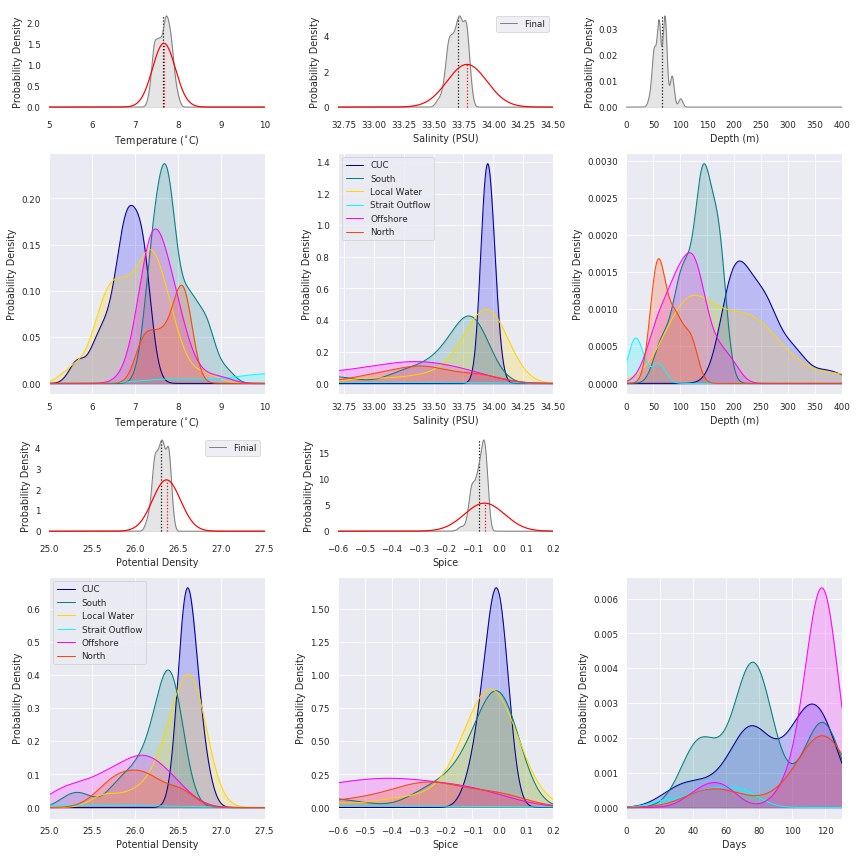

In [121]:
fig = plt.figure(figsize=(12,12))

# fig = plt.figure(figsize=(13,8))

gs2 = gridspec.GridSpec(6, 3)
# gs2.update(left=0.55, right=0.98, hspace=0.05)

# gs2.update(wspace=0.025, hspace=0.05)


ax1 = plt.subplot(gs2[1:3, 0])
ax1_marg = plt.subplot(gs2[0, 0], sharex=ax1, frameon = False)

ax2 = plt.subplot(gs2[4:, 0])
ax2_marg = plt.subplot(gs2[3, 0], sharex=ax2, frameon = False)



ax3 = plt.subplot(gs2[1:3, 1])
ax3_marg = plt.subplot(gs2[0, 1], sharex=ax3, frameon = False)

ax4 = plt.subplot(gs2[4:, 1])
ax4_marg = plt.subplot(gs2[3, 1], sharex=ax4, frameon = False)


ax5 = plt.subplot(gs2[1:3, 2])
ax5_marg = plt.subplot(gs2[0, 2], sharex=ax5, frameon = False)

ax6 = plt.subplot(gs2[4:, 2])
# ax6_marg = plt.subplot(gs2[3, 2], sharex=ax6, frameon = False)


#Temperature
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Temperature')


ax1.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax1.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax1.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax1.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax1.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax1.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax1.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax1.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax1.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax1.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax1.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax1.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax1_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Final")
ax1_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax1_marg.vlines(x=np.mean(traj_tem_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

ax1_marg.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax1_marg.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')
# fig.subplots_adjust(hspace=0)

ax1.set_xlim(5,10)
ax1.set_xlabel('Temperature ($^{\circ}$C)')
ax1.set_ylabel('Probability Density')
# ax1.legend(loc= 'best')

ax1_marg.set_xlim(5,10)
ax1_marg.set_xlabel('Temperature ($^{\circ}$C)')
ax1_marg.set_ylabel('Probability Density')
# ax1_marg.legend(loc= 'best')
# ax1.get_legend().remove()
ax1.grid()


#Salinity
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Salinity')


ax3.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax3.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax3.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax3.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax3.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax3.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax3.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax3.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax3.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax3.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax3.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax3.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax3_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Final")
ax3_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax3_marg.vlines(x=np.mean(traj_sal_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

ax3_marg.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax3_marg.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')
# fig.subplots_adjust(hspace=0)

ax3.set_xlim(32.7,34.5)
ax3.set_xlabel('Salinity (PSU)')
ax3.set_ylabel('Probability Density')
# ax3.get_legend().remove()

ax3_marg.set_xlim(32.7,34.5)
ax3_marg.set_xlabel('Salinity (PSU)')
ax3_marg.set_ylabel('Probability Density')
# ax3_marg.get_legend().remove()
ax3.grid()


#Density
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Density')


ax2.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax2.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax2.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax2.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax2.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax2.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax2.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax2.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax2.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax2.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax2.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax2.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax2_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Finial")
ax2_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax2_marg.vlines(x=np.mean(traj_rho_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

ax2_marg.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax2_marg.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')
# fig.subplots_adjust(hspace=0)

ax2.set_xlim(25,27.5)
ax2.set_xlabel('Potential Density')
ax2.set_ylabel('Probability Density')
# ax3.get_legend().remove()

ax2_marg.set_xlim(25,27.5)
ax2_marg.set_xlabel('Potential Density')
ax2_marg.set_ylabel('Probability Density')
# ax3_marg.get_legend().remove()
ax2.grid()

#Spice
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid, mu, sigma = calculate_kde(variable='Spice')


ax4.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax4.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax4.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax4.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax4.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax4.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax4.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax4.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax4.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax4.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax4.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax4.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax4_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Final")
ax4_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax4_marg.vlines(x=np.mean(spic_loc_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')

ax4_marg.plot(grid, scipy.stats.norm.pdf(grid, mu, sigma), 'red')
ax4_marg.vlines(x=mu, color = 'red', ymax=np.max(scipy.stats.norm.pdf(grid, mu, sigma)), ymin= 0, linestyles='dotted')
# fig.subplots_adjust(hspace=0)

ax4.set_xlim(-0.6,0.2)
ax4.set_xlabel('Spice')
ax4.set_ylabel('Probability Density')
# ax3.get_legend().remove()

ax4_marg.set_xlim(-0.6,0.2)
ax4_marg.set_xlabel('Spice')
ax4_marg.set_ylabel('Probability Density')
# ax3_marg.get_legend().remove()
ax4.grid()



#Depth
w_cuc, w_south, w_local, w_north, w_juan, w_off, w_init, grid = calculate_kde(variable='Depth')


ax5.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax5.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax5.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax5.fill_between(grid, w_south, color = 'teal',alpha = 0.2)

ax5.plot(grid, w_local, lw=1, color = 'gold', label = "Local Water")
ax5.fill_between(grid, w_local, color = 'gold', alpha= 0.2)
# ax.vlines(x=spic_local, color = 'yellow',  ymax=np.max(w_local), ymin = 0, linestyles='dotted')

ax5.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax5.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax5.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax5.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax5.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax5.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)

ax5_marg.plot(grid, w_init, lw=1, color = 'gray', label = "Final")
ax5_marg.fill_between(grid, w_init, color = 'gray', alpha= 0.2)

ax5_marg.vlines(x=np.mean(-traj_depth_init), color = 'k', ymax=np.max(w_init), \
                 ymin= 0, linestyles='dotted')


ax5.set_xlim(0,400)
ax5.set_xlabel('Depth (m)')
ax5.set_ylabel('Probability Density')
# ax3.get_legend().remove()

ax5_marg.set_xlim(0,400)
ax5_marg.set_xlabel('Depth (m)')
ax5_marg.set_ylabel('Probability Density')
# ax3_marg.get_legend().remove()
ax5.grid()

#Days
w_cuc, w_south,  w_north, w_juan, w_off,  grid = calculate_kde(variable='Days')


ax6.plot(grid, w_cuc, lw=1, color = 'darkblue', label = "CUC")
ax6.fill_between(grid, w_cuc, lw=1, color  = 'blue', alpha= 0.2)
# ax.vlines(x=np.mean(spic_loc_cuc), color = 'blue',  ymax=np.max(w_cuc), ymin = 0, linestyles='dotted')

ax6.plot(grid, w_south, lw=1, color = 'teal', label = "South")
ax6.fill_between(grid, w_south, color = 'teal',alpha = 0.2)


ax6.plot(grid, w_juan, lw=1, color = 'cyan', label = "Strait Outflow")
ax6.fill_between(grid, w_juan, color = 'cyan', alpha= 0.2)

ax6.plot(grid, w_off, lw=1, color = 'magenta', label = "Offshore")
ax6.fill_between(grid, w_off, color = 'magenta', alpha= 0.2)

ax6.plot(grid, w_north, lw=1, color = 'orangered', label = "North")
ax6.fill_between(grid, w_north, color = 'orangered', alpha= 0.2)




ax6.set_xlim(0,130)
ax6.set_xlabel('Days')
ax6.set_ylabel('Probability Density')
# ax6.legend(loc = 'best')
# ax3.get_legend().remove()

# ax3_marg.get_legend().remove()
ax6.grid()



ax2.legend(loc = 'best')
ax2_marg.legend(loc = 'best')

ax3.legend(loc = 'best')
ax3_marg.legend(loc = 'best')



gs2.tight_layout(fig=fig,rect=[0, 0, 1, 1], h_pad=0.1)



In [13]:
x_plot_cuc = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/x_cuc_south_outer_points.npy')
y_plot_cuc = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/y_cuc_south_outer_points.npy')

x_plot_south = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/x_south_south_outer_points.npy')
y_plot_south = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/y_south_south_outer_points.npy')

x_plot_local = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/x_local_south_outer_points.npy')
y_plot_local = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/y_local_south_outer_points.npy')

x_plot_off = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/x_off_south_outer_points.npy')
y_plot_off = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/y_off_south_outer_points.npy')

x_plot_north = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/x_north_south_outer_points.npy')
y_plot_north = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/y_north_south_outer_points.npy')

x_plot_juan = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/x_juan_south_outer_points.npy')
y_plot_juan = np.load('/data/ssahu/NEP36_2013_summer_hindcast/Ariane_files/y_juan_south_outer_points.npy')

In [81]:
def density_scatter( x , y, ax = None, sort = True, bins = 20, **kwargs )   :
    """
    Scatter plot colored by 2d histogram
    """
    if ax is None :
        fig , ax = plt.subplots()
    data , x_e, y_e = np.histogram2d( x, y, bins = bins)
    z = interpn( ( 0.5*(x_e[1:] + x_e[:-1]) , 0.5*(y_e[1:]+y_e[:-1]) ) , data , np.vstack([x,y]).T , method = "splinef2d", bounds_error = False )

    # Sort the points by density, so that the densest points are plotted last
    if sort :
        idx = z.argsort()
        x, y, z = x[idx], y[idx], z[idx]

    ax.scatter(x, y, c=z, **kwargs)
    return ax

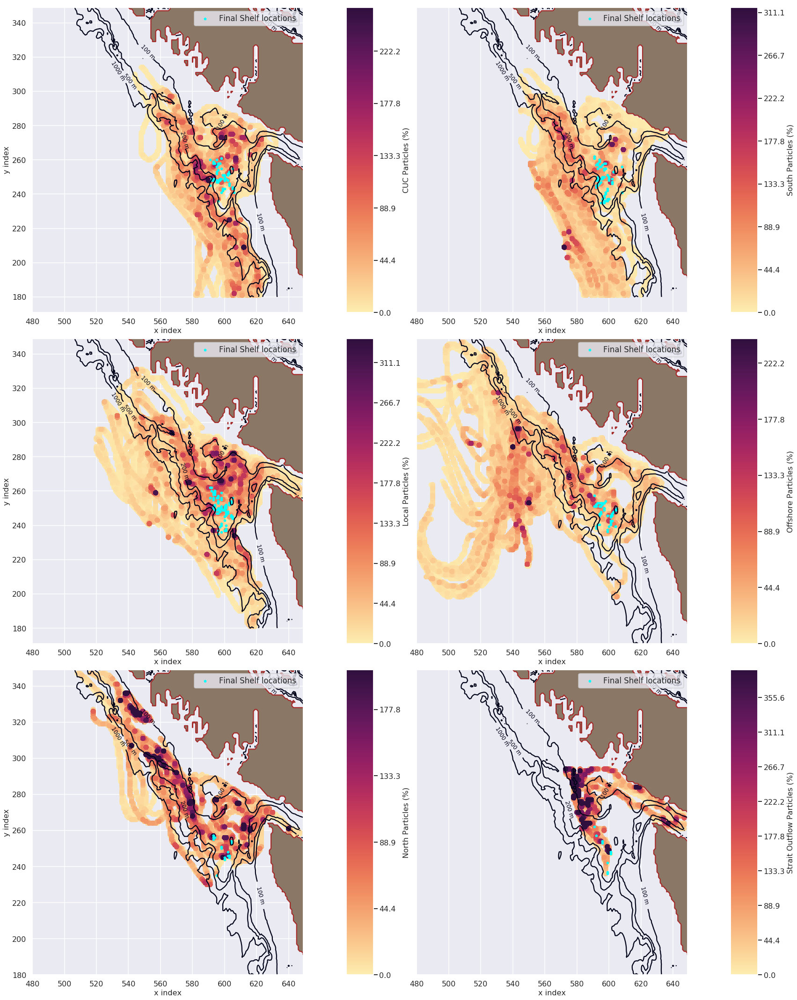

In [18]:
#     cmap=plt.cm.get_cmap('nipy_spectral')
# cmap = plt.cm.get_cmap('Blues_r')
cmap = cmo.cm.matter
cmap.set_bad('#8b7765')




import matplotlib as mpl
    


gridspec = {'width_ratios': [1, 0.1, 1, 0.1]}

fig, (ax, ax1, ax2) = plt.subplots(3, 4, figsize=(24, 30), gridspec_kw=gridspec)


#For CUC 

vmin = 0
vmax = cuc_ind.shape[0]*4

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_cuc, y_plot_cuc, ax= ax[0], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax[0].set_xlabel('x index', fontsize =16)
ax[0].set_ylabel('y index', fontsize = 16)
ax[0].tick_params(axis='both',labelsize =16)

ax[0].scatter(x_wcvi_slice[x1[cuc_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[cuc_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax[0].legend(loc = 'best')

viz_tools.plot_land_mask(ax[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

m = cm.ScalarMappable(cmap=cmap)
m.set_array(q)
m.set_clim(vmin,vmax)

cbar = fig.colorbar(m, cax=ax[1])


cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/cuc_ind.shape[0])*100, \
                                    stop=(cbar.vmax/cuc_ind.shape[0])*100, num=10), decimals = 1))

cbar.set_label(label='CUC Particles (%)', fontsize = 16)
cbar.ax.tick_params(labelsize=16)

#For South Particles

vmin = 0
vmax = south_ind.shape[0]*4

CS1 = ax[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_south, y_plot_south, ax= ax[2], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax[2].set_xlabel('x index', fontsize =16)
# ax[2].set_ylabel('y index', fontsize = 16)
ax[2].tick_params(axis='both',labelsize =16)
ax[2].get_yaxis().set_ticks([])

ax[2].scatter(x_wcvi_slice[x1[south_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[south_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax[2].legend(loc = 'best')

viz_tools.plot_land_mask(ax[2], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax[2], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

m = cm.ScalarMappable(cmap=cmap)
m.set_array(q)
m.set_clim(vmin,vmax)

cbar = fig.colorbar(m, cax=ax[3])


cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/south_ind.shape[0])*100, \
                                    stop=(cbar.vmax/south_ind.shape[0])*100, num=10), decimals = 1))

cbar.set_label(label='South Particles (%)', fontsize = 16)
cbar.ax.tick_params(labelsize=16)


#For local

vmin = 0
vmax = ind_local.shape[0]*4

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_local, y_plot_local, ax= ax1[0], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax1[0].set_xlabel('x index', fontsize =16)
ax1[0].set_ylabel('y index', fontsize = 16)
ax1[0].tick_params(axis='both',labelsize =16)

ax1[0].scatter(x_wcvi_slice[x1[ind_local[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[ind_local[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax1[0].legend(loc = 'best')

viz_tools.plot_land_mask(ax1[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax1[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

m = cm.ScalarMappable(cmap=cmap)
m.set_array(q)
m.set_clim(vmin,vmax)

cbar = fig.colorbar(m, cax=ax1[1])


cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/ind_local.shape[0])*100, \
                                    stop=(cbar.vmax/ind_local.shape[0])*100, num=10), decimals = 1))

cbar.set_label(label='Local Particles (%)', fontsize = 16)
cbar.ax.tick_params(labelsize=16)

#For Offshore Particles

vmin = 0
vmax = off_ind.shape[0]*4

CS1 = ax1[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_off, y_plot_off, ax= ax1[2], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax1[2].set_xlabel('x index', fontsize =16)
# ax1[2].set_ylabel('y index', fontsize = 16)
ax1[2].tick_params(axis='both',labelsize =16)
ax1[2].get_yaxis().set_ticks([])

ax1[2].scatter(x_wcvi_slice[x1[off_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[off_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax1[2].legend(loc = 'best')
ax1[2].set_xlim(left = 480)

viz_tools.plot_land_mask(ax1[2], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax1[2], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

m = cm.ScalarMappable(cmap=cmap)
m.set_array(q)
m.set_clim(vmin,vmax)

cbar = fig.colorbar(m, cax=ax1[3])


cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/off_ind.shape[0])*100, \
                                    stop=(cbar.vmax/off_ind.shape[0])*100, num=10), decimals = 1))

cbar.set_label(label='Offshore Particles (%)', fontsize = 16)
cbar.ax.tick_params(labelsize=16)

#For north particles

vmin = 0
vmax = north_ind.shape[0]*4

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_north, y_plot_north, ax= ax2[0], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax2[0].set_xlabel('x index', fontsize =16)
ax2[0].set_ylabel('y index', fontsize = 16)
ax2[0].tick_params(axis='both',labelsize =16)

ax2[0].scatter(x_wcvi_slice[x1[north_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[north_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax2[0].legend(loc = 'best')

viz_tools.plot_land_mask(ax2[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax2[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

m = cm.ScalarMappable(cmap=cmap)
m.set_array(q)
m.set_clim(vmin,vmax)

cbar = fig.colorbar(m, cax=ax2[1])


cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/north_ind.shape[0])*100, \
                                    stop=(cbar.vmax/north_ind.shape[0])*100, num=10), decimals = 1))

cbar.set_label(label='North Particles (%)', fontsize = 16)
cbar.ax.tick_params(labelsize=16)

#For Juan Particles

vmin = 0
vmax = juan_ind.shape[0]*4

CS1 = ax2[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[2].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_juan, y_plot_juan, ax= ax2[2], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax2[2].set_xlabel('x index', fontsize =16)
# ax2[2].set_ylabel('y index', fontsize = 16)
ax2[2].tick_params(axis='both',labelsize =16)
ax2[2].get_yaxis().set_ticks([])

ax2[2].scatter(x_wcvi_slice[x1[juan_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[juan_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax2[2].legend(loc = 'best')

viz_tools.plot_land_mask(ax2[2], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax2[2], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

m = cm.ScalarMappable(cmap=cmap)
m.set_array(q)
m.set_clim(vmin,vmax)

cbar = fig.colorbar(m, cax=ax2[3])


cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/juan_ind.shape[0])*100, \
                                    stop=(cbar.vmax/juan_ind.shape[0])*100, num=10), decimals = 1))

cbar.set_label(label='Strait Outflow Particles (%)', fontsize = 16)
cbar.ax.tick_params(labelsize=16)


# fig.tight_layout(w_pad=0.05)

fig.tight_layout(h_pad=0.01,w_pad=0.01)

In [14]:
sns.set_context('paper')
sns.set_style('darkgrid')

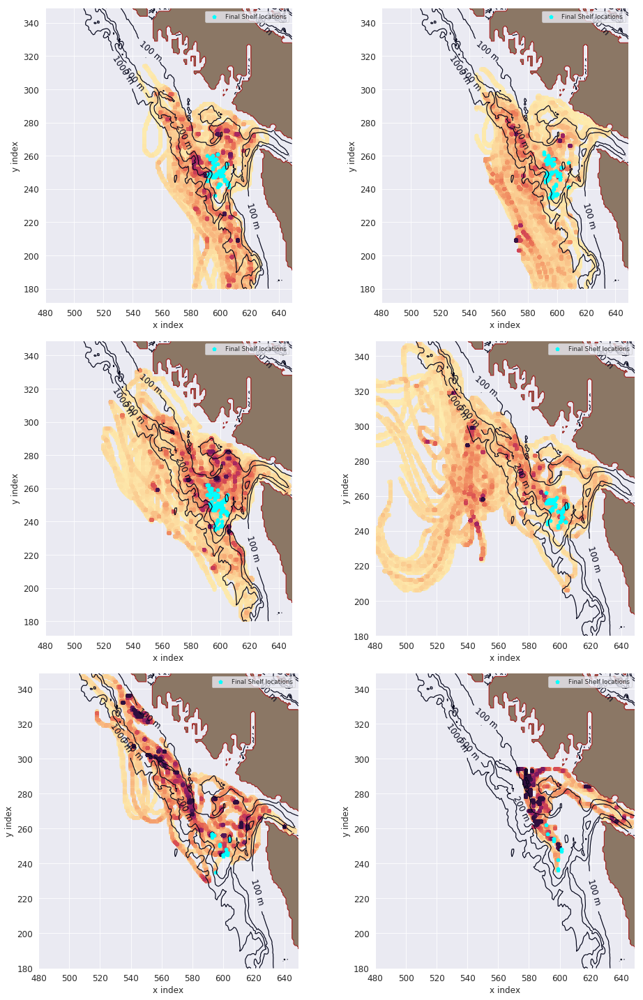

In [18]:
#     cmap=plt.cm.get_cmap('nipy_spectral')
# cmap = plt.cm.get_cmap('Blues_r')
cmap = cmo.cm.matter
cmap.set_bad('#8b7765')




import matplotlib as mpl
    


gridspec = {'width_ratios': [1, 1]}

fig, (ax, ax1, ax2) = plt.subplots(3, 2, figsize=(14, 20), gridspec_kw=gridspec)


#For CUC 

vmin = 0
vmax = cuc_ind.shape[0]*4

viz_tools.set_aspect(ax[0])

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_cuc, y_plot_cuc, ax= ax[0], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax[0].set_xlabel('x index', fontsize =12)
ax[0].set_ylabel('y index', fontsize = 12)
ax[0].tick_params(axis='both',labelsize =12)

ax[0].scatter(x_wcvi_slice[x1[cuc_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[cuc_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax[0].legend(loc = 'best')

viz_tools.plot_land_mask(ax[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

# m = cm.ScalarMappable(cmap=cmap)
# m.set_array(q)
# m.set_clim(vmin,vmax)

# cbar = fig.colorbar(m, cax=ax[1])


# cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/cuc_ind.shape[0])*100, \
#                                     stop=(cbar.vmax/cuc_ind.shape[0])*100, num=10), decimals = 1))

# cbar.set_label(label='CUC Particles (%)', fontsize = 16)
# cbar.ax.tick_params(labelsize=16)

#For South Particles

vmin = 0
vmax = south_ind.shape[0]*4

viz_tools.set_aspect(ax[1])

CS1 = ax[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_south, y_plot_south, ax= ax[1], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax[1].set_xlabel('x index', fontsize =12)
ax[1].set_ylabel('y index', fontsize = 12)
ax[1].tick_params(axis='both',labelsize =12)
# ax[1].get_yaxis().set_ticks([])

ax[1].scatter(x_wcvi_slice[x1[south_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[south_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax[1].legend(loc = 'best')

viz_tools.plot_land_mask(ax[1], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax[1], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

# m = cm.ScalarMappable(cmap=cmap)
# m.set_array(q)
# m.set_clim(vmin,vmax)

# cbar = fig.colorbar(m, cax=ax[3])


# cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/south_ind.shape[0])*100, \
#                                     stop=(cbar.vmax/south_ind.shape[0])*100, num=10), decimals = 1))

# cbar.set_label(label='South Particles (%)', fontsize = 16)
# cbar.ax.tick_params(labelsize=16)


#For local

vmin = 0
vmax = ind_local.shape[0]*4

viz_tools.set_aspect(ax1[0])

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_local, y_plot_local, ax= ax1[0], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax1[0].set_xlabel('x index', fontsize =12)
ax1[0].set_ylabel('y index', fontsize = 12)
ax1[0].tick_params(axis='both',labelsize =12)

ax1[0].scatter(x_wcvi_slice[x1[ind_local[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[ind_local[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax1[0].legend(loc = 'best')

viz_tools.plot_land_mask(ax1[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax1[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

# m = cm.ScalarMappable(cmap=cmap)
# m.set_array(q)
# m.set_clim(vmin,vmax)

# cbar = fig.colorbar(m, cax=ax1[1])


# cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/ind_local.shape[0])*100, \
#                                     stop=(cbar.vmax/ind_local.shape[0])*100, num=10), decimals = 1))

# cbar.set_label(label='Local Particles (%)', fontsize = 16)
# cbar.ax.tick_params(labelsize=16)

#For Offshore Particles

vmin = 0
vmax = off_ind.shape[0]*4

viz_tools.set_aspect(ax1[1])

CS1 = ax1[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax1[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_off, y_plot_off, ax= ax1[1], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax1[1].set_xlabel('x index', fontsize =12)
ax1[1].set_ylabel('y index', fontsize = 12)
ax1[1].tick_params(axis='both',labelsize =12)
# ax1[1].get_yaxis().set_ticks([])

ax1[1].scatter(x_wcvi_slice[x1[off_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[off_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax1[1].legend(loc = 'best')
ax1[1].set_xlim(left = 480)

viz_tools.plot_land_mask(ax1[1], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax1[1], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

# m = cm.ScalarMappable(cmap=cmap)
# m.set_array(q)
# m.set_clim(vmin,vmax)

# cbar = fig.colorbar(m, cax=ax1[3])


# cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/off_ind.shape[0])*100, \
#                                     stop=(cbar.vmax/off_ind.shape[0])*100, num=10), decimals = 1))

# cbar.set_label(label='Offshore Particles (%)', fontsize = 16)
# cbar.ax.tick_params(labelsize=16)

#For north particles

vmin = 0
vmax = north_ind.shape[0]*4

viz_tools.set_aspect(ax2[0])

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[0].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_north, y_plot_north, ax= ax2[0], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax2[0].set_xlabel('x index', fontsize =12)
ax2[0].set_ylabel('y index', fontsize = 12)
ax2[0].tick_params(axis='both',labelsize =12)

ax2[0].scatter(x_wcvi_slice[x1[north_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[north_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax2[0].legend(loc = 'best')

viz_tools.plot_land_mask(ax2[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax2[0], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

# m = cm.ScalarMappable(cmap=cmap)
# m.set_array(q)
# m.set_clim(vmin,vmax)

# cbar = fig.colorbar(m, cax=ax2[1])


# cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/north_ind.shape[0])*100, \
#                                     stop=(cbar.vmax/north_ind.shape[0])*100, num=10), decimals = 1))

# cbar.set_label(label='North Particles (%)', fontsize = 16)
# cbar.ax.tick_params(labelsize=16)

#For Juan Particles

vmin = 0
vmax = juan_ind.shape[0]*4

viz_tools.set_aspect(ax2[1])

CS1 = ax2[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(100,110,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(200,210,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(1000,1010,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)

CS1 = ax2[1].contour(x_wcvi_slice,y_wcvi_slice,Z[y_wcvi_slice,x_wcvi_slice], np.arange(500,510,10))
CLS1 = plt.clabel(CS1, inline=3,fmt='%0.0f m', fontsize=12)



    
q = density_scatter(x_plot_juan, y_plot_juan, ax= ax2[1], bins = [500,500], cmap = cmap , vmin = vmin, vmax = vmax)

ax2[1].set_xlabel('x index', fontsize =12)
ax2[1].set_ylabel('y index', fontsize = 12)
ax2[1].tick_params(axis='both',labelsize =12)
# ax2[1].get_yaxis().set_ticks([])

ax2[1].scatter(x_wcvi_slice[x1[juan_ind[:].astype(int)].astype(int)-1],y_wcvi_slice[y1[juan_ind[:].astype(int)-1].astype(int)-1], \
           marker = '*', c = 'cyan', \
           s = 10, linewidths=3, label = 'Final Shelf locations')

ax2[1].legend(loc = 'best')

viz_tools.plot_land_mask(ax2[1], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='#8b7765')
viz_tools.plot_coastline(ax2[1], bathy, yslice=y_wcvi_slice, xslice=x_wcvi_slice, color='brown')

# ax[0].grid()

# m = cm.ScalarMappable(cmap=cmap)
# m.set_array(q)
# m.set_clim(vmin,vmax)

# cbar = fig.colorbar(m, cax=ax2[3])


# cbar.ax.set_yticklabels(np.around(a=np.linspace(start=(cbar.vmin/juan_ind.shape[0])*100, \
#                                     stop=(cbar.vmax/juan_ind.shape[0])*100, num=10), decimals = 1))

# cbar.set_label(label='Strait Outflow Particles (%)', fontsize = 16)
# cbar.ax.tick_params(labelsize=16)


fig.tight_layout()

# fig.tight_layout(h_pad=0.01,w_pad=0.01)

### Temporal correlation with CUC strength and wind plot

In [1]:
%matplotlib notebook
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import numpy.ma as ma
import glob
from collections import namedtuple, OrderedDict
import netCDF4 as nc
import os
import scipy
import scipy.io as sio
from scipy import interpolate, signal
from pyproj import Proj,transform
import sys
sys.path.append('/ocean/ssahu/CANYONS/wcvi/grid/')
from bathy_common import *
from matplotlib import path
from salishsea_tools import viz_tools
import xarray as xr
from salishsea_tools import nc_tools
import scipy.io as sio
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.cm as cm
import cmocean as cmo
import matplotlib.gridspec as gridspec
%matplotlib inline
from scipy.io import loadmat
from scipy.interpolate import griddata
from dateutil.parser import parse
from salishsea_tools import geo_tools, viz_tools, tidetools, nc_tools

import seaborn as sns
from windrose import plot_windrose
from windrose import WindroseAxes


from dateutil        import parser
from datetime import datetime

/home/ssahu/anaconda3/lib/python3.5/site-packages/xarray/conventions.py:9: FutureWarning: The pandas.tslib module is deprecated and will be removed in a future version.
  from pandas.tslib import OutOfBoundsDatetime


In [2]:
def find_principal_axis_of_dataset_in_degrees(u_data,v_data):
    
    u_perturb = u_data - np.mean(u_data)
    v_perturb = v_data - np.mean(v_data)
    
    coords = np.vstack([u_perturb, v_perturb])

    cov = np.cov(coords)
    
    evals, evecs = np.linalg.eig(cov)

    sort_indices = np.argsort(evals)[::-1]
    
    x_v1, y_v1 = evecs[:, sort_indices[0]]  # Eigenvector with largest eigenvalue
    x_v2, y_v2 = evecs[:, sort_indices[1]]
    
    theta = np.tanh((x_v1)/(y_v1))  
#     rotation_mat = np.matrix([[np.cos(theta), -np.sin(theta)],
#                       [np.sin(theta), np.cos(theta)]])
#     transformed_mat = rotation_mat * coords
#     # plot the transformed blob
#     x_transformed, y_transformed = transformed_mat.A

    return np.rad2deg(theta)

def find_major_eigenvectors(u_data,v_data):
    
    u_data = u_data[~np.isnan(u_data)]
    v_data = v_data[~np.isnan(v_data)]
    
    u_perturb = u_data - np.mean(u_data)
    v_perturb = v_data - np.mean(v_data)
    
    coords = np.vstack([u_perturb, v_perturb])

    cov = np.cov(coords)
    
    evals, evecs = np.linalg.eig(cov)

    sort_indices = np.argsort(evals)[::-1]
    
    x_v1, y_v1 = evecs[:, sort_indices[0]]  # Eigenvector with largest eigenvalue
    x_v2, y_v2 = evecs[:, sort_indices[1]]
    
    return x_v1, y_v1, x_v2, y_v2


    
def U_timeseries_at_WCVI_locations(grid_U):
    
    u_vel = grid_U.variables['uo'][:,:,:,:]

    
    vector_u = namedtuple('vector_u', 'u_vel')

    return vector_u(u_vel)


def V_timeseries_at_WCVI_locations(grid_V):
    
    v_vel = grid_V.variables['vo'][:,:,:,:]

    
    vector_v = namedtuple('vector_v', 'v_vel')

    return vector_v(v_vel)




def uv_wind_timeseries_at_point(grid_weather, j, i, datetimes=False):
    """Return the u and v wind components and time counter values
    at a single grid point from a weather forcing dataset.

    :arg grid_weather: Weather forcing dataset, typically from an
                       :file:`ops_yYYYYmMMdDD.nc` file produced by the
                       :py:mod:`nowcast.workers.grid_to_netcdf` worker.
    :type grid_weather: :py:class:`netCDF4.Dataset`

    :arg int j: j-direction (longitude) index of grid point to get wind
                components at.

    :arg int i: i-direction (latitude) index of grid point to get wind
                components at.

    :arg boolean datetimes: Return time counter values as
                            :py:class:`datetime.datetime` objects if
                            :py:obj:`True`, otherwise return them as
                            :py:class:`arrow.Arrow` objects (the default).

    :returns: 2-tuple of 1-dimensional :py:class:`numpy.ndarray` objects,
              The :py:attr:`u` attribute holds the u-direction wind
              component,
              The :py:attr:`v` attribute holds the v-direction wind
              component,
              and the :py:attr:`time` attribute holds the time counter
              values.
    :rtype: :py:class:`collections.namedtuple`
    """
    u_wind = grid_weather.variables['u_wind'][:, j, i]
    v_wind = grid_weather.variables['v_wind'][:, j, i]
    time = timestamp(grid_weather, range(len(u_wind)))
    if datetimes:
        time = np.array([a.datetime for a in time])
    wind_ts = namedtuple('wind_ts', 'u, v, time')

    return wind_ts(u_wind, v_wind, np.array(time))

def timestamp(dataset, tindex, time_var='time_counter'):
    """Return the time stamp of the tindex time_counter value(s) in dataset.

    The time stamp is calculated by adding the time_counter[tindex] value
    (in seconds) to the dataset's time_counter.time_origin value.

    :arg dataset: netcdf dataset object
    :type dataset: :py:class:`netCDF4.Dataset`

    :arg tindex: time_counter variable index.
    :type tindex: int or iterable

    :arg time_var: name of the time variable
    :type time_var: str

    :returns: Time stamp value(s) at tindex in the dataset.
    :rtype: :py:class:`Arrow` instance or list of instances
    """
    time_orig = time_origin(dataset, time_var=time_var)
    time_counter = dataset.variables[time_var]
    try:
        iter(tindex)
    except TypeError:
        tindex = [tindex]
    results = []
    for i in tindex:
        try:
            results.append(time_orig + timedelta(seconds=time_counter[i]))
        except IndexError:
            raise IndexError(
                'time_counter variable has no tindex={}'.format(tindex))
    if len(results) > 1:
        return results
    else:

        return results[0]

def time_origin(dataset, time_var='time_counter'):
    """Return the time_var.time_origin value.

    :arg dataset: netcdf dataset object
    :type dataset: :py:class:`netCDF4.Dataset` or :py:class:`xarray.Dataset`

    :arg time_var: name of time variable
    :type time_var: str

    :returns: Value of the time_origin attribute of the time_counter
              variable.
    :rtype: :py:class:`Arrow` instance
    """
    try:
        time_counter = dataset.variables[time_var]
    except KeyError:
        raise KeyError(
            'dataset does not have {time_var} variable'.format(
                time_var=time_var))
    try:
        # netCDF4 dataset
        time_orig = time_counter.time_origin.title()
    except AttributeError:
        try:
            # xarray dataset
            time_orig = time_counter.attrs['time_origin'].title()
        except KeyError:
            raise AttributeError(
                'NetCDF: '
                '{time_var} variable does not have '
                'time_origin attribute'.format(time_var=time_var))
    value = arrow.get(
        time_orig,
        ['YYYY-MMM-DD HH:mm:ss',
         'DD-MMM-YYYY HH:mm:ss',
         'YYYY-MM-DD HH:mm:ss'])

    return value

import numpy

def smooth(x,window_len=24,window='hanning'):
    """smooth the data using a window with requested size.
    
    This method is based on the convolution of a scaled window with the signal.
    The signal is prepared by introducing reflected copies of the signal 
    (with the window size) in both ends so that transient parts are minimized
    in the begining and end part of the output signal.
    
    input:
        x: the input signal 
        window_len: the dimension of the smoothing window; should be an odd integer
        window: the type of window from 'flat', 'hanning', 'hamming', 'bartlett', 'blackman'
            flat window will produce a moving average smoothing.

    output:
        the smoothed signal
        
    example:

    t=linspace(-2,2,0.1)
    x=sin(t)+randn(len(t))*0.1
    y=smooth(x)
    
    see also: 
    
    numpy.hanning, numpy.hamming, numpy.bartlett, numpy.blackman, numpy.convolve
    scipy.signal.lfilter
 
    TODO: the window parameter could be the window itself if an array instead of a string
    NOTE: length(output) != length(input), to correct this: return y[(window_len/2-1):-(window_len/2)] instead of just y.
    """

    if x.ndim != 1:
        raise "smooth only accepts 1 dimension arrays."

    if x.size < window_len:
        raise "Input vector needs to be bigger than window size."


    if window_len<3:
        return x


    if not window in ['flat', 'hanning', 'hamming', 'bartlett', 'blackman']:
        raise "Window is on of 'flat', 'hanning', 'hamming', 'bartlett', 'blackman'"


    s=numpy.r_[x[window_len-1:0:-1],x,x[-2:-window_len-1:-1]]
    #print(len(s))
    if window == 'flat': #moving average
        w=numpy.ones(window_len,'d')
    else:
        w=eval('numpy.'+window+'(window_len)')

    y=numpy.convolve(w/w.sum(),s, mode='same')
    
    return y[window_len - 1:-window_len + 1]

    
def df_derived_by_shift(df,lag=0,NON_DER=[]):
    df = df.copy()
    if not lag:
        return df
    cols ={}
    for i in np.arange(1,lag+1):
        for x in list(df.columns):
            if x not in NON_DER:
                if not x in cols:
                    cols[x] = ['{}_{}'.format(x, i)]
                else:
                    cols[x].append('{}_{}'.format(x, i))
    for k,v in cols.items():
        columns = v
        dfn = pd.DataFrame(data=None, columns=columns, index=df.index)    
        i = 1
        for c in columns:
            dfn[c] = df[k].shift(periods=i)
            i+=1
        df = pd.concat([df, dfn], axis=1, join_axes=[df.index])
    return df









"""
Constants
=========
"""

# ---- physical constants
g = 9.8  # 9.7803 in COARE FIXME: change to sw.grav
""" acceleration due to gravity [m s :sup:`-2`] """

sigmaSB = 5.6697e-8
""" Stefan-Boltzmann constant [W m :sup:`-2` K :sup:`-4`] """

eps_air = 0.62197
""" Molecular weight ratio [water air :sup:`-1`] """

CtoK = 273.15  # 273.16
""" Conversion factor for [:math:`^\\circ` C] to [:math:`^\\circ` K] """

gas_const_R = 287.04  # NOTE: 287.1 in COARE
""" Gas constant for dry air [J kg :sup:`-1` K :sup:`-1`] """


# ---- meteorological constants
kappa = 0.4  # NOTE: 0.41
""" von Karman's constant """

charn = Charnock_alpha = 0.011  # NOTE: 0.018
""" Charnock constant. For determining roughness length at sea given friction
velocity, used in Smith formulas for drag coefficient and also in Fairall and
Edson. Ese alpha = 0.011 for open-ocean and alpha = 0.018 for fetch-limited
(coastal) regions."""

R_roughness = 0.11
""" limiting roughness Reynolds for aerodynamically smooth flow """


# ---- defaults suitable for boundary-layer studies
cp = 1004.7
""" heat capacity of air [J kg :sup:`-1` K :sup:`-1`] """

Qsat_coeff = 0.98
""" saturation specific humidity coefficient reduced by 2% over salt water """


# ------ short-wave flux calculations
Solar_const = 1368.0
""" The solar constant [W/m^2] represents a mean of satellite measurements
made over the last sunspot cycle (1979-1995) taken from Coffey et al (1995),
Earth System Monitor, 6, 6-10."""


# ---- long-wave flux calculations
emiss_lw = 0.985
""" long-wave emissivity of ocean from Dickey et al (1994), J. Atmos. Oceanic
Tech., 11, 1057-1076."""

# Default values
P_default = 1020.





def stress(sp, z=5., drag='largepond', rho_air=1.22, Ta=10.):
    """Computes the neutral wind stress.
    Parameters
    ----------
    sp : array_like
         wind speed [m s :sup:`-1`]
    z : float, array_like, optional
        measurement height [m]
    rho_air : array_like, optional
           air density [kg m :sup:`-3`]
    drag : str
           neutral drag by:
           'largepond' <-- default
           'smith'
           'vera'
    Ta : array_like, optional
         air temperature [:math:`^\\circ` C]
    Returns
    -------
    tau : array_like
          wind stress  [N m :sup:`-2`]
    See Also
    --------
    cdn
    Examples
    --------
    >>> from airsea import windstress as ws
    >>> ws.stress([10., 0.2, 12., 20., 30., 50.], 10)
    array([  1.40300000e-01,   5.61200000e-05,   2.23113600e-01,
             8.73520000e-01,   2.67912000e+00,   1.14070000e+01])
    >>> kw = dict(rho_air=1.02, Ta=23.)
    >>> ws.stress([10., 0.2, 12., 20., 30., 50.], 15, 'smith', **kw)
    array([  1.21440074e-01,   5.32531576e-05,   1.88322389e-01,
             6.62091968e-01,   1.85325310e+00,   7.15282267e+00])
    >>> ws.stress([10., 0.2, 12., 20., 30., 50.], 8, 'vera')
    array([  1.50603698e-01,   7.16568379e-04,   2.37758830e-01,
             9.42518454e-01,   3.01119044e+00,   1.36422742e+01])
    References
    ----------
    .. [1] Large and Pond (1981), J. Phys. Oceanog., 11, 324-336.
    .. [2] Smith (1988), J. Geophys. Res., 93, 311-326.
    .. [3] E. Vera (1983) FIXME eqn. 8 in Large, Morzel, and Crawford (1995),
    J. Phys. Oceanog., 25, 2959-2971.
    Modifications: Original from AIR_SEA TOOLBOX, Version 2.0
    03-08-1997: version 1.0
    08-26-1998: version 1.1 (revised by RP)
    04-02-1999: versin 1.2 (air density option added by AA)
    08-05-1999: version 2.0
    11-26-2010: Filipe Fernandes, Python translation.
    """
    z, sp = np.asarray(z), np.asarray(sp)
    Ta, rho_air = np.asarray(Ta), np.asarray(rho_air)

    # Find cd and ustar.
    if drag == 'largepond':
        cd, sp = cdn(sp, z, 'largepond')
    elif drag == 'smith':
        cd, sp = cdn(sp, z, 'smith', Ta)
    elif drag == 'vera':
        cd, sp = cdn(sp, z, 'vera')
    else:
        print('Unknown method')  # FIXME: raise a proper python error

    tau = rho_air * (cd * sp ** 2)

    return tau


def cdn(sp, z, drag='largepond', Ta=10):
    """Computes neutral drag coefficient.
    Methods available are: Large & Pond (1981),  Vera (1983) or Smith (1988)
    Parameters
    ----------
    sp : array_like
         wind speed [m s :sup:`-1`]
    z : float, array_like
        measurement height [m]
    drag : str
           neutral drag by:
           'largepond' <-- default
           'smith'
           'vera'
    Ta : array_like, optional for drag='smith'
         air temperature [:math:`^\\circ` C]
    Returns
    -------
    cd : float, array_like
         neutral drag coefficient at 10 m
    u10 : array_like
          wind speed at 10 m [m s :sup:`-1`]
    See Also
    --------
    stress, spshft, visc_air
    Notes
    -----
    Vera (1983): range of fit to data is 1 to 25 [m s :sup:`-1`].
    Examples
    --------
    >>> from airsea import windstress as ws
    >>> ws.cdn([10., 0.2, 12., 20., 30., 50.], 10)
    (array([ 0.00115,  0.00115,  0.00127,  0.00179,  0.00244,  0.00374]),
     array([ 10. ,   0.2,  12. ,  20. ,  30. ,  50. ]))
    >>> ws.cdn([10., 0.2, 12., 20., 30., 50.], 15, 'vera')
    (array([ 0.00116157,  0.01545237,  0.00126151,  0.00174946,  0.00242021,
            0.00379521]),
     array([  9.66606155,   0.17761896,  11.58297824, 19.18652915,
            28.5750255 ,  47.06117334]))
    >>> ws.cdn([10., 0.2, 12., 20., 30., 50.], 20, 'smith', 20.)
    (array([ 0.00126578,  0.00140818,  0.00136533,  0.00173801,  0.00217435,
            0.00304636]),
     array([  9.41928554,   0.18778865,  11.27787697,  18.65250005,
            27.75712916,  45.6352786 ]))
    References
    ----------
    .. [1] Large and Pond (1981), J. Phys. Oceanog., 11, 324-336.
    .. [2] Smith (1988), J. Geophys. Res., 93, 311-326.
    .. [3] E. Vera (1983) FIXME eqn. 8 in Large, Morzel, and Crawford (1995),
    J. Phys. Oceanog., 25, 2959-2971.
    Modifications: Original from AIR_SEA TOOLBOX, Version 2.0
    03-08-1997: version 1.0
    08-26-1998: version 1.1 (vectorized by RP)
    08-05-1999: version 2.0
    11-26-2010: Filipe Fernandes, Python translation.
    """
    # convert input to numpy array
    sp, z, Ta = np.asarray(sp), np.asarray(z), np.asarray(Ta)

    tol = 0.00001  # Iteration end point.

    if drag == 'largepond':
        a = np.log(z / 10.) / kappa  # Log-layer correction factor.
        u10o = np.zeros(sp.shape)
        cd = 1.15e-3 * np.ones(sp.shape)
        u10 = sp / (1 + a * np.sqrt(cd))
        ii = np.abs(u10 - u10o) > tol

        while np.any(ii):
            u10o = u10
            cd = (4.9e-4 + 6.5e-5 * u10o)  # Compute cd(u10).
            cd[u10o < 10.15385] = 1.15e-3
            u10 = sp / (1 + a * np.sqrt(cd))  # Next iteration.
            # Keep going until iteration converges.
            ii = np.abs(u10 - u10o) > tol

    elif drag == 'smith':
        visc = visc_air(Ta)

        # Remove any sp==0 to prevent division by zero
        # i = np.nonzero(sp == 0)
        # sp[i] = 0.1 * np.ones(len(i)) FIXME

        # initial guess
        ustaro = np.zeros(sp.shape)
        ustarn = 0.036 * sp

        # iterate to find z0 and ustar
        ii = np.abs(ustarn - ustaro) > tol
        while np.any(ii):
            ustaro = ustarn
            z0 = Charnock_alpha * ustaro ** 2 / g + R_roughness * visc / ustaro
            ustarn = sp * (kappa / np.log(z / z0))
            ii = np.abs(ustarn - ustaro) > tol

        sqrcd = kappa / np.log(10. / z0)
        cd = sqrcd ** 2
        u10 = ustarn / sqrcd
    elif drag == 'vera':
        # constants in fit for drag coefficient
        A = 2.717e-3
        B = 0.142e-3
        C = 0.0764e-3

        a = np.log(z / 10.) / kappa  # Log-layer correction factor.
        # Don't start iteration at 0 to prevent blowups.
        u10o = np.zeros(sp.shape) + 0.1
        cd = A / u10o + B + C * u10o
        u10 = sp / (1 + a * np.sqrt(cd))

        ii = np.abs(u10 - u10o) > tol
        while np.any(ii):
            u10o = u10
            cd = A / u10o + B + C * u10o
            u10 = sp / (1 + a * np.sqrt(cd))  # Next iteration.
            # Keep going until iteration converges.
            ii = np.abs(u10 - u10o) > tol
    else:
        print('Unknown method')  # FIXME: raise a proper python error.

    return cd, u10


def get_alongshore_currents(u_curr, v_curr):
    
    pri_angle    = find_principal_axis_of_dataset_in_degrees(u_data=u_curr, v_data=v_curr)
    pri_angle    = np.radians(pri_angle)
#     direc        = 90 - np.rad2deg(np.arctan(v_curr/u_curr))
#     Speed_curr   = np.sqrt(u_curr**2 + v_curr**2)
    
    coords = np.vstack([u_curr, v_curr])
    
    rotation_mat = np.matrix([[np.cos(pri_angle), -np.sin(pri_angle)],
                  [np.sin(pri_angle), np.cos(pri_angle)]])
    transformed_mat = rotation_mat * coords
    
    alongshore_rot = transformed_mat[1,:]
    
    alongshore_rot = alongshore_rot.tolist()
    
    
    
    
    
#     dir_new      = direc - pri_angle
    
#     alongshore_rot = np.empty_like(dir_new)
#     alongshore_rot[:] = np.multiply(Speed_curr[:],np.sin(np.deg2rad(dir_new)))
    
    return alongshore_rot[0]

def nan_helper(y):
    """Helper to handle indices and logical indices of NaNs.

    Input:
        - y, 1d numpy array with possible NaNs
    Output:
        - nans, logical indices of NaNs
        - index, a function, with signature indices= index(logical_indices),
          to convert logical indices of NaNs to 'equivalent' indices
    Example:
        >>> # linear interpolation of NaNs
        >>> nans, x= nan_helper(y)
        >>> y[nans]= np.interp(x(nans), x(~nans), y[~nans])
    """

    return np.isnan(y), lambda z: z.nonzero()[0]
    
    
def calculate_strength_of_adcp_undercurrent(t, adcp_alongshore, adcp_depths):
       
    ind  = np.array(np.where(adcp_alongshore[:] > 0))

    mean_undercurr = np.mean(adcp_alongshore[ind])
    
    if ind[0][0] !=  ind[0][-1]:

        depths_mean = np.mean(adcp_depths[ind[0][0]:ind[0][-1]])
        
        strength = np.trapz(adcp_alongshore[ind[0][0]:ind[0][-1]], adcp_depths[ind[0][0]:ind[0][-1]])
        
        
    else:
        depths_mean = adcp_depths[ind[0][0]]

#     strength = np.multiply(mean_undercurr,depths_mean)
        
    return strength



def calculate_strength_of_model_undercurrent(t, model_alongshore, model_depths):

    ind  = np.array(np.where(model_alongshore[20:] > 0))

    mean_undercurr = np.mean(model_alongshore[20+ind[0][0]:20+ind[0][-1]])
    
    if ind[0][0] !=  ind[0][-1]:

        depths_mean = np.absolute(np.mean(zlevels[20+ind[0][0]:20+ind[0][-1]]))
        
        strength = np.trapz(model_alongshore[20+ind[0][0]:20+ind[0][-1]], zlevels[20+ind[0][0]:20+ind[0][-1]])

    else:
        depths_mean = np.absolute(zlevels[20+ind[0][0]])

#     strength = np.multiply(mean_undercurr,depths_mean)
        
    return strength


In [3]:
sns.set_context('poster')
sns.set_style('dark')

In [4]:
newport_data = pd.read_table('/data/ssahu/Falkor_2013/winds/Newport_winds_unfiltered.csv', delim_whitespace=1, parse_dates= True, header = None, skiprows=2)

# a = orford_data[0].str.split(',', expand=True)

# b = orford_data[1].str.split(',', expand=True)

# df_La_Peruse = pd.concat([a, b], axis=1)

df_cut = newport_data.drop(newport_data.columns[7:], axis=1)
columns = ['Year','Month','Day','Hour','Min','Wind Direction (deg)','Wind Speed','GDR','GST','GTIME']
effective = columns[:7]
df_cut.columns = effective


df_cut['Year']   = df_cut['Year'].astype(str)
df_cut['Day']    = df_cut['Day'].astype(str)
df_cut['Month']  = df_cut['Month'].astype(str)
df_cut['Hour']   = df_cut["Hour"].astype(str)

df_cut.columns = df_cut.columns.str.replace(' ', '')



df_cut['Datetime'] = df_cut['Year'] + "-" + df_cut['Month'] + "-" + df_cut['Day']+ " " + df_cut["Hour"] + ":00:00"

df_cut["Datetime"] = pd.to_datetime(df_cut["Datetime"])


df_cut = df_cut.iloc[:,4:]

df_cut = df_cut.set_index(pd.DatetimeIndex(df_cut["Datetime"]))


# df_cut.tail(10)

df_subset = df_cut.loc['2013-08-01 01:00:00':'2013-08-31 23:00:00']

df_subset = df_subset.resample('60T').mean().reset_index()


newport_datetime = df_subset['Datetime']

df_subset.head(10)



,Datetime,Min,WindDirection(deg),WindSpeed
0,2013-08-01 01:00:00,25.0,181.333333,1.983333
1,2013-08-01 02:00:00,25.0,206.500000,1.600000
2,2013-08-01 03:00:00,25.0,223.333333,2.100000
3,2013-08-01 04:00:00,25.0,251.166667,2.483333
4,2013-08-01 05:00:00,25.0,224.833333,1.866667
5,2013-08-01 06:00:00,25.0,245.666667,1.950000
6,2013-08-01 07:00:00,25.0,240.500000,2.150000
7,2013-08-01 08:00:00,25.0,233.000000,2.050000
8,2013-08-01 09:00:00,25.0,217.666667,1.850000
9,2013-08-01 10:00:00,25.0,234.500000,2.166667


In [5]:
ws_newport = df_subset['WindSpeed']
wd_newport = df_subset['WindDirection(deg)']


u_wind_newport = np.multiply(ws_newport[:],np.cos(wd_newport))

v_wind_newport = np.multiply(ws_newport[:],np.sin(wd_newport))

In [6]:


df_subset_daily = df_cut.loc['2013-08-01 01:00:00':'2013-08-31 23:00:00']

df_subset_daily = df_subset_daily.resample('D').mean().reset_index()

df_subset_daily.head(5)

,Datetime,Min,WindDirection(deg),WindSpeed
0,2013-08-01,25.0,221.376812,2.611594
1,2013-08-02,25.0,215.611111,2.555556
2,2013-08-03,25.0,311.756944,5.165278
3,2013-08-04,25.0,281.604167,8.490972
4,2013-08-05,25.0,257.152778,6.709028


In [7]:
ws_newport_daily = df_subset_daily['WindSpeed']
wd_newport_daily = df_subset_daily['WindDirection(deg)']


u_wind_newport_daily = np.multiply(ws_newport_daily[:],np.cos(wd_newport_daily))

v_wind_newport_daily = np.multiply(ws_newport_daily[:],np.sin(wd_newport_daily))

In [8]:
eel_data = pd.read_table('/data/ssahu/Falkor_2013/winds/station_46022_eel_river_2013.csv', delim_whitespace=1, parse_dates= True, header = None, skiprows=2)

# a = orford_data[0].str.split(',', expand=True)

# b = orford_data[1].str.split(',', expand=True)

# df_La_Peruse = pd.concat([a, b], axis=1)

df_cut = eel_data.drop(eel_data.columns[7:], axis=1)
columns = ['Year','Month','Day','Hour','Min','Wind Direction (deg)','Wind Speed','GDR','GST','GTIME']
effective = columns[:7]
df_cut.columns = effective


df_cut['Year']   = df_cut['Year'].astype(str)
df_cut['Day']    = df_cut['Day'].astype(str)
df_cut['Month']  = df_cut['Month'].astype(str)
df_cut['Hour']   = df_cut["Hour"].astype(str)

df_cut.columns = df_cut.columns.str.replace(' ', '')



df_cut['Datetime'] = df_cut['Year'] + "-" + df_cut['Month'] + "-" + df_cut['Day']+ " " + df_cut["Hour"] + ":00:00"

df_cut["Datetime"] = pd.to_datetime(df_cut["Datetime"])


df_cut = df_cut.iloc[:,4:]

df_cut = df_cut.set_index(pd.DatetimeIndex(df_cut["Datetime"]))


# df_cut.tail(10)

df_subset = df_cut.loc['2013-08-01 01:00:00':'2013-08-31 23:00:00']

df_subset = df_subset.resample('60T').mean().reset_index()


eel_datetime = df_subset['Datetime']

df_subset.head(10)



,Datetime,Min,WindDirection(deg),WindSpeed
0,2013-08-01 01:00:00,50.0,336.0,3.2
1,2013-08-01 02:00:00,50.0,353.0,99.0
2,2013-08-01 03:00:00,50.0,341.0,2.2
3,2013-08-01 04:00:00,50.0,340.0,2.3
4,2013-08-01 05:00:00,50.0,338.0,2.2
5,2013-08-01 06:00:00,50.0,329.0,2.5
6,2013-08-01 07:00:00,50.0,330.0,1.7
7,2013-08-01 08:00:00,50.0,325.0,3.1
8,2013-08-01 09:00:00,50.0,4.0,2.1
9,2013-08-01 10:00:00,50.0,351.0,2.8


In [9]:
ws_eel = df_subset['WindSpeed']
wd_eel = df_subset['WindDirection(deg)']


u_wind_eel = np.multiply(ws_newport[:],np.cos(wd_newport))

v_wind_eel = np.multiply(ws_newport[:],np.sin(wd_newport))

In [10]:

df_subset_daily = df_cut.loc['2013-08-01 01:00:00':'2013-08-31 23:00:00']

df_subset_daily = df_subset_daily.resample('D').mean().reset_index()

df_subset_daily.head(5)

,Datetime,Min,WindDirection(deg),WindSpeed
0,2013-08-01,50.0,325.909091,7.286364
1,2013-08-02,50.0,187.842105,5.189474
2,2013-08-03,50.0,314.631579,8.200000
3,2013-08-04,50.0,325.200000,6.430000
4,2013-08-05,50.0,278.458333,8.387500


In [11]:
ws_eel_daily = df_subset_daily['WindSpeed']
wd_eel_daily = df_subset_daily['WindDirection(deg)']


u_wind_eel_daily = np.multiply(ws_eel_daily[:],np.cos(wd_eel_daily))

v_wind_eel_daily = np.multiply(ws_eel_daily[:],np.sin(wd_eel_daily))

In [12]:
La_Peruse_data = pd.read_table('/data/ssahu/Falkor_2013/winds/La_persue_wave_buoy.csv',delim_whitespace=1,header = None, skiprows=7)

a = La_Peruse_data[0].str.split(',', expand=True)

b = La_Peruse_data[1].str.split(',', expand=True)

df_La_Peruse = pd.concat([a, b], axis=1)

df_cut = df_La_Peruse.drop(df_La_Peruse.columns[14:], axis=1)

columns = ['STN_ID','DATE','TIME','Qflag','LATITUDE','LONGITUDE','DEPTH','VCAR','VTPK','VWH','VCMX','VTP','WDIR','WSPD','WSS','GSPD','WDIR','WSPD','WSS','GSPD','ATMS','ATMS','DRYT','SSTP']

effective = columns[:14]

df_cut.columns = effective
df_cut = df_cut.drop('Qflag',axis =1)

df_cut['Date_time']= df_cut['DATE'] + " " + df_cut['TIME']

# df_cut = df_cut.drop('DATE', axis=1)
# df_cut = df_cut.drop('TIME', axis=1)

df_cut.tail(10)

,STN_ID,DATE,TIME,LATITUDE,LONGITUDE,DEPTH,VCAR,VTPK,VWH,VCMX,VTP,WDIR,WSPD,Date_time
217132,C46206,06/18/2018,18:38,48.83,126.00,72.00,2.19,12.80,2.20,6.40,12.80,58.00,3.50,06/18/2018 18:38
217133,C46206,06/18/2018,19:38,48.83,126.00,72.00,2.04,12.80,2.00,3.80,12.80,64.00,3.70,06/18/2018 19:38
217134,C46206,06/19/2018,00:38,48.83,126.00,72.00,1.76,12.19,1.80,2.60,12.20,155.00,2.60,06/19/2018 00:38
217135,C46206,06/19/2018,04:38,48.83,126.00,72.00,1.66,12.19,1.70,2.70,12.20,86.00,2.60,06/19/2018 04:38
217136,C46206,06/19/2018,05:38,48.83,126.00,72.00,1.51,12.19,1.50,2.40,12.20,65.00,3.50,06/19/2018 05:38
217137,C46206,06/19/2018,06:38,48.83,126.00,72.00,1.59,11.13,1.60,2.80,11.10,64.00,4.80,06/19/2018 06:38
217138,C46206,06/19/2018,13:38,48.83,126.00,72.00,1.51,11.64,1.40,7.10,11.60,51.00,4.60,06/19/2018 13:38
217139,C46206,06/19/2018,17:38,48.83,126.00,72.00,1.50,11.13,1.30,7.00,11.10,72.00,4.20,06/19/2018 17:38
217140,C46206,06/19/2018,18:38,48.83,126.00,72.00,1.45,15.06,1.40,5.20,15.10,84.00,3.40,06/19/2018 18:38
217141,C46206,06/19/2018,21:38,48.83,126.00,72.00,1.47,10.67,1.50,2.10,10.70,87.00,2.50,06/19/2018 21:38


In [13]:
LA_PERUSE_array = df_cut.as_matrix()

start_index_2013_June  = np.transpose(np.array(np.where(LA_PERUSE_array[:,1] == '08/01/2013')))[0,0]

end_index_2013_September  = np.transpose(np.array(np.where(LA_PERUSE_array[:,1] == '08/31/2013')))[-1,0]


In [14]:
wind_spd = LA_PERUSE_array[start_index_2013_June:end_index_2013_September,-2].astype(np.float)

wind_dir = LA_PERUSE_array[start_index_2013_June:end_index_2013_September,-3].astype(np.float)

u_wind = np.multiply(wind_spd[:],np.cos(wind_dir))

v_wind = np.multiply(wind_spd[:],np.sin(wind_dir))

time_2013 = LA_PERUSE_array[start_index_2013_June:end_index_2013_September,-1].astype(str)

datetime_2013 = np.empty_like(time_2013)

for i in np.arange(datetime_2013.shape[0]):
    datetime_2013[i] = datetime.strptime(time_2013[i], '%m/%d/%Y %H:%M')
    
datetime_2013 = datetime_2013.astype(np.datetime64)

/home/ssahu/anaconda3/lib/python3.5/site-packages/numpy/lib/function_base.py:973: RuntimeWarning: invalid value encountered in greater_equal
  not_smaller_than_edge = (sample[:, i] >= edges[i][-1])


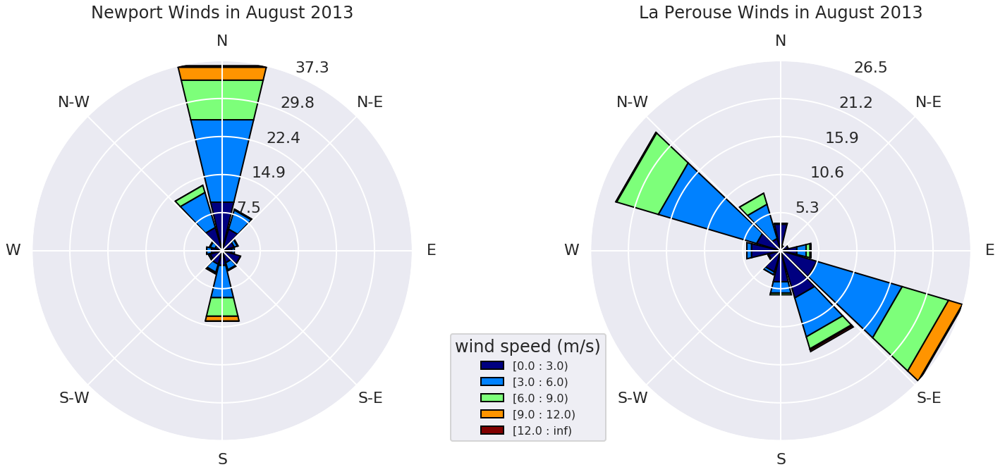

In [15]:

ws_newport = df_subset['WindSpeed']
wd_newport = df_subset['WindDirection(deg)']

ws_La_Perouse = wind_spd
wd_La_Perouse = wind_dir


fig = plt.figure(figsize=(20, 10))
left_rectangle = [0, 0.1, 0.4, 0.75]# [left, bottom, width, height] as a fraction of total figure size
ax1 = WindroseAxes(fig, left_rectangle)  
fig.add_axes(ax1)# creates the axes of specified dimensions

ax1.bar(wd_newport, ws_newport, normed=True, nsector=12, opening=0.9, edgecolor='black', bins=np.arange(0,14,3))#[0,2.5,4.5,8,10,11])
ax1.set_title("Newport Winds in August 2013", position=(0.5, 1.1))
ax1.set_legend()
ax1.legend(title="wind speed (m/s)", loc=(1.1, 0), fontsize =16)

right_rectangle = [0.5, 0.1, 0.5, 0.75]     # [left, bottom, width, height]
ax = WindroseAxes(fig, right_rectangle)
fig.add_axes(ax)
ax.bar(wd_La_Perouse, ws_La_Perouse, normed=True, nsector=12,opening=0.9, edgecolor='black', bins=np.arange(0,14,3))#[0,2.5,4.5,8,10,11])
ax.set_title("La Perouse Winds in August 2013", position=(0.5, 1.1))
# ax.legend(None)
# ax.set_legend(False)
# ax.get_legend().remove()
# ax.legend(title="wind speed (m/s)", loc=(1.1, 0), fontsize =16)

In [16]:
theta = find_principal_axis_of_dataset_in_degrees(u_data=u_wind, v_data=v_wind)

x_v1, y_v1, x_v2, y_v2 = find_major_eigenvectors(u_data=u_wind, v_data=v_wind)


x_v1_new, y_v1_new, x_v2_new, y_v2_new = find_major_eigenvectors(u_data=u_wind_newport, v_data=v_wind_newport)


/home/ssahu/anaconda3/lib/python3.5/site-packages/numpy/lib/function_base.py:973: RuntimeWarning: invalid value encountered in greater_equal
  not_smaller_than_edge = (sample[:, i] >= edges[i][-1])


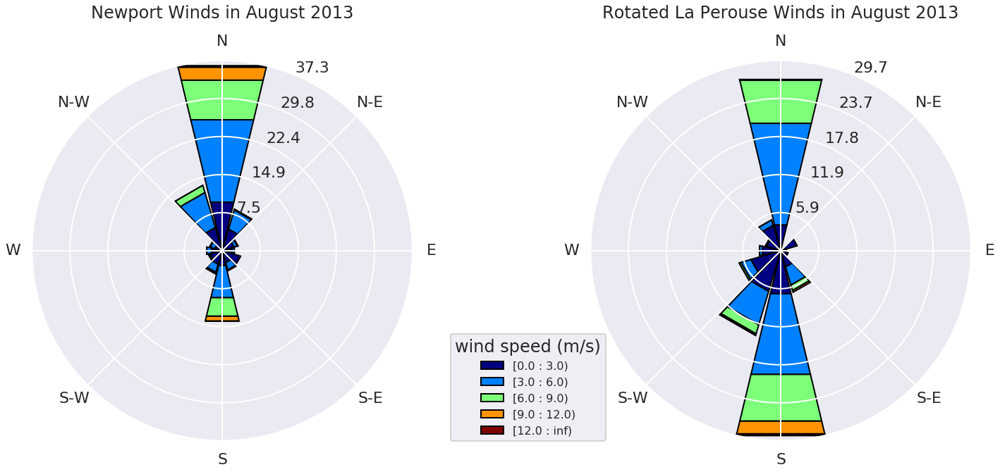

In [17]:

ws_newport = df_subset['WindSpeed']
wd_newport = df_subset['WindDirection(deg)']

ws_La_Perouse = wind_spd
wd_La_Perouse = wind_dir


fig = plt.figure(figsize=(20, 10))
left_rectangle = [0, 0.1, 0.4, 0.75]# [left, bottom, width, height] as a fraction of total figure size
ax1 = WindroseAxes(fig, left_rectangle)  
fig.add_axes(ax1)# creates the axes of specified dimensions

ax1.bar(wd_newport, ws_newport, normed=True, nsector=12, opening=0.9, edgecolor='black', bins=np.arange(0,14,3))#[0,2.5,4.5,8,10,11])
ax1.set_title("Newport Winds in August 2013", position=(0.5, 1.1))
ax1.set_legend()
ax1.legend(title="wind speed (m/s)", loc=(1.1, 0), fontsize =16)

right_rectangle = [0.5, 0.1, 0.5, 0.75]     # [left, bottom, width, height]
ax = WindroseAxes(fig, right_rectangle)
fig.add_axes(ax)
ax.bar(wd_La_Perouse - theta, ws_La_Perouse, normed=True, nsector=12,opening=0.9, edgecolor='black', bins=np.arange(0,14,3))#[0,2.5,4.5,8,10,11])
ax.set_title("Rotated La Perouse Winds in August 2013", position=(0.5, 1.1))
# ax.legend(None)
# ax.set_legend(False)
# ax.get_legend().remove()
# ax.legend(title="wind speed (m/s)", loc=(1.1, 0), fontsize =16)

In [18]:
theta = find_principal_axis_of_dataset_in_degrees(u_data=u_wind, v_data=v_wind)


wind_spd = LA_PERUSE_array[start_index_2013_June:end_index_2013_September,-2].astype(np.float)

wind_dir = LA_PERUSE_array[start_index_2013_June:end_index_2013_September,-3].astype(np.float)

v_wind_rot = np.empty_like(wind_dir)

v_wind_rot[:] = -1*np.multiply(wind_spd[:],np.cos(np.deg2rad(wind_dir[:] - theta)))

# v_wind_rot = np.multiply(wind_spd[:],np.sin(np.deg2rad(wind_dir[:] - 57)))

time_2013 = LA_PERUSE_array[start_index_2013_June:end_index_2013_September,-1].astype(str)

datetime_2013 = np.empty_like(time_2013)

for i in np.arange(datetime_2013.shape[0]):
    datetime_2013[i] = datetime.strptime(time_2013[i], '%m/%d/%Y %H:%M')
    
datetime_2013 = datetime_2013.astype(np.datetime64)

In [19]:
range = pd.date_range('2013-08-01', '2013-08-31', freq='D')



La_perouse_series = pd.Series(v_wind_rot, index=datetime_2013)
daily_north_La_Perouse = La_perouse_series.resample('D').mean()

La_perouse_stress_daily = np.sign(daily_north_La_Perouse)*stress(sp=daily_north_La_Perouse)


In [20]:

datetime_2013_newport  = datetime_2013[~np.isnan(v_wind_newport)]
u_wind_newport = u_wind_newport[~np.isnan(v_wind_newport)]
v_wind_newport = v_wind_newport[~np.isnan(v_wind_newport)]


In [21]:
np.min(Newport_series_daily)

NameError: name 'Newport_series_daily' is not defined

In [ ]:
np.min(La_perouse_series)

In [ ]:
range = pd.date_range('2013-08-01', '2013-08-31', freq='D')



Newport_series_daily = pd.Series(v_wind_newport_daily)
# Newport_series = pd.Series(data=np.array(v_wind_newport[:]), index=datetime_2013_newport)
# Newport_series_daily = Newport_series.resample('D').mean()#.reset_index()


Newport_stress_daily = np.sign(-Newport_series_daily)*stress(sp=Newport_series_daily)


In [22]:
range = pd.date_range('2013-08-01', '2013-08-31', freq='D')



eel_series_daily = pd.Series(v_wind_eel_daily)
# Newport_series = pd.Series(data=np.array(v_wind_newport[:]), index=datetime_2013_newport)
# Newport_series_daily = Newport_series.resample('D').mean()#.reset_index()


eel_stress_daily = np.sign(-eel_series_daily)*stress(sp=eel_series_daily)


In [44]:
date1_Newport = '2013-08-01'
date2_Newport = '2013-08-31'
mydates_Newport = pd.date_range(date1_Newport, date2_Newport, freq= 'D')


In [24]:
colors = cm.copper(np.linspace(0, 1, 50))

colors_speed = cm.ocean(np.linspace(0, 1, 50))

/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:473: RuntimeWarning: invalid value encountered in greater
/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:478: RuntimeWarning: invalid value encountered in less
/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:481: RuntimeWarning: invalid value encountered in greater
/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


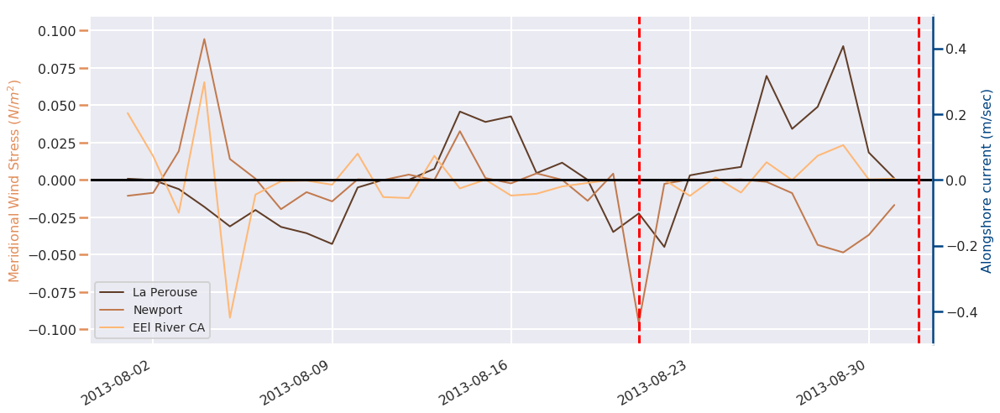

In [56]:

step = 1
window_size_1 = 24



time_axis = datetime_2013[:]


s_v_newport = v_wind_newport[:]   
filt_v_newport = smooth(s_v_newport,window_size_1,'hanning')
Newport_stress = np.sign(filt_v_newport)*stress(sp=filt_v_newport)



s_v = v_wind[:]   
filt_v = smooth(s_v,window_size_1,'hanning')
La_perouse_stress = np.sign(filt_v)*stress(sp=filt_v)




fig, ax1 = plt.subplots(1, 1, figsize=(18,8))

# ax1.plot(time_axis[1300:] ,filt_v[1300:], 'b-',linewidth=2, label = 'La Perouse')

# ax1.plot(time_axis[1300:] , La_perouse_stress[1300:], color = colors[30],linewidth=2, label = 'La Perouse')
ax1.plot(mydates_Newport , La_perouse_stress_daily, color = colors[15],linewidth=2, label = 'La Perouse')
# ax1.plot(df_subset['Datetime'], Newport_stress, c = colors[40], linewidth=2, label = 'Newport')
ax1.plot(mydates_Newport, Newport_stress_daily, c = colors[30], linewidth=2, label = 'Newport')

ax1.plot(mydates_Newport, eel_stress_daily, c = colors[45], linewidth=2, label = 'EEl River CA')
# ax1.plot(time_axis_orford ,filt_v_orford[::step], 'cyan',linewidth=2)


# ax1.legend(['Filtered'])
# ax1.set_title("Meridional Wind speed", fontsize = 16)
ax1.axhline(y=0, color = 'k')
# ax1.axvline(x = time_axis[time_axis == '2013-08-21'], color = 'r', linestyle  = '--')
ax1.axvline(x = mydates_Newport[mydates_Newport == '2013-08-21'], color = 'r', linestyle  = '--')
ax1.axvline(x = time_axis[-1], color = 'r', linestyle  = '--')
ax1.tick_params(axis='both',labelsize =16)
ax1.set_ylim(-0.11,0.11)
ax1.set_ylabel('Meridional Wind Stress ($N/m^2$)', fontsize = 16)# and Wind stress (*10^3) (N/m^2)', fontsize = 16)
ax1.grid()
ax1.yaxis.label.set_color(colors[35])
ax1.tick_params(axis='both',labelsize =16, color = colors[35])

ax2 = ax1.twinx()
# ax2.plot(mydates[90:-50], v_unrotated[90:-50,10,j,i], c = colors_speed[40], linewidth=2, label = '{0:0.1f}m depth'.format(zlevels[10]))
# ax2.plot(mydates[90:-50], v_unrotated[90:-50,22,j,i], c = colors_speed[25], linewidth=1, label = '{0:0.1f}m depth'.format(zlevels[22]))
# ax2.plot(mydates[90:-50], v_unrotated[90:-50,25,j,i], c = colors_speed[30], linewidth=1.5, label = '{0:0.1f}m depth'.format(zlevels[25]))


# ax2.plot(mydates_A1_1, north_148, color = colors_speed[35], linewidth=1.5, linestyle = 'dashed', label = 'ADCP {0:0.1f}m depth'.format(148))

# north_84[north_84 < -2] = 'Nan'
# ax2.plot(mydates_A1_1, north_84, color = colors_speed[25], linewidth=1.5,linestyle = 'dashed', label = 'ADCP {0:0.1f}m depth'.format(84))
# # ax3 = ax1.twinx()
# ax1.plot(mydates_Newport[1:-1], wind_stress_newport[:])#, 'golden', linewidth=2, label = 'Newport')
# # ax3.set_yticklabels([])

ax2.set_ylabel('Alongshore current (m/sec)', fontsize = 16)
ax2.set_ylim(-0.5, 0.5)
ax2.tick_params(axis='both',labelsize =16, color = colors_speed[25])
ax2.yaxis.label.set_color(colors_speed[25])
ax2.legend(loc = 'upper left', fontsize  =14)
ax2.spines['right'].set_color(colors_speed[25])



# offset = 60
# new_fixed_axis = ax2.get_grid_helper().new_fixed_axis
# ax2.axis["right"] = new_fixed_axis(loc="right",
#                                     axes=ax2,
#                                     offset=(offset, 0))
ax1.legend(loc='best', fontsize = 14)
fig.autofmt_xdate()



In [25]:
A1_data = pd.read_table('/data/ssahu/IOS_data/ADCP_E1_A1/a1_20130707_20140524_0498m.csv',delim_whitespace=1,header = None, skiprows=426)

str_stuff = np.array(['Record_Number', 'Date', 'Time', 'Pitch', 'Roll', 'Heading', 'Pressure', 'Temperature'], dtype = 'str')

bin_depths = np.array([84.44, 100.44, 116.44, 132.44, 148.44, 164.44, 180.44, 196.44, 212.44, 228.44, 244.44, 260.44, 276.44\
              , 292.44, 308.44, 324.44, 340.44, 356.44, 372.44, 388.44, 404.44, 420.44, 436.44, 452.44, 468.44], dtype = 'str')

variables = np.array(['vel_north', 'vel_east', 'vel_vert', 'back_scatter_mean'], dtype = 'str')

column_data = []

for j in bin_depths:
    for i in variables:
        column_data = np.append(arr=column_data, values=i+'_'+j)
    

columns_A1 = np.concatenate((str_stuff, column_data), axis = 0)

A1_data.columns = columns_A1

In [26]:
vel_north_84 = np.array(A1_data['vel_north_84.44'], dtype = np.float)[:5284]
vel_east_84  = np.array(A1_data['vel_east_84.44'], dtype = np.float)[:5284]
mag_84       = np.sqrt(vel_east_84**2+vel_north_84**2)
mag_84[mag_84 > 2] = 'Nan'

vel_north_100= np.array(A1_data['vel_north_100.44'], dtype = np.float)[:5284]
vel_east_100 = np.array(A1_data['vel_east_100.44'], dtype = np.float)[:5284]
mag_100       = np.sqrt(vel_east_100**2+vel_north_100**2)
mag_100[mag_100 > 2] = 'Nan'

vel_north_116 = np.array(A1_data['vel_north_116.44'], dtype = np.float)[:5284]
vel_east_116  = np.array(A1_data['vel_east_116.44'], dtype = np.float)[:5284]
mag_116       = np.sqrt(vel_east_116**2+vel_north_116**2)
mag_116[mag_116 > 2] = 'Nan'

vel_north_132 = np.array(A1_data['vel_north_132.44'], dtype = np.float)[:5284]
vel_east_132  = np.array(A1_data['vel_east_132.44'], dtype = np.float)[:5284]
mag_132       = np.sqrt(vel_east_132**2+vel_north_132**2)
mag_132[mag_132 > 2] = 'Nan'

vel_north_148 = np.array(A1_data['vel_north_148.44'], dtype = np.float)[:5284]
vel_east_148  = np.array(A1_data['vel_east_148.44'], dtype = np.float)[:5284]
mag_148       = np.sqrt(vel_east_148**2+vel_north_148**2)

vel_north_164= np.array(A1_data['vel_north_164.44'], dtype = np.float)[:5284]
vel_east_164 = np.array(A1_data['vel_east_164.44'], dtype = np.float)[:5284]
mag_164       = np.sqrt(vel_east_164**2+vel_north_164**2)
mag_164[mag_164 > 2] = 'Nan'

vel_north_180= np.array(A1_data['vel_north_180.44'], dtype = np.float)[:5284]
vel_east_180 = np.array(A1_data['vel_east_180.44'], dtype = np.float)[:5284]
mag_180       = np.sqrt(vel_east_180**2+vel_north_180**2)
mag_180[mag_180 > 2] = 'Nan'

vel_north_196 = np.array(A1_data['vel_north_196.44'], dtype = np.float)[:5284]
vel_east_196  = np.array(A1_data['vel_east_196.44'], dtype = np.float)[:5284]
mag_196      = np.sqrt(vel_east_196**2+vel_north_196**2)

vel_north_212 = np.array(A1_data['vel_north_212.44'], dtype = np.float)[:5284]
vel_east_212  = np.array(A1_data['vel_east_212.44'], dtype = np.float)[:5284]
mag_212      = np.sqrt(vel_east_212**2+vel_north_212**2)

vel_north_228 = np.array(A1_data['vel_north_228.44'], dtype = np.float)[:5284]
vel_east_228 = np.array(A1_data['vel_east_228.44'], dtype = np.float)[:5284]
mag_228      = np.sqrt(vel_east_228**2+vel_north_228**2)

vel_north_244 = np.array(A1_data['vel_north_244.44'], dtype = np.float)[:5284]
vel_east_244 = np.array(A1_data['vel_east_244.44'], dtype = np.float)[:5284]
mag_244      = np.sqrt(vel_east_244**2+vel_north_244**2)

vel_north_260 = np.array(A1_data['vel_north_260.44'], dtype = np.float)[:5284]
vel_east_260 = np.array(A1_data['vel_east_260.44'], dtype = np.float)[:5284]
mag_260      = np.sqrt(vel_east_260**2+vel_north_260**2)

vel_north_276 = np.array(A1_data['vel_north_276.44'], dtype = np.float)[:5284]
vel_east_276 = np.array(A1_data['vel_east_276.44'], dtype = np.float)[:5284]
mag_276      = np.sqrt(vel_east_276**2+vel_north_276**2)

vel_north_292 = np.array(A1_data['vel_north_292.44'], dtype = np.float)[:5284]
vel_east_292 = np.array(A1_data['vel_east_292.44'], dtype = np.float)[:5284]
mag_292      = np.sqrt(vel_east_292**2+vel_north_292**2)

vel_north_308 = np.array(A1_data['vel_north_308.44'], dtype = np.float)[:5284]
vel_east_308 = np.array(A1_data['vel_east_308.44'], dtype = np.float)[:5284]
mag_308      = np.sqrt(vel_east_308**2+vel_north_308**2)

vel_north_324 = np.array(A1_data['vel_north_324.44'], dtype = np.float)[:5284]
vel_east_324 = np.array(A1_data['vel_east_324.44'], dtype = np.float)[:5284]
mag_324      = np.sqrt(vel_east_324**2+vel_north_324**2)

vel_north_340 = np.array(A1_data['vel_north_340.44'], dtype = np.float)[:5284]
vel_east_340 = np.array(A1_data['vel_east_340.44'], dtype = np.float)[:5284]
mag_340      = np.sqrt(vel_east_340**2+vel_north_340**2)

vel_north_356 = np.array(A1_data['vel_north_356.44'], dtype = np.float)[:5284]
vel_east_356 = np.array(A1_data['vel_east_356.44'], dtype = np.float)[:5284]
mag_356      = np.sqrt(vel_east_356**2+vel_north_356**2)


vel_north_372 = np.array(A1_data['vel_north_372.44'], dtype = np.float)[:5284]
vel_east_372 = np.array(A1_data['vel_east_372.44'], dtype = np.float)[:5284]
mag_372      = np.sqrt(vel_east_372**2+vel_north_372**2)

vel_north_388 = np.array(A1_data['vel_north_388.44'], dtype = np.float)[:5284]
vel_east_388 = np.array(A1_data['vel_east_388.44'], dtype = np.float)[:5284]
mag_388      = np.sqrt(vel_east_388**2+vel_north_388**2)


vel_north_404 = np.array(A1_data['vel_north_404.44'], dtype = np.float)[:5284]
vel_east_404 = np.array(A1_data['vel_east_404.44'], dtype = np.float)[:5284]
mag_404      = np.sqrt(vel_east_404**2+vel_north_404**2)

vel_north_420 = np.array(A1_data['vel_north_420.44'], dtype = np.float)[:5284]
vel_east_420 = np.array(A1_data['vel_east_420.44'], dtype = np.float)[:5284]
mag_420      = np.sqrt(vel_east_420**2+vel_north_420**2)

vel_north_436 = np.array(A1_data['vel_north_436.44'], dtype = np.float)[:5284]
vel_east_436 = np.array(A1_data['vel_east_436.44'], dtype = np.float)[:5284]
mag_436      = np.sqrt(vel_east_436**2+vel_north_436**2)

vel_north_452 = np.array(A1_data['vel_north_452.44'], dtype = np.float)[:5284]
vel_east_452 = np.array(A1_data['vel_east_452.44'], dtype = np.float)[:5284]
mag_452      = np.sqrt(vel_east_452**2+vel_north_452**2)

vel_north_468 = np.array(A1_data['vel_north_468.44'], dtype = np.float)[:5284]
vel_east_468 = np.array(A1_data['vel_east_468.44'], dtype = np.float)[:5284]
mag_468      = np.sqrt(vel_east_468**2+vel_north_468**2)


In [27]:
tarikh = np.array(A1_data['Date'], dtype = np.str)
samai  = np.array(A1_data['Time'], dtype = np.str)

time = np.empty_like(tarikh)

for i in np.arange(tarikh.shape[0]):
    time[i] = tarikh[i] + '' + samai[i]


datetime_A1 = np.empty_like(time)

for i in np.arange(datetime_A1.shape[0]):
    datetime_A1[i] = datetime.strptime(time[i], '%Y/%m/%d%H:%M:%S')
    
datetime_A1 = datetime_A1.astype(np.datetime64)


In [28]:
mydates_A1 = np.array(pd.date_range(datetime_A1[:5284][0], datetime_A1[:5284][-1], freq="30min"))

In [29]:
A1_series_east = pd.Series(vel_east_84, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_84_daily_east = daily_east.values
east_84 = np.divide(vel_84_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_84, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_84_daily_north = daily_north.values
north_84 = np.divide(vel_84_daily_north[:], 24)


Speed_84 = np.sqrt(east_84**2 + north_84**2)


A1_series_east = pd.Series(vel_east_100, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_100_daily_east = daily_east.values
east_100 = np.divide(vel_100_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_100, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_100_daily_north = daily_north.values
north_100 = np.divide(vel_100_daily_north[:], 24)


Speed_100 = np.sqrt(east_100**2 + north_100**2)

A1_series_east = pd.Series(vel_east_116, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_116_daily_east = daily_east.values
east_116 = np.divide(vel_116_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_116, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_116_daily_north = daily_north.values
north_116 = np.divide(vel_116_daily_north[:], 24)


Speed_116 = np.sqrt(east_116**2 + north_116**2)


A1_series_east = pd.Series(vel_east_132, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_132_daily_east = daily_east.values
east_132 = np.divide(vel_132_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_132, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_132_daily_north = daily_north.values
north_132 = np.divide(vel_132_daily_north[:], 24)


Speed_132 = np.sqrt(east_132**2 + north_132**2)


A1_series_east = pd.Series(vel_east_148, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_148_daily_east = daily_east.values
east_148 = np.divide(vel_148_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_148, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_148_daily_north = daily_north.values
north_148 = np.divide(vel_148_daily_north[:], 24)


Speed_148 = np.sqrt(east_148**2 + north_148**2)


A1_series_east = pd.Series(vel_east_164, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_164_daily_east = daily_east.values
east_164 = np.divide(vel_164_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_164, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_164_daily_north = daily_north.values
north_164 = np.divide(vel_164_daily_north[:], 24)


Speed_164 = np.sqrt(east_164**2 + north_164**2)


A1_series_east = pd.Series(vel_east_180, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_180_daily_east = daily_east.values
east_180 = np.divide(vel_180_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_180, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_180_daily_north = daily_north.values
north_180 = np.divide(vel_180_daily_north[:], 24)


Speed_180 = np.sqrt(east_180**2 + north_180**2)


A1_series_east = pd.Series(vel_east_196, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_196_daily_east = daily_east.values
east_196 = np.divide(vel_196_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_196, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_196_daily_north = daily_north.values
north_196 = np.divide(vel_196_daily_north[:], 24)


Speed_196 = np.sqrt(east_196**2 + north_196**2)


A1_series_east = pd.Series(vel_east_212, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_212_daily_east = daily_east.values
east_212 = np.divide(vel_212_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_212, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_212_daily_north = daily_north.values
north_212 = np.divide(vel_212_daily_north[:], 24)


Speed_212 = np.sqrt(east_212**2 + north_212**2)



A1_series_east = pd.Series(vel_east_228, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_228_daily_east = daily_east.values
east_228 = np.divide(vel_228_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_228, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_228_daily_north = daily_north.values
north_228 = np.divide(vel_228_daily_north[:], 24)


Speed_228 = np.sqrt(east_228**2 + north_228**2)

A1_series_east = pd.Series(vel_east_244, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_244_daily_east = daily_east.values
east_244 = np.divide(vel_244_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_244, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_244_daily_north = daily_north.values
north_244 = np.divide(vel_244_daily_north[:], 24)


Speed_244 = np.sqrt(east_244**2 + north_244**2)


A1_series_east = pd.Series(vel_east_260, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_260_daily_east = daily_east.values
east_260 = np.divide(vel_260_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_260, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_260_daily_north = daily_north.values
north_260 = np.divide(vel_260_daily_north[:], 24)


Speed_260 = np.sqrt(east_260**2 + north_260**2)

A1_series_east = pd.Series(vel_east_276, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_276_daily_east = daily_east.values
east_276 = np.divide(vel_276_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_276, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_276_daily_north = daily_north.values
north_276 = np.divide(vel_276_daily_north[:], 24)


Speed_276 = np.sqrt(east_276**2 + north_276**2)

A1_series_east = pd.Series(vel_east_292, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_292_daily_east = daily_east.values
east_292 = np.divide(vel_292_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_292, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_292_daily_north = daily_north.values
north_292 = np.divide(vel_292_daily_north[:], 24)


Speed_292 = np.sqrt(east_292**2 + north_292**2)

A1_series_east = pd.Series(vel_east_308, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_308_daily_east = daily_east.values
east_308 = np.divide(vel_308_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_308, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_308_daily_north = daily_north.values
north_308 = np.divide(vel_308_daily_north[:], 24)

Speed_308 = np.sqrt(east_308**2 + north_308**2)


A1_series_east = pd.Series(vel_east_324, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_324_daily_east = daily_east.values
east_324 = np.divide(vel_324_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_324, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_324_daily_north = daily_north.values
north_324 = np.divide(vel_324_daily_north[:], 24)

Speed_324 = np.sqrt(east_324**2 + north_324**2)


A1_series_east = pd.Series(vel_east_340, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_340_daily_east = daily_east.values
east_340 = np.divide(vel_340_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_340, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_340_daily_north = daily_north.values
north_340 = np.divide(vel_340_daily_north[:], 24)


Speed_340 = np.sqrt(east_340**2 + north_340**2)

A1_series_east = pd.Series(vel_east_356, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_356_daily_east = daily_east.values
east_356 = np.divide(vel_356_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_356, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_356_daily_north = daily_north.values
north_356 = np.divide(vel_356_daily_north[:], 24)


Speed_356 = np.sqrt(east_356**2 + north_356**2)


A1_series_east = pd.Series(vel_east_372, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_372_daily_east = daily_east.values
east_372 = np.divide(vel_372_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_372, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_372_daily_north = daily_north.values
north_372 = np.divide(vel_372_daily_north[:], 24)


Speed_372 = np.sqrt(east_372**2 + north_372**2)


A1_series_east = pd.Series(vel_east_388, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_388_daily_east = daily_east.values
east_388 = np.divide(vel_388_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_388, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_388_daily_north = daily_north.values
north_388 = np.divide(vel_388_daily_north[:], 24)


Speed_388 = np.sqrt(east_388**2 + north_388**2)

A1_series_east = pd.Series(vel_east_404, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_404_daily_east = daily_east.values
east_404 = np.divide(vel_404_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_404, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_404_daily_north = daily_north.values
north_404 = np.divide(vel_404_daily_north[:], 24)


Speed_404 = np.sqrt(east_404**2 + north_404**2)


A1_series_east = pd.Series(vel_east_420, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_420_daily_east = daily_east.values
east_420 = np.divide(vel_420_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_420, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_420_daily_north = daily_north.values
north_420 = np.divide(vel_420_daily_north[:], 24)


Speed_420 = np.sqrt(east_420**2 + north_420**2)

A1_series_east = pd.Series(vel_east_436, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_436_daily_east = daily_east.values
east_436 = np.divide(vel_436_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_436, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_436_daily_north = daily_north.values
north_436 = np.divide(vel_436_daily_north[:], 24)


Speed_436 = np.sqrt(east_436**2 + north_436**2)

A1_series_east = pd.Series(vel_east_452, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_452_daily_east = daily_east.values
east_452 = np.divide(vel_452_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_452, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_452_daily_north = daily_north.values
north_452 = np.divide(vel_452_daily_north[:], 24)


Speed_452 = np.sqrt(east_452**2 + north_452**2)


A1_series_east = pd.Series(vel_east_468, index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_468_daily_east = daily_east.values
east_468 = np.divide(vel_468_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_468, index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_468_daily_north = daily_north.values
north_468 = np.divide(vel_468_daily_north[:], 24)


Speed_468 = np.sqrt(east_468**2 + north_468**2)





In [30]:
mydates_A1 = np.array(pd.date_range(datetime_A1[1200:2600][0], datetime_A1[1200:2600][-1], freq="30min"))

In [31]:
A1_series_east = pd.Series(vel_east_84[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_84_daily_east = daily_east.values
east_84 = np.divide(vel_84_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_84[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_84_daily_north = daily_north.values
north_84 = np.divide(vel_84_daily_north[:], 24)


Speed_84 = np.sqrt(east_84**2 + north_84**2)

A1_series_east = pd.Series(vel_east_100[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_100_daily_east = daily_east.values
east_100 = np.divide(vel_100_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_100[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_100_daily_north = daily_north.values
north_100 = np.divide(vel_100_daily_north[:], 24)


Speed_100 = np.sqrt(east_100**2 + north_100**2)

A1_series_east = pd.Series(vel_east_116[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_116_daily_east = daily_east.values
east_116 = np.divide(vel_116_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_116[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_116_daily_north = daily_north.values
north_116 = np.divide(vel_116_daily_north[:], 24)


Speed_116 = np.sqrt(east_116**2 + north_116**2)

A1_series_east = pd.Series(vel_east_132[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_132_daily_east = daily_east.values
east_132 = np.divide(vel_132_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_132[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_132_daily_north = daily_north.values
north_132 = np.divide(vel_132_daily_north[:], 24)


Speed_132 = np.sqrt(east_132**2 + north_132**2)


A1_series_east = pd.Series(vel_east_148[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_148_daily_east = daily_east.values
east_148 = np.divide(vel_148_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_148[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_148_daily_north = daily_north.values
north_148 = np.divide(vel_148_daily_north[:], 24)


Speed_148 = np.sqrt(east_148**2 + north_148**2)


A1_series_east = pd.Series(vel_east_164[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_164_daily_east = daily_east.values
east_164 = np.divide(vel_164_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_164[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_164_daily_north = daily_north.values
north_164 = np.divide(vel_164_daily_north[:], 24)


Speed_164 = np.sqrt(east_164**2 + north_164**2)

A1_series_east = pd.Series(vel_east_180[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_180_daily_east = daily_east.values
east_180 = np.divide(vel_180_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_180[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_180_daily_north = daily_north.values
north_180 = np.divide(vel_180_daily_north[:], 24)


Speed_180 = np.sqrt(east_180**2 + north_180**2)


A1_series_east = pd.Series(vel_east_196[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_196_daily_east = daily_east.values
east_196 = np.divide(vel_196_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_196[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_196_daily_north = daily_north.values
north_196 = np.divide(vel_196_daily_north[:], 24)


Speed_196 = np.sqrt(east_196**2 + north_196**2)


A1_series_east = pd.Series(vel_east_212[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_212_daily_east = daily_east.values
east_212 = np.divide(vel_212_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_212[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_212_daily_north = daily_north.values
north_212 = np.divide(vel_212_daily_north[:], 24)


Speed_212 = np.sqrt(east_212**2 + north_212**2)


A1_series_east = pd.Series(vel_east_228[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_228_daily_east = daily_east.values
east_228 = np.divide(vel_228_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_228[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_228_daily_north = daily_north.values
north_228 = np.divide(vel_228_daily_north[:], 24)


Speed_228 = np.sqrt(east_228**2 + north_228**2)


A1_series_east = pd.Series(vel_east_244[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_244_daily_east = daily_east.values
east_244 = np.divide(vel_244_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_244[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_244_daily_north = daily_north.values
north_244 = np.divide(vel_244_daily_north[:], 24)


Speed_244 = np.sqrt(east_244**2 + north_244**2)


A1_series_east = pd.Series(vel_east_260[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_260_daily_east = daily_east.values
east_260 = np.divide(vel_260_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_260[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_260_daily_north = daily_north.values
north_260 = np.divide(vel_260_daily_north[:], 24)


Speed_260 = np.sqrt(east_260**2 + north_260**2)


A1_series_east = pd.Series(vel_east_276[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_276_daily_east = daily_east.values
east_276 = np.divide(vel_276_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_276[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_276_daily_north = daily_north.values
north_276 = np.divide(vel_276_daily_north[:], 24)


Speed_276 = np.sqrt(east_276**2 + north_276**2)


A1_series_east = pd.Series(vel_east_292[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_292_daily_east = daily_east.values
east_292 = np.divide(vel_292_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_292[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_292_daily_north = daily_north.values
north_292 = np.divide(vel_292_daily_north[:], 24)


Speed_292 = np.sqrt(east_292**2 + north_292**2)


# A1_series_east = pd.Series(vel_east_308[1200:2600], index=mydates_A1)
# daily_east = A1_series_east.resample('1440T').sum()
# vel_308_daily_east = daily_east.values
# east_308 = np.divide(vel_308_daily_east[:], 24)

# A1_series_north = pd.Series(vel_north_308[1200:2600], index=mydates_A1)
# daily_north = A1_series_north.resample('1440T').sum()
# vel_308_daily_north = daily_north.values
# north_308 = np.divide(vel_308_daily_north[:], 24)


# Speed_308 = np.sqrt(east_308**2 + north_308**2)

A1_series_east = pd.Series(vel_east_324[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_324_daily_east = daily_east.values
east_324 = np.divide(vel_324_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_324[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_324_daily_north = daily_north.values
north_324 = np.divide(vel_324_daily_north[:], 24)


Speed_324 = np.sqrt(east_324**2 + north_324**2)


A1_series_east = pd.Series(vel_east_340[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_340_daily_east = daily_east.values
east_340 = np.divide(vel_340_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_340[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_340_daily_north = daily_north.values
north_340 = np.divide(vel_340_daily_north[:], 24)


Speed_340 = np.sqrt(east_340**2 + north_340**2)

A1_series_east = pd.Series(vel_east_356[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_356_daily_east = daily_east.values
east_356 = np.divide(vel_356_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_356[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_356_daily_north = daily_north.values
north_356 = np.divide(vel_356_daily_north[:], 24)


Speed_356 = np.sqrt(east_356**2 + north_356**2)

# A1_series_east = pd.Series(vel_east_372[1200:2600], index=mydates_A1)
# daily_east = A1_series_east.resample('1440T').sum()
# vel_372_daily_east = daily_east.values
# east_372 = np.divide(vel_372_daily_east[:], 24)

# A1_series_north = pd.Series(vel_north_372[1200:2600], index=mydates_A1)
# daily_north = A1_series_north.resample('1440T').sum()
# vel_372_daily_north = daily_north.values
# north_372 = np.divide(vel_372_daily_north[:], 24)


# Speed_372 = np.sqrt(east_372**2 + north_372**2)


A1_series_east = pd.Series(vel_east_388[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_388_daily_east = daily_east.values
east_388 = np.divide(vel_388_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_388[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_388_daily_north = daily_north.values
north_388 = np.divide(vel_388_daily_north[:], 24)


Speed_388 = np.sqrt(east_388**2 + north_388**2)


A1_series_east = pd.Series(vel_east_372[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_372_daily_east = daily_east.values
east_372 = np.divide(vel_372_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_372[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_372_daily_north = daily_north.values
north_372 = np.divide(vel_372_daily_north[:], 24)


Speed_372 = np.sqrt(east_372**2 + north_372**2)


A1_series_east = pd.Series(vel_east_308[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_308_daily_east = daily_east.values
east_308 = np.divide(vel_308_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_308[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_308_daily_north = daily_north.values
north_308 = np.divide(vel_308_daily_north[:], 24)

Speed_308 = np.sqrt(east_308**2 + north_308**2)



A1_series_east = pd.Series(vel_east_404[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_404_daily_east = daily_east.values
east_404 = np.divide(vel_404_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_404[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_404_daily_north = daily_north.values
north_404 = np.divide(vel_404_daily_north[:], 24)


Speed_404 = np.sqrt(east_404**2 + north_404**2)

A1_series_east = pd.Series(vel_east_420[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_420_daily_east = daily_east.values
east_420 = np.divide(vel_420_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_420[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_420_daily_north = daily_north.values
north_420 = np.divide(vel_420_daily_north[:], 24)


Speed_420 = np.sqrt(east_420**2 + north_420**2)


A1_series_east = pd.Series(vel_east_436[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_436_daily_east = daily_east.values
east_436 = np.divide(vel_436_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_436[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_436_daily_north = daily_north.values
north_436 = np.divide(vel_436_daily_north[:], 24)


Speed_436 = np.sqrt(east_436**2 + north_436**2)



A1_series_east = pd.Series(vel_east_452[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_452_daily_east = daily_east.values
east_452 = np.divide(vel_452_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_452[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_452_daily_north = daily_north.values
north_452 = np.divide(vel_452_daily_north[:], 24)


Speed_452 = np.sqrt(east_452**2 + north_452**2)

A1_series_east = pd.Series(vel_east_468[1200:2600], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_468_daily_east = daily_east.values
east_468 = np.divide(vel_468_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_468[1200:2600], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_468_daily_north = daily_north.values
north_468 = np.divide(vel_468_daily_north[:], 24)


Speed_468 = np.sqrt(east_468**2 + north_468**2)

In [32]:
date1 = '2013-08-01'
date2 = '2013-08-31'
mydates_A1_1 = pd.date_range(date1, date2, freq= 'D')

In [33]:
# arrays_east = [east_84, east_100, east_148, east_196, east_228, east_260, east_308, east_340, east_372, east_388]
# arrays_north = [north_84, north_100, north_148, north_196, north_228, north_260, north_308, north_340, north_372, north_388]
# arrays_speed = [Speed_84, Speed_100, Speed_148, Speed_196, Speed_228, Speed_260, Speed_308, Speed_340, Speed_372, Speed_388]

# z_ADCP = [84.44, 100.44, 148.44, 196.44, 228.44, 260.44, 308.44, 340.44, 372.44, 388.44]

arrays_east = [east_84, east_100, east_116, east_132, east_148, east_164, east_180, east_196, east_212,\
               east_228, east_244, east_260, east_276, east_292, east_308, \
               east_324, east_340, east_356, east_372, east_388, east_404, east_420, \
              east_436, east_452, east_468]
arrays_north = [north_84, north_100, north_116, north_132, north_148, north_164, north_180, north_196, \
                north_212, north_228, north_244, north_260, north_276, north_292, \
                north_308, north_324, north_340, north_356, north_372, north_388, \
               north_404, north_420, north_436, north_452, north_468]
arrays_speed = [Speed_84, Speed_100, Speed_116, Speed_132, Speed_148, Speed_164, Speed_180, Speed_196, \
                Speed_212, Speed_228, Speed_244, Speed_260, Speed_276, Speed_292, \
                Speed_308, Speed_324, Speed_340, Speed_356, Speed_372, Speed_388, \
               Speed_404, Speed_420, Speed_436, Speed_452, Speed_468]


z_ADCP = np.array(bin_depths.astype(float))

east_ADCP_A_1_august = np.stack(arrays=arrays_east, axis=1)
north_ADCP_A_1_august = np.stack(arrays=arrays_north, axis=1)
speed_ADCP_A_1_august = np.stack(arrays=arrays_speed, axis=1)

In [34]:
from __future__ import division
import glob
import os
import fnmatch
from collections import namedtuple, OrderedDict

import os

zlevels = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/CDF_COMB_COMPRESSED/NEP036-N30_IN_20140915_00001440_grid_T.nc').variables['deptht'][:32]
y_wcvi_slice = np.array(np.arange(180,350))
x_wcvi_slice = np.array(np.arange(480,650))

u_vel = np.empty((180,zlevels.shape[0],y_wcvi_slice.shape[0]+1,x_wcvi_slice.shape[0]+1))
v_vel = np.empty((180,zlevels.shape[0],y_wcvi_slice.shape[0]+1,x_wcvi_slice.shape[0]+1))



i = 0

for file in sorted(glob.glob('/data/ssahu/NEP36_2013_summer_hindcast/cut_NEP36-S29_1d*grid_U*.nc')):
    vector_u = U_timeseries_at_WCVI_locations(nc.Dataset(file))
    u_vel[i:i+10,...] = vector_u[0]
    i = i+10

j = 0
for file in sorted(glob.glob('/data/ssahu/NEP36_2013_summer_hindcast/cut_NEP36-S29_1d*grid_V*.nc')):
    vector_v = V_timeseries_at_WCVI_locations(nc.Dataset(file))
    v_vel[j:j+10,...] = vector_v[0]
    j = j+10
    
    
u_tzyx, v_tzyx = viz_tools.unstagger(u_vel, v_vel)

mag_vel = np.sqrt(np.multiply(u_tzyx,u_tzyx) +  np.multiply(v_tzyx,v_tzyx));
ang_vel = np.degrees(np.arctan2(v_tzyx, u_tzyx))

u_unrotated = u_tzyx
v_unrotated = v_tzyx



In [35]:

file_model = nc.Dataset('/data/ssahu/NEP36_2013_summer_hindcast/cut_NEP36-S29_1d_20130429_20131025_grid_T_20130429-20130508.nc')

lon = file_model.variables['nav_lon'][1:,1:]
lat = file_model.variables['nav_lat'][1:,1:]

In [36]:

lon_A1 = -126.20433
lat_A1 = 48.52958

j, i = geo_tools.find_closest_model_point(lon_A1,lat_A1,\
                                          lon,lat,grid='NEMO',tols=\
                                          {'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},\
                                           'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}}) 


print(j,i)


89 92


In [37]:
along_model =np.empty_like(v_unrotated[90:-50,:,j,i])

for k in np.arange(1,along_model.shape[1]):
    along_model[:,k] = get_alongshore_currents(u_curr=u_unrotated[90:-50,k,j,i], \
                                                       v_curr= v_unrotated[90:-50,k,j,i])
    


In [38]:
along_ADCP_A1_august = np.empty_like(north_ADCP_A_1_august)

for k in np.arange(1,along_ADCP_A1_august.shape[1]):
    along_ADCP_A1_august[:,k] = get_alongshore_currents(u_curr=east_ADCP_A_1_august[:,k], \
                                                       v_curr= north_ADCP_A_1_august[:,k])
north_84_rot = along_ADCP_A1_august[:,0] 

In [39]:
along_ADCP_A1_august[along_ADCP_A1_august<-2] = 'Nan'

nans = np.where(np.isnan(along_ADCP_A1_august))

for t in np.arange(along_ADCP_A1_august.shape[0]):
    
    nans, adcp_data_x = nan_helper(along_ADCP_A1_august[t,:])
    
    along_ADCP_A1_august[t,nans]= np.interp(adcp_data_x(nans), adcp_data_x(~nans), along_ADCP_A1_august[t,~nans])
    
along_ADCP_A1_august[:,0] = north_84_rot

streng = np.empty((along_ADCP_A1_august.shape[0]))

for t in np.arange(along_ADCP_A1_august.shape[0]):
    streng[t] = calculate_strength_of_adcp_undercurrent(t, adcp_alongshore=along_ADCP_A1_august[t,:],\
                                                          adcp_depths=z_ADCP)




In [40]:
streng_model = np.empty((along_model.shape[0]))

for t in np.arange(along_model.shape[0]):
    streng_model[t] = calculate_strength_of_model_undercurrent(t,model_alongshore=along_model[t,:],model_depths=zlevels)

In [45]:
mat_file = '/data/ssahu/Falkor_2013/winds/wind_Newport_2013_v6.mat'

mat = scipy.io.loadmat(mat_file)

wind_stress_newport = mat['tau'][:,0]



date1_Newport = '2013-01-02'
date2_Newport = '2013-12-30'
mydates_Newport_1 = pd.date_range(date1_Newport, date2_Newport, freq= 'D')



# import tables
# file = tables.open_file(mat_file, mode='r')



In [46]:
date1 = '2013-04-29'
date2 = '2013-10-25'
mydates = pd.date_range(date1, date2, freq= 'D')

Corrected Rotation and corrected Transport


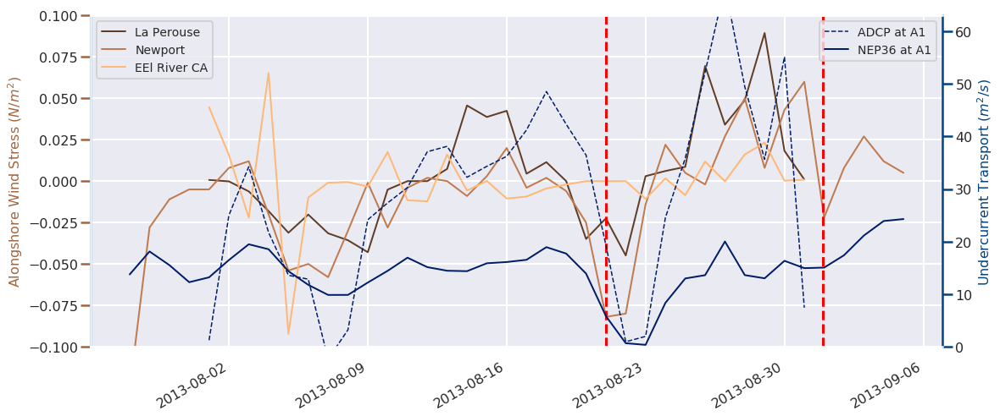

In [50]:
print("Corrected Rotation and corrected Transport")


step = 1
window_size_1 = 24



time_axis = datetime_2013[::step]


s_v_newport = v_wind_newport[:]   
filt_v_newport = smooth(s_v_newport,window_size_1,'hanning')
Newport_stress = np.sign(filt_v_newport)*stress(sp=filt_v_newport)



s_v = v_wind[:]   
filt_v = smooth(s_v,window_size_1,'hanning')
La_perouse_stress = np.sign(filt_v)*stress(sp=filt_v)




fig, ax2 = plt.subplots(1, 1, figsize=(18,8))


ax2.plot(mydates_Newport , La_perouse_stress_daily, color = colors[15],linewidth=2, label = 'La Perouse')
# ax2.plot(mydates_Newport, Newport_stress_daily, c = colors[40], linewidth=2, label = 'Newport')
ax2.plot(mydates_Newport_1[207:-116], wind_stress_newport[207:-116], c = colors[30], linewidth=2, label = 'Newport')

ax2.plot(mydates_Newport, eel_stress_daily, c = colors[45], linewidth=2, label = 'EEl River CA')

ax2.set_ylabel('Alongshore Wind Stress ($N/m^2$)', fontsize = 16)
ax2.set_ylim(-0.1, 0.1)
ax2.tick_params(axis='both',labelsize =16, color = colors[25])
ax2.yaxis.label.set_color(colors[25])
ax2.legend(loc = 'upper left', fontsize  =14)
ax2.spines['left'].set_color(colors_speed[25])
# ax2.axhline(y=0, color = 'k')
ax2.axvline(x = mydates_Newport[mydates_Newport == '2013-08-21'], color = 'r', linestyle  = '--')
ax2.axvline(x = time_axis[-1], color = 'r', linestyle  = '--')

fig.autofmt_xdate()


ax1 = ax2.twinx()

ax1.plot(mydates_A1_1, streng, color = colors_speed[20], linewidth=1.5, linestyle = 'dashed', label = 'ADCP at A1')
ax1.plot(mydates[90:-50], streng_model, color = colors_speed[20], linewidth=2, label = 'NEP36 at A1')

ax1.set_ylabel('Undercurrent Transport ($m^2/s$)', fontsize = 16)
ax1.set_ylim(0, 63)
ax1.tick_params(axis='both',labelsize =16, color = colors_speed[25])
ax1.yaxis.label.set_color(colors_speed[25])
ax1.legend(loc = 'upper right', fontsize  =14)
ax1.spines['right'].set_color(colors_speed[25])

ax2.grid()

### For the length of the time of particle tracking for 6 months ending on 26th August

In [1]:
%matplotlib notebook
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import numpy.ma as ma
import glob
from collections import namedtuple, OrderedDict
import netCDF4 as nc
import os
import scipy
import scipy.io as sio
from scipy import interpolate, signal
from pyproj import Proj,transform
import sys
sys.path.append('/ocean/ssahu/CANYONS/wcvi/grid/')
from bathy_common import *
from matplotlib import path
from salishsea_tools import viz_tools
import xarray as xr
from salishsea_tools import nc_tools
import scipy.io as sio
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.cm as cm
import cmocean as cmo
import matplotlib.gridspec as gridspec
%matplotlib inline
from scipy.io import loadmat
from scipy.interpolate import griddata
from dateutil.parser import parse
from salishsea_tools import geo_tools, viz_tools, tidetools, nc_tools

import seaborn as sns
from windrose import plot_windrose
from windrose import WindroseAxes


from dateutil        import parser
from datetime import datetime

/home/ssahu/anaconda3/lib/python3.5/site-packages/xarray/conventions.py:9: FutureWarning: The pandas.tslib module is deprecated and will be removed in a future version.
  from pandas.tslib import OutOfBoundsDatetime


In [2]:
def find_principal_axis_of_dataset_in_degrees(u_data,v_data):
    
    u_perturb = u_data - np.mean(u_data)
    v_perturb = v_data - np.mean(v_data)
    
    coords = np.vstack([u_perturb, v_perturb])

    cov = np.cov(coords)
    
    evals, evecs = np.linalg.eig(cov)

    sort_indices = np.argsort(evals)[::-1]
    
    x_v1, y_v1 = evecs[:, sort_indices[0]]  # Eigenvector with largest eigenvalue
    x_v2, y_v2 = evecs[:, sort_indices[1]]
    
    theta = np.tanh((x_v1)/(y_v1))  
#     rotation_mat = np.matrix([[np.cos(theta), -np.sin(theta)],
#                       [np.sin(theta), np.cos(theta)]])
#     transformed_mat = rotation_mat * coords
#     # plot the transformed blob
#     x_transformed, y_transformed = transformed_mat.A

    return np.rad2deg(theta)

def find_major_eigenvectors(u_data,v_data):
    
    u_data = u_data[~np.isnan(u_data)]
    v_data = v_data[~np.isnan(v_data)]
    
    u_perturb = u_data - np.mean(u_data)
    v_perturb = v_data - np.mean(v_data)
    
    coords = np.vstack([u_perturb, v_perturb])

    cov = np.cov(coords)
    
    evals, evecs = np.linalg.eig(cov)

    sort_indices = np.argsort(evals)[::-1]
    
    x_v1, y_v1 = evecs[:, sort_indices[0]]  # Eigenvector with largest eigenvalue
    x_v2, y_v2 = evecs[:, sort_indices[1]]
    
    return x_v1, y_v1, x_v2, y_v2


    
def U_timeseries_at_WCVI_locations(grid_U):
    
    u_vel = grid_U.variables['uo'][:,:,:,:]

    
    vector_u = namedtuple('vector_u', 'u_vel')

    return vector_u(u_vel)


def V_timeseries_at_WCVI_locations(grid_V):
    
    v_vel = grid_V.variables['vo'][:,:,:,:]

    
    vector_v = namedtuple('vector_v', 'v_vel')

    return vector_v(v_vel)




def uv_wind_timeseries_at_point(grid_weather, j, i, datetimes=False):
    """Return the u and v wind components and time counter values
    at a single grid point from a weather forcing dataset.

    :arg grid_weather: Weather forcing dataset, typically from an
                       :file:`ops_yYYYYmMMdDD.nc` file produced by the
                       :py:mod:`nowcast.workers.grid_to_netcdf` worker.
    :type grid_weather: :py:class:`netCDF4.Dataset`

    :arg int j: j-direction (longitude) index of grid point to get wind
                components at.

    :arg int i: i-direction (latitude) index of grid point to get wind
                components at.

    :arg boolean datetimes: Return time counter values as
                            :py:class:`datetime.datetime` objects if
                            :py:obj:`True`, otherwise return them as
                            :py:class:`arrow.Arrow` objects (the default).

    :returns: 2-tuple of 1-dimensional :py:class:`numpy.ndarray` objects,
              The :py:attr:`u` attribute holds the u-direction wind
              component,
              The :py:attr:`v` attribute holds the v-direction wind
              component,
              and the :py:attr:`time` attribute holds the time counter
              values.
    :rtype: :py:class:`collections.namedtuple`
    """
    u_wind = grid_weather.variables['u_wind'][:, j, i]
    v_wind = grid_weather.variables['v_wind'][:, j, i]
    time = timestamp(grid_weather, range(len(u_wind)))
    if datetimes:
        time = np.array([a.datetime for a in time])
    wind_ts = namedtuple('wind_ts', 'u, v, time')

    return wind_ts(u_wind, v_wind, np.array(time))

def timestamp(dataset, tindex, time_var='time_counter'):
    """Return the time stamp of the tindex time_counter value(s) in dataset.

    The time stamp is calculated by adding the time_counter[tindex] value
    (in seconds) to the dataset's time_counter.time_origin value.

    :arg dataset: netcdf dataset object
    :type dataset: :py:class:`netCDF4.Dataset`

    :arg tindex: time_counter variable index.
    :type tindex: int or iterable

    :arg time_var: name of the time variable
    :type time_var: str

    :returns: Time stamp value(s) at tindex in the dataset.
    :rtype: :py:class:`Arrow` instance or list of instances
    """
    time_orig = time_origin(dataset, time_var=time_var)
    time_counter = dataset.variables[time_var]
    try:
        iter(tindex)
    except TypeError:
        tindex = [tindex]
    results = []
    for i in tindex:
        try:
            results.append(time_orig + timedelta(seconds=time_counter[i]))
        except IndexError:
            raise IndexError(
                'time_counter variable has no tindex={}'.format(tindex))
    if len(results) > 1:
        return results
    else:

        return results[0]

def time_origin(dataset, time_var='time_counter'):
    """Return the time_var.time_origin value.

    :arg dataset: netcdf dataset object
    :type dataset: :py:class:`netCDF4.Dataset` or :py:class:`xarray.Dataset`

    :arg time_var: name of time variable
    :type time_var: str

    :returns: Value of the time_origin attribute of the time_counter
              variable.
    :rtype: :py:class:`Arrow` instance
    """
    try:
        time_counter = dataset.variables[time_var]
    except KeyError:
        raise KeyError(
            'dataset does not have {time_var} variable'.format(
                time_var=time_var))
    try:
        # netCDF4 dataset
        time_orig = time_counter.time_origin.title()
    except AttributeError:
        try:
            # xarray dataset
            time_orig = time_counter.attrs['time_origin'].title()
        except KeyError:
            raise AttributeError(
                'NetCDF: '
                '{time_var} variable does not have '
                'time_origin attribute'.format(time_var=time_var))
    value = arrow.get(
        time_orig,
        ['YYYY-MMM-DD HH:mm:ss',
         'DD-MMM-YYYY HH:mm:ss',
         'YYYY-MM-DD HH:mm:ss'])

    return value

import numpy

def smooth(x,window_len=24,window='hanning'):
    """smooth the data using a window with requested size.
    
    This method is based on the convolution of a scaled window with the signal.
    The signal is prepared by introducing reflected copies of the signal 
    (with the window size) in both ends so that transient parts are minimized
    in the begining and end part of the output signal.
    
    input:
        x: the input signal 
        window_len: the dimension of the smoothing window; should be an odd integer
        window: the type of window from 'flat', 'hanning', 'hamming', 'bartlett', 'blackman'
            flat window will produce a moving average smoothing.

    output:
        the smoothed signal
        
    example:

    t=linspace(-2,2,0.1)
    x=sin(t)+randn(len(t))*0.1
    y=smooth(x)
    
    see also: 
    
    numpy.hanning, numpy.hamming, numpy.bartlett, numpy.blackman, numpy.convolve
    scipy.signal.lfilter
 
    TODO: the window parameter could be the window itself if an array instead of a string
    NOTE: length(output) != length(input), to correct this: return y[(window_len/2-1):-(window_len/2)] instead of just y.
    """

    if x.ndim != 1:
        raise "smooth only accepts 1 dimension arrays."

    if x.size < window_len:
        raise "Input vector needs to be bigger than window size."


    if window_len<3:
        return x


    if not window in ['flat', 'hanning', 'hamming', 'bartlett', 'blackman']:
        raise "Window is on of 'flat', 'hanning', 'hamming', 'bartlett', 'blackman'"


    s=numpy.r_[x[window_len-1:0:-1],x,x[-2:-window_len-1:-1]]
    #print(len(s))
    if window == 'flat': #moving average
        w=numpy.ones(window_len,'d')
    else:
        w=eval('numpy.'+window+'(window_len)')

    y=numpy.convolve(w/w.sum(),s, mode='same')
    
    return y[window_len - 1:-window_len + 1]

    
def df_derived_by_shift(df,lag=0,NON_DER=[]):
    df = df.copy()
    if not lag:
        return df
    cols ={}
    for i in np.arange(1,lag+1):
        for x in list(df.columns):
            if x not in NON_DER:
                if not x in cols:
                    cols[x] = ['{}_{}'.format(x, i)]
                else:
                    cols[x].append('{}_{}'.format(x, i))
    for k,v in cols.items():
        columns = v
        dfn = pd.DataFrame(data=None, columns=columns, index=df.index)    
        i = 1
        for c in columns:
            dfn[c] = df[k].shift(periods=i)
            i+=1
        df = pd.concat([df, dfn], axis=1, join_axes=[df.index])
    return df









"""
Constants
=========
"""

# ---- physical constants
g = 9.8  # 9.7803 in COARE FIXME: change to sw.grav
""" acceleration due to gravity [m s :sup:`-2`] """

sigmaSB = 5.6697e-8
""" Stefan-Boltzmann constant [W m :sup:`-2` K :sup:`-4`] """

eps_air = 0.62197
""" Molecular weight ratio [water air :sup:`-1`] """

CtoK = 273.15  # 273.16
""" Conversion factor for [:math:`^\\circ` C] to [:math:`^\\circ` K] """

gas_const_R = 287.04  # NOTE: 287.1 in COARE
""" Gas constant for dry air [J kg :sup:`-1` K :sup:`-1`] """


# ---- meteorological constants
kappa = 0.4  # NOTE: 0.41
""" von Karman's constant """

charn = Charnock_alpha = 0.011  # NOTE: 0.018
""" Charnock constant. For determining roughness length at sea given friction
velocity, used in Smith formulas for drag coefficient and also in Fairall and
Edson. Ese alpha = 0.011 for open-ocean and alpha = 0.018 for fetch-limited
(coastal) regions."""

R_roughness = 0.11
""" limiting roughness Reynolds for aerodynamically smooth flow """


# ---- defaults suitable for boundary-layer studies
cp = 1004.7
""" heat capacity of air [J kg :sup:`-1` K :sup:`-1`] """

Qsat_coeff = 0.98
""" saturation specific humidity coefficient reduced by 2% over salt water """


# ------ short-wave flux calculations
Solar_const = 1368.0
""" The solar constant [W/m^2] represents a mean of satellite measurements
made over the last sunspot cycle (1979-1995) taken from Coffey et al (1995),
Earth System Monitor, 6, 6-10."""


# ---- long-wave flux calculations
emiss_lw = 0.985
""" long-wave emissivity of ocean from Dickey et al (1994), J. Atmos. Oceanic
Tech., 11, 1057-1076."""

# Default values
P_default = 1020.





def stress(sp, z=5., drag='largepond', rho_air=1.22, Ta=10.):
    """Computes the neutral wind stress.
    Parameters
    ----------
    sp : array_like
         wind speed [m s :sup:`-1`]
    z : float, array_like, optional
        measurement height [m]
    rho_air : array_like, optional
           air density [kg m :sup:`-3`]
    drag : str
           neutral drag by:
           'largepond' <-- default
           'smith'
           'vera'
    Ta : array_like, optional
         air temperature [:math:`^\\circ` C]
    Returns
    -------
    tau : array_like
          wind stress  [N m :sup:`-2`]
    See Also
    --------
    cdn
    Examples
    --------
    >>> from airsea import windstress as ws
    >>> ws.stress([10., 0.2, 12., 20., 30., 50.], 10)
    array([  1.40300000e-01,   5.61200000e-05,   2.23113600e-01,
             8.73520000e-01,   2.67912000e+00,   1.14070000e+01])
    >>> kw = dict(rho_air=1.02, Ta=23.)
    >>> ws.stress([10., 0.2, 12., 20., 30., 50.], 15, 'smith', **kw)
    array([  1.21440074e-01,   5.32531576e-05,   1.88322389e-01,
             6.62091968e-01,   1.85325310e+00,   7.15282267e+00])
    >>> ws.stress([10., 0.2, 12., 20., 30., 50.], 8, 'vera')
    array([  1.50603698e-01,   7.16568379e-04,   2.37758830e-01,
             9.42518454e-01,   3.01119044e+00,   1.36422742e+01])
    References
    ----------
    .. [1] Large and Pond (1981), J. Phys. Oceanog., 11, 324-336.
    .. [2] Smith (1988), J. Geophys. Res., 93, 311-326.
    .. [3] E. Vera (1983) FIXME eqn. 8 in Large, Morzel, and Crawford (1995),
    J. Phys. Oceanog., 25, 2959-2971.
    Modifications: Original from AIR_SEA TOOLBOX, Version 2.0
    03-08-1997: version 1.0
    08-26-1998: version 1.1 (revised by RP)
    04-02-1999: versin 1.2 (air density option added by AA)
    08-05-1999: version 2.0
    11-26-2010: Filipe Fernandes, Python translation.
    """
    z, sp = np.asarray(z), np.asarray(sp)
    Ta, rho_air = np.asarray(Ta), np.asarray(rho_air)

    # Find cd and ustar.
    if drag == 'largepond':
        cd, sp = cdn(sp, z, 'largepond')
    elif drag == 'smith':
        cd, sp = cdn(sp, z, 'smith', Ta)
    elif drag == 'vera':
        cd, sp = cdn(sp, z, 'vera')
    else:
        print('Unknown method')  # FIXME: raise a proper python error

    tau = rho_air * (cd * sp ** 2)

    return tau


def cdn(sp, z, drag='largepond', Ta=10):
    """Computes neutral drag coefficient.
    Methods available are: Large & Pond (1981),  Vera (1983) or Smith (1988)
    Parameters
    ----------
    sp : array_like
         wind speed [m s :sup:`-1`]
    z : float, array_like
        measurement height [m]
    drag : str
           neutral drag by:
           'largepond' <-- default
           'smith'
           'vera'
    Ta : array_like, optional for drag='smith'
         air temperature [:math:`^\\circ` C]
    Returns
    -------
    cd : float, array_like
         neutral drag coefficient at 10 m
    u10 : array_like
          wind speed at 10 m [m s :sup:`-1`]
    See Also
    --------
    stress, spshft, visc_air
    Notes
    -----
    Vera (1983): range of fit to data is 1 to 25 [m s :sup:`-1`].
    Examples
    --------
    >>> from airsea import windstress as ws
    >>> ws.cdn([10., 0.2, 12., 20., 30., 50.], 10)
    (array([ 0.00115,  0.00115,  0.00127,  0.00179,  0.00244,  0.00374]),
     array([ 10. ,   0.2,  12. ,  20. ,  30. ,  50. ]))
    >>> ws.cdn([10., 0.2, 12., 20., 30., 50.], 15, 'vera')
    (array([ 0.00116157,  0.01545237,  0.00126151,  0.00174946,  0.00242021,
            0.00379521]),
     array([  9.66606155,   0.17761896,  11.58297824, 19.18652915,
            28.5750255 ,  47.06117334]))
    >>> ws.cdn([10., 0.2, 12., 20., 30., 50.], 20, 'smith', 20.)
    (array([ 0.00126578,  0.00140818,  0.00136533,  0.00173801,  0.00217435,
            0.00304636]),
     array([  9.41928554,   0.18778865,  11.27787697,  18.65250005,
            27.75712916,  45.6352786 ]))
    References
    ----------
    .. [1] Large and Pond (1981), J. Phys. Oceanog., 11, 324-336.
    .. [2] Smith (1988), J. Geophys. Res., 93, 311-326.
    .. [3] E. Vera (1983) FIXME eqn. 8 in Large, Morzel, and Crawford (1995),
    J. Phys. Oceanog., 25, 2959-2971.
    Modifications: Original from AIR_SEA TOOLBOX, Version 2.0
    03-08-1997: version 1.0
    08-26-1998: version 1.1 (vectorized by RP)
    08-05-1999: version 2.0
    11-26-2010: Filipe Fernandes, Python translation.
    """
    # convert input to numpy array
    sp, z, Ta = np.asarray(sp), np.asarray(z), np.asarray(Ta)

    tol = 0.00001  # Iteration end point.

    if drag == 'largepond':
        a = np.log(z / 10.) / kappa  # Log-layer correction factor.
        u10o = np.zeros(sp.shape)
        cd = 1.15e-3 * np.ones(sp.shape)
        u10 = sp / (1 + a * np.sqrt(cd))
        ii = np.abs(u10 - u10o) > tol

        while np.any(ii):
            u10o = u10
            cd = (4.9e-4 + 6.5e-5 * u10o)  # Compute cd(u10).
            cd[u10o < 10.15385] = 1.15e-3
            u10 = sp / (1 + a * np.sqrt(cd))  # Next iteration.
            # Keep going until iteration converges.
            ii = np.abs(u10 - u10o) > tol

    elif drag == 'smith':
        visc = visc_air(Ta)

        # Remove any sp==0 to prevent division by zero
        # i = np.nonzero(sp == 0)
        # sp[i] = 0.1 * np.ones(len(i)) FIXME

        # initial guess
        ustaro = np.zeros(sp.shape)
        ustarn = 0.036 * sp

        # iterate to find z0 and ustar
        ii = np.abs(ustarn - ustaro) > tol
        while np.any(ii):
            ustaro = ustarn
            z0 = Charnock_alpha * ustaro ** 2 / g + R_roughness * visc / ustaro
            ustarn = sp * (kappa / np.log(z / z0))
            ii = np.abs(ustarn - ustaro) > tol

        sqrcd = kappa / np.log(10. / z0)
        cd = sqrcd ** 2
        u10 = ustarn / sqrcd
    elif drag == 'vera':
        # constants in fit for drag coefficient
        A = 2.717e-3
        B = 0.142e-3
        C = 0.0764e-3

        a = np.log(z / 10.) / kappa  # Log-layer correction factor.
        # Don't start iteration at 0 to prevent blowups.
        u10o = np.zeros(sp.shape) + 0.1
        cd = A / u10o + B + C * u10o
        u10 = sp / (1 + a * np.sqrt(cd))

        ii = np.abs(u10 - u10o) > tol
        while np.any(ii):
            u10o = u10
            cd = A / u10o + B + C * u10o
            u10 = sp / (1 + a * np.sqrt(cd))  # Next iteration.
            # Keep going until iteration converges.
            ii = np.abs(u10 - u10o) > tol
    else:
        print('Unknown method')  # FIXME: raise a proper python error.

    return cd, u10


def get_alongshore_currents(u_curr, v_curr):
    
    pri_angle    = find_principal_axis_of_dataset_in_degrees(u_data=u_curr, v_data=v_curr)
    pri_angle    = np.radians(pri_angle)
#     direc        = 90 - np.rad2deg(np.arctan(v_curr/u_curr))
#     Speed_curr   = np.sqrt(u_curr**2 + v_curr**2)
    
    coords = np.vstack([u_curr, v_curr])
    
    rotation_mat = np.matrix([[np.cos(pri_angle), -np.sin(pri_angle)],
                  [np.sin(pri_angle), np.cos(pri_angle)]])
    transformed_mat = rotation_mat * coords
    
    alongshore_rot = transformed_mat[1,:]
    
    alongshore_rot = alongshore_rot.tolist()
    
    
    
    
    
#     dir_new      = direc - pri_angle
    
#     alongshore_rot = np.empty_like(dir_new)
#     alongshore_rot[:] = np.multiply(Speed_curr[:],np.sin(np.deg2rad(dir_new)))
    
    return alongshore_rot[0]

def nan_helper(y):
    """Helper to handle indices and logical indices of NaNs.

    Input:
        - y, 1d numpy array with possible NaNs
    Output:
        - nans, logical indices of NaNs
        - index, a function, with signature indices= index(logical_indices),
          to convert logical indices of NaNs to 'equivalent' indices
    Example:
        >>> # linear interpolation of NaNs
        >>> nans, x= nan_helper(y)
        >>> y[nans]= np.interp(x(nans), x(~nans), y[~nans])
    """

    return np.isnan(y), lambda z: z.nonzero()[0]
    
    
def calculate_strength_of_adcp_undercurrent(t, adcp_alongshore, adcp_depths):
       
    ind  = np.array(np.where(adcp_alongshore[:] > 0))
    
    if (ind.size == 0) == False:

        mean_undercurr = np.mean(adcp_alongshore[ind])

        if ind[0][0] !=  ind[0][-1]:

            depths_mean = np.mean(adcp_depths[ind[0][0]:ind[0][-1]])

            strength = np.trapz(adcp_alongshore[ind[0][0]:ind[0][-1]], adcp_depths[ind[0][0]:ind[0][-1]])


        else:
            depths_mean = adcp_depths[ind[0][0]]
            
    else:
        strength = 0

#     strength = np.multiply(mean_undercurr,depths_mean)
        
    return strength



def calculate_strength_of_model_undercurrent(t, model_alongshore, model_depths):

    ind  = np.array(np.where(model_alongshore[20:] > 0))
    
    if (ind.size == 0) == False:
        
        if ind[0][0] !=  ind[0][-1]:

            mean_undercurr = np.mean(model_alongshore[20+ind[0][0]:20+ind[0][-1]])

            depths_mean = np.absolute(np.mean(zlevels[20+ind[0][0]:20+ind[0][-1]]))

            strength = np.trapz(model_alongshore[20+ind[0][0]:20+ind[0][-1]], zlevels[20+ind[0][0]:20+ind[0][-1]])
            
            if np.ma.is_masked(strength) ==  True:
            
                strength = np.multiply(depths_mean, mean_undercurr)

        else:
            depths_mean = np.absolute(zlevels[20+ind[0][0]])
            mean_undercurr = np.absolute(model_alongshore[20+ind[0][0]])
            strength = np.multiply(depths_mean, mean_undercurr)
            
    else:
        strength = 0

#     strength = np.multiply(mean_undercurr,depths_mean)
        
    return strength


In [3]:
sns.set_context('poster')
sns.set_style('dark')

In [4]:
newport_data = pd.read_table('/data/ssahu/Falkor_2013/winds/Newport_winds_unfiltered.csv', delim_whitespace=1, parse_dates= True, header = None, skiprows=2)

# a = orford_data[0].str.split(',', expand=True)

# b = orford_data[1].str.split(',', expand=True)

# df_La_Peruse = pd.concat([a, b], axis=1)

df_cut = newport_data.drop(newport_data.columns[7:], axis=1)
columns = ['Year','Month','Day','Hour','Min','Wind Direction (deg)','Wind Speed','GDR','GST','GTIME']
effective = columns[:7]
df_cut.columns = effective


df_cut['Year']   = df_cut['Year'].astype(str)
df_cut['Day']    = df_cut['Day'].astype(str)
df_cut['Month']  = df_cut['Month'].astype(str)
df_cut['Hour']   = df_cut["Hour"].astype(str)

df_cut.columns = df_cut.columns.str.replace(' ', '')



df_cut['Datetime'] = df_cut['Year'] + "-" + df_cut['Month'] + "-" + df_cut['Day']+ " " + df_cut["Hour"] + ":00:00"

df_cut["Datetime"] = pd.to_datetime(df_cut["Datetime"])


df_cut = df_cut.iloc[:,4:]

df_cut = df_cut.set_index(pd.DatetimeIndex(df_cut["Datetime"]))

In [5]:
# df_cut.tail(10)

df_subset = df_cut.loc['2013-02-28 01:00:00':'2013-08-31 23:00:00']

df_subset = df_subset.resample('60T').mean().reset_index()


newport_datetime = df_subset['Datetime']

df_subset.head(5)

,Datetime,Min,WindDirection(deg),WindSpeed
0,2013-02-28 01:00:00,25.0,181.666667,7.350000
1,2013-02-28 02:00:00,25.0,175.666667,8.116667
2,2013-02-28 03:00:00,25.0,175.500000,8.450000
3,2013-02-28 04:00:00,25.0,178.166667,8.700000
4,2013-02-28 05:00:00,25.0,179.833333,9.933333


In [6]:
ws_newport = df_subset['WindSpeed']
wd_newport = df_subset['WindDirection(deg)']


u_wind_newport = np.multiply(ws_newport[:],np.cos(wd_newport))

v_wind_newport = np.multiply(ws_newport[:],np.sin(wd_newport))

In [7]:
df_subset_daily = df_cut.loc['2013-02-28 01:00:00':'2013-08-31 23:00:00']

df_subset_daily = df_subset_daily.resample('D').mean().reset_index()

df_subset_daily.head(5)

,Datetime,Min,WindDirection(deg),WindSpeed
0,2013-02-28,25.000000,195.028986,8.778986
1,2013-03-01,25.000000,190.819444,7.380556
2,2013-03-02,25.285714,208.578571,3.580714
3,2013-03-03,25.000000,188.826389,6.559028
4,2013-03-04,25.000000,85.409722,7.185417


In [8]:
ws_newport_daily = df_subset_daily['WindSpeed']
wd_newport_daily = df_subset_daily['WindDirection(deg)']


u_wind_newport_daily = np.multiply(ws_newport_daily[:],np.cos(wd_newport_daily))

v_wind_newport_daily = np.multiply(ws_newport_daily[:],np.sin(wd_newport_daily))

In [9]:
La_Peruse_data = pd.read_table('/data/ssahu/Falkor_2013/winds/La_persue_wave_buoy.csv',delim_whitespace=1,header = None, skiprows=7)

a = La_Peruse_data[0].str.split(',', expand=True)

b = La_Peruse_data[1].str.split(',', expand=True)

df_La_Peruse = pd.concat([a, b], axis=1)

df_cut = df_La_Peruse.drop(df_La_Peruse.columns[14:], axis=1)

columns = ['STN_ID','DATE','TIME','Qflag','LATITUDE','LONGITUDE','DEPTH','VCAR','VTPK','VWH','VCMX','VTP','WDIR','WSPD','WSS','GSPD','WDIR','WSPD','WSS','GSPD','ATMS','ATMS','DRYT','SSTP']

effective = columns[:14]

df_cut.columns = effective
df_cut = df_cut.drop('Qflag',axis =1)

df_cut['Date_time']= df_cut['DATE'] + " " + df_cut['TIME']

# df_cut = df_cut.drop('DATE', axis=1)
# df_cut = df_cut.drop('TIME', axis=1)

df_cut.tail(5)

,STN_ID,DATE,TIME,LATITUDE,LONGITUDE,DEPTH,VCAR,VTPK,VWH,VCMX,VTP,WDIR,WSPD,Date_time
217137,C46206,06/19/2018,06:38,48.83,126.00,72.00,1.59,11.13,1.60,2.80,11.10,64.00,4.80,06/19/2018 06:38
217138,C46206,06/19/2018,13:38,48.83,126.00,72.00,1.51,11.64,1.40,7.10,11.60,51.00,4.60,06/19/2018 13:38
217139,C46206,06/19/2018,17:38,48.83,126.00,72.00,1.50,11.13,1.30,7.00,11.10,72.00,4.20,06/19/2018 17:38
217140,C46206,06/19/2018,18:38,48.83,126.00,72.00,1.45,15.06,1.40,5.20,15.10,84.00,3.40,06/19/2018 18:38
217141,C46206,06/19/2018,21:38,48.83,126.00,72.00,1.47,10.67,1.50,2.10,10.70,87.00,2.50,06/19/2018 21:38


In [10]:
LA_PERUSE_array = df_cut.as_matrix()

start_index_2013_Feb  = np.transpose(np.array(np.where(LA_PERUSE_array[:,1] == '02/28/2013')))[0,0]

end_index_2013_September  = np.transpose(np.array(np.where(LA_PERUSE_array[:,1] == '08/31/2013')))[-1,0]


In [11]:
wind_spd = LA_PERUSE_array[start_index_2013_Feb:end_index_2013_September,-2].astype(np.float)

wind_dir = LA_PERUSE_array[start_index_2013_Feb:end_index_2013_September,-3].astype(np.float)

u_wind = np.multiply(wind_spd[:],np.cos(wind_dir))

v_wind = np.multiply(wind_spd[:],np.sin(wind_dir))

time_2013 = LA_PERUSE_array[start_index_2013_Feb:end_index_2013_September,-1].astype(str)

datetime_2013 = np.empty_like(time_2013)

for i in np.arange(datetime_2013.shape[0]):
    datetime_2013[i] = datetime.strptime(time_2013[i], '%m/%d/%Y %H:%M')
    
datetime_2013 = datetime_2013.astype(np.datetime64)

In [12]:
datetime_2013

array(['2013-02-28T00:38', '2013-02-28T01:38', '2013-02-28T02:38', ...,
       '2013-08-31T20:38', '2013-08-31T21:38', '2013-08-31T22:38'], dtype='datetime64[m]')

/home/ssahu/anaconda3/lib/python3.5/site-packages/numpy/lib/function_base.py:973: RuntimeWarning: invalid value encountered in greater_equal
  not_smaller_than_edge = (sample[:, i] >= edges[i][-1])


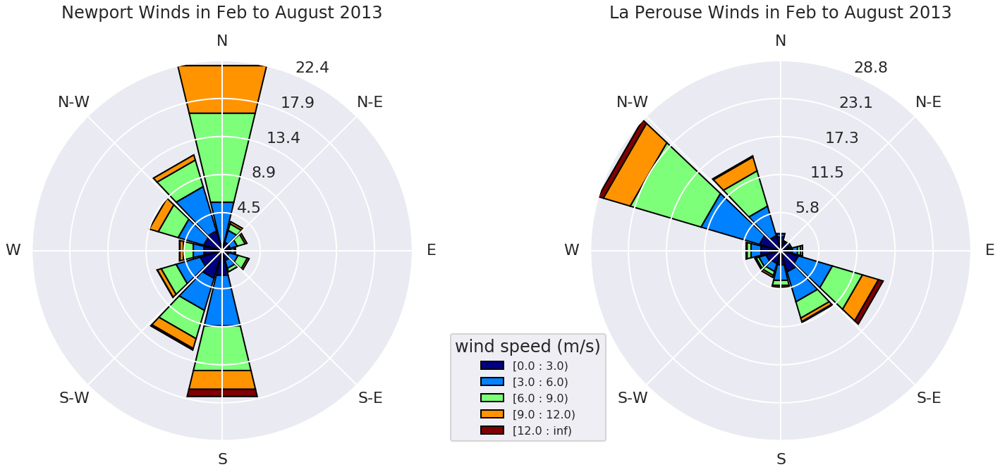

In [13]:

ws_newport = df_subset['WindSpeed']
wd_newport = df_subset['WindDirection(deg)']

ws_La_Perouse = wind_spd
wd_La_Perouse = wind_dir


fig = plt.figure(figsize=(20, 10))
left_rectangle = [0, 0.1, 0.4, 0.75]# [left, bottom, width, height] as a fraction of total figure size
ax1 = WindroseAxes(fig, left_rectangle)  
fig.add_axes(ax1)# creates the axes of specified dimensions

ax1.bar(wd_newport, ws_newport, normed=True, nsector=12, opening=0.9, edgecolor='black', bins=np.arange(0,14,3))#[0,2.5,4.5,8,10,11])
ax1.set_title("Newport Winds in Feb to August 2013", position=(0.5, 1.1))
ax1.set_legend()
ax1.legend(title="wind speed (m/s)", loc=(1.1, 0), fontsize =16)

right_rectangle = [0.5, 0.1, 0.5, 0.75]     # [left, bottom, width, height]
ax = WindroseAxes(fig, right_rectangle)
fig.add_axes(ax)
ax.bar(wd_La_Perouse, ws_La_Perouse, normed=True, nsector=12,opening=0.9, edgecolor='black', bins=np.arange(0,14,3))#[0,2.5,4.5,8,10,11])
ax.set_title("La Perouse Winds in Feb to August 2013", position=(0.5, 1.1))
# ax.legend(None)
# ax.set_legend(False)
# ax.get_legend().remove()
# ax.legend(title="wind speed (m/s)", loc=(1.1, 0), fontsize =16)

In [14]:
theta = find_principal_axis_of_dataset_in_degrees(u_data=u_wind, v_data=v_wind)

x_v1, y_v1, x_v2, y_v2 = find_major_eigenvectors(u_data=u_wind, v_data=v_wind)


x_v1_new, y_v1_new, x_v2_new, y_v2_new = find_major_eigenvectors(u_data=u_wind_newport, v_data=v_wind_newport)


/home/ssahu/anaconda3/lib/python3.5/site-packages/numpy/lib/function_base.py:973: RuntimeWarning: invalid value encountered in greater_equal
  not_smaller_than_edge = (sample[:, i] >= edges[i][-1])


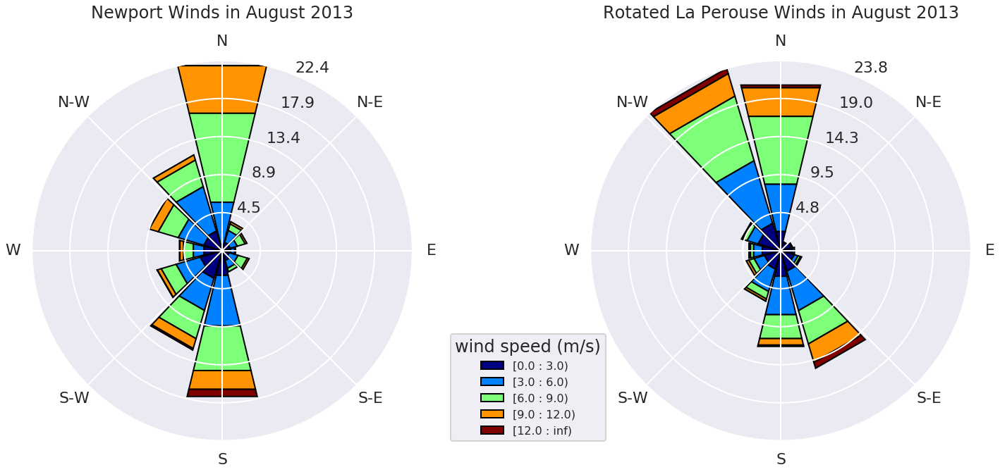

In [15]:

ws_newport = df_subset['WindSpeed']
wd_newport = df_subset['WindDirection(deg)']

ws_La_Perouse = wind_spd
wd_La_Perouse = wind_dir


fig = plt.figure(figsize=(20, 10))
left_rectangle = [0, 0.1, 0.4, 0.75]# [left, bottom, width, height] as a fraction of total figure size
ax1 = WindroseAxes(fig, left_rectangle)  
fig.add_axes(ax1)# creates the axes of specified dimensions

ax1.bar(wd_newport, ws_newport, normed=True, nsector=12, opening=0.9, edgecolor='black', bins=np.arange(0,14,3))#[0,2.5,4.5,8,10,11])
ax1.set_title("Newport Winds in August 2013", position=(0.5, 1.1))
ax1.set_legend()
ax1.legend(title="wind speed (m/s)", loc=(1.1, 0), fontsize =16)

right_rectangle = [0.5, 0.1, 0.5, 0.75]     # [left, bottom, width, height]
ax = WindroseAxes(fig, right_rectangle)
fig.add_axes(ax)
ax.bar(wd_La_Perouse - theta, ws_La_Perouse, normed=True, nsector=12,opening=0.9, edgecolor='black', bins=np.arange(0,14,3))#[0,2.5,4.5,8,10,11])
ax.set_title("Rotated La Perouse Winds in August 2013", position=(0.5, 1.1))
# ax.legend(None)
# ax.set_legend(False)
# ax.get_legend().remove()
# ax.legend(title="wind speed (m/s)", loc=(1.1, 0), fontsize =16)

In [16]:
theta = find_principal_axis_of_dataset_in_degrees(u_data=u_wind, v_data=v_wind)


wind_spd = LA_PERUSE_array[start_index_2013_Feb:end_index_2013_September,-2].astype(np.float)

wind_dir = LA_PERUSE_array[start_index_2013_Feb:end_index_2013_September,-3].astype(np.float)

v_wind_rot = np.empty_like(wind_dir)

v_wind_rot[:] = -1*np.multiply(wind_spd[:],np.cos(np.deg2rad(wind_dir[:] - theta)))

# v_wind_rot = np.multiply(wind_spd[:],np.sin(np.deg2rad(wind_dir[:] - 57)))

time_2013 = LA_PERUSE_array[start_index_2013_Feb:end_index_2013_September,-1].astype(str)

datetime_2013 = np.empty_like(time_2013)

for i in np.arange(datetime_2013.shape[0]):
    datetime_2013[i] = datetime.strptime(time_2013[i], '%m/%d/%Y %H:%M')
    
datetime_2013 = datetime_2013.astype(np.datetime64)

In [17]:
range = pd.date_range('2013-02-28', '2013-08-31', freq='D')



La_perouse_series = pd.Series(v_wind_rot, index=datetime_2013)
daily_north_La_Perouse = La_perouse_series.resample('D').mean()

La_perouse_stress_daily = np.sign(daily_north_La_Perouse)*stress(sp=daily_north_La_Perouse)


In [18]:
range = pd.date_range('2013-02-28', '2013-08-31', freq='D')



Newport_series_daily = pd.Series(v_wind_newport_daily)
# Newport_series = pd.Series(data=np.array(v_wind_newport[:]), index=datetime_2013_newport)
# Newport_series_daily = Newport_series.resample('D').mean()#.reset_index()


Newport_stress_daily = np.sign(-Newport_series_daily)*stress(sp=Newport_series_daily)


In [19]:
date1_Newport = '2013-02-28'
date2_Newport = '2013-08-31'
mydates_Newport = pd.date_range(date1_Newport, date2_Newport, freq= 'D')


In [20]:
colors = cm.copper(np.linspace(0, 1, 50))

colors_speed = cm.ocean(np.linspace(0, 1, 50))

In [21]:
mat_file = '/data/ssahu/Falkor_2013/winds/wind_Newport_2013_v6.mat'

mat = scipy.io.loadmat(mat_file)

wind_stress_newport = mat['tau'][:,0]



date1_Newport = '2013-02-28'
date2_Newport = '2013-08-31'
mydates_Newport_1 = pd.date_range(date1_Newport, date2_Newport, freq= 'D')



# import tables
# file = tables.open_file(mat_file, mode='r')



In [22]:
date1 = '2013-04-29'
date2 = '2013-10-25'
mydates = pd.date_range(date1, date2, freq= 'D')

In [23]:
wind_stress_newport.shape

(363,)

In [24]:
mydates_Newport_1.shape

(185,)

In [25]:
185+58

243

In [25]:
np.arange(58,185+58).shape

(185,)

Corrected Rotation and corrected Transport


/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:473: RuntimeWarning: invalid value encountered in greater
/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:478: RuntimeWarning: invalid value encountered in less
/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:481: RuntimeWarning: invalid value encountered in greater
/home/ssahu/anaconda3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


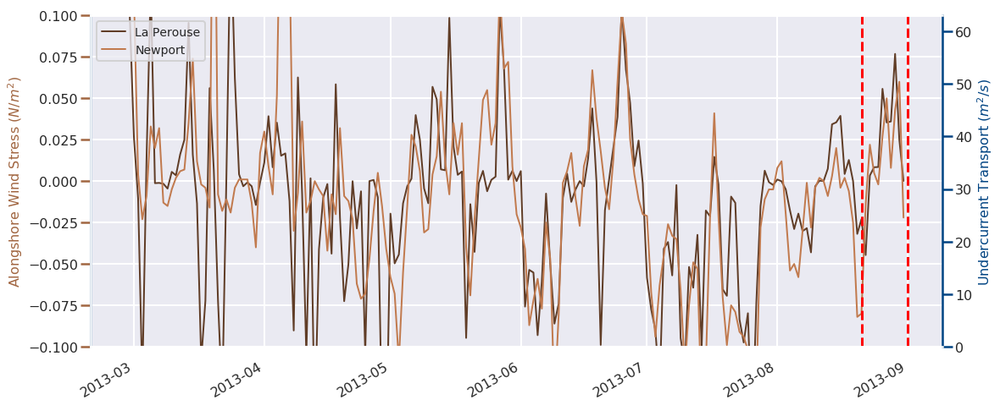

In [26]:
print("Corrected Rotation and corrected Transport")


step = 1
window_size_1 = 24



time_axis = datetime_2013[::step]


s_v_newport = v_wind_newport[:]   
filt_v_newport = smooth(s_v_newport,window_size_1,'hanning')
Newport_stress = np.sign(filt_v_newport)*stress(sp=filt_v_newport)



s_v = v_wind[:]   
filt_v = smooth(s_v,window_size_1,'hanning')
La_perouse_stress = np.sign(filt_v)*stress(sp=filt_v)




fig, ax2 = plt.subplots(1, 1, figsize=(18,8))


ax2.plot(mydates_Newport , La_perouse_stress_daily, color = colors[15],linewidth=2, label = 'La Perouse')
# ax2.plot(mydates_Newport, Newport_stress_daily, c = colors[40], linewidth=2, label = 'Newport')
ax2.plot(mydates_Newport_1, wind_stress_newport[58:243], c = colors[30], linewidth=2, label = 'Newport')

# ax2.plot(mydates_Newport, eel_stress_daily, c = colors[45], linewidth=2, label = 'EEl River CA')

ax2.set_ylabel('Alongshore Wind Stress ($N/m^2$)', fontsize = 16)
ax2.set_ylim(-0.1, 0.1)
ax2.tick_params(axis='both',labelsize =16, color = colors[25])
ax2.yaxis.label.set_color(colors[25])
ax2.legend(loc = 'upper left', fontsize  =14)
ax2.spines['left'].set_color(colors_speed[25])
# ax2.axhline(y=0, color = 'k')
ax2.axvline(x = mydates_Newport[mydates_Newport == '2013-08-21'], color = 'r', linestyle  = '--')
ax2.axvline(x = time_axis[-1], color = 'r', linestyle  = '--')

fig.autofmt_xdate()


ax1 = ax2.twinx()

# ax1.plot(mydates_A1_1, streng, color = colors_speed[20], linewidth=1.5, linestyle = 'dashed', label = 'ADCP at A1')
# ax1.plot(mydates[90:-50], streng_model, color = colors_speed[20], linewidth=2, label = 'NEP36 at A1')

ax1.set_ylabel('Undercurrent Transport ($m^2/s$)', fontsize = 16)
ax1.set_ylim(0, 63)
ax1.tick_params(axis='both',labelsize =16, color = colors_speed[25])
ax1.yaxis.label.set_color(colors_speed[25])
ax1.legend(loc = 'upper right', fontsize  =14)
ax1.spines['right'].set_color(colors_speed[25])

ax2.grid()

In [26]:
A1_data = pd.read_table('/data/ssahu/IOS_data/ADCP_E1_A1/a1_20130507_20140512_0456m.csv',delim_whitespace=1,header = None, skiprows=438)

str_stuff = np.array(['Record_Number', 'Date', 'Time', 'Pitch', 'Roll', 'Heading', 'Pressure', 'Temperature'], dtype = 'str')

bin_depths = np.array([80.13,
         96.13,
        112.13,
        128.13,
        144.13,
        160.13,
        176.13,
        192.13,
        208.13,
        224.13,
        240.13,
        256.13,
        272.13,
        288.13,
        304.13,
        320.13,
        336.13,
        352.13,
        368.13,
        384.13,
        400.13,
        416.13,
        432.13], dtype = 'str')

variables = np.array(['vel_north', 'vel_east', 'vel_vert', 'back_scatter_mean'], dtype = 'str')

column_data = []

for j in bin_depths:
    for i in variables:
        column_data = np.append(arr=column_data, values=i+'_'+j)
    

columns_A1 = np.concatenate((str_stuff, column_data), axis = 0)

A1_data.columns = columns_A1

In [27]:
vel_north_80 = np.array(A1_data['vel_north_80.13'], dtype = np.float)[0:5608]
vel_east_80  = np.array(A1_data['vel_east_80.13'], dtype = np.float)[0:5608]
mag_80       = np.sqrt(vel_east_80**2+vel_north_80**2)
mag_80[mag_80 > 2] = 'Nan'

vel_north_96= np.array(A1_data['vel_north_96.13'], dtype = np.float)[0:5608]
vel_east_96 = np.array(A1_data['vel_east_96.13'], dtype = np.float)[0:5608]
mag_96       = np.sqrt(vel_east_96**2+vel_north_96**2)
mag_96[mag_96 > 2] = 'Nan'

vel_north_112 = np.array(A1_data['vel_north_112.13'], dtype = np.float)[0:5608]
vel_east_112  = np.array(A1_data['vel_east_112.13'], dtype = np.float)[0:5608]
mag_112       = np.sqrt(vel_east_112**2+vel_north_112**2)
mag_112[mag_112 > 2] = 'Nan'

vel_north_128 = np.array(A1_data['vel_north_128.13'], dtype = np.float)[0:5608]
vel_east_128  = np.array(A1_data['vel_east_128.13'], dtype = np.float)[0:5608]
mag_128       = np.sqrt(vel_east_128**2+vel_north_128**2)
mag_128[mag_128 > 2] = 'Nan'

vel_north_144 = np.array(A1_data['vel_north_144.13'], dtype = np.float)[0:5608]
vel_east_144  = np.array(A1_data['vel_east_144.13'], dtype = np.float)[0:5608]
mag_144       = np.sqrt(vel_east_144**2+vel_north_144**2)

vel_north_160= np.array(A1_data['vel_north_160.13'], dtype = np.float)[0:5608]
vel_east_160 = np.array(A1_data['vel_east_160.13'], dtype = np.float)[0:5608]
mag_160       = np.sqrt(vel_east_160**2+vel_north_160**2)
mag_160[mag_160 > 2] = 'Nan'

vel_north_176= np.array(A1_data['vel_north_176.13'], dtype = np.float)[0:5608]
vel_east_176 = np.array(A1_data['vel_east_176.13'], dtype = np.float)[0:5608]
mag_176       = np.sqrt(vel_east_176**2+vel_north_176**2)
mag_176[mag_176 > 2] = 'Nan'

vel_north_192 = np.array(A1_data['vel_north_192.13'], dtype = np.float)[0:5608]
vel_east_192  = np.array(A1_data['vel_east_192.13'], dtype = np.float)[0:5608]
mag_192      = np.sqrt(vel_east_192**2+vel_north_192**2)

vel_north_208 = np.array(A1_data['vel_north_208.13'], dtype = np.float)[0:5608]
vel_east_208  = np.array(A1_data['vel_east_208.13'], dtype = np.float)[0:5608]
mag_208      = np.sqrt(vel_east_208**2+vel_north_208**2)

vel_north_224 = np.array(A1_data['vel_north_224.13'], dtype = np.float)[0:5608]
vel_east_224 = np.array(A1_data['vel_east_224.13'], dtype = np.float)[0:5608]
mag_224      = np.sqrt(vel_east_224**2+vel_north_224**2)

vel_north_240 = np.array(A1_data['vel_north_240.13'], dtype = np.float)[0:5608]
vel_east_240 = np.array(A1_data['vel_east_240.13'], dtype = np.float)[0:5608]
mag_240      = np.sqrt(vel_east_240**2+vel_north_240**2)

vel_north_256 = np.array(A1_data['vel_north_256.13'], dtype = np.float)[0:5608]
vel_east_256 = np.array(A1_data['vel_east_256.13'], dtype = np.float)[0:5608]
mag_256      = np.sqrt(vel_east_256**2+vel_north_256**2)

vel_north_272 = np.array(A1_data['vel_north_272.13'], dtype = np.float)[0:5608]
vel_east_272 = np.array(A1_data['vel_east_272.13'], dtype = np.float)[0:5608]
mag_272      = np.sqrt(vel_east_272**2+vel_north_272**2)

vel_north_288 = np.array(A1_data['vel_north_288.13'], dtype = np.float)[0:5608]
vel_east_288 = np.array(A1_data['vel_east_288.13'], dtype = np.float)[0:5608]
mag_288      = np.sqrt(vel_east_288**2+vel_north_288**2)

vel_north_304 = np.array(A1_data['vel_north_304.13'], dtype = np.float)[0:5608]
vel_east_304 = np.array(A1_data['vel_east_304.13'], dtype = np.float)[0:5608]
mag_304      = np.sqrt(vel_east_304**2+vel_north_304**2)

vel_north_320 = np.array(A1_data['vel_north_320.13'], dtype = np.float)[0:5608]
vel_east_320 = np.array(A1_data['vel_east_320.13'], dtype = np.float)[0:5608]
mag_320      = np.sqrt(vel_east_320**2+vel_north_320**2)

vel_north_336 = np.array(A1_data['vel_north_336.13'], dtype = np.float)[0:5608]
vel_east_336 = np.array(A1_data['vel_east_336.13'], dtype = np.float)[0:5608]
mag_336      = np.sqrt(vel_east_336**2+vel_north_336**2)

vel_north_352 = np.array(A1_data['vel_north_352.13'], dtype = np.float)[0:5608]
vel_east_352 = np.array(A1_data['vel_east_352.13'], dtype = np.float)[0:5608]
mag_352      = np.sqrt(vel_east_352**2+vel_north_352**2)


vel_north_368 = np.array(A1_data['vel_north_368.13'], dtype = np.float)[0:5608]
vel_east_368 = np.array(A1_data['vel_east_368.13'], dtype = np.float)[0:5608]
mag_368      = np.sqrt(vel_east_368**2+vel_north_368**2)

vel_north_384 = np.array(A1_data['vel_north_384.13'], dtype = np.float)[0:5608]
vel_east_384 = np.array(A1_data['vel_east_384.13'], dtype = np.float)[0:5608]
mag_384      = np.sqrt(vel_east_384**2+vel_north_384**2)


vel_north_400 = np.array(A1_data['vel_north_400.13'], dtype = np.float)[0:5608]
vel_east_400 = np.array(A1_data['vel_east_400.13'], dtype = np.float)[0:5608]
mag_400      = np.sqrt(vel_east_400**2+vel_north_400**2)

vel_north_416 = np.array(A1_data['vel_north_416.13'], dtype = np.float)[0:5608]
vel_east_416 = np.array(A1_data['vel_east_416.13'], dtype = np.float)[0:5608]
mag_416      = np.sqrt(vel_east_416**2+vel_north_416**2)

vel_north_432 = np.array(A1_data['vel_north_432.13'], dtype = np.float)[0:5608]
vel_east_432 = np.array(A1_data['vel_east_432.13'], dtype = np.float)[0:5608]
mag_432      = np.sqrt(vel_east_432**2+vel_north_432**2)


In [28]:
tarikh = np.array(A1_data['Date'], dtype = np.str)
samai  = np.array(A1_data['Time'], dtype = np.str)

time = np.empty_like(tarikh)

for i in np.arange(tarikh.shape[0]):
    time[i] = tarikh[i] + '' + samai[i]


datetime_A1 = np.empty_like(time)

for i in np.arange(datetime_A1.shape[0]):
    datetime_A1[i] = datetime.strptime(time[i], '%Y/%m/%d%H:%M:%S')
    
datetime_A1 = datetime_A1.astype(np.datetime64)


In [29]:
mydates_A1 = np.array(pd.date_range(datetime_A1[0:5608][0], datetime_A1[0:5608][-1], freq="30min"))

In [30]:
mydates_A1.shape

(5608,)

In [31]:
mag_112.shape

(5608,)

In [32]:
A1_series_east = pd.Series(vel_east_80[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_80_daily_east = daily_east.values
east_80 = np.divide(vel_80_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_80[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_80_daily_north = daily_north.values
north_80 = np.divide(vel_80_daily_north[:], 24)


Speed_80 = np.sqrt(east_80**2 + north_80**2)

A1_series_east = pd.Series(vel_east_96[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_96_daily_east = daily_east.values
east_96 = np.divide(vel_96_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_96[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_96_daily_north = daily_north.values
north_96 = np.divide(vel_96_daily_north[:], 24)


Speed_96 = np.sqrt(east_96**2 + north_96**2)

A1_series_east = pd.Series(vel_east_112[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_112_daily_east = daily_east.values
east_112 = np.divide(vel_112_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_112[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_112_daily_north = daily_north.values
north_112 = np.divide(vel_112_daily_north[:], 24)


Speed_112 = np.sqrt(east_112**2 + north_112**2)

A1_series_east = pd.Series(vel_east_128[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_128_daily_east = daily_east.values
east_128 = np.divide(vel_128_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_128[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_128_daily_north = daily_north.values
north_128 = np.divide(vel_128_daily_north[:], 24)


Speed_128 = np.sqrt(east_128**2 + north_128**2)


A1_series_east = pd.Series(vel_east_144[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_144_daily_east = daily_east.values
east_144 = np.divide(vel_144_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_144[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_144_daily_north = daily_north.values
north_144 = np.divide(vel_144_daily_north[:], 24)


Speed_144 = np.sqrt(east_144**2 + north_144**2)


A1_series_east = pd.Series(vel_east_160[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_160_daily_east = daily_east.values
east_160 = np.divide(vel_160_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_160[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_160_daily_north = daily_north.values
north_160 = np.divide(vel_160_daily_north[:], 24)


Speed_160 = np.sqrt(east_160**2 + north_160**2)

A1_series_east = pd.Series(vel_east_176[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_176_daily_east = daily_east.values
east_176 = np.divide(vel_176_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_176[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_176_daily_north = daily_north.values
north_176 = np.divide(vel_176_daily_north[:], 24)


Speed_176 = np.sqrt(east_176**2 + north_176**2)


A1_series_east = pd.Series(vel_east_192[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_192_daily_east = daily_east.values
east_192 = np.divide(vel_192_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_192[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_192_daily_north = daily_north.values
north_192 = np.divide(vel_192_daily_north[:], 24)


Speed_192 = np.sqrt(east_192**2 + north_192**2)


A1_series_east = pd.Series(vel_east_208[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_208_daily_east = daily_east.values
east_208 = np.divide(vel_208_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_208[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_208_daily_north = daily_north.values
north_208 = np.divide(vel_208_daily_north[:], 24)


Speed_208 = np.sqrt(east_208**2 + north_208**2)


A1_series_east = pd.Series(vel_east_224[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_224_daily_east = daily_east.values
east_224 = np.divide(vel_224_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_224[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_224_daily_north = daily_north.values
north_224 = np.divide(vel_224_daily_north[:], 24)


Speed_224 = np.sqrt(east_224**2 + north_224**2)


A1_series_east = pd.Series(vel_east_240[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_240_daily_east = daily_east.values
east_240 = np.divide(vel_240_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_240[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_240_daily_north = daily_north.values
north_240 = np.divide(vel_240_daily_north[:], 24)


Speed_240 = np.sqrt(east_240**2 + north_240**2)


A1_series_east = pd.Series(vel_east_256[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_256_daily_east = daily_east.values
east_256 = np.divide(vel_256_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_256[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_256_daily_north = daily_north.values
north_256 = np.divide(vel_256_daily_north[:], 24)


Speed_256 = np.sqrt(east_256**2 + north_256**2)


A1_series_east = pd.Series(vel_east_272[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_272_daily_east = daily_east.values
east_272 = np.divide(vel_272_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_272[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_272_daily_north = daily_north.values
north_272 = np.divide(vel_272_daily_north[:], 24)


Speed_272 = np.sqrt(east_272**2 + north_272**2)


A1_series_east = pd.Series(vel_east_288[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_288_daily_east = daily_east.values
east_288 = np.divide(vel_288_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_288[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_288_daily_north = daily_north.values
north_288 = np.divide(vel_288_daily_north[:], 24)


Speed_288 = np.sqrt(east_288**2 + north_288**2)


# A1_series_east = pd.Series(vel_east_304[1200:2560], index=mydates_A1)
# daily_east = A1_series_east.resample('1440T').sum()
# vel_304_daily_east = daily_east.values
# east_304 = np.divide(vel_304_daily_east[:], 24)

# A1_series_north = pd.Series(vel_north_304[1200:2560], index=mydates_A1)
# daily_north = A1_series_north.resample('1440T').sum()
# vel_304_daily_north = daily_north.values
# north_304 = np.divide(vel_304_daily_north[:], 24)


# Speed_304 = np.sqrt(east_304**2 + north_304**2)

A1_series_east = pd.Series(vel_east_320[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_320_daily_east = daily_east.values
east_320 = np.divide(vel_320_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_320[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_320_daily_north = daily_north.values
north_320 = np.divide(vel_320_daily_north[:], 24)


Speed_320 = np.sqrt(east_320**2 + north_320**2)


A1_series_east = pd.Series(vel_east_336[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_336_daily_east = daily_east.values
east_336 = np.divide(vel_336_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_336[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_336_daily_north = daily_north.values
north_336 = np.divide(vel_336_daily_north[:], 24)


Speed_336 = np.sqrt(east_336**2 + north_336**2)

A1_series_east = pd.Series(vel_east_352[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_352_daily_east = daily_east.values
east_352 = np.divide(vel_352_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_352[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_352_daily_north = daily_north.values
north_352 = np.divide(vel_352_daily_north[:], 24)


Speed_352 = np.sqrt(east_352**2 + north_352**2)

# A1_series_east = pd.Series(vel_east_368[1200:2560], index=mydates_A1)
# daily_east = A1_series_east.resample('1440T').sum()
# vel_368_daily_east = daily_east.values
# east_368 = np.divide(vel_368_daily_east[:], 24)

# A1_series_north = pd.Series(vel_north_368[1200:2560], index=mydates_A1)
# daily_north = A1_series_north.resample('1440T').sum()
# vel_368_daily_north = daily_north.values
# north_368 = np.divide(vel_368_daily_north[:], 24)


# Speed_368 = np.sqrt(east_368**2 + north_368**2)


A1_series_east = pd.Series(vel_east_384[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_384_daily_east = daily_east.values
east_384 = np.divide(vel_384_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_384[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_384_daily_north = daily_north.values
north_384 = np.divide(vel_384_daily_north[:], 24)


Speed_384 = np.sqrt(east_384**2 + north_384**2)


A1_series_east = pd.Series(vel_east_368[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_368_daily_east = daily_east.values
east_368 = np.divide(vel_368_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_368[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_368_daily_north = daily_north.values
north_368 = np.divide(vel_368_daily_north[:], 24)


Speed_368 = np.sqrt(east_368**2 + north_368**2)


A1_series_east = pd.Series(vel_east_304[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_304_daily_east = daily_east.values
east_304 = np.divide(vel_304_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_304[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_304_daily_north = daily_north.values
north_304 = np.divide(vel_304_daily_north[:], 24)

Speed_304 = np.sqrt(east_304**2 + north_304**2)



A1_series_east = pd.Series(vel_east_400[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_400_daily_east = daily_east.values
east_400 = np.divide(vel_400_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_400[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_400_daily_north = daily_north.values
north_400 = np.divide(vel_400_daily_north[:], 24)


Speed_400 = np.sqrt(east_400**2 + north_400**2)

A1_series_east = pd.Series(vel_east_416[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_416_daily_east = daily_east.values
east_416 = np.divide(vel_416_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_416[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_416_daily_north = daily_north.values
north_416 = np.divide(vel_416_daily_north[:], 24)


Speed_416 = np.sqrt(east_416**2 + north_416**2)


A1_series_east = pd.Series(vel_east_432[:], index=mydates_A1)
daily_east = A1_series_east.resample('1440T').sum()
vel_432_daily_east = daily_east.values
east_432 = np.divide(vel_432_daily_east[:], 24)

A1_series_north = pd.Series(vel_north_432[:], index=mydates_A1)
daily_north = A1_series_north.resample('1440T').sum()
vel_432_daily_north = daily_north.values
north_432 = np.divide(vel_432_daily_north[:], 24)


Speed_432 = np.sqrt(east_432**2 + north_432**2)


In [33]:
Speed_112.shape

(117,)

In [34]:
date1 = '2013-05-07'
date2 = '2013-08-31'
mydates_A1_1 = pd.date_range(date1, date2, freq= 'D')

In [35]:
mydates_A1_1.shape

(117,)

In [36]:
# arrays_east = [east_84, east_100, east_148, east_196, east_228, east_260, east_308, east_340, east_372, east_388]
# arrays_north = [north_84, north_100, north_148, north_196, north_228, north_260, north_308, north_340, north_372, north_388]
# arrays_speed = [Speed_84, Speed_100, Speed_148, Speed_196, Speed_228, Speed_260, Speed_308, Speed_340, Speed_372, Speed_388]

# z_ADCP = [84.44, 100.44, 148.44, 196.44, 228.44, 260.44, 308.44, 340.44, 372.44, 388.44]

arrays_east = [east_80, east_96, east_112, east_128, east_144, east_160, east_176, east_192, east_208,\
               east_224, east_240, east_256, east_272, east_288, east_304, \
               east_320, east_336, east_352, east_368, east_384, east_400, east_416, \
              east_432]
arrays_north = [north_80, north_96, north_112, north_128, north_144, north_160, north_176, north_192, \
                north_208, north_224, north_240, north_256, north_272, north_288, \
                north_304, north_320, north_336, north_352, north_368, north_384, \
               north_400, north_416, north_432]
arrays_speed = [Speed_80, Speed_96, Speed_112, Speed_128, Speed_144, Speed_160, Speed_176, Speed_192, \
                Speed_208, Speed_224, Speed_240, Speed_256, Speed_272, Speed_288, \
                Speed_304, Speed_320, Speed_336, Speed_352, Speed_368, Speed_384, \
               Speed_400, Speed_416, Speed_432]


z_ADCP = np.array(bin_depths.astype(float))

east_ADCP_A_1_august = np.stack(arrays=arrays_east, axis=1)
north_ADCP_A_1_august = np.stack(arrays=arrays_north, axis=1)
speed_ADCP_A_1_august = np.stack(arrays=arrays_speed, axis=1)

In [37]:
from __future__ import division
import glob
import os
import fnmatch
from collections import namedtuple, OrderedDict

import os

zlevels = nc.Dataset('/data/mdunphy/NEP036-N30-OUT/CDF_COMB_COMPRESSED/NEP036-N30_IN_20140915_00001440_grid_T.nc').variables['deptht'][:32]
y_wcvi_slice = np.array(np.arange(180,350))
x_wcvi_slice = np.array(np.arange(480,650))

u_vel = np.empty((240,zlevels.shape[0],y_wcvi_slice.shape[0]+1,x_wcvi_slice.shape[0]+1))
v_vel = np.empty((240,zlevels.shape[0],y_wcvi_slice.shape[0]+1,x_wcvi_slice.shape[0]+1))



i = 0

for file in sorted(glob.glob('/data/ssahu/NEP36_2013_summer_hindcast/two_months_more_velocities_total_for_a_notebook/\
cut_NEP36-S29_1d*grid_U*.nc')):
    vector_u = U_timeseries_at_WCVI_locations(nc.Dataset(file))
    u_vel[i:i+10,...] = vector_u[0]
    i = i+10

j = 0
for file in sorted(glob.glob('/data/ssahu/NEP36_2013_summer_hindcast/two_months_more_velocities_total_for_a_notebook/\
cut_NEP36-S29_1d*grid_V*.nc')):
    vector_v = V_timeseries_at_WCVI_locations(nc.Dataset(file))
    v_vel[j:j+10,...] = vector_v[0]
    j = j+10
    
    
u_tzyx, v_tzyx = viz_tools.unstagger(u_vel, v_vel)

mag_vel = np.sqrt(np.multiply(u_tzyx,u_tzyx) +  np.multiply(v_tzyx,v_tzyx));
ang_vel = np.degrees(np.arctan2(v_tzyx, u_tzyx))

u_unrotated = u_tzyx
v_unrotated = v_tzyx



In [38]:
u_unrotated.shape

(240, 32, 170, 170)

In [39]:

file_model = nc.Dataset('/data/ssahu/NEP36_2013_summer_hindcast/cut_NEP36-S29_1d_20130429_20131025_grid_T_20130429-20130508.nc')

lon = file_model.variables['nav_lon'][1:,1:]
lat = file_model.variables['nav_lat'][1:,1:]

In [40]:

lon_A1 = -126.20433
lat_A1 = 48.52958

j, i = geo_tools.find_closest_model_point(lon_A1,lat_A1,\
                                          lon,lat,grid='NEMO',tols=\
                                          {'NEMO': {'tol_lon': 0.1, 'tol_lat': 0.1},\
                                           'GEM2.5': {'tol_lon': 0.1, 'tol_lat': 0.1}}) 


print(j,i)


89 92


In [41]:
date1 = '2013-02-28'
date2 = '2013-08-31'
mydates_A1_model = pd.date_range(date1, date2, freq= 'D')

In [42]:
mydates_A1_model.shape

(185,)

In [43]:
along_model =np.empty_like(v_unrotated[0:-55,:,j,i])

for k in np.arange(1,along_model.shape[1]):
    along_model[:,k] = get_alongshore_currents(u_curr=u_unrotated[:-55,k,j,i], \
                                                       v_curr= v_unrotated[:-55,k,j,i])
    


In [44]:
along_model.shape

(185, 32)

In [45]:
along_ADCP_A1_august = np.empty_like(north_ADCP_A_1_august)

for k in np.arange(1,along_ADCP_A1_august.shape[1]):
    along_ADCP_A1_august[:,k] = get_alongshore_currents(u_curr=east_ADCP_A_1_august[:,k], \
                                                       v_curr= north_ADCP_A_1_august[:,k])
north_80_rot = along_ADCP_A1_august[:,0] 

In [46]:
along_ADCP_A1_august.shape

(117, 23)

In [47]:
along_ADCP_A1_august[along_ADCP_A1_august<-2] = 'Nan'
along_ADCP_A1_august[along_ADCP_A1_august>2] = 'Nan'

nans = np.where(np.isnan(along_ADCP_A1_august))

for t in np.arange(along_ADCP_A1_august.shape[0]):
    
    nans, adcp_data_x = nan_helper(along_ADCP_A1_august[t,:])
    
    along_ADCP_A1_august[t,nans]= np.interp(adcp_data_x(nans), adcp_data_x(~nans), along_ADCP_A1_august[t,~nans])
    
along_ADCP_A1_august[:,0] = north_80_rot

streng = np.empty((along_ADCP_A1_august.shape[0]))

for t in np.arange(along_ADCP_A1_august.shape[0]):
    streng[t] = calculate_strength_of_adcp_undercurrent(t, adcp_alongshore=along_ADCP_A1_august[t,:],\
                                                          adcp_depths=z_ADCP)




/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:2: RuntimeWarning: invalid value encountered in greater
  from ipykernel import kernelapp as app


In [48]:
streng.shape

(117,)

In [49]:
mydates_A1_1.shape

(117,)

In [50]:
mydates_A1_model.shape

(185,)

In [51]:
streng_model = np.empty((along_model.shape[0]))

for t in np.arange(along_model.shape[0]):
    streng_model[t] = calculate_strength_of_model_undercurrent(t,model_alongshore=along_model[t,:],model_depths=zlevels)

In [52]:
along_model[48,:] >20

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False], dtype=bool)

In [92]:
along_model[t,20:]

array([-0.09331266, -0.06282119, -0.03840524, -0.03514608, -0.02961891,
       -0.01757681, -0.04095941, -0.05923571, -0.06715568, -0.03841517,
        0.00216783,  0.        ])

In [177]:
s_v = La_perouse_stress_daily  
filt_v = smooth(s_v,window_size_1,'hanning')
# La_perouse_stress = np.sign(filt_v)*stress(sp=filt_v)

In [173]:
filt_v

array([  1.01090305e-01,   2.66687053e-02,  -1.05058813e-02,
        -1.21219262e-01,   1.34021633e-02,   1.18889543e-01,
        -1.22972021e-03,  -1.07591374e-03,  -1.57980348e-03,
        -4.50204842e-03,   5.59447505e-03,   3.49851914e-03,
         1.61777643e-02,   2.49592289e-02,   9.55925906e-02,
         1.60036322e-02,  -1.34942419e-02,  -1.08148701e-01,
        -7.21798182e-02,   5.61787923e-02,   6.54859903e-03,
        -7.24546319e-02,  -1.32036473e-01,   3.97749597e-03,
         1.54444981e-01,   6.22667658e-02,   4.11602677e-03,
        -3.09794078e-03,  -7.60714189e-04,  -3.07187797e-03,
        -1.44151220e-02,  -8.10028175e-04,   1.11592079e-02,
         3.92209130e-02,   8.37882065e-03,   3.53082591e-02,
         1.53461546e-02,   1.67449329e-02,  -1.21041640e-02,
        -9.02002110e-02,   6.26125788e-02,  -7.97536448e-03,
        -1.05163550e-01,   1.70108184e-03,  -1.49089968e-01,
        -4.12301709e-02,  -1.00663456e-02,  -1.75528593e-03,
        -4.37975872e-02,

In [167]:
filt_v_model.shape

(185,)

Corrected Rotation and corrected Transport


/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:473: RuntimeWarning: invalid value encountered in greater
/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:478: RuntimeWarning: invalid value encountered in less
/home/ssahu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:481: RuntimeWarning: invalid value encountered in greater


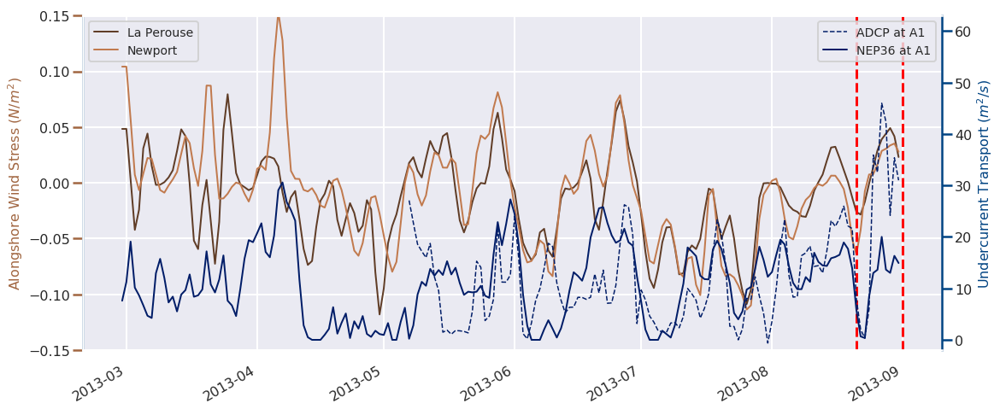

In [53]:
print("Corrected Rotation and corrected Transport")


step = 1
window_size_1 = 6



time_axis = datetime_2013[::step]


s_v_newport = v_wind_newport[:]   
filt_v_newport = smooth(s_v_newport,window_size_1,'hanning')
Newport_stress = np.sign(filt_v_newport)*stress(sp=filt_v_newport)



# s_v = v_wind[:]   
# filt_v = smooth(s_v,window_size_1,'hanning')
# La_perouse_stress = np.sign(filt_v)*stress(sp=filt_v)


s_v = La_perouse_stress_daily  
filt_v_La_Perouse = smooth(s_v,window_size_1,'hanning')

s_v = wind_stress_newport[58:243] 
filt_v_newport = smooth(s_v,window_size_1,'hanning')

fig, ax2 = plt.subplots(1, 1, figsize=(18,8))

ax2.plot(mydates_Newport , filt_v_La_Perouse, color = colors[15],  linewidth=2, label = 'La Perouse')
ax2.plot(mydates_Newport_1, filt_v_newport, c = colors[30], linewidth=2, label = 'Newport')

# ax2.plot(mydates_Newport , La_perouse_stress_daily, color = colors[15],  linewidth=2, label = 'La Perouse')

# ax2.plot(mydates_Newport_1, wind_stress_newport[58:243], c = colors[30], linewidth=2, label = 'Newport')


ax2.set_ylabel('Alongshore Wind Stress ($N/m^2$)', fontsize = 16)
ax2.set_ylim(-0.15, 0.15)
ax2.tick_params(axis='both',labelsize =16, color = colors[25])
ax2.yaxis.label.set_color(colors[25])
ax2.legend(loc = 'upper left', fontsize  =14)
ax2.spines['left'].set_color(colors_speed[25])
# ax2.axhline(y=0, color = 'k')
ax2.axvline(x = mydates_Newport[mydates_Newport == '2013-08-21'], color = 'r', linestyle  = '--')
ax2.axvline(x = time_axis[-1], color = 'r', linestyle  = '--')

fig.autofmt_xdate()


ax1 = ax2.twinx()

ax1.plot(mydates_A1_1, streng, color = colors_speed[20], linewidth=1.5, linestyle = 'dashed', label = 'ADCP at A1')
ax1.plot(mydates_A1_model, streng_model, color = colors_speed[20], linewidth=2, label = 'NEP36 at A1')

ax1.set_ylabel('Undercurrent Transport ($m^2/s$)', fontsize = 16)
ax1.set_ylim(-2, 63)
ax1.tick_params(axis='both',labelsize =16, color = colors_speed[25])
ax1.yaxis.label.set_color(colors_speed[25])
ax1.legend(loc = 'upper right', fontsize  =14)
ax1.spines['right'].set_color(colors_speed[25])

ax2.grid()

In [54]:
sns.set_context('paper')

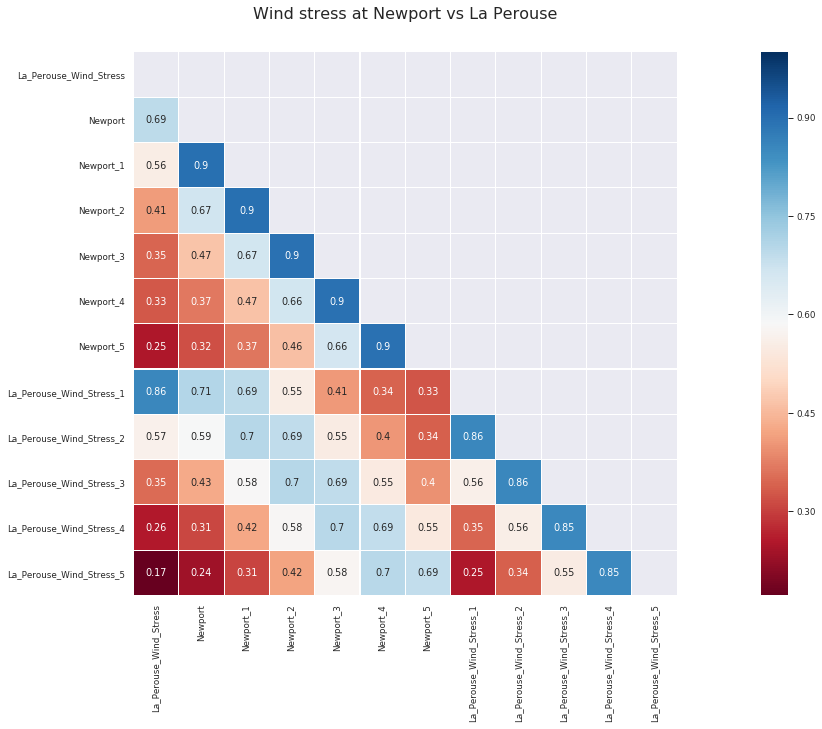

In [196]:
# range = pd.date_range('2013-08-01T00:38', '2013-08-31T22:38', freq='60min')

range = pd.date_range('2013-02-28', '2013-08-31', freq='D')


df = pd.DataFrame(index = range)

df['La_Perouse_Wind_Stress'] = filt_v_La_Perouse#La_perouse_stress_daily

daily_wind_stress = pd.DataFrame()

daily_wind_stress['La_Perouse_Wind_Stress'] = filt_v_La_Perouse#La_perouse_stress_daily
# daily_wind_stress['La Perouse'] = df.La_Perouse_Wind_Stress.resample('D').mean()
daily_wind_stress['Newport'] = filt_v_newport#wind_stress_newport[58:243]

NON_DER = mydates_Newport_1
df_new = df_derived_by_shift(daily_wind_stress, 5, NON_DER)

colormap = plt.cm.RdBu



plt.figure(figsize=(30,10))
plt.title(u'Wind stress at Newport vs La Perouse', y=1.05, size=16)

mask = np.zeros_like(df_new.corr())
mask[np.triu_indices_from(mask)] = True

svm = sns.heatmap(df_new.corr(), mask=mask, linewidths=0.1,vmax=1.0, 
            square=True, cmap=colormap, linecolor='white', annot=True)



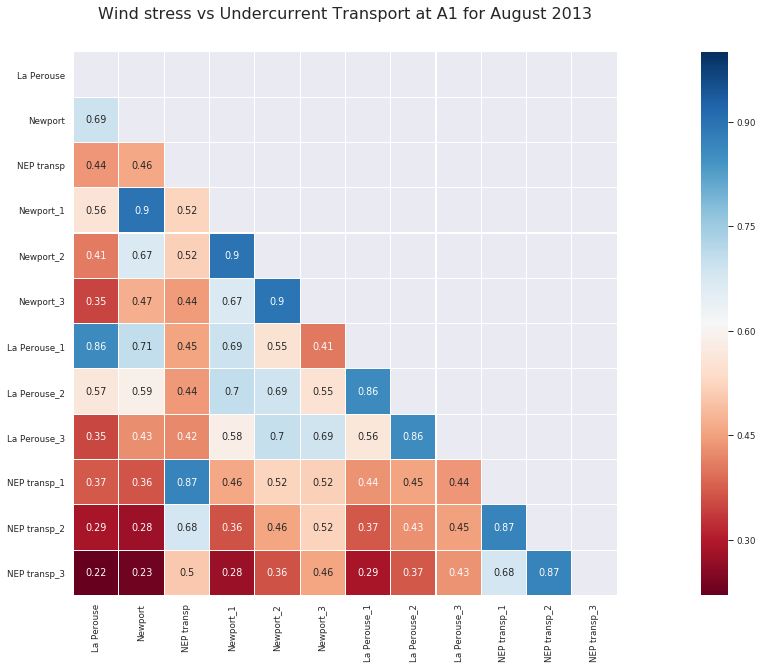

In [197]:
range = pd.date_range('2013-02-28', '2013-08-31', freq='D')

colormap = plt.cm.RdBu

wind_stress_adcp_corr = pd.DataFrame(index = range)
wind_stress_adcp_corr['La Perouse'] = filt_v_La_Perouse#La_perouse_stress_daily
wind_stress_adcp_corr['Newport'] = filt_v_newport#wind_stress_newport[58:243]
# wind_stress_adcp_corr['ADCP transp'] = streng
wind_stress_adcp_corr['NEP transp'] = streng_model[:]


NON_DER = mydates_Newport[211:-121]
df_new = df_derived_by_shift(wind_stress_adcp_corr, 3, NON_DER)


plt.figure(figsize=(30,10))
plt.title(u'Wind stress vs Undercurrent Transport at A1 for August 2013', y=1.05, size=16)

mask = np.zeros_like(df_new.corr())
mask[np.triu_indices_from(mask)] = True

svm = sns.heatmap(df_new.corr(), mask=mask, linewidths=0.1,vmax=1.0, 
            square=True, cmap=colormap, linecolor='white', annot=True)

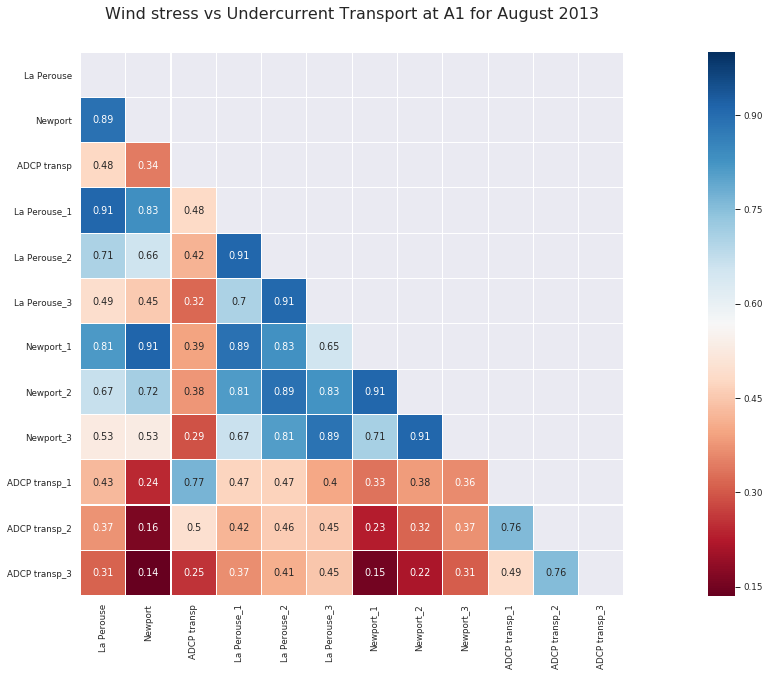

In [60]:
range = pd.date_range('2013-05-07', '2013-08-31', freq='D')

colormap = plt.cm.RdBu

wind_stress_adcp_corr = pd.DataFrame(index = range)
wind_stress_adcp_corr['La Perouse'] = filt_v_La_Perouse[68:]#La_perouse_stress_daily
wind_stress_adcp_corr['Newport'] = filt_v_newport[68:]#wind_stress_newport[58:243]
wind_stress_adcp_corr['ADCP transp'] = streng
# wind_stress_adcp_corr['NEP transp'] = streng_model[:]


NON_DER = mydates_Newport[211:-121]
df_new = df_derived_by_shift(wind_stress_adcp_corr, 3, NON_DER)


plt.figure(figsize=(30,10))
plt.title(u'Wind stress vs Undercurrent Transport at A1 for August 2013', y=1.05, size=16)

mask = np.zeros_like(df_new.corr())
mask[np.triu_indices_from(mask)] = True

svm = sns.heatmap(df_new.corr(), mask=mask, linewidths=0.1,vmax=1.0, 
            square=True, cmap=colormap, linecolor='white', annot=True)

In [55]:
streng.shape

(117,)

In [56]:
filt_v_La_Perouse.shape

(185,)

In [57]:
185-117

68

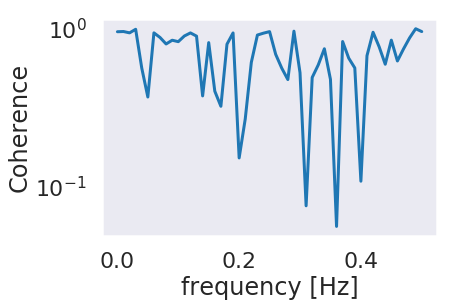

In [73]:
from scipy import signal

f, Cxy = signal.coherence(x=La_perouse_stress_daily, y = wind_stress_newport[58:243], nperseg=100)

plt.semilogy(f, Cxy)
plt.xlabel('frequency [Hz]')
plt.ylabel('Coherence')
plt.show()

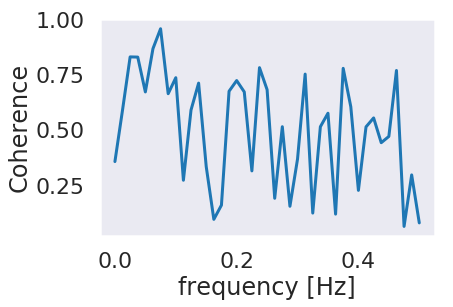

In [109]:
from scipy import signal

f, Cxy = signal.coherence(x=wind_stress_newport[58:243], y = streng_model, nperseg=80)

# plt.semilogy(f, Cxy)
plt.plot(f,Cxy)
plt.xlabel('frequency [Hz]')
plt.ylabel('Coherence')
plt.show()

In [79]:
wind_stress_newport[58:243].shape

(185,)

In [117]:
((2*np.pi)/0.025)#/(24*3600)

251.32741228718345

In [94]:
(2*np.pi)/(24*3600)

7.27220521664304e-05

In [75]:
np.where

array(['2013-02-28T00:38', '2013-02-28T01:38', '2013-02-28T02:38', ...,
       '2013-08-31T20:38', '2013-08-31T21:38', '2013-08-31T22:38'], dtype='datetime64[m]')

In [96]:
Cxy.shape

(26,)

In [98]:
np.where(Cxy == np.max(Cxy))

(array([1]),)

In [100]:
f[1]

0.02

In [102]:
f

array([ 0.  ,  0.02,  0.04,  0.06,  0.08,  0.1 ,  0.12,  0.14,  0.16,
        0.18,  0.2 ,  0.22,  0.24,  0.26,  0.28,  0.3 ,  0.32,  0.34,
        0.36,  0.38,  0.4 ,  0.42,  0.44,  0.46,  0.48,  0.5 ])

In [112]:
Cxy

array([ 0.35706327,  0.59029754,  0.83083167,  0.82991076,  0.67227883,
        0.86812703,  0.95820365,  0.66429628,  0.73666363,  0.27260057,
        0.59031224,  0.71221817,  0.33417894,  0.09572267,  0.16000484,
        0.67536561,  0.72375223,  0.67234489,  0.31492737,  0.78216473,
        0.68242734,  0.19096864,  0.51493586,  0.15484397,  0.36877609,
        0.75299407,  0.12407087,  0.51472174,  0.575891  ,  0.11934493,
        0.77910334,  0.60520295,  0.2268377 ,  0.51419678,  0.55466397,
        0.44258687,  0.47084396,  0.76941707,  0.06373813,  0.2968513 ,
        0.07962467])

In [113]:
f

array([ 0.    ,  0.0125,  0.025 ,  0.0375,  0.05  ,  0.0625,  0.075 ,
        0.0875,  0.1   ,  0.1125,  0.125 ,  0.1375,  0.15  ,  0.1625,
        0.175 ,  0.1875,  0.2   ,  0.2125,  0.225 ,  0.2375,  0.25  ,
        0.2625,  0.275 ,  0.2875,  0.3   ,  0.3125,  0.325 ,  0.3375,
        0.35  ,  0.3625,  0.375 ,  0.3875,  0.4   ,  0.4125,  0.425 ,
        0.4375,  0.45  ,  0.4625,  0.475 ,  0.4875,  0.5   ])